In [1]:
import numpy as np
import matplotlib.pyplot as plt
import natsort, glob, h5py
from scipy.optimize import curve_fit
import scipy.signal

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
# changing the display so that the cells fill the whole window

In [2]:
def gauss_fun(x, A, mu, sig):
    return A * np.exp( -(x-mu)**2/(2*sig**2) )

def lin_fun(x, m, x1):
    return m*(x-x1)

def lin_fun_const(x, m):
    return lin_fun(x,m,0)

In [3]:
def rebin_histogram(bins, counts, new_bin_size):
    """Rebin a histogram to a new bin size.
    Parameters:
        bins (np.ndarray): The bin edges of the histogram.
        counts (np.ndarray): The number of counts in each bin.
        new_bin_size (float): The size of the new bins.
    Returns:
        np.ndarray: The new bin edges.
        np.ndarray: The new bin counts.
    """
    # Find the new number of bins
    new_nbins = int((bins[-1] - bins[0]) / new_bin_size)
    # Create the new bin edges
    new_bins = np.linspace(bins[0], bins[-1], new_nbins + 1)
    # Digitize the original bins into the new bins
    digitized_bins = np.digitize(bins, new_bins)
    # Calculate the new counts
    new_counts = np.array([counts[digitized_bins == i].sum() for i in range(1, new_nbins + 1)])

    new_centers = new_bins[:-1] + np.diff(new_bins)/2
    return new_centers, new_counts

In [4]:
def peak_fit_srs10(x_data, y_data, voltage, min_distance=20, max_peaks=3, min_thresh=10, peak_range=500):
    # Find the peaks in the spectrum using the find_peaks function from scipy.signal
    
    peaks_index, _ = scipy.signal.find_peaks(y_data, distance=min_distance)
    
    # Fit each peak with a Gaussian function using the curve_fit function from scipy
    gain_info = [] # parameters to fit the gain
    peak_params = [] # parameters to plot the gaussian
    peak_number = 1 # corresponds to single photoelectron peak
    peaks = [] # list of where all the peaks are that are used in the fits
    peak_cuts = [] # data we are actually fitting
    
    for peak in peaks_index:
        if peak_number > max_peaks: # stopping the loop after we have reached the max number of peaks
            break

        if peak < min_thresh:
            continue
        
        peaks.append(np.array([x_data[peak], y_data[peak]]))
        
        # initial guess for the Gaussian parameters
        amplitude_guess = y_data[peak]
        mean_guess = x_data[peak]
        standard_deviation_guess = 10
        initial_guess = [amplitude_guess, mean_guess, standard_deviation_guess]
        
        # cutting data around each peak
        if peak_number == 1: # trying to not include the pedestal for the first peak
            cut = (x_data < (x_data[peak] + peak_range)) & (x_data > (x_data[peak] - 40))
        else:
            cut = (x_data < (x_data[peak] + peak_range)) & (x_data > (x_data[peak] - peak_range))
        peak_x = x_data[cut] # x values of peak for fitting
        peak_y = y_data[cut] # y values of peak for fitting
        peak_cuts.append([peak_x, peak_y])
        
#         plt.yscale('log')
#         plt.plot(x_data[cut], y_data[cut], alpha=0.5)
        
        # Perform the curve fitting
        try:
            # trying to fit the peaks
            params, params_covariance = curve_fit(gauss_fun, peak_x, peak_y, p0=initial_guess)
            # params are returned as amplitude, mean, std dev
            print('Guess: ', initial_guess)
            print('Params: ', params)
            peak_params.append(params)
            gain_info.append([peak_number, params[1], np.sqrt(params_covariance[1,1])]) # peak number, mean, and covariance
        except RuntimeError as r:
            # if curve fit doesn't work then we will just use the peak amplitude and center that find_peaks found
            print('fit failed')
            params = initial_guess
            peak_params.append(initial_guess)
            gain_info.append([peak, mean_guess, np.nan])
#             xx = np.linspace( x_data[peak] - 2*standard_deviation_guess, x_data[peak] + 2*standard_deviation_guess, 100 )
#         xtick_location.append(x_data[peak])
    
        peak_number += 1 # (goes to n*spe until it reaches max_peak)
        
    plt.show()
    return np.array(peak_params), np.array(gain_info), np.array(peaks), peak_cuts

In [5]:
def gain_fit(pe_locations):
    # fitting a line of the peak centers and heights to get the slope (gain) 
    fpts = ~np.isnan(pe_locations[:,1]) # getting rid of NaN values in pe_locations
    if(np.sum(fpts) < 3): # making sure we have at least 3 peaks
        return
    # fitting the peak locations to a line to find the gain (slope)
    gain_bp, gain_bc = curve_fit(lin_fun, pe_locations[fpts, 0], pe_locations[fpts, 1])

    x = pe_locations[fpts, 0] #extracting & storing x-values for valid peaks (fpts) in pe_locations 
    
    return x, gain_bp, gain_bc # pe_location, slope, y-intercept

def find_bv(g_vs_v, wavelength):
    # finding the breakdown voltage using fitted gain data of a certain wavelength (310, 405, or source)
    data_to_use = np.asarray(g_vs_v[wavelength]) # gain_vs_voltage data for certain wavelength in g_vs_v dictionary
    # data_to_use has 3 coulumns (like gain_vs_volt array from before but without 4th col of source/led wavelength)
    
    # fitting the curve with linear fit
    bv_params, bv_cov = curve_fit(lin_fun, data_to_use[:, 0], data_to_use[:, 1], sigma=data_to_use[:, 2])
    # bv_params: slope and y-intercept
    return bv_params, bv_cov

In [6]:
def load_directory(path, file_types='All'):
    # getting files from a certain directory and selecting the data type such as source and wavelength
    # sourting them into a dictionary labeled by the file type
    files = {}
    
    file_list = natsort.realsorted(glob.glob(path + "mca_*.h5"))[::-1] # sorting all of the files in the given directory
    print('Number of files found: ', len(file_list))
    for file in file_list:
        file_parts = file.split("_")
        try:
            file_wavelength = float(file_parts[-2]) # get wavelength from filename
        except ValueError:
            file_wavelength = file_parts[-2] # leaving tag as a string for source data
        if file_types == 'All': # loading all file types
            if file_wavelength not in files: # starting the dictionary of files according to type
                files[file_wavelength] = [file]
            else:
                files[file_wavelength].append(file)
    
        elif str(file_wavelength) in str(file_types): # loading only the specified file types
            if file_wavelength not in files: # starting the dictionary of files according to type
                files[file_wavelength] = [file]
            else:
                files[file_wavelength].append(file)
        else:
            pass
    
    if file_types == 'All': # printing the number of files in the directory
        print('Number of files: ', len(file_list))
    else:
        length = np.sum([len(each) for each in files.values()]) # getting the number of files of a specified type
        print('Number of files: ', length)
    
    return files

In [7]:
def peak_fit_srs10(x_data, y_data, voltage, min_distance=20, max_peaks=5, min_thresh=10, peak_range=500):
    # Find the peaks in the spectrum using the find_peaks function from scipy.signal
    
    peaks_index, _ = scipy.signal.find_peaks(y_data, distance=min_distance)
    
    # Fit each peak with a Gaussian function using the curve_fit function from scipy
    gain_info = [] # parameters to fit the gain
    peak_params = [] # parameters to plot the gaussian
    peak_number = 1 # corresponds to single photoelectron peak
    peaks = [] # list of where all the peaks are that are used in the fits
    peak_cuts = []
    for peak in peaks_index:
        if peak_number > max_peaks: # stopping the loop after we have reached the max number of peaks
            break

        if peak < min_thresh:
            continue
        
        peaks.append(np.array([x_data[peak], y_data[peak]]))
        
        # initial guess for the Gaussian parameters
        amplitude_guess = y_data[peak]
        mean_guess = x_data[peak]
        standard_deviation_guess = 10
        initial_guess = [amplitude_guess, mean_guess, standard_deviation_guess]
        
        # cutting data around each peak
        if peak_number == 1: # trying to not include the pedestal for the first peak
            cut = (x_data < (x_data[peak] + peak_range)) & (x_data > (x_data[peak] - 40))
        else:
            cut = (x_data < (x_data[peak] + peak_range)) & (x_data > (x_data[peak] - peak_range))
        peak_x = x_data[cut] # x values of peak for fitting
        peak_y = y_data[cut] # y values of peak for fitting
        peak_cuts.append([peak_x, peak_y])
        
#         plt.yscale('log')
#         plt.plot(x_data[cut], y_data[cut], alpha=0.5)
        
        # Perform the curve fitting
        try:
            # trying to fit the peaks
            params, params_covariance = curve_fit(gauss_fun, peak_x, peak_y, p0=initial_guess)
            # params are returned as amplitude, mean, std dev
            print('Guess: ', initial_guess)
            print('Params: ', params)
            peak_params.append(params)
            gain_info.append([peak_number, params[1], np.sqrt(params_covariance[1,1])]) # peak number, mean, and covariance
        except RuntimeError as r:
            # if curve fit doesn't work then we will just use the peak amplitude and center that find_peaks found
            print('fit failed')
            params = initial_guess
            peak_params.append(initial_guess)
            gain_info.append([peak, mean_guess, np.nan])
#             xx = np.linspace( x_data[peak] - 2*standard_deviation_guess, x_data[peak] + 2*standard_deviation_guess, 100 )
        
        peak_number += 1 # (goes to n*spe until it reaches max_peak)
        
    plt.show()
    return np.array(peak_params), np.array(gain_info), np.array(peaks), peak_cuts

In [8]:
def plot_fit_gain(file, peak_dist, SRS_gain, binsize, pe1=None):
    # doing the gain calculations and plotting the results (hopefully store this in a separate script at some point)
    dc_offset = []
    gain = []
       
    #to only look at some range of files, otherside just have loop -- being looped in function above
#     for i in range(40):
#         file = file_list_10[i]
        
#     for file in wavelength_files:
        
    gain_vs_volts = {} # creating dictionary to separate out
    print("Working on file %s"%(file))

    # Make into its own function
    file_parts = file.split("_")
    file_volts = float( file_parts[-3][:-2] ) # get voltage from filename
    try:
        file_wavelength = float(file_parts[-2]) # get wavelength from filename (float bc a number)
    except ValueError:
        file_wavelength = file_parts[-2] # leaving tag as a string for source data (otherwise have string: 'source')

    if (SRS_gain == 10):# & (file_wavelength == 'source'):
    # setting the peak range for low gain source data
        if file_volts < 31.5 and file_volts >=30.5:
            peak_range = 45 # picking a smaller range of values to fit over for the lower OV files
        elif file_volts < 30.5:
            print('low voltage range')
            peak_range = 25
        else:
            peak_range = 55

    # extracting the data from the files
    f = h5py.File(file, 'r')  
    ch2 = f.get('ch2')
    for key in ch2.keys():
        mca_hist = np.array(ch2.get(key))
    bin_num = np.arange(len(mca_hist))
    b, c = rebin_histogram(bin_num, mca_hist, binsize) ## might add a conditional binsize once we figure out what that needs to be for each thing

    # getting the peak and fit info
    if file_wavelength == 'source':
        peak_info, pe_locs, peaks, data_for_fits = peak_fit_srs10(b, c, file_volts, min_distance=peak_dist*25/100, min_thresh=17, peak_range=peak_range)
    elif file_wavelength == 405.0:
        peak_info, pe_locs, peaks, data_for_fits = peak_fit_srs10(b, c, file_volts, min_distance=peak_dist*25/100, min_thresh=17, peak_range=peak_range, max_peaks=3)
    elif file_wavelength == 310.0:
        peak_info, pe_locs, peaks, data_for_fits = peak_fit_srs10(b, c, file_volts, min_distance=peak_dist*25/100, min_thresh=17, peak_range=peak_range, max_peaks=3)

    # starting the plots
    plt.figure(figsize=(18,5))

    # calculating and plotting the gain 
    plt.subplot(1,2,2)
    plt.errorbar( pe_locs[:,0], pe_locs[:,1], yerr=pe_locs[:,2], fmt='ko' )

    xx, gain_params, gain_cov = gain_fit(pe_locs)# pe_location, [slope, y-intercept], covariance
    gain_error = np.sqrt(np.diag(gain_cov))[0]
    plt.plot( xx, lin_fun(xx, *gain_params), 'r', label=r'Gain: %.2f $\pm$ %.2f'%(gain_params[0], gain_error))  #(str(np.round(popt_temp[0],2)))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_temp))[0],2))+' ADC/PE'
    plt.xlabel("PE")
    #plt.xlim(0.1,1.25)
    plt.legend()
    dc_offset.append(gain_params[1]) #y-intercept
    gain.append(gain_params[0])#-dc)

    print(gain_params)

    if file_wavelength not in gain_vs_volts:
        gain_vs_volts[file_wavelength] = [np.array([file_volts, gain_params[0], np.sqrt(gain_cov[0,0])])]

    else:
        gain_vs_volts[file_wavelength].append(np.array([file_volts, gain_params[0], np.sqrt(gain_cov[0,0])]))

    #print(gain_vs_volts)

    # calibrating data in terms of pes and plotting the fitted peaks
    calibration_factor = (1/gain_params[0])#+gain_params[1] # setting the first pe to be the fitted gain

    # plotting the calibrated peaks
    plt.subplot(1,2,1)
    plt.grid()
    plt.ylim(0.1, 2500)
    #plt.yscale('log') # same as plotting semilog as before
#     plt.ylim(0.1, np.max(mca_hist)*2)
    plt.xlim(0.1, 500*calibration_factor)
    plt.xticks(np.arange(0, 7, 1))
    plt.xlabel("Calibrated PE")

    b = b*calibration_factor + gain_params[1]
#     print(peaks[:,0])
    peaks[:,0] = peaks[:,0]*calibration_factor + gain_params[1] #peaks of data with gaussian fit  
#     print(peaks[:,0])
    plt.plot(b, c, 'k')
    #plt.plot(peaks[:,0], peaks[:,1], 'o', color='r')
    for fit_params, data_peaks in zip(peak_info, data_for_fits):
        fit_params[1] = fit_params[1]*calibration_factor + gain_params[1]# calibrated gaussian fits x, y below
        fit_params[2] = (fit_params[2]*calibration_factor)
        plt.plot(b, gauss_fun(b, *fit_params)) #plotting calibrated gaussian function
        data_peaks[0] = data_peaks[0]*calibration_factor + gain_params[1] # calibrated data that is being used for gaussian fits
        plt.plot(data_peaks[0], data_peaks[1])
    
    plt.show()
    #print(gain_vs_volts)
    
    return b, c, gain_params[0], gain_error, dc_offset

### Positive Field

In [9]:
# getting the data that we need
path_10 = '/gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/'
files_10 = load_directory(path_10)
SRS_gain_10 = 10 # gain on the SRS bandpass filter
# peak_threshold = 700 # upper bound of pedestal
# breakdown = 27.4 # breakdown voltage of the SiPM
pedestal_10 = 275 # center of noise pedestal peak

Number of files found:  104
Number of files:  104


Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_34.h5
Guess:  [1570, 205.0375457875458, 10]
Params:  [1515.66283453  204.43553119   24.07303356]
Guess:  [723, 295.0540293040293, 10]
Params:  [640.22310449 297.91657661  30.84700752]
Guess:  [398, 405.0741758241758, 10]
Params:  [377.53631454 397.28494787  29.46944338]
Guess:  [233, 485.0888278388278, 10]
Params:  [215.52667942 489.99061937  37.32235948]
Guess:  [154, 585.1071428571429, 10]
Params:  [147.43912246 590.14144816  33.5986548 ]
[96.34858769 -1.10959656]


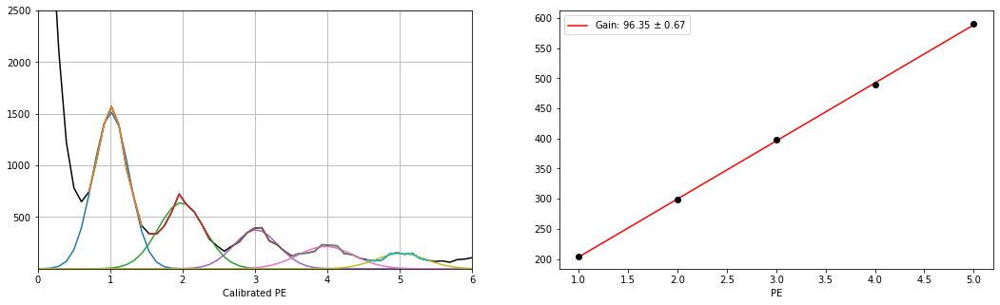

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_33.h5
Guess:  [1547, 205.0375457875458, 10]
Params:  [1473.75713094  203.4066389    24.98635408]
Guess:  [709, 295.0540293040293, 10]
Params:  [674.71434451 297.13538355  29.49656732]
Guess:  [378, 395.0723443223443, 10]
Params:  [377.31495208 394.01725139  30.37515925]
Guess:  [228, 495.09065934065933, 10]
Params:  [224.84252581 491.68036795  32.85404412]
Guess:  [153, 595.1089743589744, 10]
Params:  [151.8370839  591.02843387  32.98877767]
[96.97885745 -1.07773019]


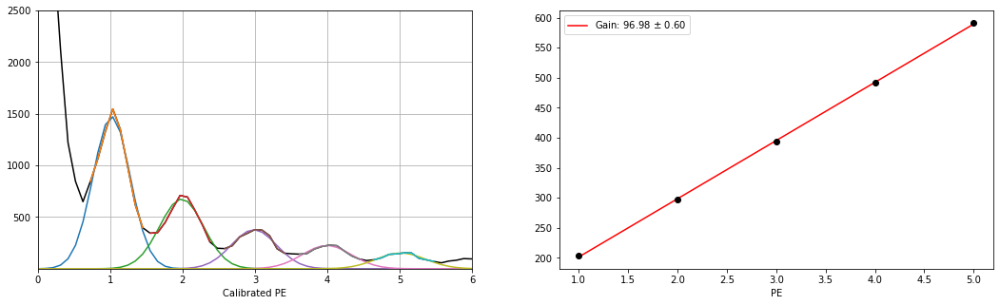

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_32.h5
Guess:  [1403, 205.0375457875458, 10]
Params:  [1350.54733888  204.13344323   26.14277466]
Guess:  [641, 305.0558608058608, 10]
Params:  [628.56196224 299.38111562  29.13377892]
Guess:  [375, 395.0723443223443, 10]
Params:  [365.79642303 396.41967127  29.98969028]
Guess:  [220, 505.09249084249086, 10]
Params:  [208.2759198  493.31078575  36.36976153]
Guess:  [158, 585.1071428571429, 10]
Params:  [140.32947672 590.21542486  34.98459153]
[96.60936333 -1.10614535]


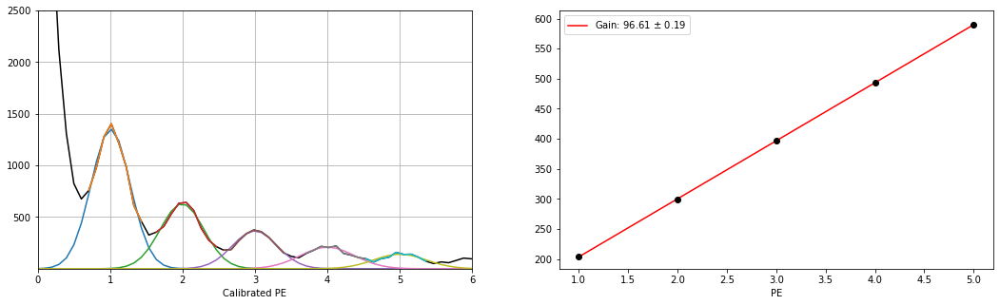

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_31.h5
Guess:  [1540, 205.0375457875458, 10]
Params:  [1491.4759263   204.43669575   23.60254306]
Guess:  [670, 295.0540293040293, 10]
Params:  [646.36114637 297.70010256  30.92242376]
Guess:  [363, 395.0723443223443, 10]
Params:  [351.79010193 395.72865176  30.63272965]
Guess:  [243, 485.0888278388278, 10]
Params:  [219.01029673 491.12476092  35.00668611]
Guess:  [146, 585.1071428571429, 10]
Params:  [139.4900255  594.02924161  42.39363555]
[97.26097499 -1.07772892]


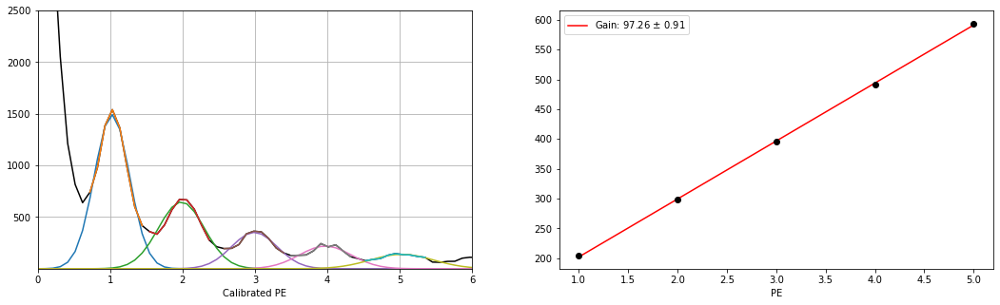

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_30.h5
Guess:  [1442, 205.0375457875458, 10]
Params:  [1400.67588193  204.24755139   24.75505909]
Guess:  [693, 295.0540293040293, 10]
Params:  [663.94142983 298.4566345   30.11071526]
Guess:  [397, 405.0741758241758, 10]
Params:  [373.23459245 398.25226609  28.84567396]
Guess:  [260, 495.09065934065933, 10]
Params:  [220.8118265  493.76713599  32.16858426]
Guess:  [162, 595.1089743589744, 10]
Params:  [144.63999481 590.55188024  35.06059873]
[96.79191592 -1.1021514 ]


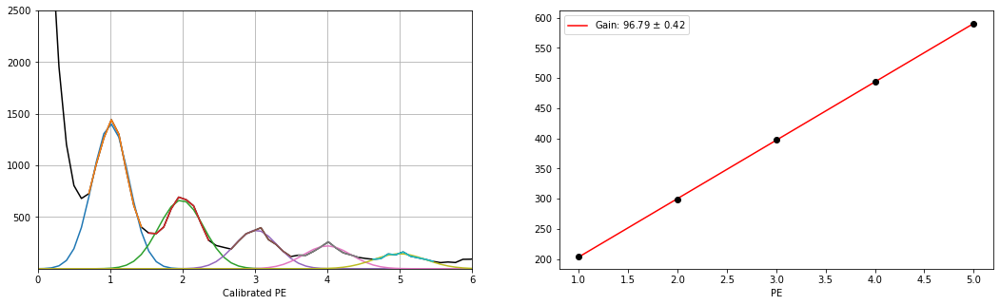

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_29.h5
Guess:  [1557, 205.0375457875458, 10]
Params:  [1497.21303688  204.26677262   23.98320867]
Guess:  [706, 295.0540293040293, 10]
Params:  [667.07107154 298.61880683  29.59611113]
Guess:  [398, 405.0741758241758, 10]
Params:  [374.7222353  397.53888016  28.54608406]
Guess:  [219, 485.0888278388278, 10]
Params:  [213.58356455 489.86421132  36.92369833]
Guess:  [143, 595.1089743589744, 10]
Params:  [140.35787542 588.41679325  40.21432607]
[95.95454456 -1.12425586]


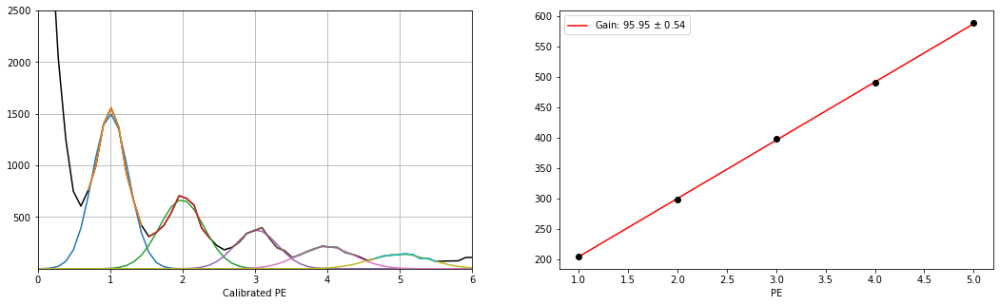

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_28.h5
Guess:  [1570, 205.0375457875458, 10]
Params:  [1551.39358604  203.32214865   22.46778306]
Guess:  [680, 295.0540293040293, 10]
Params:  [666.93610574 297.18345517  27.96450432]
Guess:  [389, 395.0723443223443, 10]
Params:  [368.30320885 394.79923506  28.74186042]
Guess:  [254, 495.09065934065933, 10]
Params:  [239.87579453 492.0296686   30.41316037]
Guess:  [163, 585.1071428571429, 10]
Params:  [148.74409418 584.4526556   33.96009812]
[95.71072273 -1.12030566]


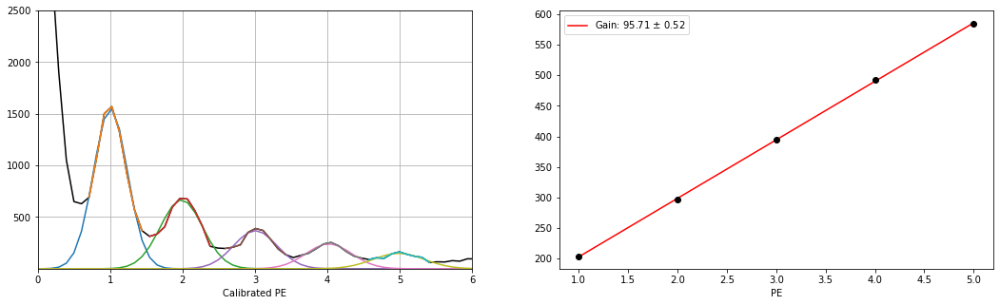

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_27.h5
Guess:  [1466, 205.0375457875458, 10]
Params:  [1437.28128852  203.25080407   22.83865135]
Guess:  [685, 305.0558608058608, 10]
Params:  [664.32991766 299.70234427  25.72265367]
Guess:  [397, 395.0723443223443, 10]
Params:  [372.46299329 395.51188605  28.15196424]
Guess:  [240, 495.09065934065933, 10]
Params:  [214.04342759 493.66474382  29.9761248 ]
Guess:  [162, 595.1089743589744, 10]
Params:  [154.06369603 592.5669022   29.57074154]
[97.25945958 -1.08124143]


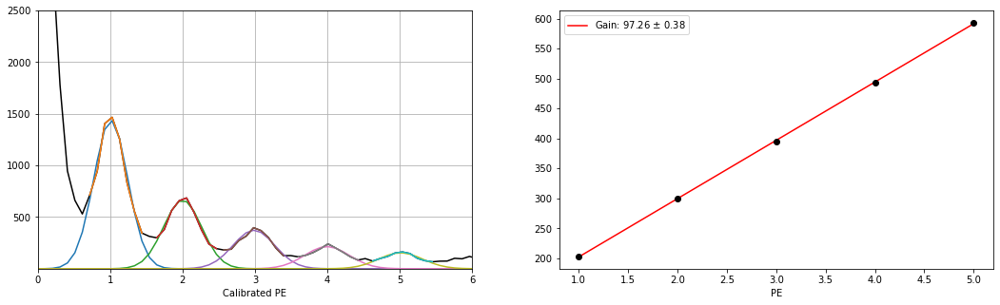

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_26.h5
Guess:  [1412, 205.0375457875458, 10]
Params:  [1392.07333397  203.42238456   26.63696493]
Guess:  [654, 295.0540293040293, 10]
Params:  [626.89823773 299.1474495   32.56710955]
Guess:  [405, 405.0741758241758, 10]
Params:  [372.4028096  398.25695403  29.47680175]
Guess:  [246, 495.09065934065933, 10]
Params:  [222.38124745 494.76533676  32.39337821]
Guess:  [156, 605.1108058608058, 10]
Params:  [138.43436771 593.68895037  39.91581212]
[97.61510193 -1.07576499]


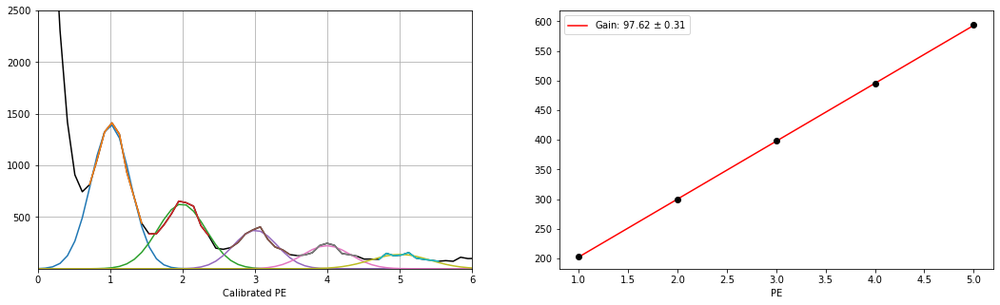

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_25.h5
Guess:  [1511, 205.0375457875458, 10]
Params:  [1458.38253749  204.19329517   24.44300571]
Guess:  [680, 305.0558608058608, 10]
Params:  [671.47231948 300.40459681  28.54886004]
Guess:  [392, 395.0723443223443, 10]
Params:  [361.8566148  396.65259049  32.40447729]
Guess:  [253, 495.09065934065933, 10]
Params:  [241.41674129 493.34804382  27.99135044]
Guess:  [150, 585.1071428571429, 10]
Params:  [137.72247047 589.8586018   41.71896996]
[96.42740602 -1.11596082]


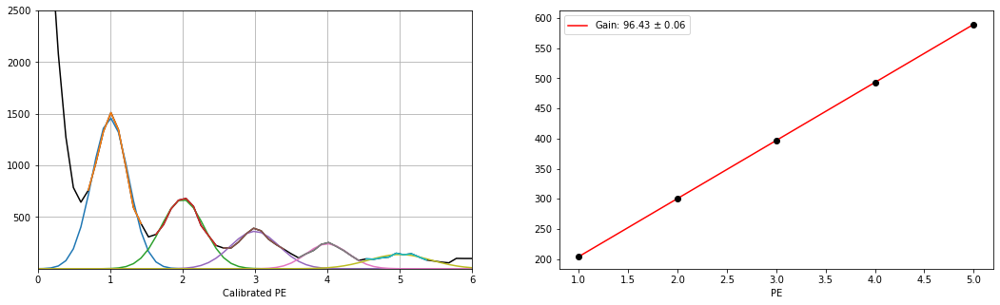

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_24.h5
Guess:  [1512, 205.0375457875458, 10]
Params:  [1515.56321559  203.39745196   23.14418247]
Guess:  [689, 305.0558608058608, 10]
Params:  [687.15574606 299.19630432  26.63231933]
Guess:  [407, 395.0723443223443, 10]
Params:  [398.19471758 394.10057978  27.4472409 ]
Guess:  [236, 485.0888278388278, 10]
Params:  [227.25461412 488.45683416  33.96904875]
Guess:  [153, 585.1071428571429, 10]
Params:  [150.62107307 586.35530698  31.37315407]
[95.51762401 -1.12804757]


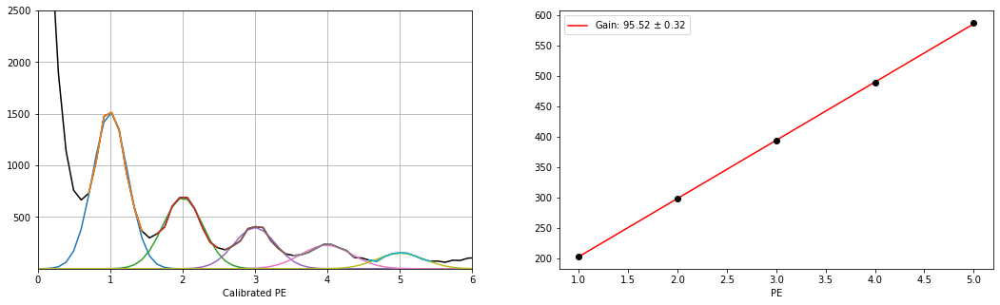

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_23.h5
Guess:  [1487, 205.0375457875458, 10]
Params:  [1487.79082165  202.69977856   23.92913707]
Guess:  [714, 295.0540293040293, 10]
Params:  [685.916944   297.54855153  27.65796905]
Guess:  [438, 395.0723443223443, 10]
Params:  [388.71448596 395.34877002  28.17894752]
Guess:  [253, 495.09065934065933, 10]
Params:  [227.54448015 493.22110561  31.63524921]
Guess:  [154, 595.1089743589744, 10]
Params:  [142.07845252 591.34227302  36.02709374]
[97.2957543  -1.07039442]


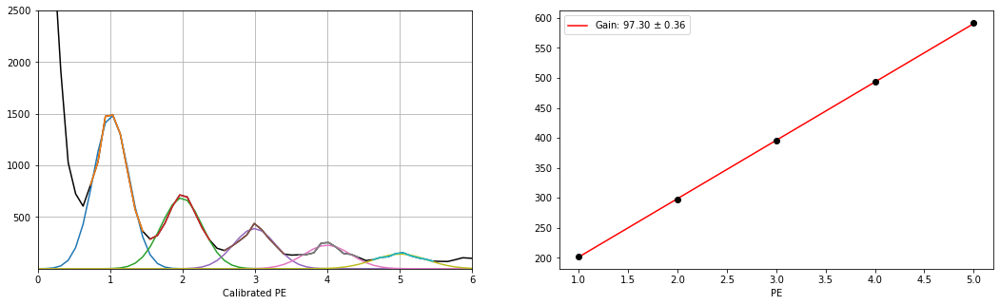

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_22.h5
Guess:  [1527, 205.0375457875458, 10]
Params:  [1469.78443583  204.10517696   23.09835859]
Guess:  [651, 305.0558608058608, 10]
Params:  [650.9803805  300.43471081  27.20008378]
Guess:  [375, 395.0723443223443, 10]
Params:  [358.09239143 394.9968195   29.55124943]
Guess:  [227, 485.0888278388278, 10]
Params:  [219.88146975 492.67244769  35.0921016 ]
Guess:  [170, 595.1089743589744, 10]
Params:  [142.38475379 592.50512775  32.06314364]
[96.90376385 -1.0962584 ]


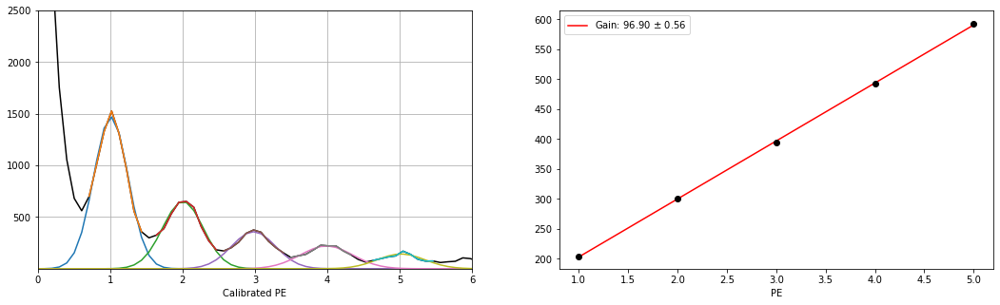

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_21.h5
Guess:  [1495, 205.0375457875458, 10]
Params:  [1416.20841485  203.58301871   24.28873107]
Guess:  [693, 305.0558608058608, 10]
Params:  [666.31973476 299.79957722  26.61946739]
Guess:  [389, 395.0723443223443, 10]
Params:  [372.37373912 395.25608272  29.55040821]
Guess:  [234, 485.0888278388278, 10]
Params:  [221.25469031 490.30663142  35.51275631]
Guess:  [163, 595.1089743589744, 10]
Params:  [146.4000081  592.75750902  32.57930665]
[96.8856035  -1.09080967]


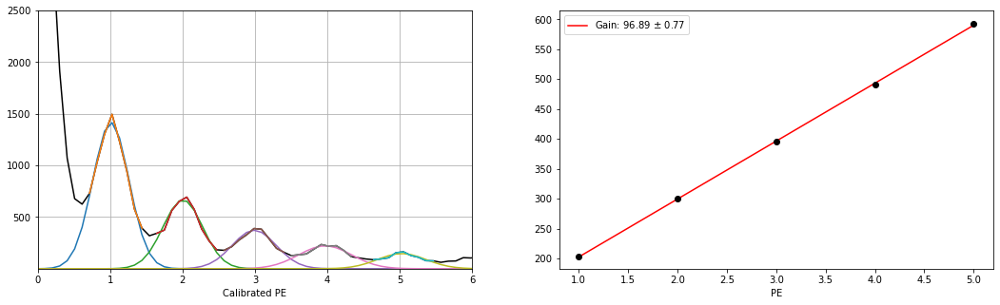

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_20.h5
Guess:  [1463, 205.0375457875458, 10]
Params:  [1445.97498002  203.64073549   25.0719423 ]
Guess:  [671, 305.0558608058608, 10]
Params:  [655.28110364 300.06922495  27.30919131]
Guess:  [352, 395.0723443223443, 10]
Params:  [345.04164562 395.25217521  32.59537145]
Guess:  [268, 495.09065934065933, 10]
Params:  [232.72068194 495.37186572  29.52881985]
Guess:  [147, 595.1089743589744, 10]
Params:  [134.64851361 589.46570085  42.48461643]
[96.69525715 -1.1031996 ]


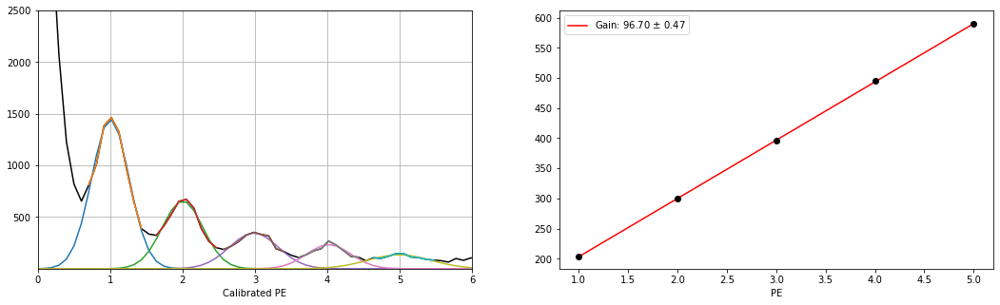

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_19.h5
Guess:  [1513, 205.0375457875458, 10]
Params:  [1427.05059335  204.2179985    24.55642409]
Guess:  [679, 295.0540293040293, 10]
Params:  [637.14461437 297.96888277  30.64856569]
Guess:  [364, 405.0741758241758, 10]
Params:  [353.89057291 396.42492208  30.88236804]
Guess:  [244, 495.09065934065933, 10]
Params:  [223.82298798 491.25870936  32.34855257]
Guess:  [160, 595.1089743589744, 10]
Params:  [152.9069447  589.12519418  33.10697869]
[96.31042178 -1.10961902]


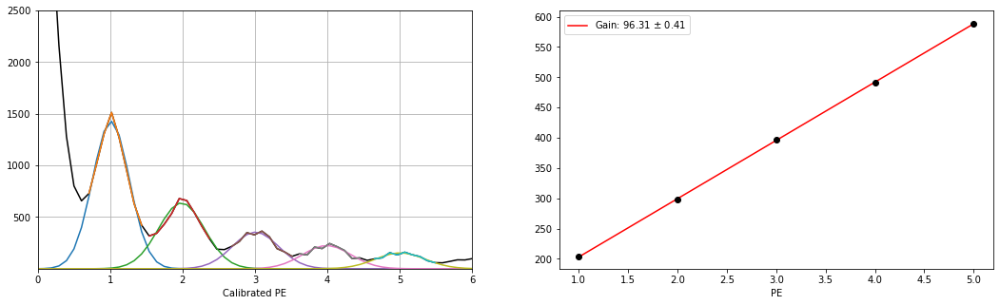

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_18.h5
Guess:  [1419, 205.0375457875458, 10]
Params:  [1386.08677961  204.38889464   25.34743625]
Guess:  [748, 295.0540293040293, 10]
Params:  [668.68839592 298.29001959  28.08534431]
Guess:  [401, 405.0741758241758, 10]
Params:  [352.3254782  398.58451971  31.46854084]
Guess:  [216, 495.09065934065933, 10]
Params:  [211.46370575 490.88168224  32.7286046 ]
Guess:  [150, 585.1071428571429, 10]
Params:  [141.87631875 586.66861659  34.14051046]
[95.71511066 -1.13479903]


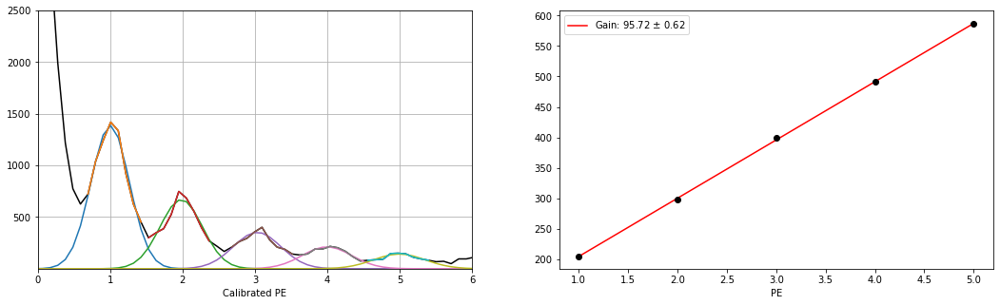

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_17.h5
Guess:  [1630, 205.0375457875458, 10]
Params:  [1491.7330378   203.16494289   23.52020448]
Guess:  [762, 295.0540293040293, 10]
Params:  [707.63662687 298.07010862  26.95501633]
Guess:  [409, 395.0723443223443, 10]
Params:  [387.77264545 396.44364203  29.51143728]
Guess:  [247, 495.09065934065933, 10]
Params:  [228.02696632 492.0910136   29.53681142]
Guess:  [180, 595.1089743589744, 10]
Params:  [157.31452853 588.23220454  31.95961872]
[96.41554284 -1.10307686]


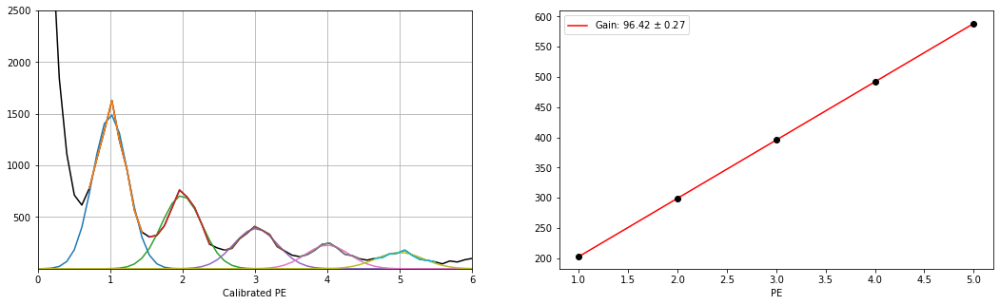

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_16.h5
Guess:  [1516, 205.0375457875458, 10]
Params:  [1494.77459242  203.79275023   24.10132667]
Guess:  [694, 295.0540293040293, 10]
Params:  [660.61268663 298.57644781  29.92589165]
Guess:  [380, 395.0723443223443, 10]
Params:  [354.33379144 394.69537376  31.54616282]
Guess:  [241, 495.09065934065933, 10]
Params:  [230.99896427 495.19397661  31.47560989]
Guess:  [154, 595.1089743589744, 10]
Params:  [149.66858123 587.40939169  33.36653904]
[96.38508114 -1.10783062]


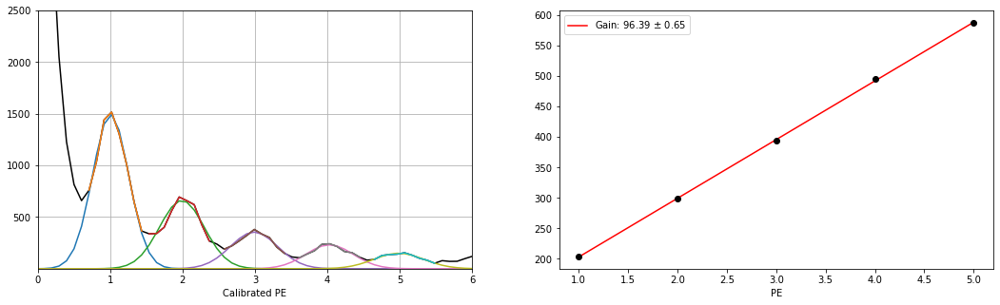

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_15.h5
Guess:  [1516, 205.0375457875458, 10]
Params:  [1496.44549612  203.45476371   23.86931654]
Guess:  [715, 295.0540293040293, 10]
Params:  [692.52578609 298.37426949  26.64811215]
Guess:  [390, 395.0723443223443, 10]
Params:  [370.51991829 395.70145332  30.45833097]
Guess:  [230, 495.09065934065933, 10]
Params:  [222.44660355 491.71199776  33.06933121]
Guess:  [146, 595.1089743589744, 10]
Params:  [142.34253614 590.00690101  34.29763456]
[96.64420027 -1.09595067]


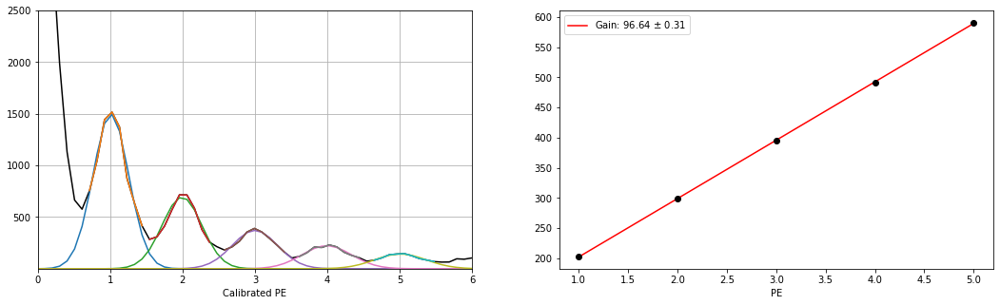

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_14.h5
Guess:  [1611, 205.0375457875458, 10]
Params:  [1545.25974065  203.11145844   22.99638666]
Guess:  [700, 305.0558608058608, 10]
Params:  [677.76612665 299.00274316  26.40185705]
Guess:  [405, 395.0723443223443, 10]
Params:  [376.22515697 394.36752873  28.94699291]
Guess:  [272, 495.09065934065933, 10]
Params:  [237.41170409 494.42687982  30.86163062]
Guess:  [169, 595.1089743589744, 10]
Params:  [154.83169766 590.59050147  30.68505051]
[97.0382223  -1.08395592]


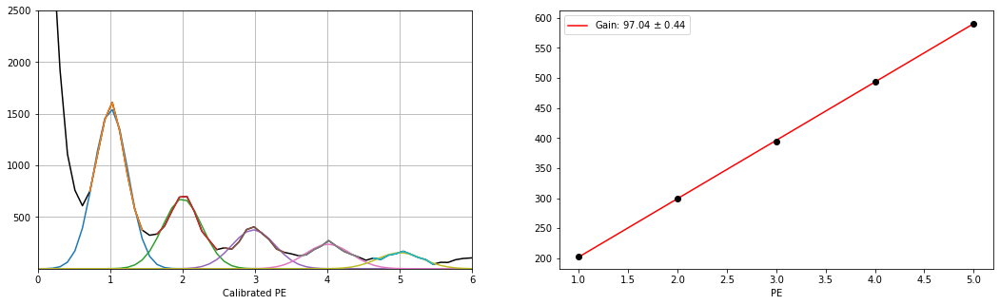

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_13.h5
Guess:  [1542, 205.0375457875458, 10]
Params:  [1499.17293725  203.36765493   23.27869732]
Guess:  [677, 295.0540293040293, 10]
Params:  [658.61833457 298.45828927  27.68978422]
Guess:  [368, 395.0723443223443, 10]
Params:  [356.55196861 394.5070366   30.18719261]
Guess:  [229, 495.09065934065933, 10]
Params:  [228.26035087 492.32343283  31.14991511]
Guess:  [160, 605.1108058608058, 10]
Params:  [147.46839422 591.00036497  35.89161853]
[96.91305637 -1.08542843]


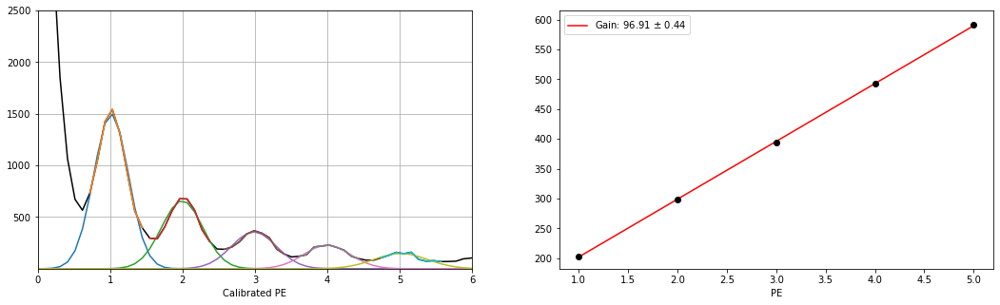

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_12.h5
Guess:  [1579, 205.0375457875458, 10]
Params:  [1535.29736568  203.90904319   23.21852328]
Guess:  [760, 295.0540293040293, 10]
Params:  [691.14709485 297.79877851  27.51780361]
Guess:  [413, 405.0741758241758, 10]
Params:  [376.58171533 396.17812444  30.08268151]
Guess:  [276, 495.09065934065933, 10]
Params:  [243.90316556 492.91720982  30.61955179]
Guess:  [172, 595.1089743589744, 10]
Params:  [155.05681088 589.97314217  30.65049679]
[96.72466293 -1.0957006 ]


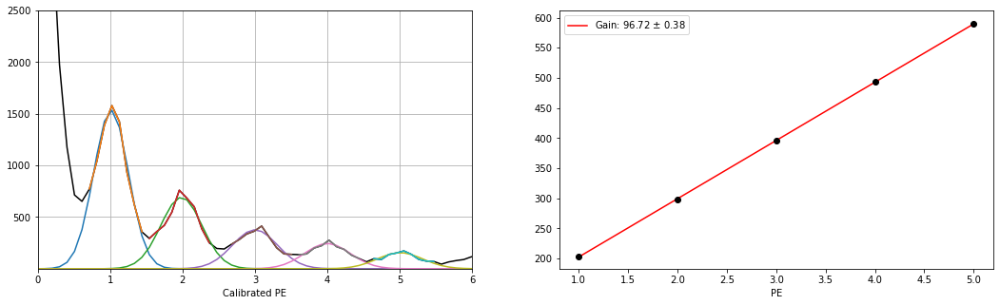

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_11.h5
Guess:  [1557, 205.0375457875458, 10]
Params:  [1494.56059873  203.68386349   23.27523545]
Guess:  [707, 305.0558608058608, 10]
Params:  [699.09688803 300.25329671  26.68591281]
Guess:  [397, 395.0723443223443, 10]
Params:  [369.09861083 395.31107799  29.74027175]
Guess:  [255, 495.09065934065933, 10]
Params:  [242.12347568 495.08875439  29.64677874]
Guess:  [157, 595.1089743589744, 10]
Params:  [148.06817021 589.26131406  37.49320575]
[96.59903587 -1.10686978]


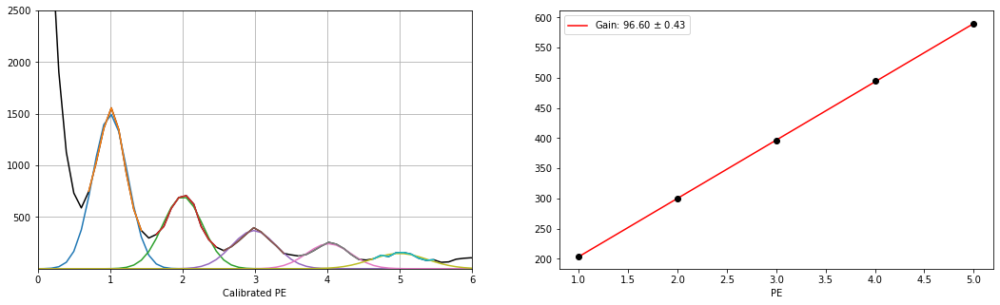

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_10.h5
Guess:  [1599, 205.0375457875458, 10]
Params:  [1570.92093449  203.3407446    22.20057356]
Guess:  [697, 295.0540293040293, 10]
Params:  [672.51862838 297.63027234  27.1586286 ]
Guess:  [417, 395.0723443223443, 10]
Params:  [388.26708611 394.63157793  28.90232322]
Guess:  [234, 505.09249084249086, 10]
Params:  [227.73528233 495.59714803  31.37123377]
Guess:  [149, 595.1089743589744, 10]
Params:  [136.32003959 594.06416976  34.16429894]
[97.9413726  -1.05398426]


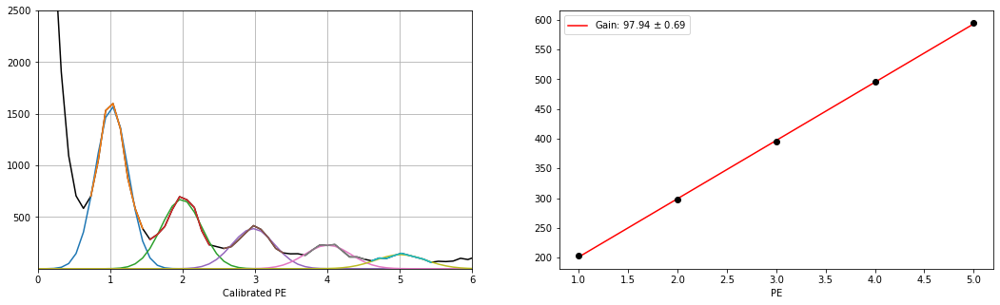

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_9.h5
Guess:  [1519, 205.0375457875458, 10]
Params:  [1476.22668856  203.23628586   23.30338414]
Guess:  [701, 305.0558608058608, 10]
Params:  [688.48342012 300.80643528  26.21518184]
Guess:  [390, 385.0705128205128, 10]
Params:  [358.76960249 390.88150728  35.70872525]
Guess:  [202, 495.09065934065933, 10]
Params:  [197.17170807 493.58071329  35.43196589]
Guess:  [162, 585.1071428571429, 10]
Params:  [142.45414839 586.9887613   38.6544493 ]
[96.02792289 -1.11441515]


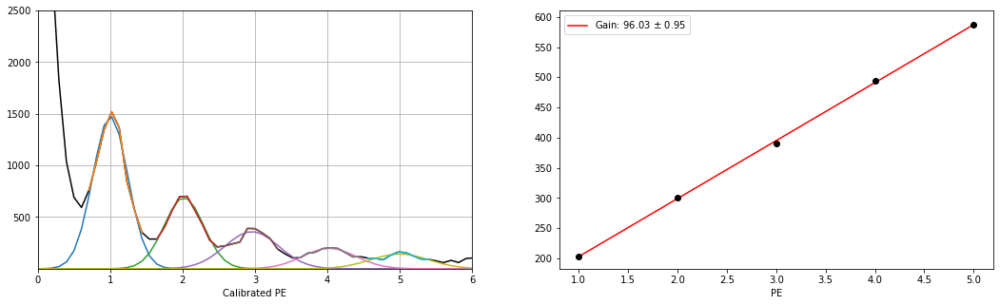

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_8.h5
Guess:  [1543, 205.0375457875458, 10]
Params:  [1511.3061854   203.79227523   23.42684524]
Guess:  [719, 305.0558608058608, 10]
Params:  [700.02330467 300.20254865  25.75426787]
Guess:  [415, 395.0723443223443, 10]
Params:  [392.69894816 395.22038988  28.47378753]
Guess:  [229, 505.09249084249086, 10]
Params:  [210.87224051 494.02014883  32.2357353 ]
Guess:  [155, 595.1089743589744, 10]
Params:  [143.3303901  588.13023118  36.20459892]
[96.2493512  -1.11715106]


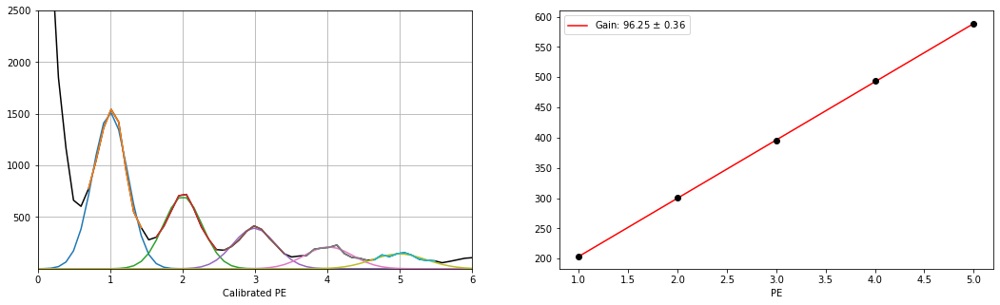

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_7.h5
Guess:  [1549, 205.0375457875458, 10]
Params:  [1487.39407014  204.30816162   23.60660838]
Guess:  [717, 295.0540293040293, 10]
Params:  [657.34856824 299.27420224  28.97863069]
Guess:  [402, 395.0723443223443, 10]
Params:  [380.30219839 395.30719623  30.11026072]
Guess:  [253, 495.09065934065933, 10]
Params:  [226.5137983  492.60045398  31.51946567]
Guess:  [164, 595.1089743589744, 10]
Params:  [164.66770233 590.34456387  29.26884852]
[96.53990564 -1.10573133]


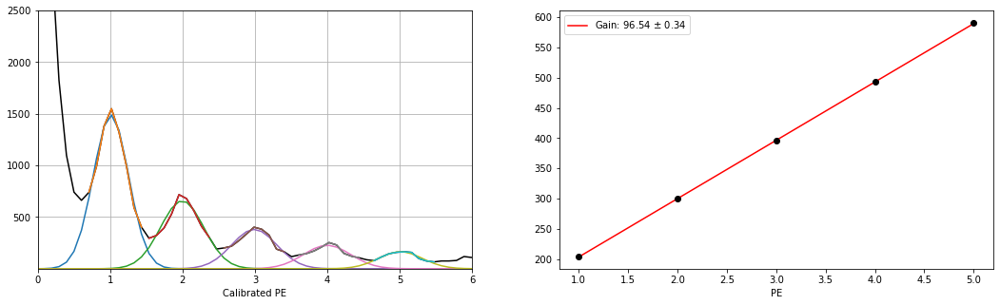

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_6.h5
Guess:  [1578, 205.0375457875458, 10]
Params:  [1524.21665845  203.12538401   23.29410787]
Guess:  [716, 305.0558608058608, 10]
Params:  [686.25626035 300.33339928  26.63365191]
Guess:  [388, 395.0723443223443, 10]
Params:  [359.85683292 396.66057959  30.40504414]
Guess:  [251, 495.09065934065933, 10]
Params:  [235.8130507  493.28525886  30.60101292]
Guess:  [163, 595.1089743589744, 10]
Params:  [149.05924268 591.7761905   31.25032392]
[97.02534725 -1.092087  ]


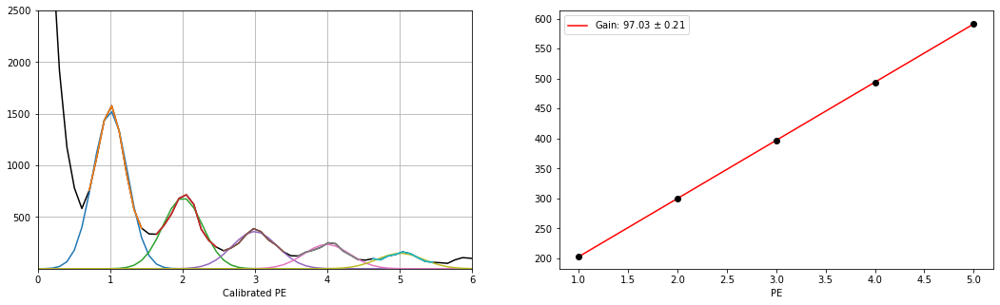

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_5.h5
Guess:  [1587, 205.0375457875458, 10]
Params:  [1529.6215049   203.98086303   22.81926234]
Guess:  [759, 295.0540293040293, 10]
Params:  [702.31950349 297.95669467  26.61084286]
Guess:  [390, 405.0741758241758, 10]
Params:  [375.18179237 395.64987415  28.16773639]
Guess:  [262, 495.09065934065933, 10]
Params:  [233.64844682 493.36614577  30.81664315]
Guess:  [161, 595.1089743589744, 10]
Params:  [154.12995874 589.02641142  29.16140009]
[96.5500548  -1.10145803]


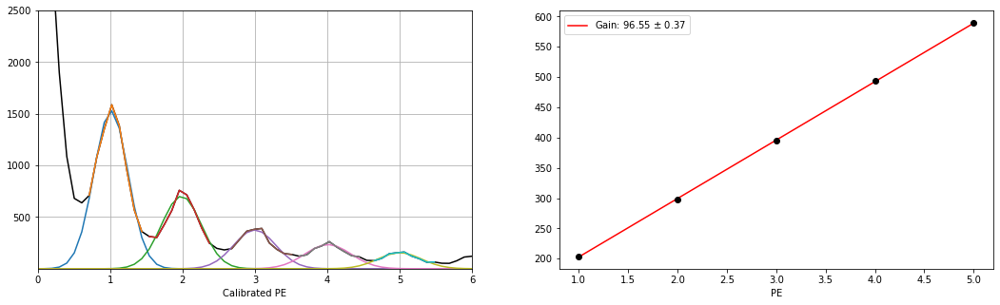

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_4.h5
Guess:  [1448, 205.0375457875458, 10]
Params:  [1433.4609211   204.10278586   22.45215605]
Guess:  [679, 305.0558608058608, 10]
Params:  [644.83221756 299.62624503  26.10254018]
Guess:  [363, 405.0741758241758, 10]
Params:  [343.67472494 397.01623722  28.71895853]
Guess:  [214, 495.09065934065933, 10]
Params:  [207.0079016  494.067677    31.72193035]
Guess:  [154, 585.1071428571429, 10]
Params:  [139.21041277 588.83798878  37.6274641 ]
[96.3911838  -1.11583478]


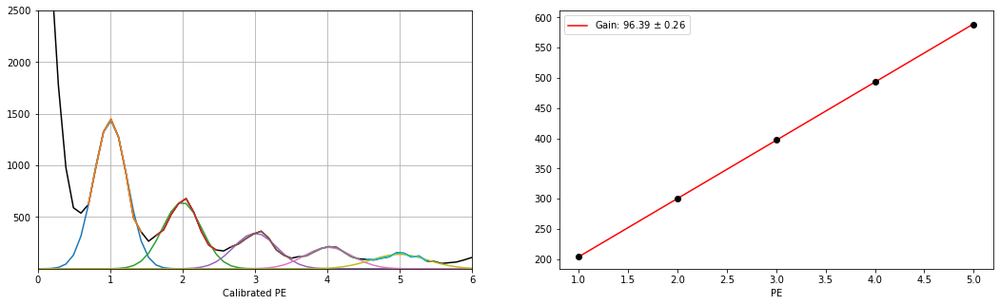

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_3.h5
Guess:  [1525, 205.0375457875458, 10]
Params:  [1455.53715101  203.80304723   24.30050713]
Guess:  [695, 295.0540293040293, 10]
Params:  [660.35868737 299.64185027  28.8520859 ]
Guess:  [384, 395.0723443223443, 10]
Params:  [377.74077744 395.54572949  29.01252615]
Guess:  [254, 485.0888278388278, 10]
Params:  [234.37165277 488.80281179  33.59702663]
Guess:  [158, 585.1071428571429, 10]
Params:  [142.61055841 589.37284012  39.75630321]
[96.03005476 -1.11780725]


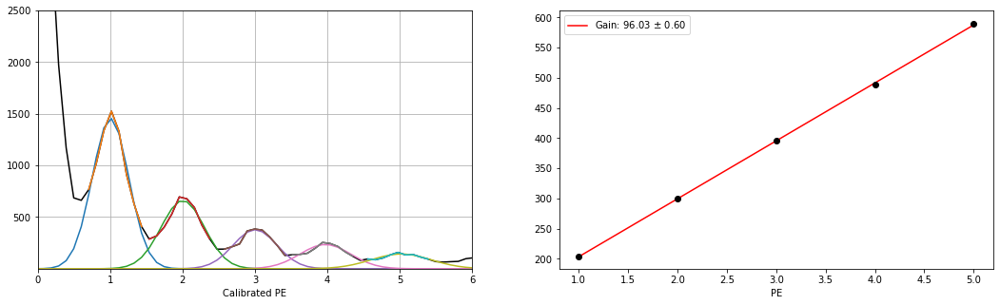

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_2.h5
Guess:  [1434, 205.0375457875458, 10]
Params:  [1385.13769742  204.25925272   25.47858205]
Guess:  [715, 305.0558608058608, 10]
Params:  [669.68581655 300.43742996  27.97316557]
Guess:  [359, 405.0741758241758, 10]
Params:  [355.16524254 397.7557636   31.3181558 ]
Guess:  [244, 495.09065934065933, 10]
Params:  [220.8177972  493.98428541  34.6735055 ]
Guess:  [159, 585.1071428571429, 10]
Params:  [146.27922803 588.4611948   36.00615558]
[96.19507396 -1.12681823]


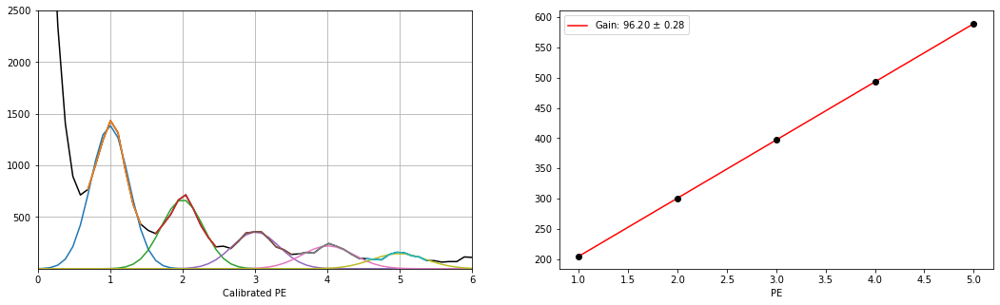

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_1.h5
Guess:  [1326, 205.0375457875458, 10]
Params:  [1352.16499298  204.32511863   27.58686432]
Guess:  [671, 305.0558608058608, 10]
Params:  [634.30828972 299.65859686  30.58372714]
Guess:  [375, 405.0741758241758, 10]
Params:  [354.39891825 399.0988074   31.56593453]
Guess:  [243, 495.09065934065933, 10]
Params:  [228.61721982 493.47875557  35.73978479]
Guess:  [146, 605.1108058608058, 10]
Params:  [130.63163697 594.85669137  42.09567461]
[97.4883305  -1.08544891]


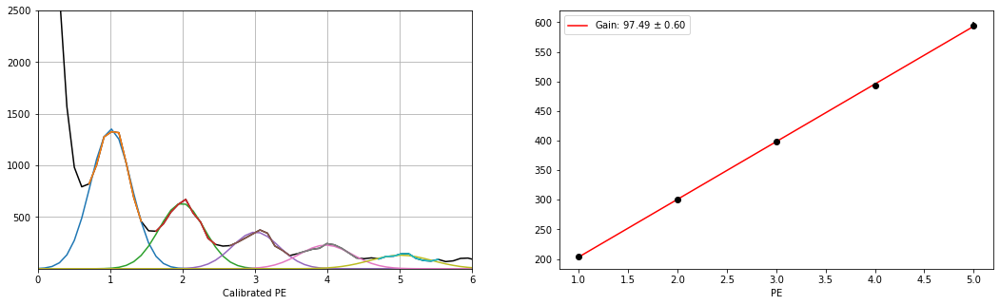

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_0.h5
Guess:  [1340, 205.0375457875458, 10]
Params:  [1307.30178709  204.0408482    27.94029339]
Guess:  [673, 305.0558608058608, 10]
Params:  [646.68556092 299.97108294  29.30121095]
Guess:  [359, 395.0723443223443, 10]
Params:  [351.10256467 395.1876152   31.34854722]
Guess:  [218, 485.0888278388278, 10]
Params:  [202.88821797 490.79391978  38.73786191]
Guess:  [141, 585.1071428571429, 10]
Params:  [127.49489801 585.16967292  45.6737198 ]
[95.30804864 -1.14479819]


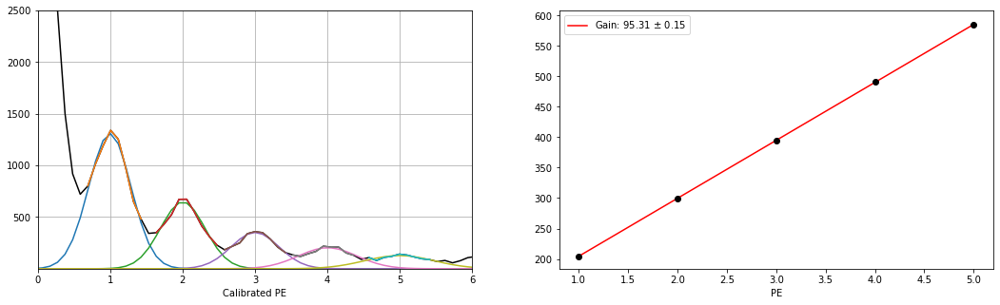

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_34.h5
Guess:  [401, 205.0375457875458, 10]
Params:  [410.13683229 202.55635922  25.64375071]
Guess:  [320, 295.0540293040293, 10]
Params:  [278.14551066 296.62649839  31.55743717]
Guess:  [220, 385.0705128205128, 10]
Params:  [216.97635914 384.0662661   33.69618242]
[90.75495354 -1.24408049]


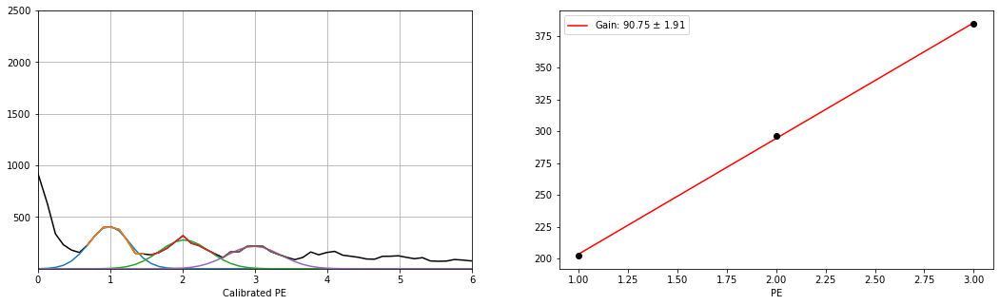

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_33.h5
Guess:  [431, 205.0375457875458, 10]
Params:  [400.98766391 202.46048173  25.38876393]
Guess:  [302, 295.0540293040293, 10]
Params:  [286.79845886 293.7482612   30.05246208]
Guess:  [206, 395.0723443223443, 10]
Params:  [189.12223441 382.56712856  42.46529313]
[90.05332343 -1.25279822]


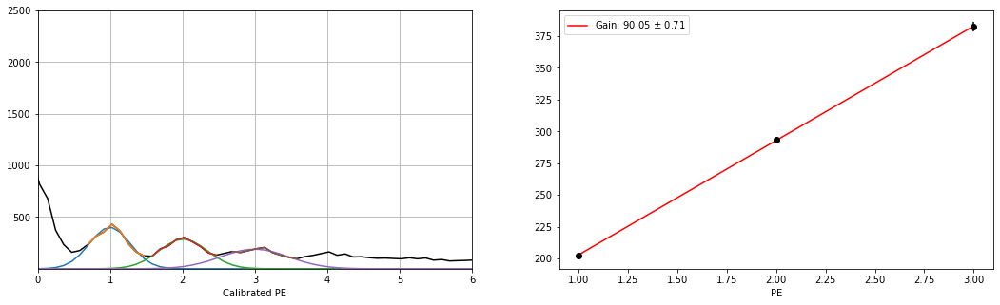

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_32.h5
Guess:  [394, 195.03571428571428, 10]
Params:  [376.44805074 199.8808969   26.29914878]
Guess:  [279, 295.0540293040293, 10]
Params:  [263.02029216 293.21280066  30.43133083]
Guess:  [200, 385.0705128205128, 10]
Params:  [195.69832148 383.19072223  38.88168386]
[91.65491265 -1.18689744]


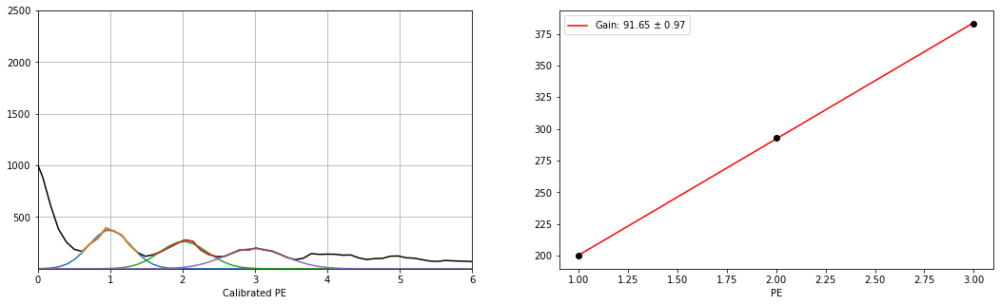

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_31.h5
Guess:  [393, 205.0375457875458, 10]
Params:  [396.58639654 203.29109055  25.44584944]
Guess:  [301, 295.0540293040293, 10]
Params:  [278.21425282 295.12608756  29.04825339]
Guess:  [199, 385.0705128205128, 10]
Params:  [197.4983294  383.47127312  38.55502698]
[90.09009127 -1.26298723]


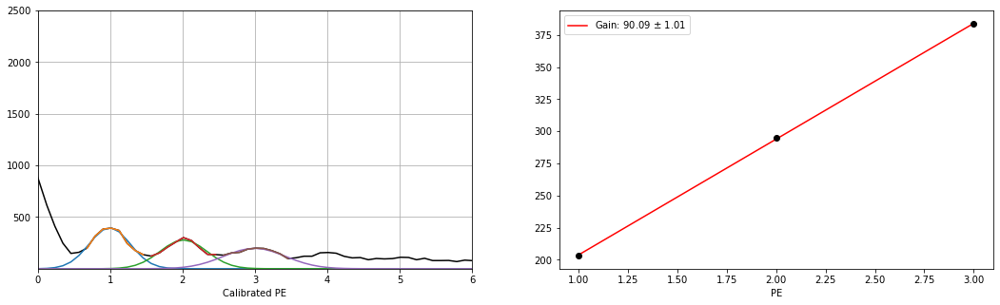

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_30.h5
Guess:  [423, 205.0375457875458, 10]
Params:  [399.65158688 202.95783834  24.75587003]
Guess:  [292, 295.0540293040293, 10]
Params:  [266.54145439 295.45866097  29.04239339]
Guess:  [199, 375.06868131868134, 10]
Params:  [187.10463033 382.37047817  44.79519825]
[89.70631989 -1.27285368]


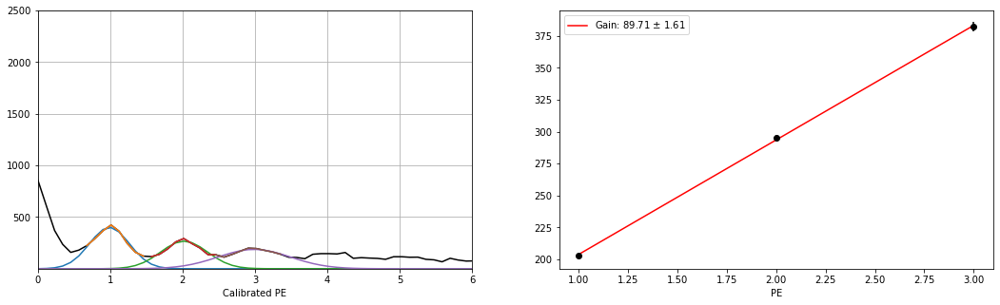

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_29.h5
Guess:  [418, 205.0375457875458, 10]
Params:  [384.9524158  202.36742695  24.85949651]
Guess:  [260, 295.0540293040293, 10]
Params:  [249.95593474 295.03073207  31.72282716]
Guess:  [207, 395.0723443223443, 10]
Params:  [199.80559315 387.17181545  37.19144571]
[92.40219426 -1.1910136 ]


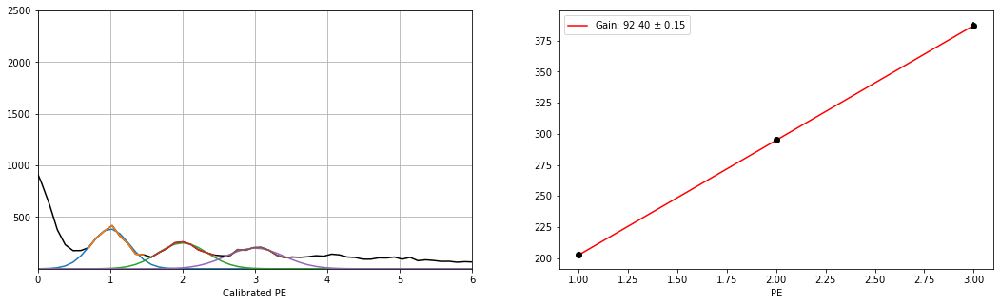

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_28.h5
Guess:  [428, 205.0375457875458, 10]
Params:  [400.75227825 201.9450187   25.48708135]
Guess:  [287, 295.0540293040293, 10]
Params:  [262.70267765 291.6207992   32.58374033]
Guess:  [229, 385.0705128205128, 10]
Params:  [210.94165926 384.87768503  36.37128333]
[91.46633319 -1.20133639]


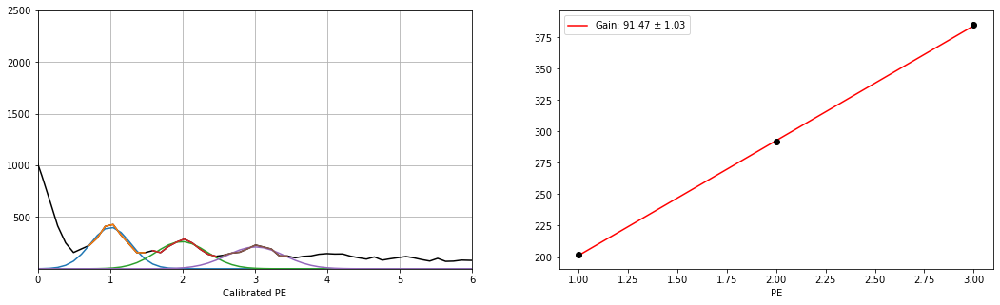

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_27.h5
Guess:  [415, 205.0375457875458, 10]
Params:  [385.50465795 201.62488305  24.54174077]
Guess:  [293, 295.0540293040293, 10]
Params:  [268.70518075 293.99435286  29.16428662]
Guess:  [213, 385.0705128205128, 10]
Params:  [195.97031541 383.90263905  35.01361449]
[91.13887802 -1.21678261]


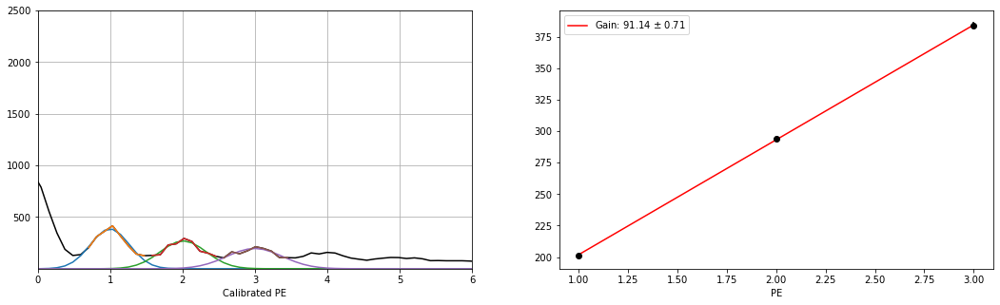

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_26.h5
Guess:  [398, 205.0375457875458, 10]
Params:  [373.0954297  202.40940185  26.12548793]
Guess:  [271, 295.0540293040293, 10]
Params:  [250.46096908 293.24345686  33.0323066 ]
Guess:  [195, 385.0705128205128, 10]
Params:  [176.20444803 388.81264665  51.11230321]
[93.20162239 -1.16326935]


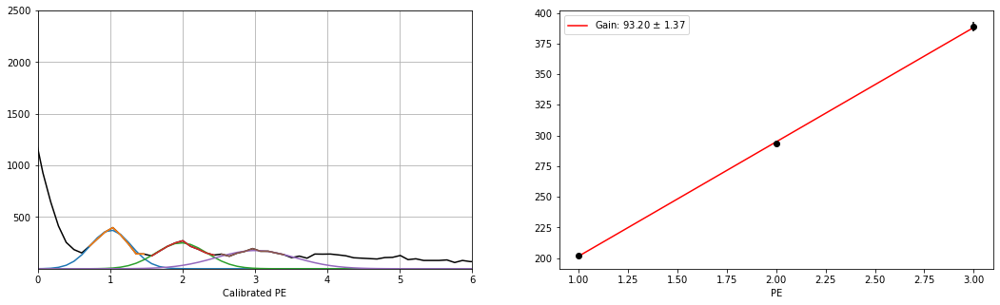

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_25.h5
Guess:  [386, 205.0375457875458, 10]
Params:  [364.93164364 203.87775146  26.98687916]
Guess:  [277, 295.0540293040293, 10]
Params:  [255.30549391 294.10154657  31.80321784]
Guess:  [190, 375.06868131868134, 10]
Params:  [184.90331632 382.51684274  44.69664763]
[89.31954564 -1.28594051]


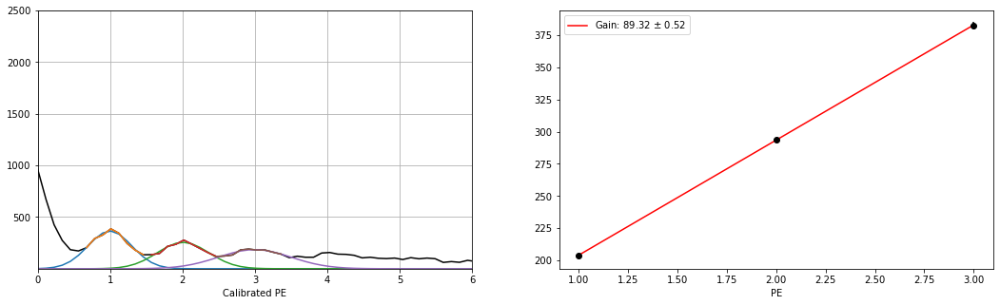

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_24.h5
Guess:  [405, 205.0375457875458, 10]
Params:  [396.7514592  202.45908568  25.36436558]
Guess:  [262, 295.0540293040293, 10]
Params:  [253.10250089 294.73653832  31.76574495]
Guess:  [211, 375.06868131868134, 10]
Params:  [206.42002708 380.99611993  39.05193226]
[89.26851706 -1.27921412]


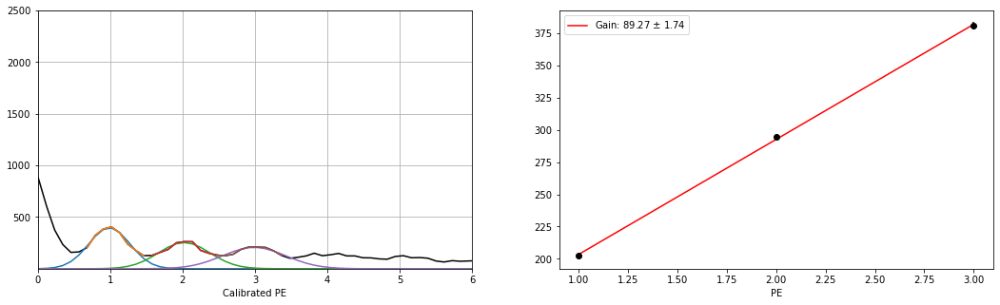

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_23.h5
Guess:  [458, 195.03571428571428, 10]
Params:  [443.20683578 200.35607994  23.53074855]
Guess:  [304, 295.0540293040293, 10]
Params:  [281.50152404 291.89416259  30.26277617]
Guess:  [226, 375.06868131868134, 10]
Params:  [207.6491279  381.78086247  38.25294786]
[90.71239126 -1.21172993]


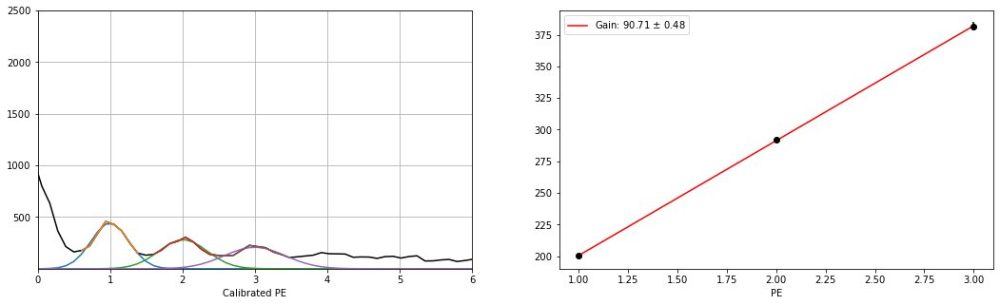

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_22.h5
Guess:  [395, 205.0375457875458, 10]
Params:  [388.01122786 201.4201136   24.42346689]
Guess:  [286, 295.0540293040293, 10]
Params:  [267.83027864 294.12092356  28.72228385]
Guess:  [213, 385.0705128205128, 10]
Params:  [206.28479309 382.0578581   34.74367719]
[90.31887233 -1.2388908 ]


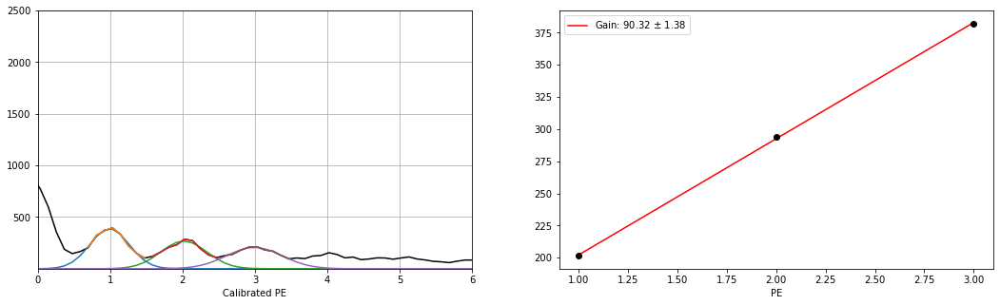

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_21.h5
Guess:  [398, 195.03571428571428, 10]
Params:  [400.536802   199.97505553  25.32540629]
Guess:  [261, 285.05219780219784, 10]
Params:  [249.64878811 291.30832196  33.37608824]
Guess:  [192, 375.06868131868134, 10]
Params:  [188.06386642 380.60663573  36.57515624]
[90.31579012 -1.21793126]


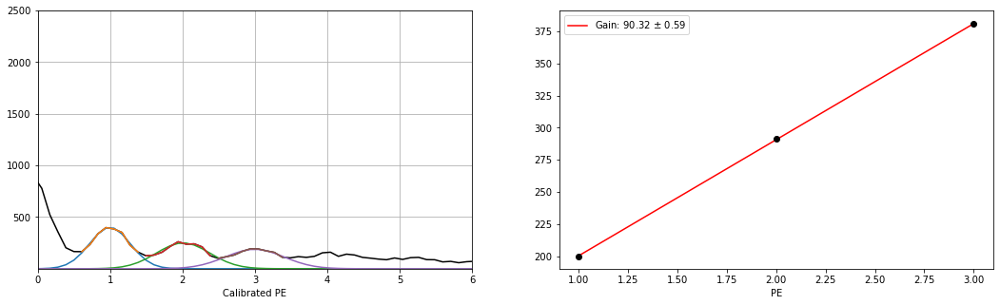

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_20.h5
Guess:  [384, 205.0375457875458, 10]
Params:  [370.60427659 202.32849375  28.18012808]
Guess:  [287, 305.0558608058608, 10]
Params:  [281.9332669  295.14683804  30.65063207]
Guess:  [220, 385.0705128205128, 10]
Params:  [207.62708943 388.25960123  36.67258481]
[92.96555374 -1.17585348]


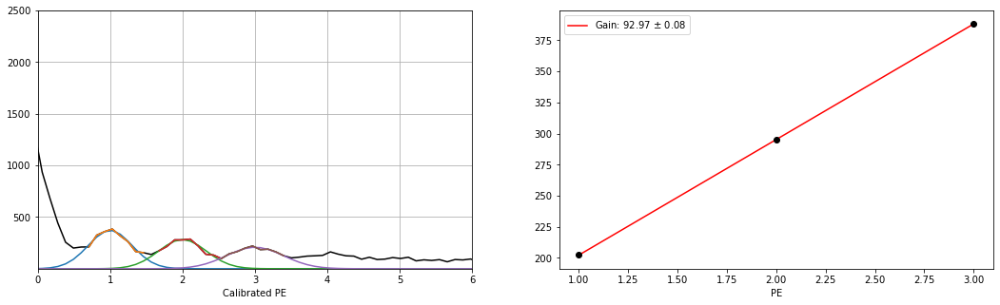

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_19.h5
Guess:  [404, 205.0375457875458, 10]
Params:  [394.8379209  202.80541108  26.34445635]
Guess:  [268, 285.05219780219784, 10]
Params:  [246.81381043 290.32712519  36.46218143]
Guess:  [204, 385.0705128205128, 10]
Params:  [189.90035629 383.79502343  39.26311991]
[90.49480616 -1.23012114]


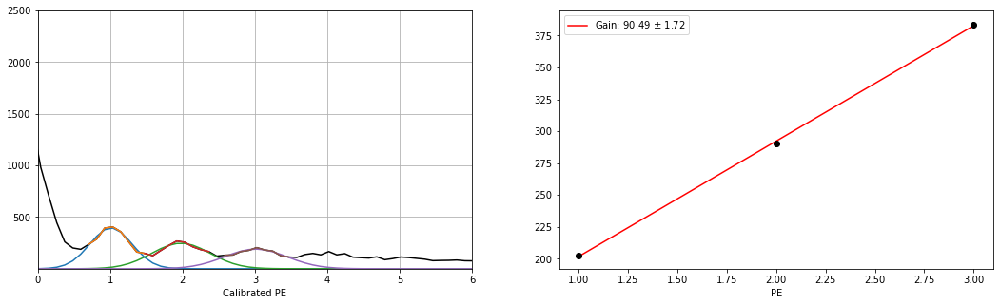

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_18.h5
Guess:  [415, 195.03571428571428, 10]
Params:  [414.68192596 201.19317272  25.78487003]
Guess:  [295, 295.0540293040293, 10]
Params:  [281.32488648 294.2791272   32.85115209]
Guess:  [228, 385.0705128205128, 10]
Params:  [206.88876908 384.01390428  37.60489269]
[91.41036579 -1.20709873]


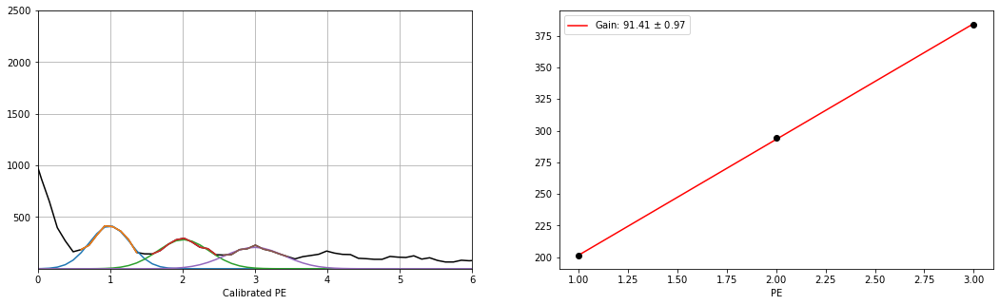

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_17.h5
Guess:  [442, 195.03571428571428, 10]
Params:  [427.46097666 200.21367051  23.47438373]
Guess:  [290, 295.0540293040293, 10]
Params:  [274.98290467 292.49430461  31.76260819]
Guess:  [220, 385.0705128205128, 10]
Params:  [208.53552237 385.15891094  35.89099272]
[92.47262021 -1.16442094]


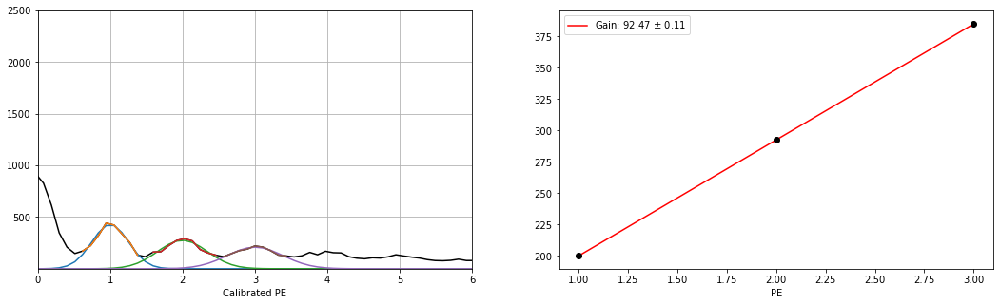

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_16.h5
Guess:  [448, 205.0375457875458, 10]
Params:  [412.78264832 201.19551448  24.77901241]
Guess:  [291, 295.0540293040293, 10]
Params:  [274.74742632 292.91102622  32.45467633]
Guess:  [221, 385.0705128205128, 10]
Params:  [204.83450879 385.45979388  34.51113748]
[92.1321397  -1.18226386]


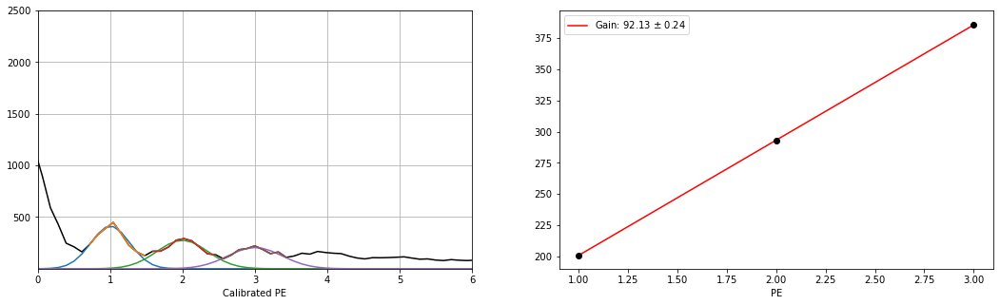

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_15.h5
Guess:  [402, 205.0375457875458, 10]
Params:  [407.33468749 201.60725456  23.65861912]
Guess:  [272, 285.05219780219784, 10]
Params:  [251.74163379 289.59912399  32.35011679]
Guess:  [210, 375.06868131868134, 10]
Params:  [200.09033479 382.33065543  41.12950419]
[90.36170042 -1.22237198]


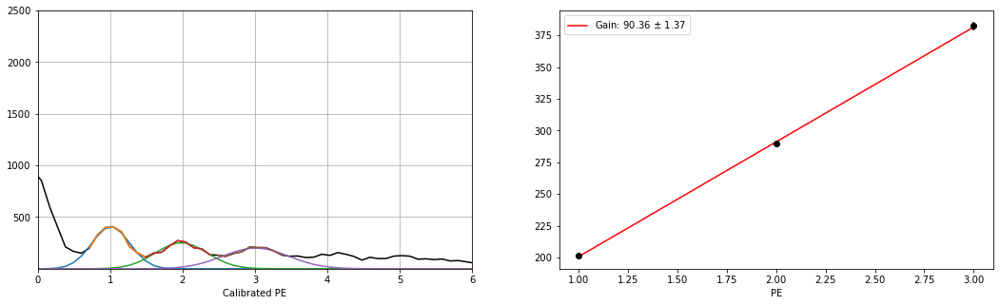

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_14.h5
Guess:  [411, 205.0375457875458, 10]
Params:  [404.72424058 200.26409331  25.90297158]
Guess:  [298, 295.0540293040293, 10]
Params:  [286.99020301 294.26535637  28.89290322]
Guess:  [205, 385.0705128205128, 10]
Params:  [204.5792134  383.95200198  35.91099671]
[91.84395435 -1.18831166]


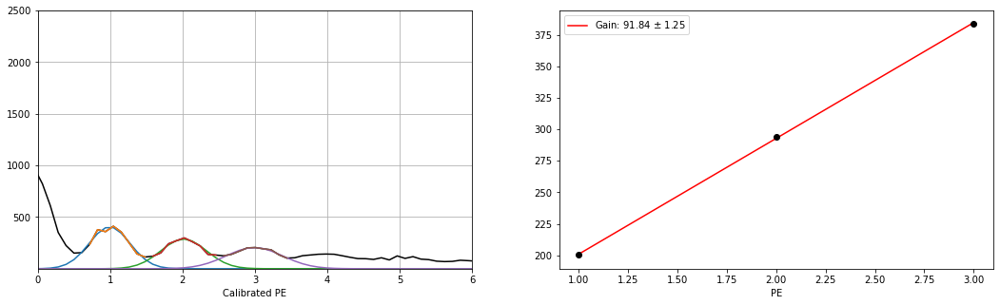

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_13.h5
Guess:  [399, 195.03571428571428, 10]
Params:  [400.33105195 201.03776562  24.01496012]
Guess:  [289, 295.0540293040293, 10]
Params:  [278.10517331 293.21853806  29.58136437]
Guess:  [204, 395.0723443223443, 10]
Params:  [194.75141341 388.8494504   41.34655902]
[93.90584246 -1.13472066]


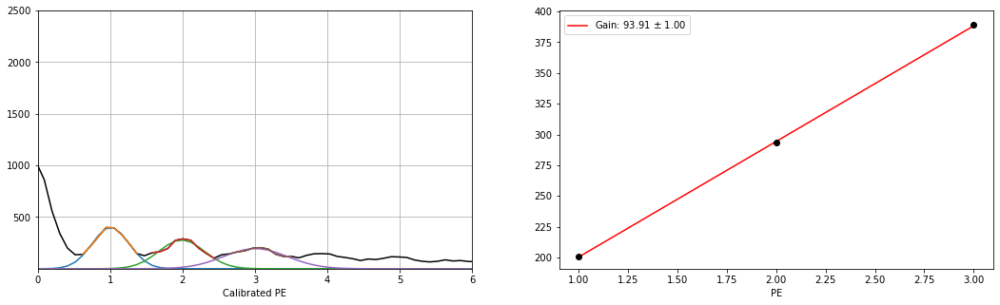

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_12.h5
Guess:  [434, 205.0375457875458, 10]
Params:  [428.51080489 201.9272399   23.57449639]
Guess:  [305, 295.0540293040293, 10]
Params:  [278.8820188  294.20683033  29.1307739 ]
Guess:  [239, 385.0705128205128, 10]
Params:  [211.5871915  385.97649858  35.04854195]
[92.02462935 -1.1951974 ]


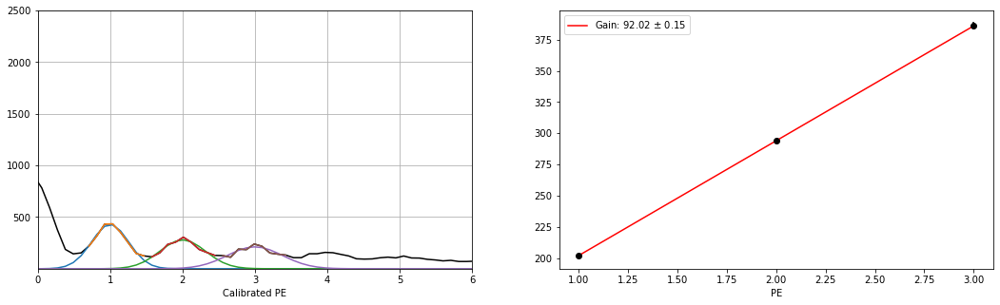

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_11.h5
Guess:  [431, 205.0375457875458, 10]
Params:  [420.00941381 202.63809017  24.49021564]
Guess:  [310, 295.0540293040293, 10]
Params:  [263.17876632 292.76445449  31.03094713]
Guess:  [213, 395.0723443223443, 10]
Params:  [201.31290453 386.41852983  37.61519598]
[91.89021988 -1.19882092]


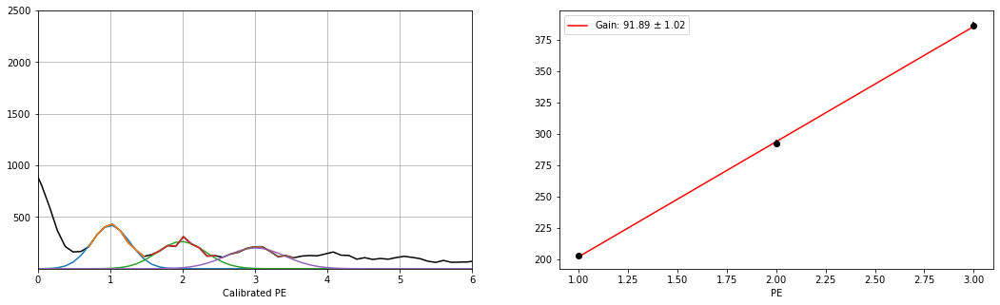

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_10.h5
Guess:  [433, 205.0375457875458, 10]
Params:  [414.09263559 201.44541079  25.06528048]
Guess:  [265, 295.0540293040293, 10]
Params:  [252.24999647 293.45217667  33.36837707]
Guess:  [194, 385.0705128205128, 10]
Params:  [183.41837617 382.84103418  39.34610778]
[90.69781175 -1.2258721 ]


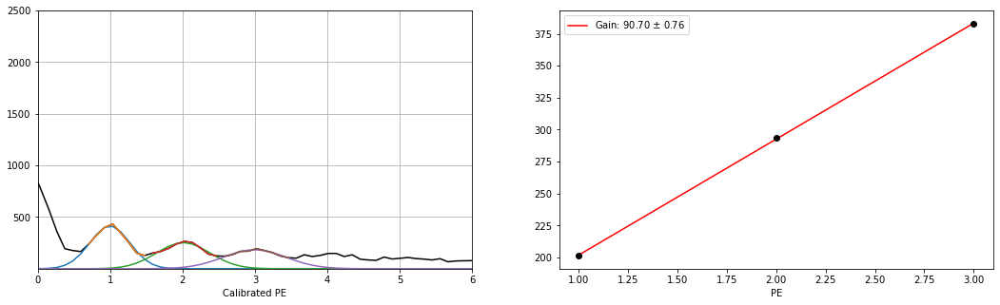

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_9.h5
Guess:  [445, 205.0375457875458, 10]
Params:  [423.02304084 201.49948921  23.61332266]
Guess:  [299, 295.0540293040293, 10]
Params:  [276.4368984  291.91372874  29.84624081]
Guess:  [215, 385.0705128205128, 10]
Params:  [206.08463367 382.70238731  35.96999685]
[90.60144903 -1.22333184]


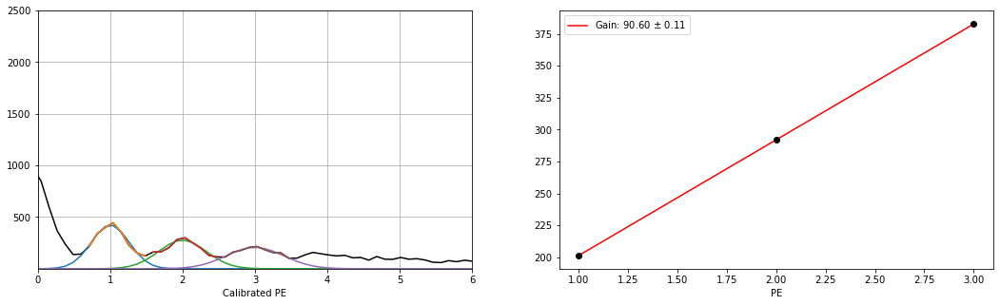

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_8.h5
Guess:  [437, 205.0375457875458, 10]
Params:  [419.98641154 202.68225364  23.773593  ]
Guess:  [286, 305.0558608058608, 10]
Params:  [257.81651061 295.78727669  33.6430194 ]
Guess:  [208, 395.0723443223443, 10]
Params:  [190.41545803 388.72275475  38.87425613]
[93.02025056 -1.1792084 ]


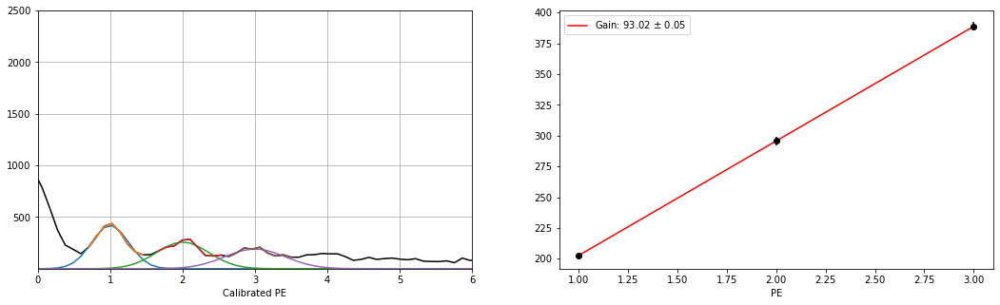

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_7.h5
Guess:  [405, 205.0375457875458, 10]
Params:  [392.55315319 202.10472241  25.48047704]
Guess:  [291, 295.0540293040293, 10]
Params:  [275.3076796  294.81173911  29.20091597]
Guess:  [211, 375.06868131868134, 10]
Params:  [195.90293185 383.81187968  37.64519357]
[90.85357863 -1.2313104 ]


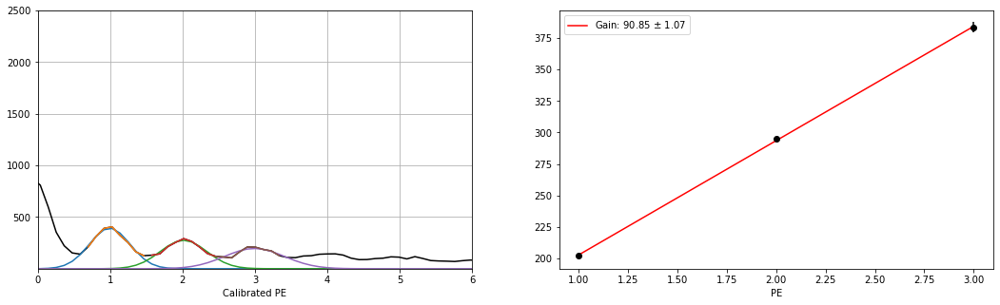

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_6.h5
Guess:  [379, 205.0375457875458, 10]
Params:  [379.83603187 202.54591865  25.89086268]
Guess:  [262, 295.0540293040293, 10]
Params:  [257.5178895  293.21542826  28.87913834]
Guess:  [216, 385.0705128205128, 10]
Params:  [189.87740457 385.63205687  37.95551177]
[91.54306911 -1.20939427]


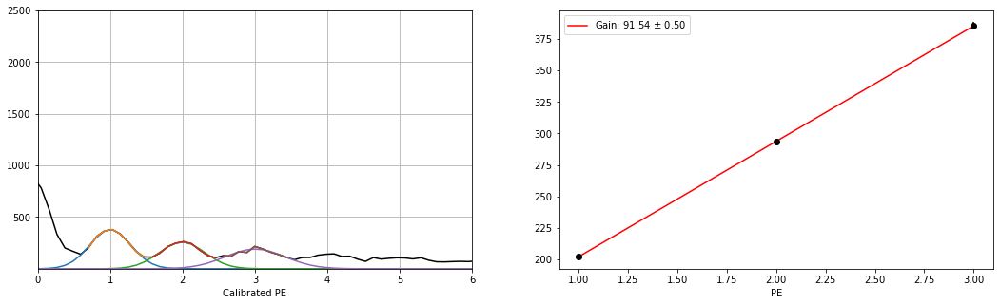

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_5.h5
Guess:  [390, 205.0375457875458, 10]
Params:  [379.27796945 200.68377447  25.04421941]
Guess:  [283, 295.0540293040293, 10]
Params:  [274.45057944 294.245787    27.63054124]
Guess:  [217, 385.0705128205128, 10]
Params:  [196.58425107 384.08312055  37.59516132]
[91.69967308 -1.19525924]


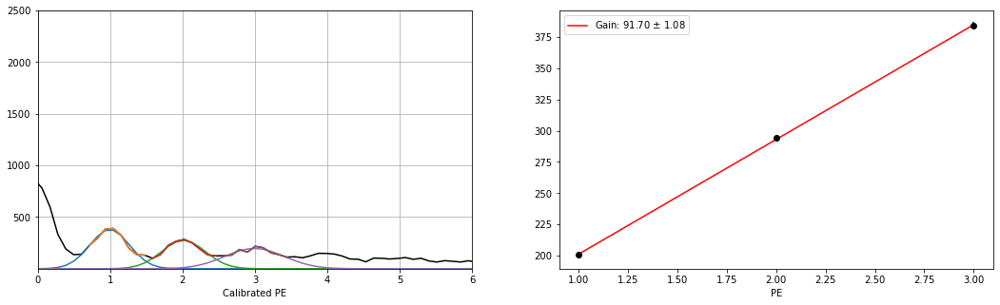

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_4.h5
Guess:  [399, 195.03571428571428, 10]
Params:  [392.26164505 200.91058296  24.05077201]
Guess:  [274, 285.05219780219784, 10]
Params:  [268.90545371 290.90027409  28.23423566]
Guess:  [203, 375.06868131868134, 10]
Params:  [194.08957606 381.35917557  37.66607631]
[90.22429631 -1.2259235 ]


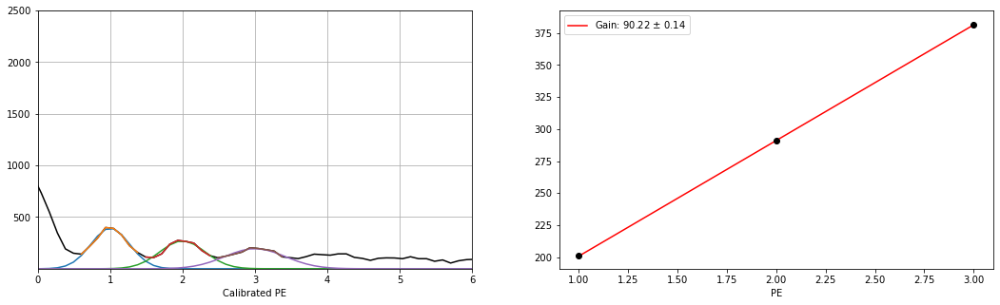

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_3.h5
Guess:  [429, 205.0375457875458, 10]
Params:  [413.27502392 200.82198644  24.13329984]
Guess:  [278, 295.0540293040293, 10]
Params:  [269.83433015 292.02548052  31.85278057]
Guess:  [207, 375.06868131868134, 10]
Params:  [199.87625996 384.61260202  39.69280919]
[91.89530782 -1.18282507]


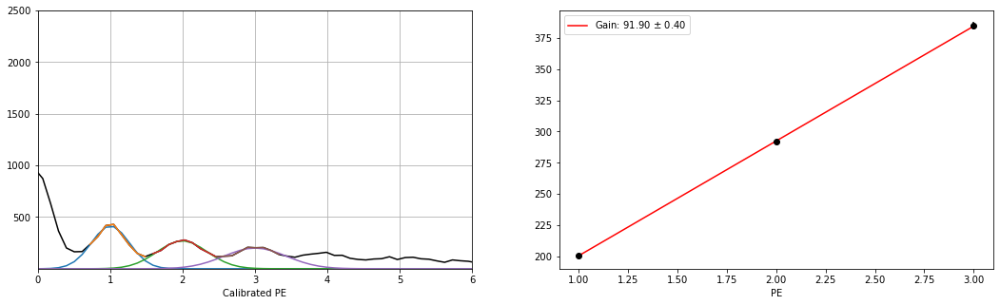

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_2.h5
Guess:  [416, 195.03571428571428, 10]
Params:  [405.26337957 200.9354829   24.93349518]
Guess:  [279, 285.05219780219784, 10]
Params:  [266.64353815 291.40511602  33.26244731]
Guess:  [238, 375.06868131868134, 10]
Params:  [207.69268717 383.29633644  38.90925665]
[91.18042676 -1.20111441]


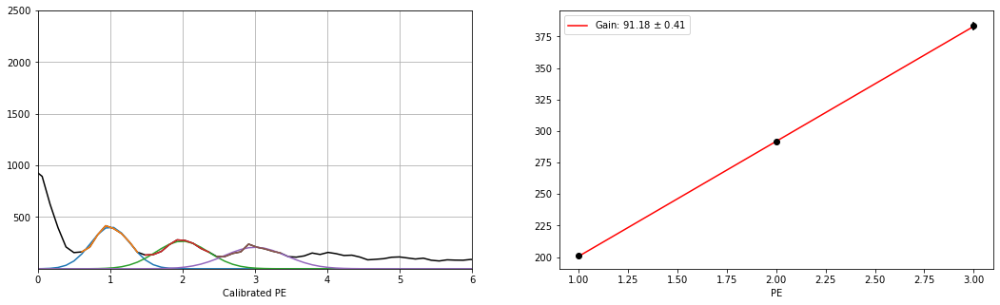

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_1.h5
Guess:  [364, 205.0375457875458, 10]
Params:  [357.97275539 202.26295894  31.84131758]
Guess:  [257, 305.0558608058608, 10]
Params:  [247.66988617 296.11641782  37.62384207]
Guess:  [199, 385.0705128205128, 10]
Params:  [187.29148712 382.45835166  46.79881416]
[90.09769644 -1.25882445]


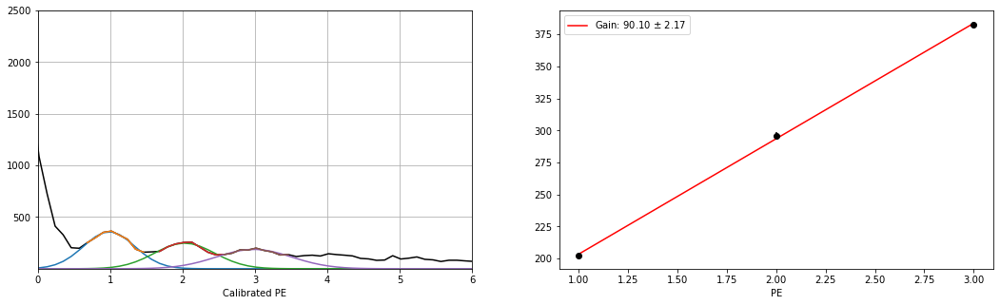

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_0.h5
Guess:  [416, 195.03571428571428, 10]
Params:  [387.30054543 198.68188747  27.56919365]
Guess:  [296, 295.0540293040293, 10]
Params:  [271.79408463 293.61078096  31.43624212]
Guess:  [240, 385.0705128205128, 10]
Params:  [202.6836921  383.83095568  37.3675349 ]
[92.5745341  -1.15466031]


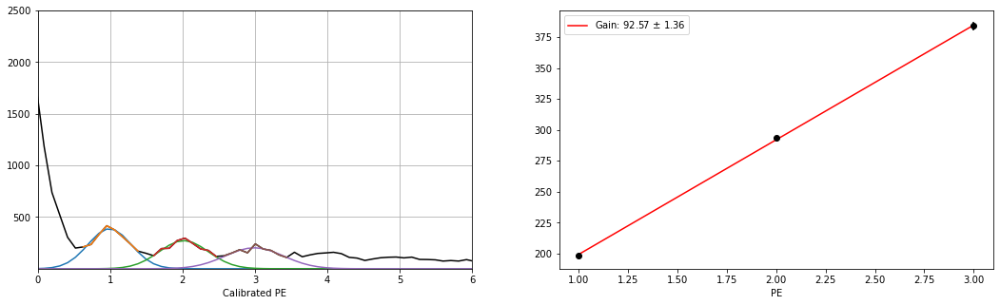

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_33.h5
Guess:  [255, 205.0375457875458, 10]
Params:  [236.28434148 201.6334885   28.49386983]
Guess:  [134, 295.0540293040293, 10]
Params:  [125.62121273 293.97706233  27.79172942]
Guess:  [75, 395.0723443223443, 10]
Params:  [ 74.81997909 394.2396501   39.68751965]
[96.30308076 -1.08003369]


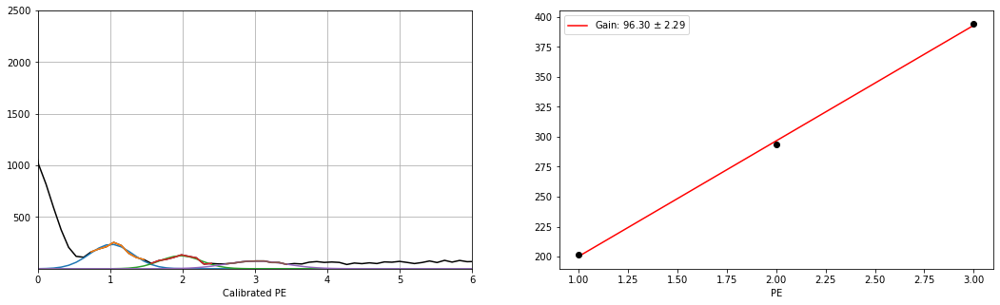

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_32.h5
Guess:  [245, 205.0375457875458, 10]
Params:  [235.32316801 202.25632174  24.02248955]
Guess:  [119, 295.0540293040293, 10]
Params:  [121.60696427 297.84467643  29.45622748]
Guess:  [78, 385.0705128205128, 10]
Params:  [ 75.231262   390.95232987  32.05220441]
[94.34800411 -1.14810874]


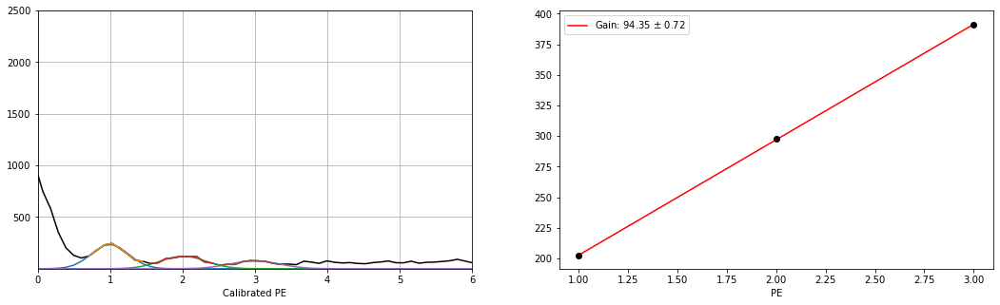

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_31.h5
Guess:  [247, 205.0375457875458, 10]
Params:  [224.60431671 203.01951016  23.52530206]
Guess:  [107, 295.0540293040293, 10]
Params:  [103.70728137 298.23723248  34.48380889]
Guess:  [86, 395.0723443223443, 10]
Params:  [ 74.16960506 395.16521094  34.49710253]
[96.07285035 -1.11021602]


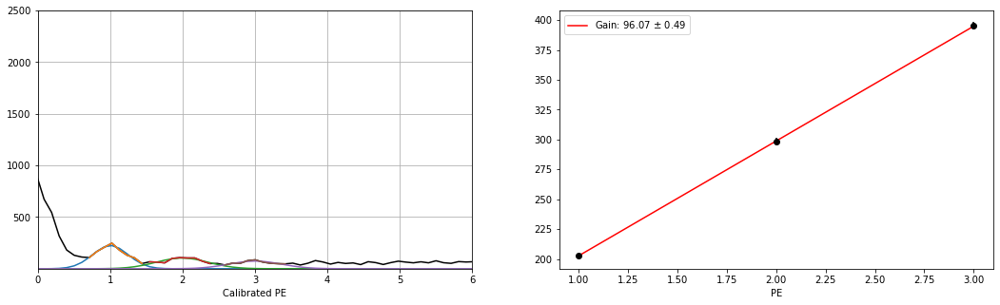

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_30.h5
Guess:  [247, 205.0375457875458, 10]
Params:  [235.85691343 204.4999064   23.85530284]
Guess:  [134, 295.0540293040293, 10]
Params:  [112.21063407 294.22627556  29.14848808]
Guess:  [71, 385.0705128205128, 10]
Params:  [ 65.98053432 391.58591738  41.04861224]
[93.54300544 -1.17255896]


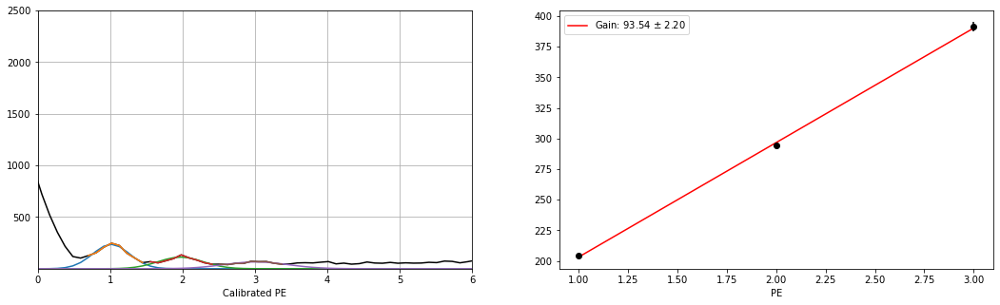

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_29.h5
Guess:  [237, 205.0375457875458, 10]
Params:  [231.80328771 203.19754696  25.30388321]
Guess:  [130, 295.0540293040293, 10]
Params:  [114.87430743 299.50883169  30.54736825]
Guess:  [72, 385.0705128205128, 10]
Params:  [ 67.38888146 392.83149432  43.73663339]
[94.81697366 -1.14830365]


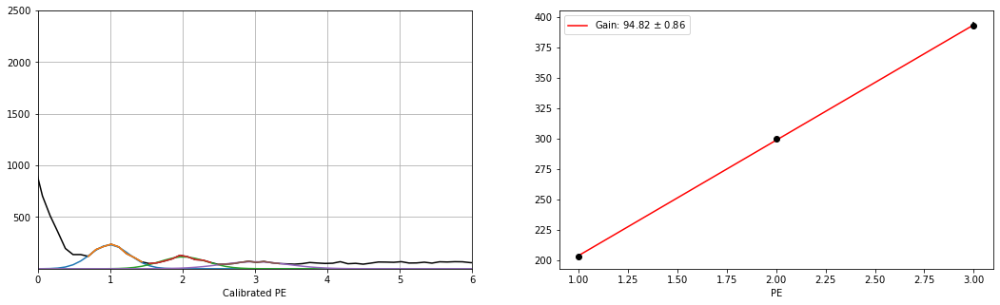

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_28.h5
Guess:  [279, 205.0375457875458, 10]
Params:  [262.72837605 202.81656115  23.2096323 ]
Guess:  [113, 295.0540293040293, 10]
Params:  [106.92274265 296.69081073  35.78585596]
Guess:  [90, 395.0723443223443, 10]
Params:  [ 76.39335804 390.22244462  30.55696519]
[93.70294174 -1.16507252]


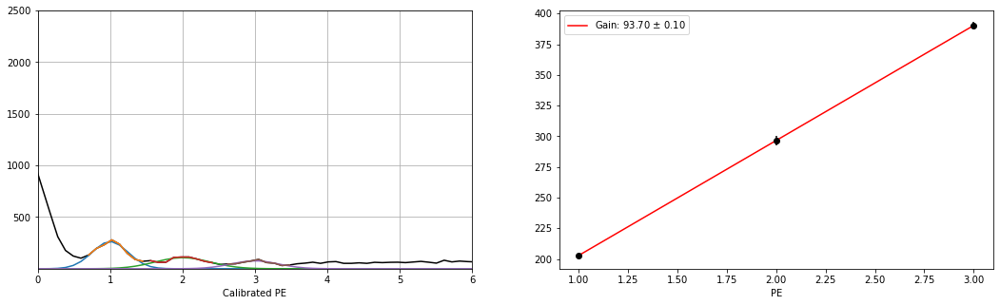

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_27.h5
Guess:  [252, 195.03571428571428, 10]
Params:  [239.89239718 199.36255164  23.17640523]
Guess:  [116, 295.0540293040293, 10]
Params:  [111.90420534 296.12541944  28.52269746]
Guess:  [79, 395.0723443223443, 10]
Params:  [ 70.95977802 399.13919313  43.77002634]
[99.88832067 -0.98542465]


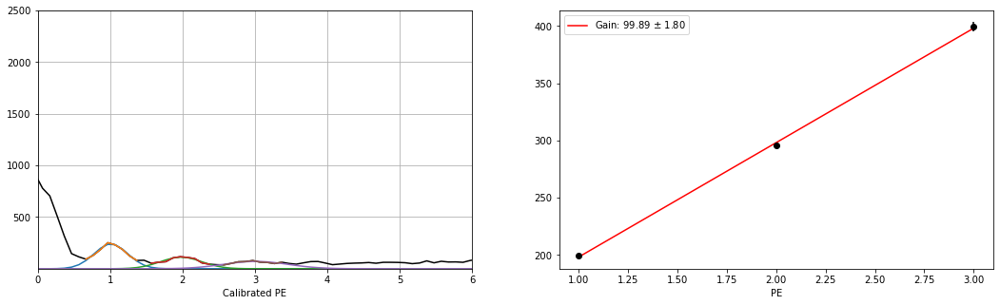

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_26.h5
Guess:  [232, 195.03571428571428, 10]
Params:  [231.95462692 201.37674923  27.86545455]
Guess:  [117, 285.05219780219784, 10]
Params:  [ 97.31512125 289.78909732  42.70194362]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 73.25503971 389.89419631  44.69068738]
[94.25872356 -1.11575067]


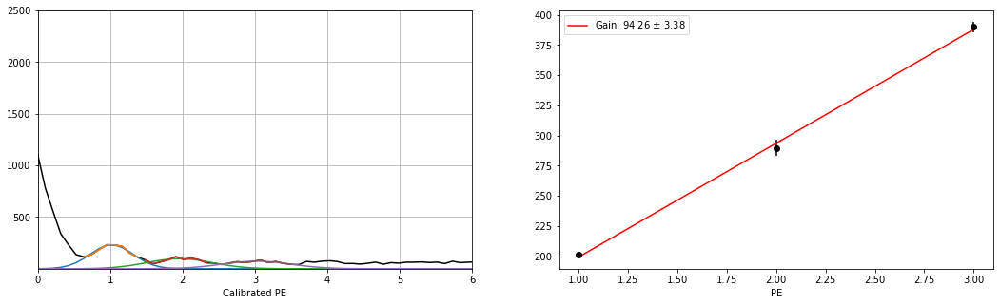

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_25.h5
Guess:  [231, 205.0375457875458, 10]
Params:  [213.83520017 203.87174713  26.23887444]
Guess:  [131, 305.0558608058608, 10]
Params:  [120.13921677 298.17358753  29.40548572]
Guess:  [79, 395.0723443223443, 10]
Params:  [ 76.06558735 395.38593311  34.60504888]
[95.757093   -1.12398535]


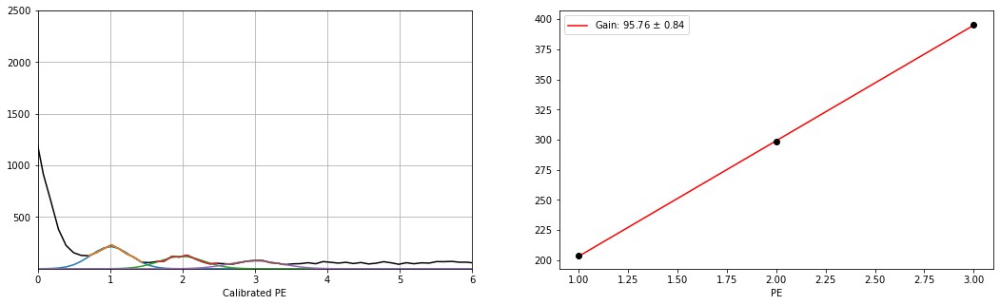

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_24.h5
Guess:  [244, 205.0375457875458, 10]
Params:  [241.8135773  202.94031536  24.22082642]
Guess:  [118, 295.0540293040293, 10]
Params:  [113.02129176 295.69479134  31.22701397]
Guess:  [91, 395.0723443223443, 10]
Params:  [ 77.66955761 393.51467153  34.82016377]
[95.28717809 -1.1209158 ]


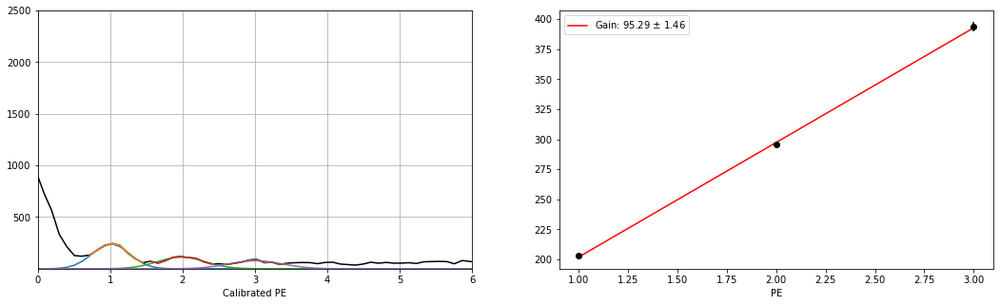

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_23.h5
Guess:  [275, 195.03571428571428, 10]
Params:  [258.565201   200.41179014  27.29684806]
Guess:  [124, 305.0558608058608, 10]
Params:  [119.59950609 298.15829721  32.35428024]
Guess:  [95, 395.0723443223443, 10]
Params:  [ 82.87968741 386.59231691  38.71654882]
[93.09026349 -1.16954882]


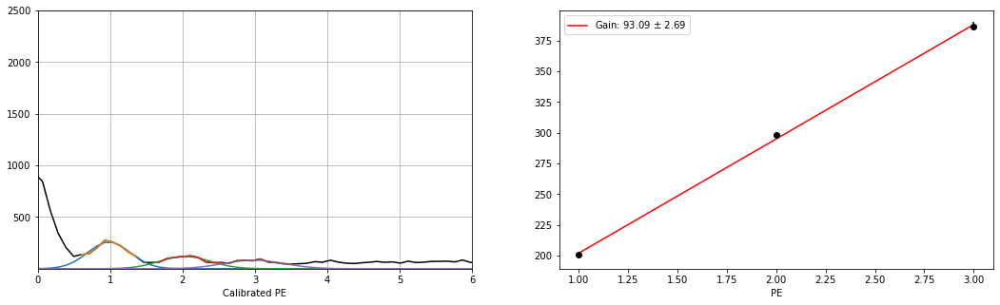

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_22.h5
Guess:  [230, 205.0375457875458, 10]
Params:  [239.00737827 199.9847052   23.50417473]
Guess:  [129, 305.0558608058608, 10]
Params:  [110.2629609  297.99372136  30.70333918]
Guess:  [83, 395.0723443223443, 10]
Params:  [ 74.03095772 391.75329512  36.29474119]
[95.88429499 -1.09307422]


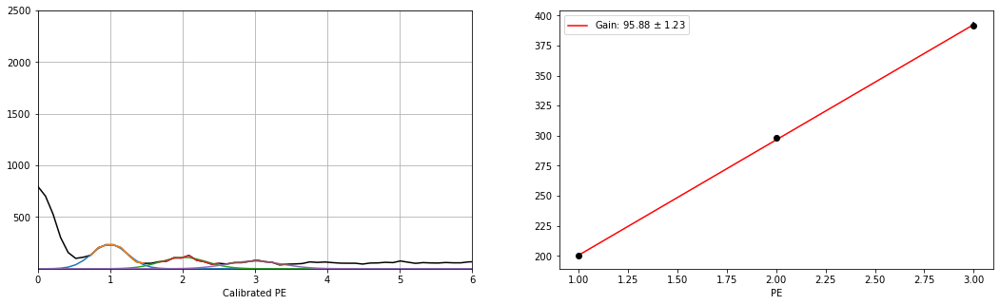

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_21.h5
Guess:  [264, 205.0375457875458, 10]
Params:  [247.20767854 202.63587279  24.58854471]
Guess:  [124, 295.0540293040293, 10]
Params:  [114.54605524 292.49151387  29.35467491]
Guess:  [100, 385.0705128205128, 10]
Params:  [ 83.51395286 386.55964588  30.11630023]
[91.96188655 -1.1958422 ]


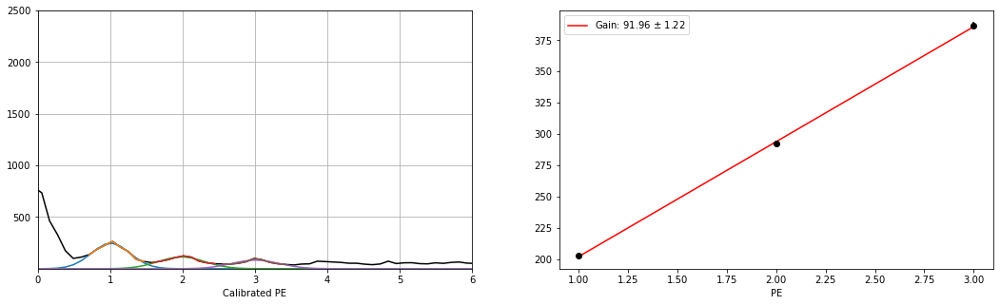

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_20.h5
Guess:  [244, 195.03571428571428, 10]
Params:  [235.44624663 202.55501108  27.98879213]
Guess:  [121, 295.0540293040293, 10]
Params:  [116.58102864 299.1539134   32.91904476]
Guess:  [78, 385.0705128205128, 10]
Params:  [ 70.9515058  394.61118345  40.41819765]
[96.0280862  -1.11131234]


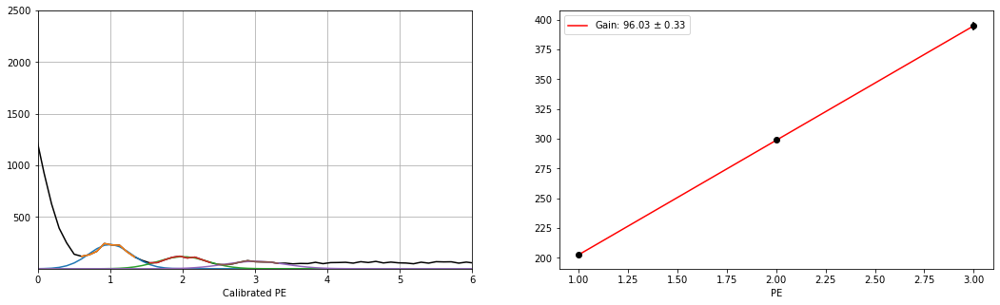

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_19.h5
Guess:  [223, 195.03571428571428, 10]
Params:  [218.22936036 200.82858914  29.82569396]
Guess:  [113, 305.0558608058608, 10]
Params:  [108.74990486 297.45451431  35.19968021]
Guess:  [77, 385.0705128205128, 10]
Params:  [ 67.28856316 384.91534676  40.43025706]
[92.0433786  -1.19848628]


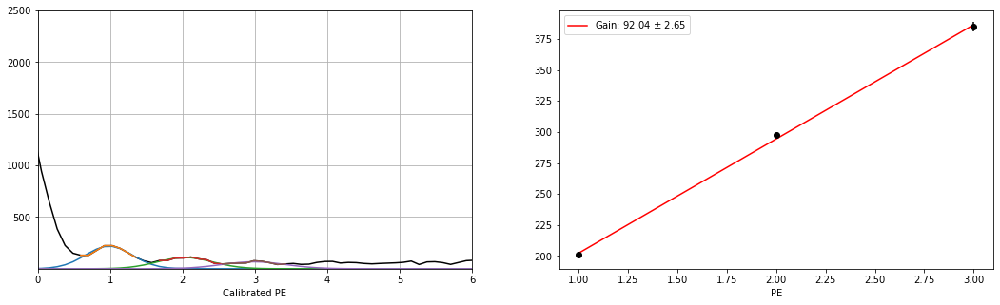

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_18.h5
Guess:  [258, 205.0375457875458, 10]
Params:  [243.65793481 201.94733501  24.35131907]
Guess:  [118, 295.0540293040293, 10]
Params:  [114.1870288  296.04520987  30.40457717]
Guess:  [77, 395.0723443223443, 10]
Params:  [ 72.65684998 387.59855776  39.43419655]
[92.82561144 -1.18012486]


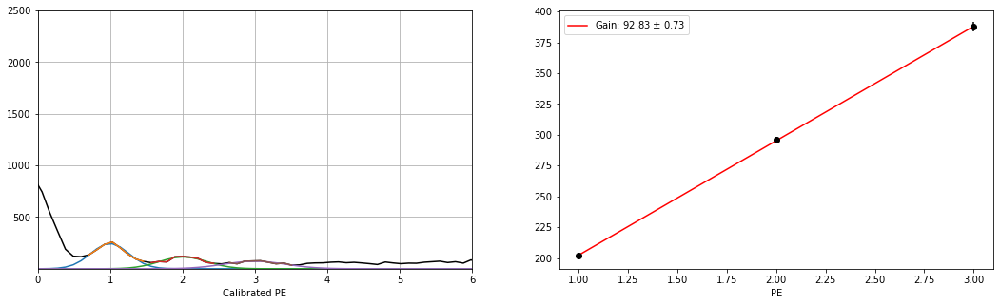

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_17.h5
Guess:  [251, 205.0375457875458, 10]
Params:  [248.73530033 203.90390729  24.02572468]
Guess:  [123, 295.0540293040293, 10]
Params:  [116.65227031 298.11351841  30.83019264]
Guess:  [83, 395.0723443223443, 10]
Params:  [ 76.08740647 392.63163907  37.27455329]
[94.3638659  -1.16028124]


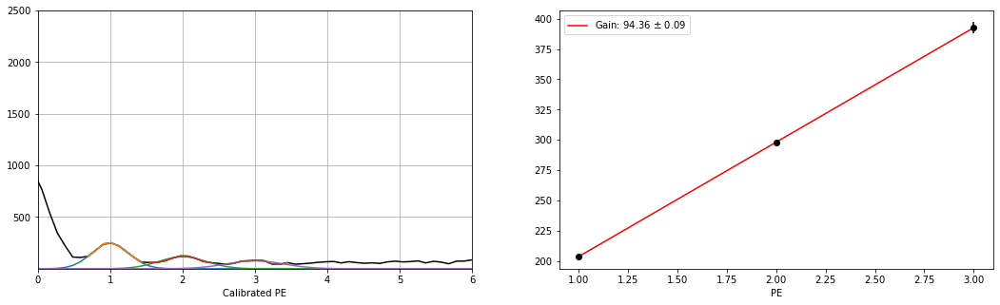

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_16.h5
Guess:  [284, 205.0375457875458, 10]
Params:  [264.02076176 204.36568518  22.43325585]
Guess:  [121, 285.05219780219784, 10]
Params:  [112.03398119 293.84673951  31.3912937 ]
Guess:  [78, 375.06868131868134, 10]
Params:  [ 67.90664462 387.34038311  41.69925093]
[91.487349   -1.22650369]


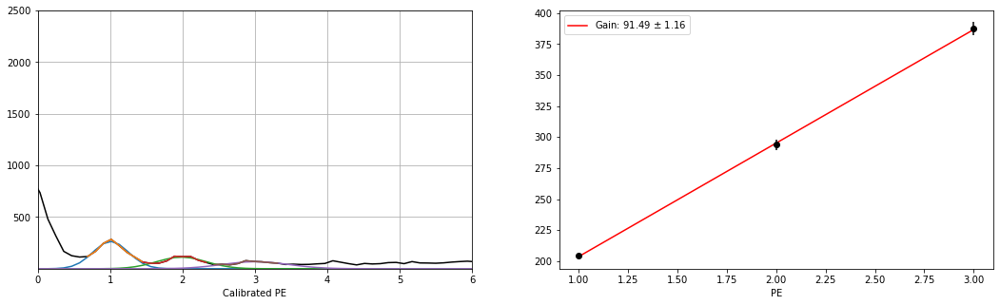

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_15.h5
Guess:  [264, 205.0375457875458, 10]
Params:  [247.44647138 201.73547581  24.68576938]
Guess:  [117, 295.0540293040293, 10]
Params:  [112.0676364  295.36878073  29.75855881]
Guess:  [76, 395.0723443223443, 10]
Params:  [ 74.3690728  396.04149666  38.98418495]
[97.15301054 -1.06439553]


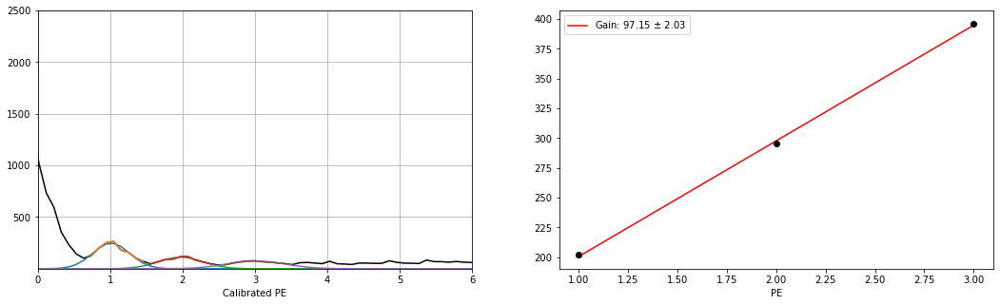

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_14.h5
Guess:  [247, 205.0375457875458, 10]
Params:  [233.79826085 203.68115228  23.71144679]
Guess:  [126, 285.05219780219784, 10]
Params:  [111.93450946 295.11274918  33.63030219]
Guess:  [77, 405.0741758241758, 10]
Params:  [ 72.99105748 392.49883623  46.77578292]
[94.40884199 -1.14692536]


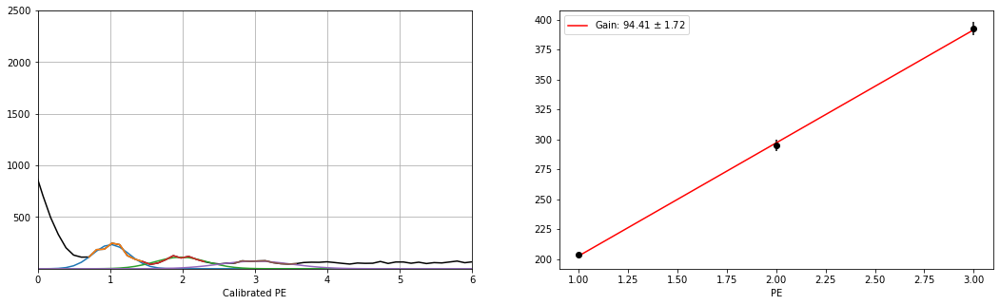

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_13.h5
Guess:  [237, 205.0375457875458, 10]
Params:  [237.14637068 202.94553297  24.77989469]
Guess:  [129, 295.0540293040293, 10]
Params:  [121.00559716 294.59390602  28.91192427]
Guess:  [76, 385.0705128205128, 10]
Params:  [ 72.94775617 388.56989011  42.32164452]
[92.81217851 -1.18244633]


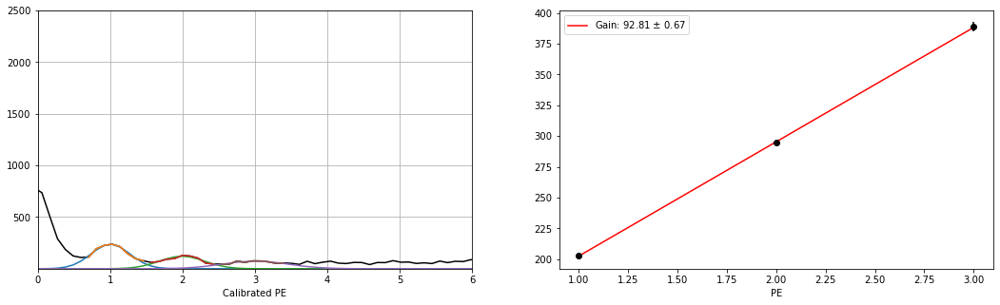

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_12.h5
Guess:  [262, 205.0375457875458, 10]
Params:  [263.44119063 202.60039091  22.82243048]
Guess:  [116, 305.0558608058608, 10]
Params:  [110.42541363 297.97236048  32.85980938]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 74.49814344 395.65938569  35.86062295]
[96.52949736 -1.09484721]


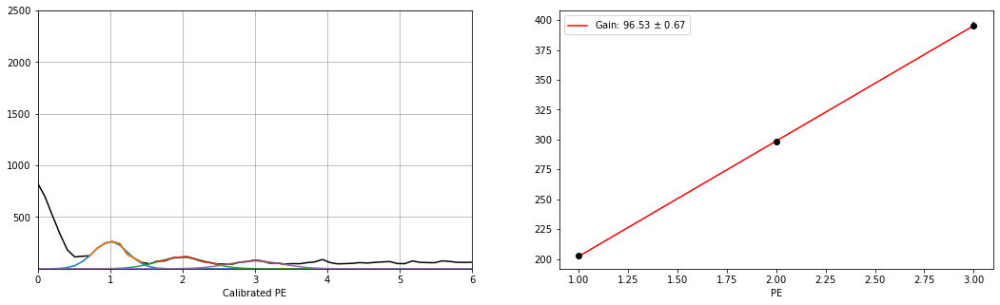

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_11.h5
Guess:  [268, 205.0375457875458, 10]
Params:  [260.36062772 202.80550269  23.38056035]
Guess:  [134, 295.0540293040293, 10]
Params:  [128.63711432 294.745862    27.31636343]
Guess:  [86, 395.0723443223443, 10]
Params:  [ 74.69547428 391.17620236  39.34579683]
[94.18534978 -1.14531425]


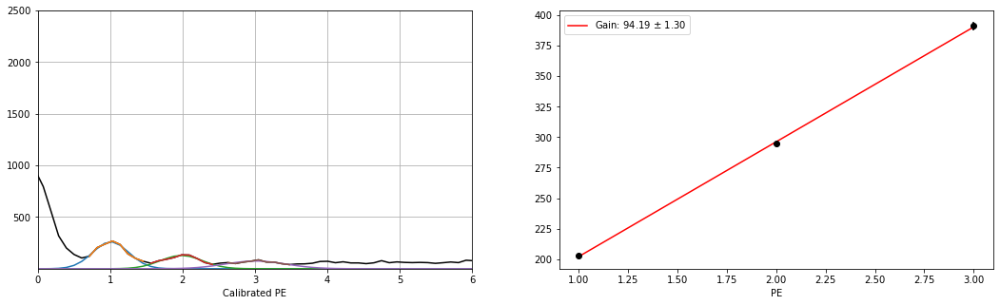

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_10.h5
Guess:  [250, 205.0375457875458, 10]
Params:  [239.71506936 201.18312345  24.53621869]
Guess:  [115, 295.0540293040293, 10]
Params:  [108.97607587 297.56742655  31.79497491]
Guess:  [92, 395.0723443223443, 10]
Params:  [ 84.30711422 392.44399608  31.04092291]
[95.63043633 -1.10638391]


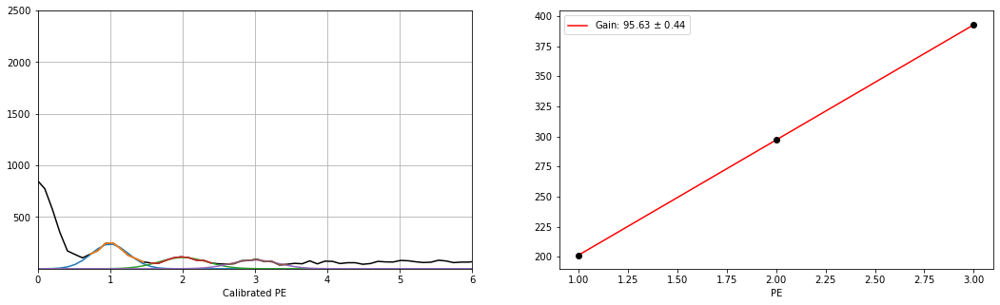

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_9.h5
Guess:  [260, 195.03571428571428, 10]
Params:  [252.44115247 201.76666662  25.80843741]
Guess:  [145, 295.0540293040293, 10]
Params:  [117.41811351 294.72334462  29.06073148]
Guess:  [100, 395.0723443223443, 10]
Params:  [ 91.00018962 390.97689659  31.13442168]
[94.60511498 -1.12691658]


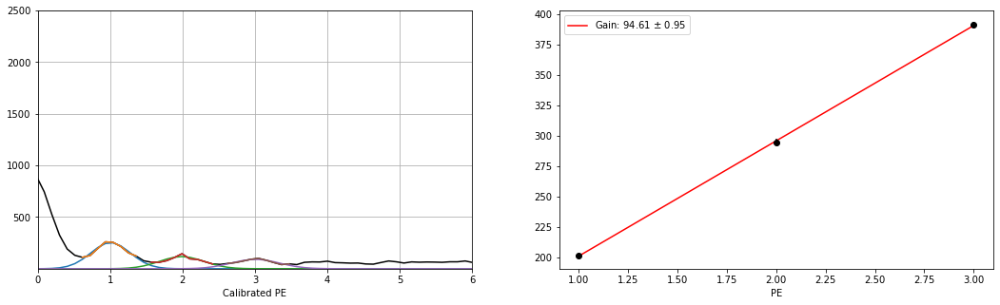

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_8.h5
Guess:  [242, 195.03571428571428, 10]
Params:  [239.71333845 201.96977392  26.8009966 ]
Guess:  [120, 295.0540293040293, 10]
Params:  [118.23380739 297.56424165  30.30736989]
Guess:  [99, 395.0723443223443, 10]
Params:  [ 75.28167181 387.40121212  41.94677204]
[92.71571897 -1.18872656]


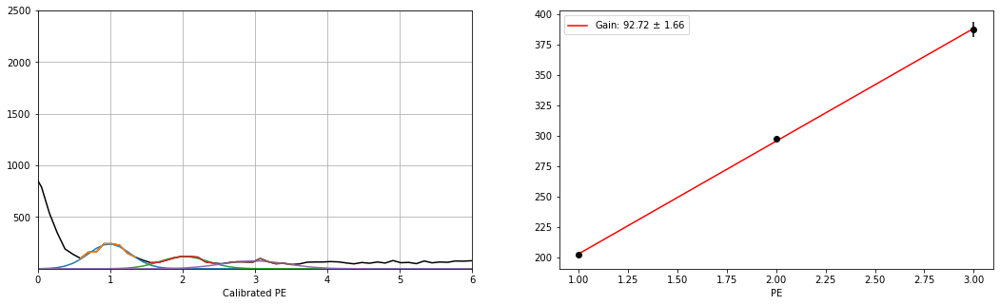

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_7.h5
Guess:  [248, 205.0375457875458, 10]
Params:  [242.20066833 201.30987956  24.77023441]
Guess:  [130, 295.0540293040293, 10]
Params:  [114.1125652  295.37312372  27.54709906]
Guess:  [88, 395.0723443223443, 10]
Params:  [ 72.10878957 388.94631208  40.8215665 ]
[93.81821625 -1.14661463]


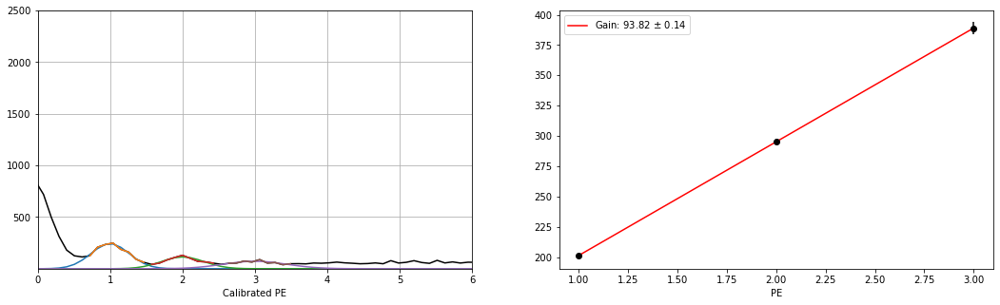

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_6.h5
Guess:  [259, 205.0375457875458, 10]
Params:  [242.80329987 201.42539253  24.18028824]
Guess:  [126, 295.0540293040293, 10]
Params:  [118.38553156 295.33904178  26.7330872 ]
Guess:  [75, 395.0723443223443, 10]
Params:  [ 73.19362433 390.67726462  37.35824309]
[94.62593606 -1.12613975]


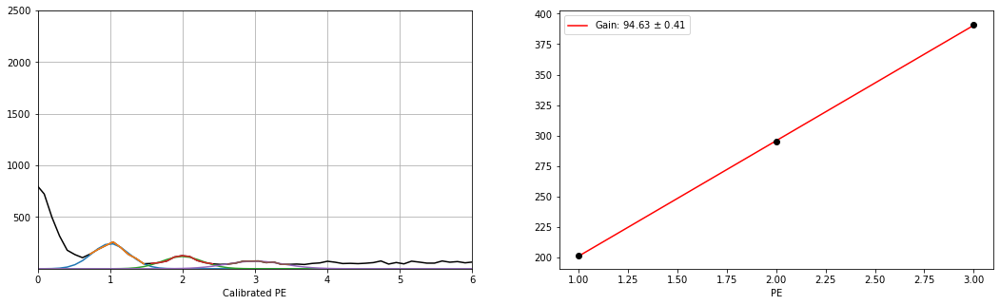

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_5.h5
Guess:  [248, 205.0375457875458, 10]
Params:  [239.02219559 201.57483533  24.30780716]
Guess:  [110, 295.0540293040293, 10]
Params:  [104.0458894  296.24789165  34.99901926]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 68.42822629 396.38786116  51.37632969]
[97.4065129  -1.06006433]


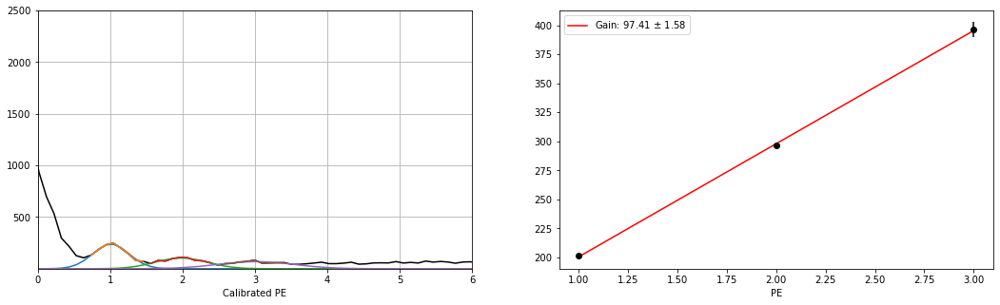

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_4.h5
Guess:  [253, 205.0375457875458, 10]
Params:  [241.200013   202.69993708  23.01341777]
Guess:  [136, 295.0540293040293, 10]
Params:  [123.98765823 294.0126931   24.72112459]
Guess:  [79, 395.0723443223443, 10]
Params:  [ 69.75313602 390.6611939   42.66561297]
[93.98062843 -1.1473643 ]


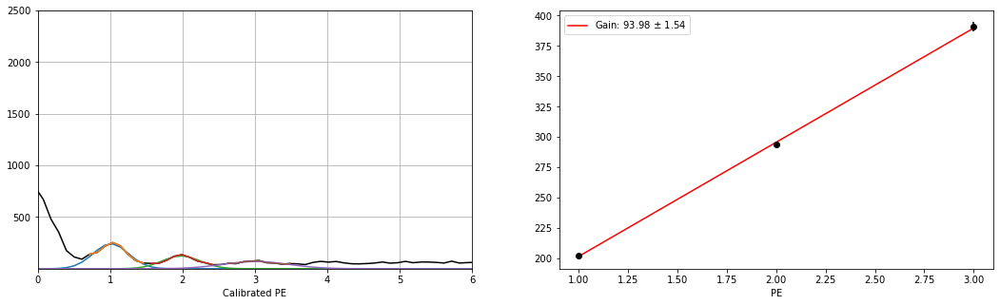

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_3.h5
Guess:  [241, 195.03571428571428, 10]
Params:  [229.70313919 202.64708061  24.02840585]
Guess:  [128, 295.0540293040293, 10]
Params:  [110.64436137 298.63695151  26.77980751]
Guess:  [80, 395.0723443223443, 10]
Params:  [ 71.70690141 393.19752308  36.21728916]
[95.27522124 -1.12946551]


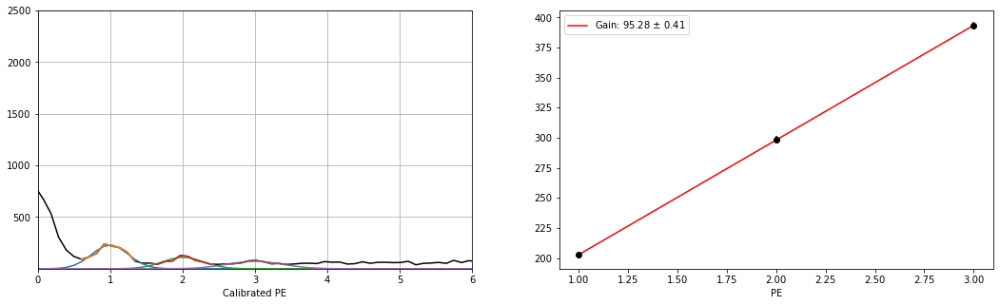

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_2.h5
Guess:  [275, 205.0375457875458, 10]
Params:  [273.41674006 203.16385581  23.81585502]
Guess:  [120, 305.0558608058608, 10]
Params:  [123.11473738 297.15249631  30.29770932]
Guess:  [86, 415.07600732600736, 10]
Params:  [ 76.6641952  394.42863062  52.28983102]
[95.63238736 -1.11869583]


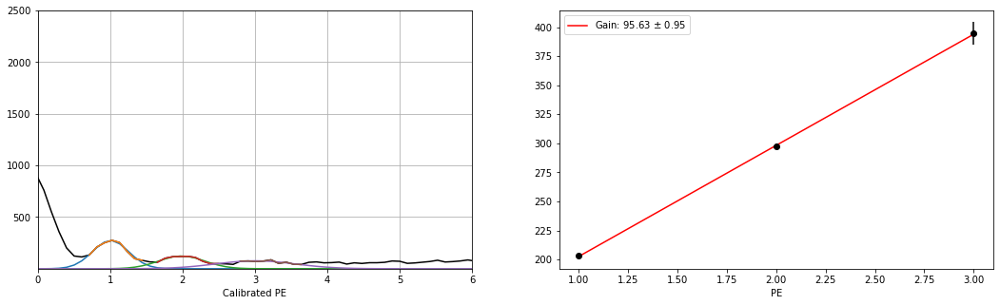

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_1.h5
Guess:  [234, 205.0375457875458, 10]
Params:  [224.58924059 204.88653513  26.88298764]
Guess:  [104, 305.0558608058608, 10]
Params:  [ 96.16610175 299.4037136   37.25519807]
Guess:  [81, 395.0723443223443, 10]
Params:  [ 72.12446108 390.44049145  39.29214112]
[92.77697822 -1.21462917]


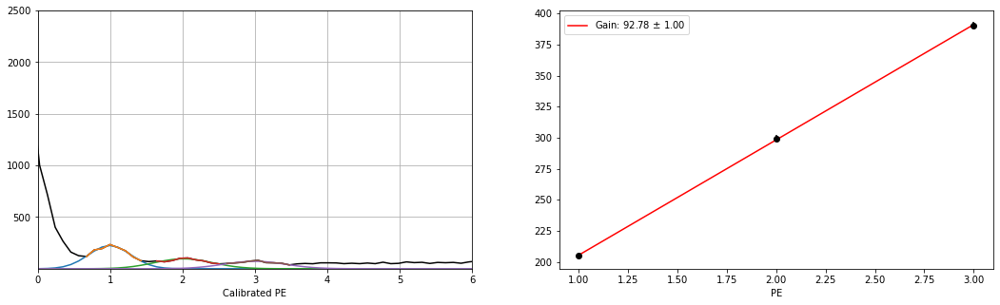

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_0.h5
Guess:  [220, 195.03571428571428, 10]
Params:  [225.21265328 200.54117956  29.13508599]
Guess:  [117, 305.0558608058608, 10]
Params:  [113.16938034 298.54012555  33.84131611]
Guess:  [81, 375.06868131868134, 10]
Params:  [ 68.22669105 380.11831036  51.86697264]
[89.78856537 -1.26396281]


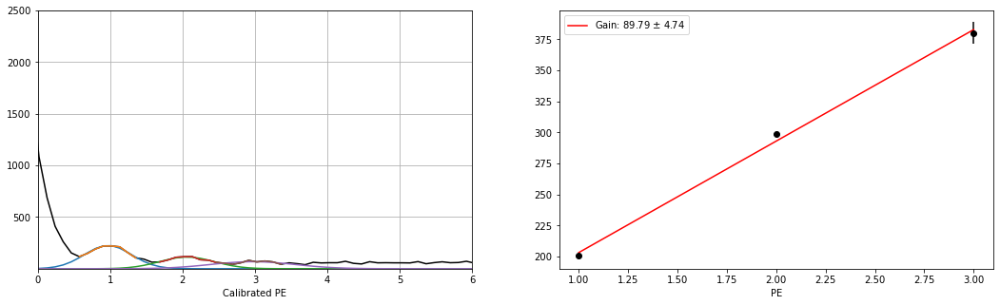

In [10]:
data_POS_FIELD = {'source':{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[], 'dc_offset':[], 'mean_dc_offset': 0.0}, 
                  405.0:{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[],'dc_offset':[], 'mean_dc_offset': 0.0},
                  310.0:{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[],'dc_offset':[], 'mean_dc_offset': 0.0}}

for file_type, file_list in files_10.items():
    for file in file_list:
        pe, counts, gain, gain_err, dc_offset = plot_fit_gain(file, 25, 10, 10)
        data_POS_FIELD[file_type]['pe_data'].append(pe)
        data_POS_FIELD[file_type]['counts'].append(counts)
        data_POS_FIELD[file_type]['gain'].append(gain)
        data_POS_FIELD[file_type]['gain_err'].append(gain_err)
        data_POS_FIELD[file_type]['dc_offset'].append(dc_offset)
    
    # Calculate the mean of the final dc_offset for each file_type
    data_POS_FIELD[file_type]['mean_dc_offset'] = np.mean(data_POS_FIELD[file_type]['dc_offset'])

In [ ]:
# plotting the gain over time

# getting the "time"
time_POS_FIELD = {}
for key in files_10:
    time_POS_FIELD[key] = np.arange(0, len(files_10[key]))
plt.figure(figsize=(6,4))
for key in data_POS_FIELD:
    plt.errorbar(time_POS_FIELD[key],np.array(data_POS_FIELD[key]['gain']),yerr=data_POS_FIELD[key]['gain_err'],fmt='o',ms=7,label= str(key)+' Gain')
# plt.errorbar(time_NO_FIELD,NO_FIELD_pe_corrected_gain,yerr=NO_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time')
plt.title('Positive Field')
plt.grid()
plt.legend(loc='best')
plt.show()

Mean dc offset for 310 nm: -1.1402481092503292 with standard deviation: 0.05225421776008627
Mean dc offset for 405 nm: -1.2117894396027578 with standard deviation: 0.03542552806400595
Mean dc offset for source: -1.1022387428742475 with standard deviation: 0.0193215411946153


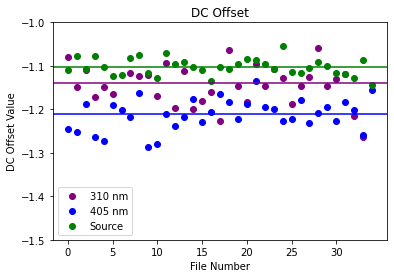

In [11]:
POS_dc_offset_310 = data_POS_FIELD[310.0]['dc_offset']
POS_dc_offset_405 = data_POS_FIELD[405.0]['dc_offset']
POS_dc_offset_source = data_POS_FIELD['source']['dc_offset']

# Plot the dc_offset values
plt.ylim(-1.5,-1)
plt.xticks(np.arange(0,len(POS_dc_offset_310),5))
plt.scatter(np.arange(0,len(POS_dc_offset_310),1),POS_dc_offset_310, color='purple', label='310 nm')
plt.axhline(y=np.mean(POS_dc_offset_310), color='purple')
plt.scatter(np.arange(0,len(POS_dc_offset_405),1),POS_dc_offset_405, color = 'blue', label='405 nm')
plt.axhline(y=np.mean(POS_dc_offset_405), color='blue')
plt.scatter(np.arange(0,len(POS_dc_offset_source),1),POS_dc_offset_source, color = 'green', label='Source')
plt.axhline(y=np.mean(POS_dc_offset_source), color='green')

print("Mean dc offset for 310 nm:", data_POS_FIELD[310.0]['mean_dc_offset'], "with standard deviation:", np.std(POS_dc_offset_310) )
print("Mean dc offset for 405 nm:", data_POS_FIELD[405.0]['mean_dc_offset'], "with standard deviation:", np.std(POS_dc_offset_405) )
print("Mean dc offset for source:", data_POS_FIELD['source']['mean_dc_offset'], "with standard deviation:", np.std(POS_dc_offset_source) )

# Add title and axis labels
plt.title("DC Offset")
plt.xlabel("File Number")
plt.ylabel("DC Offset Value")
plt.legend()

### Negative field

In [12]:
# NEGATIVE FIELD - getting the data that we need
path_12 = '/gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/'
files_12 = load_directory(path_12)
SRS_gain_12 = 10 # gain on the SRS bandpass filter
# peak_threshold = 700 # upper bound of pedestal
# breakdown = 27.4 # breakdown voltage of the SiPM
pedestal_12 = 275 # center of noise pedestal peak

Number of files found:  105
Number of files:  105


Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_34.h5
Guess:  [1432, 205.0375457875458, 10]
Params:  [1409.56194169  203.45683938   23.91580474]
Guess:  [666, 295.0540293040293, 10]
Params:  [626.75617773 299.45194301  29.412088  ]
Guess:  [374, 405.0741758241758, 10]
Params:  [350.67454103 397.45734215  31.35729209]
Guess:  [227, 505.09249084249086, 10]
Params:  [215.30843723 494.07031425  32.65173263]
Guess:  [161, 585.1071428571429, 10]
Params:  [145.51510042 591.58273117  33.88499119]
[97.08701549 -1.09121479]


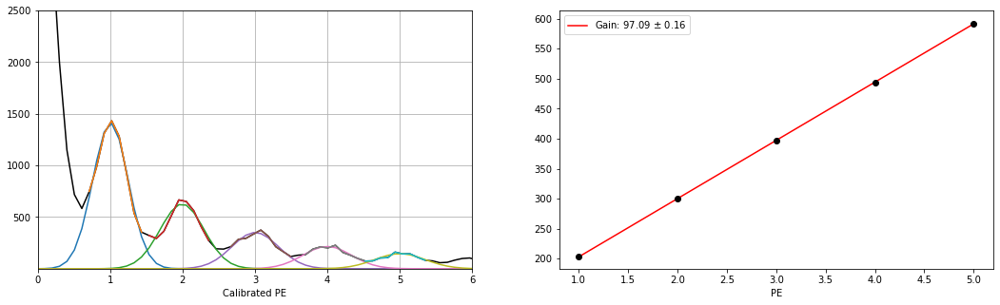

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_33.h5
Guess:  [1434, 205.0375457875458, 10]
Params:  [1376.25450264  204.22863595   23.87269642]
Guess:  [637, 295.0540293040293, 10]
Params:  [610.47619223 298.02100142  30.67325058]
Guess:  [352, 405.0741758241758, 10]
Params:  [339.77096354 396.84006562  29.75844943]
Guess:  [216, 495.09065934065933, 10]
Params:  [207.70221059 494.33390142  31.66619941]
Guess:  [145, 595.1089743589744, 10]
Params:  [131.84504031 589.81075511  36.00008133]
[96.74771379 -1.09980615]


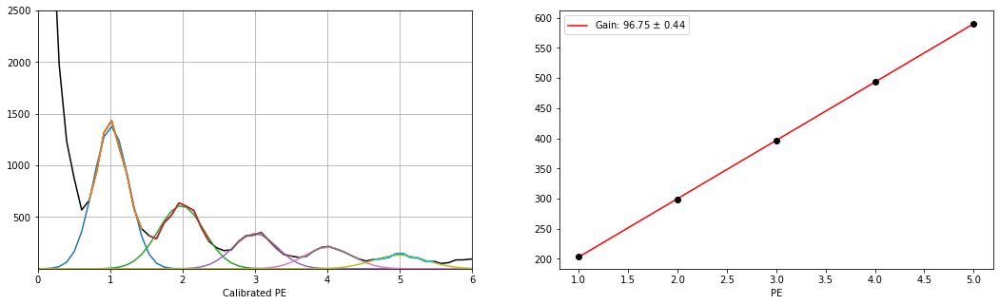

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_32.h5
Guess:  [1370, 205.0375457875458, 10]
Params:  [1358.50171322  204.23828471   23.90371818]
Guess:  [645, 305.0558608058608, 10]
Params:  [629.76262198 300.17635085  26.3848641 ]
Guess:  [330, 385.0705128205128, 10]
Params:  [316.16580371 394.72910981  39.27426242]
Guess:  [230, 505.09249084249086, 10]
Params:  [217.03013891 497.05768552  27.99345721]
Guess:  [143, 585.1071428571429, 10]
Params:  [126.44725929 588.24944052  43.09056005]
[96.49036462 -1.11326225]


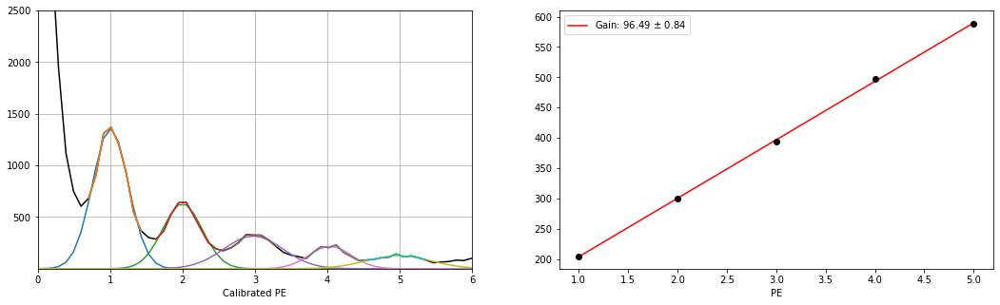

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_31.h5
Guess:  [1493, 205.0375457875458, 10]
Params:  [1388.58413637  204.36298292   24.91729716]
Guess:  [664, 305.0558608058608, 10]
Params:  [652.93806636 299.46914031  26.15523414]
Guess:  [352, 395.0723443223443, 10]
Params:  [337.50303282 395.45231464  32.4850255 ]
Guess:  [209, 495.09065934065933, 10]
Params:  [194.5444611  495.44385641  33.60720425]
Guess:  [139, 595.1089743589744, 10]
Params:  [134.71115329 591.79213112  31.82112099]
[97.08330121 -1.09240395]


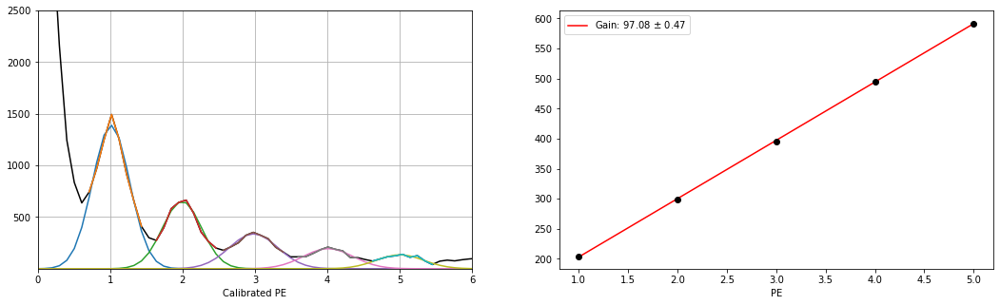

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_30.h5
Guess:  [1399, 205.0375457875458, 10]
Params:  [1370.16607818  203.95438928   25.00720092]
Guess:  [679, 305.0558608058608, 10]
Params:  [650.73192519 300.09305289  27.55617226]
Guess:  [352, 395.0723443223443, 10]
Params:  [346.3871782  394.99040292  31.21582184]
Guess:  [231, 505.09249084249086, 10]
Params:  [219.34030311 495.24047247  31.57121504]
Guess:  [166, 585.1071428571429, 10]
Params:  [152.31391988 588.41847468  33.48573849]
[96.40755907 -1.1131563 ]


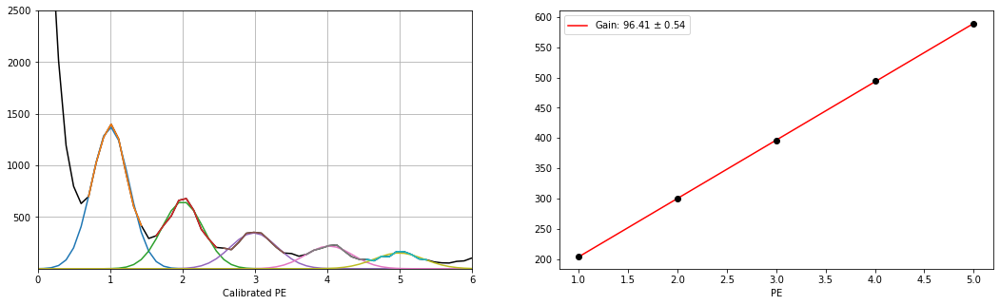

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_29.h5
Guess:  [1465, 205.0375457875458, 10]
Params:  [1409.43190024  203.67251883   24.57968519]
Guess:  [714, 305.0558608058608, 10]
Params:  [661.72945875 299.81861733  27.74207721]
Guess:  [373, 405.0741758241758, 10]
Params:  [358.14926919 396.84349245  30.74706741]
Guess:  [228, 495.09065934065933, 10]
Params:  [214.50359676 494.04289269  30.16187228]
Guess:  [166, 595.1089743589744, 10]
Params:  [159.33710164 590.8534558   32.42179397]
[96.85861493 -1.0992347 ]


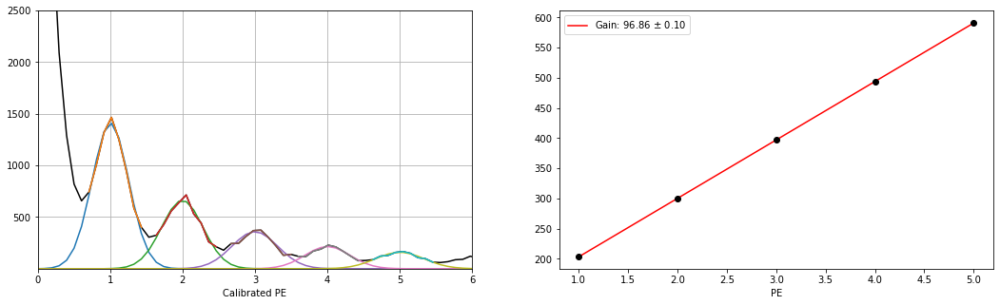

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_28.h5
Guess:  [1419, 205.0375457875458, 10]
Params:  [1380.84311941  203.80809649   24.30424962]
Guess:  [672, 295.0540293040293, 10]
Params:  [641.25541396 296.69802846  29.51152897]
Guess:  [397, 395.0723443223443, 10]
Params:  [360.20236929 394.79965681  28.97231014]
Guess:  [247, 495.09065934065933, 10]
Params:  [228.7334612  490.75040587  31.17377741]
Guess:  [163, 595.1089743589744, 10]
Params:  [134.78045603 592.1928097   35.98009983]
[97.08218039 -1.07541114]


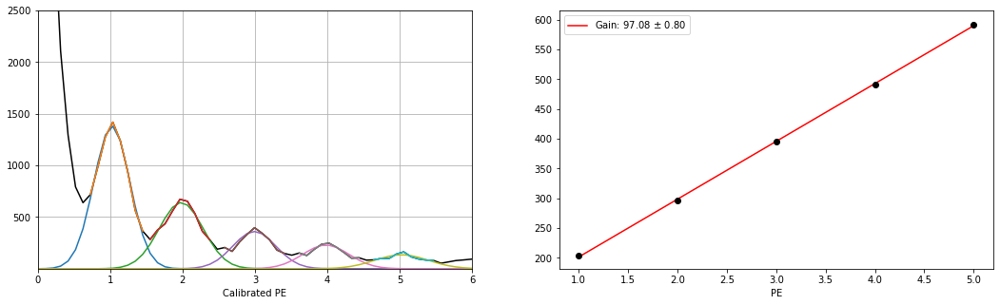

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_27.h5
Guess:  [1349, 205.0375457875458, 10]
Params:  [1317.64726018  203.72287352   25.06291687]
Guess:  [641, 305.0558608058608, 10]
Params:  [618.33807515 299.2259702   27.3359506 ]
Guess:  [361, 395.0723443223443, 10]
Params:  [341.70053496 396.26505683  30.3863989 ]
Guess:  [230, 495.09065934065933, 10]
Params:  [211.35840531 492.95742499  31.69913184]
Guess:  [144, 595.1089743589744, 10]
Params:  [136.02221881 590.62737631  35.51356182]
[96.75404604 -1.09863728]


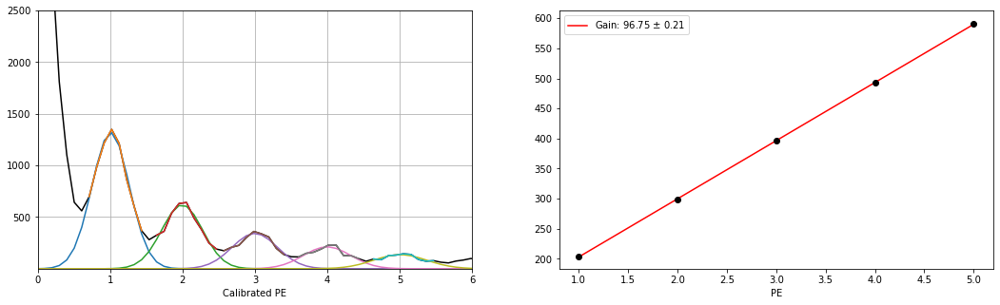

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_26.h5
Guess:  [1428, 205.0375457875458, 10]
Params:  [1401.86484057  203.30429116   24.84460871]
Guess:  [718, 305.0558608058608, 10]
Params:  [662.63767537 300.10922379  26.88633223]
Guess:  [386, 395.0723443223443, 10]
Params:  [362.53278716 396.19368002  29.77058908]
Guess:  [237, 495.09065934065933, 10]
Params:  [226.62799981 493.20291412  31.2226503 ]
Guess:  [142, 595.1089743589744, 10]
Params:  [130.52270962 589.31456198  37.55163535]
[96.51142319 -1.10754418]


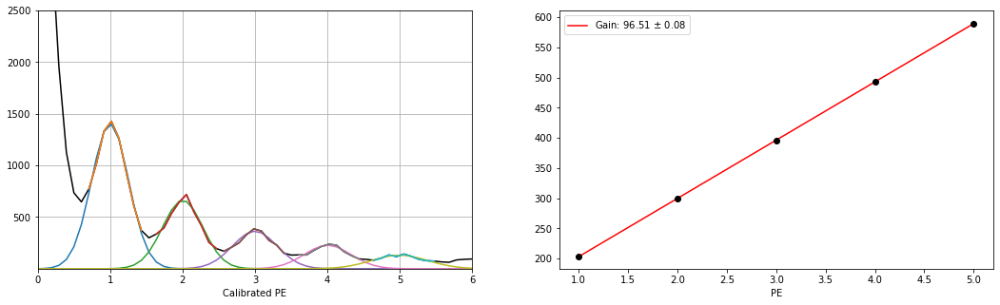

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_25.h5
Guess:  [1408, 205.0375457875458, 10]
Params:  [1408.14743769  203.4458286    24.65397883]
Guess:  [665, 305.0558608058608, 10]
Params:  [636.82828409 299.34610063  28.37756711]
Guess:  [388, 405.0741758241758, 10]
Params:  [358.0397297  396.92847562  29.96154502]
Guess:  [227, 495.09065934065933, 10]
Params:  [210.11538489 493.1703834   32.14159014]
Guess:  [144, 595.1089743589744, 10]
Params:  [145.01969075 591.7940485   31.46186598]
[97.05207224 -1.08993809]


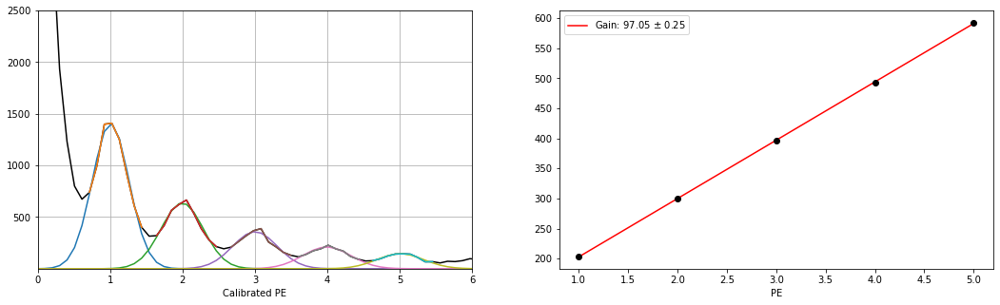

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_24.h5
Guess:  [1393, 205.0375457875458, 10]
Params:  [1409.75816584  204.13519621   24.47564005]
Guess:  [719, 305.0558608058608, 10]
Params:  [689.47039547 299.97362073  24.89369194]
Guess:  [359, 395.0723443223443, 10]
Params:  [326.69291331 396.15962331  32.75539338]
Guess:  [257, 495.09065934065933, 10]
Params:  [235.19240163 492.90214617  28.90078159]
Guess:  [155, 595.1089743589744, 10]
Params:  [144.83057363 591.70159486  30.38773984]
[96.80613224 -1.1007158 ]


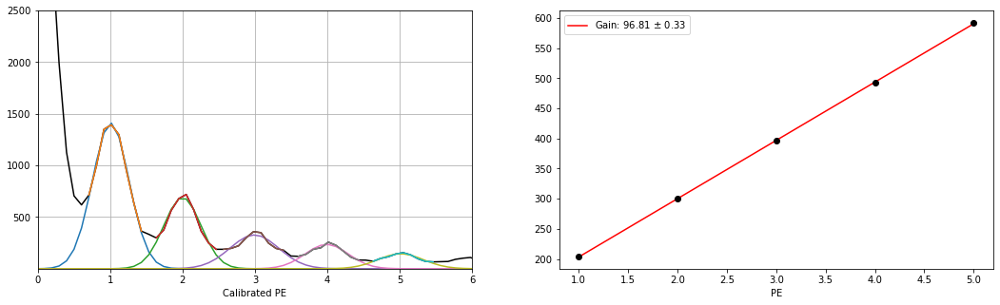

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_23.h5
Guess:  [1432, 205.0375457875458, 10]
Params:  [1416.57660248  203.39170721   23.98966753]
Guess:  [663, 305.0558608058608, 10]
Params:  [628.13475374 300.36925566  27.94676207]
Guess:  [364, 395.0723443223443, 10]
Params:  [342.6963514  394.6819719   29.23477963]
Guess:  [235, 495.09065934065933, 10]
Params:  [219.72652787 493.59531626  31.39528538]
Guess:  [133, 585.1071428571429, 10]
Params:  [134.25101078 586.21686277  37.8885585 ]
[95.88763716 -1.12619431]


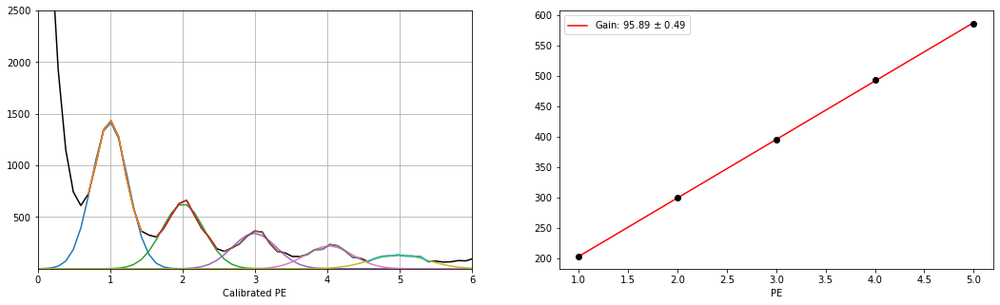

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_22.h5
Guess:  [1406, 205.0375457875458, 10]
Params:  [1334.41182254  203.50592578   24.97697074]
Guess:  [667, 305.0558608058608, 10]
Params:  [646.62660545 300.22746481  27.02975154]
Guess:  [365, 395.0723443223443, 10]
Params:  [344.07414013 395.40322497  30.49330142]
Guess:  [226, 495.09065934065933, 10]
Params:  [213.52859788 494.06511977  32.96832645]
Guess:  [163, 595.1089743589744, 10]
Params:  [149.42680617 590.41699181  31.46466414]
[96.7659787  -1.09982672]


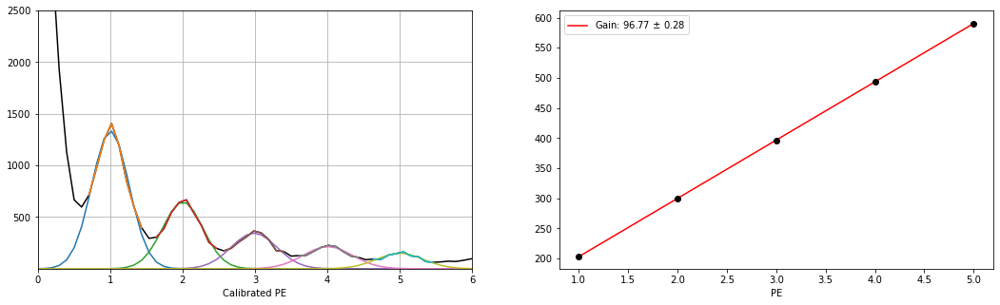

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_21.h5
Guess:  [1478, 205.0375457875458, 10]
Params:  [1430.23391317  203.84672829   23.77590965]
Guess:  [674, 295.0540293040293, 10]
Params:  [634.4631248  299.39312622  28.35300426]
Guess:  [373, 395.0723443223443, 10]
Params:  [345.72732211 396.92823977  31.93330029]
Guess:  [214, 485.0888278388278, 10]
Params:  [204.98919185 492.04523134  36.6170374 ]
Guess:  [144, 605.1108058608058, 10]
Params:  [135.21824586 593.55719669  34.23787659]
[97.20730413 -1.08564056]


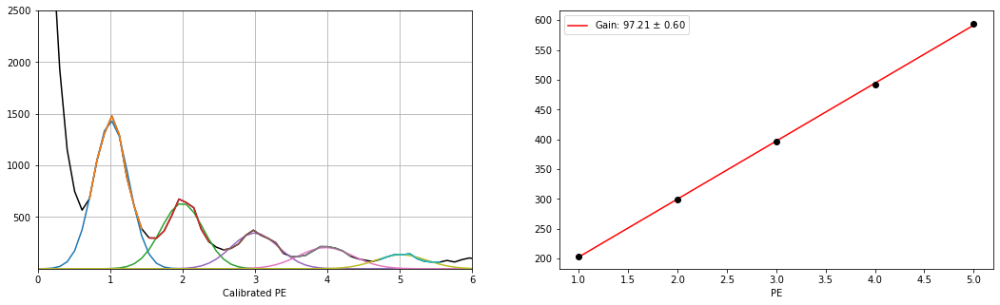

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_20.h5
Guess:  [1449, 205.0375457875458, 10]
Params:  [1429.088269    203.13221968   24.41656397]
Guess:  [698, 305.0558608058608, 10]
Params:  [679.38247432 300.84718247  25.92846615]
Guess:  [367, 385.0705128205128, 10]
Params:  [331.5365968  394.84171063  40.59252562]
Guess:  [216, 495.09065934065933, 10]
Params:  [205.61490632 493.15065904  34.97244011]
Guess:  [159, 595.1089743589744, 10]
Params:  [145.83750978 590.82263139  37.53731403]
[96.76842998 -1.09801917]


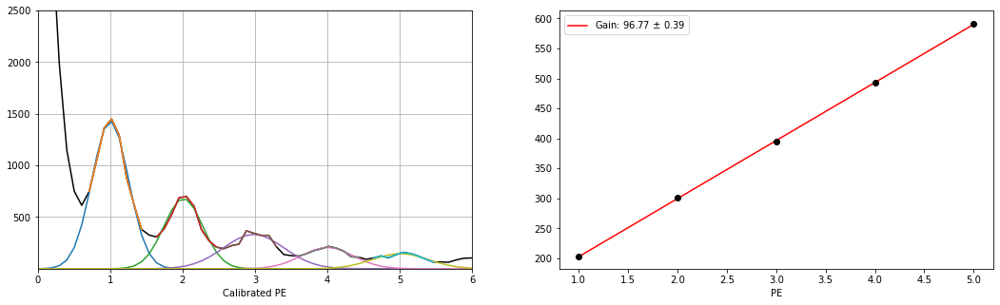

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_19.h5
Guess:  [1383, 205.0375457875458, 10]
Params:  [1356.55894042  203.62807814   25.23014499]
Guess:  [715, 295.0540293040293, 10]
Params:  [663.82271982 298.16890985  27.85175047]
Guess:  [389, 405.0741758241758, 10]
Params:  [377.21672114 398.04289779  27.85536994]
Guess:  [229, 495.09065934065933, 10]
Params:  [215.50890096 492.27856735  29.99080192]
Guess:  [158, 595.1089743589744, 10]
Params:  [151.24441246 591.00592497  31.59983369]
[96.88653512 -1.09370482]


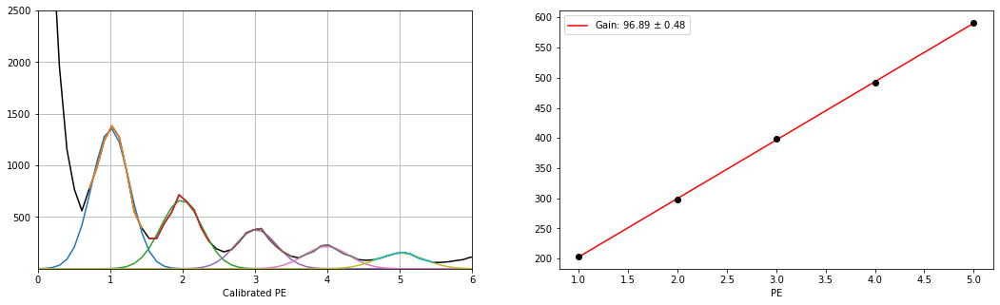

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_18.h5
Guess:  [1435, 205.0375457875458, 10]
Params:  [1419.0977656   204.08600242   23.59327529]
Guess:  [705, 305.0558608058608, 10]
Params:  [665.57798996 299.78581417  27.01269945]
Guess:  [384, 395.0723443223443, 10]
Params:  [355.7286309  396.62448616  30.88463281]
Guess:  [240, 495.09065934065933, 10]
Params:  [224.79015663 492.1691302   29.93427989]
Guess:  [165, 595.1089743589744, 10]
Params:  [150.36803599 591.78257169  31.34162756]
[96.77764546 -1.10104626]


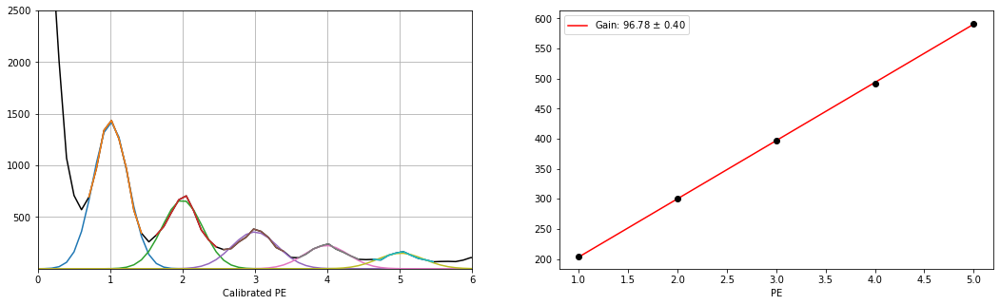

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_17.h5
Guess:  [1409, 205.0375457875458, 10]
Params:  [1392.18974495  203.88980261   24.12244207]
Guess:  [651, 295.0540293040293, 10]
Params:  [638.57399319 298.50224098  27.57866385]
Guess:  [370, 395.0723443223443, 10]
Params:  [345.95631362 395.51981984  31.19348818]
Guess:  [232, 495.09065934065933, 10]
Params:  [209.93512123 493.04922579  30.10992504]
Guess:  [153, 585.1071428571429, 10]
Params:  [135.71014604 587.82996093  35.55840364]
[96.24273017 -1.1120842 ]


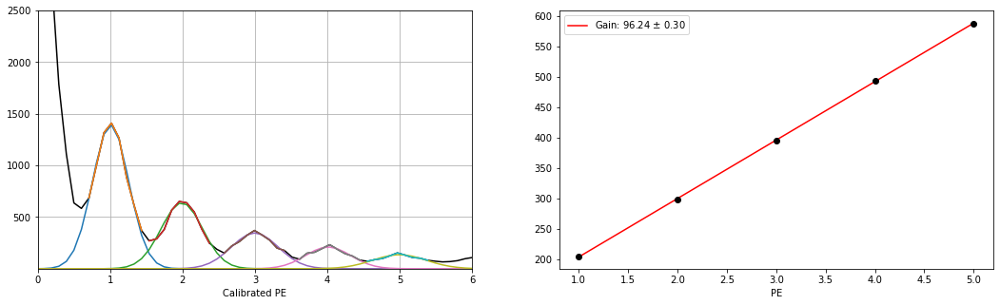

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_16.h5
Guess:  [1422, 205.0375457875458, 10]
Params:  [1406.9020745   203.83218595   24.86947908]
Guess:  [666, 295.0540293040293, 10]
Params:  [636.92003534 298.35349366  28.25355278]
Guess:  [390, 395.0723443223443, 10]
Params:  [347.60507037 396.41976664  28.89859769]
Guess:  [242, 495.09065934065933, 10]
Params:  [233.63593548 493.53215025  31.2381673 ]
Guess:  [159, 605.1108058608058, 10]
Params:  [142.54531194 596.87176764  32.08804232]
[98.12578202 -1.05399952]


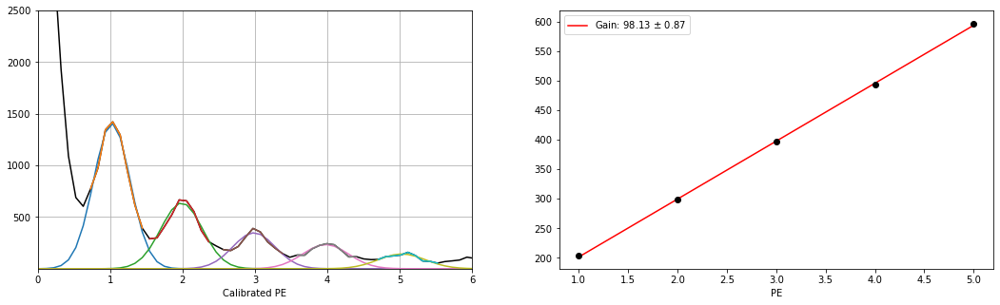

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_15.h5
Guess:  [1563, 205.0375457875458, 10]
Params:  [1455.67260162  203.57709203   23.91064362]
Guess:  [664, 295.0540293040293, 10]
Params:  [631.3079547  297.62454106  30.6927417 ]
Guess:  [367, 395.0723443223443, 10]
Params:  [347.87928973 396.35313197  31.93763268]
Guess:  [221, 485.0888278388278, 10]
Params:  [205.28034263 491.75174739  37.92856755]
Guess:  [161, 585.1071428571429, 10]
Params:  [139.51231493 588.47898453  39.67857007]
[96.39309908 -1.10358317]


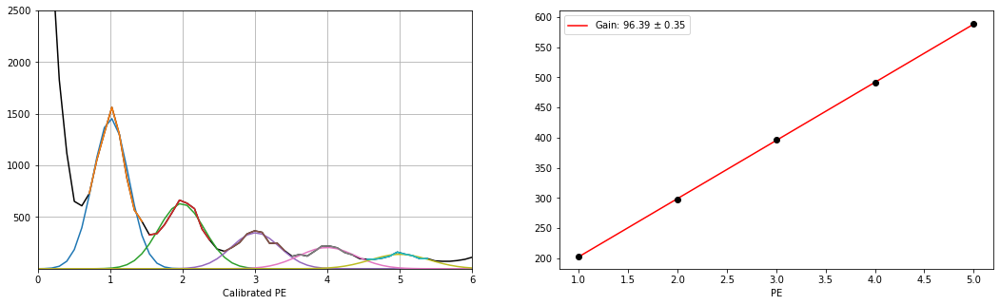

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_14.h5
Guess:  [1462, 205.0375457875458, 10]
Params:  [1445.54433523  203.6477001    23.25447895]
Guess:  [671, 305.0558608058608, 10]
Params:  [651.21351349 300.01966577  26.86242508]
Guess:  [377, 395.0723443223443, 10]
Params:  [349.54300999 395.61048059  30.12375846]
Guess:  [219, 485.0888278388278, 10]
Params:  [201.47288885 489.92178752  36.49463414]
Guess:  [157, 585.1071428571429, 10]
Params:  [150.34453585 588.2934805   30.40353236]
[95.91936826 -1.12324049]


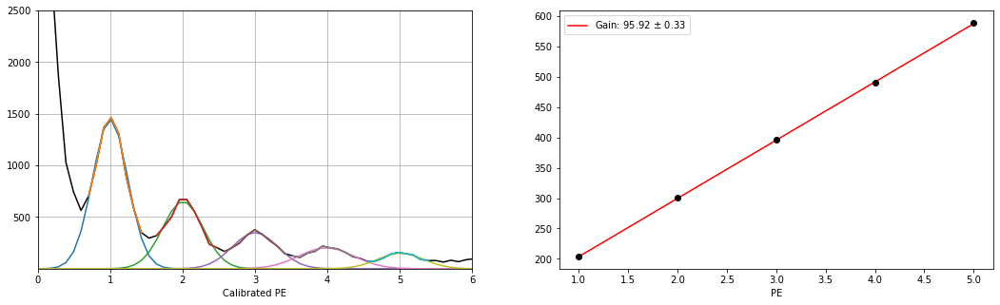

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_13.h5
Guess:  [1418, 205.0375457875458, 10]
Params:  [1386.94311836  203.90807433   23.96352606]
Guess:  [672, 305.0558608058608, 10]
Params:  [654.33751092 299.96999611  25.96653375]
Guess:  [369, 395.0723443223443, 10]
Params:  [353.26099722 395.61648623  28.01217729]
Guess:  [243, 495.09065934065933, 10]
Params:  [218.27666013 494.24400366  30.92391283]
Guess:  [143, 595.1089743589744, 10]
Params:  [138.73687012 590.95252993  30.10622007]
[96.83629188 -1.09906462]


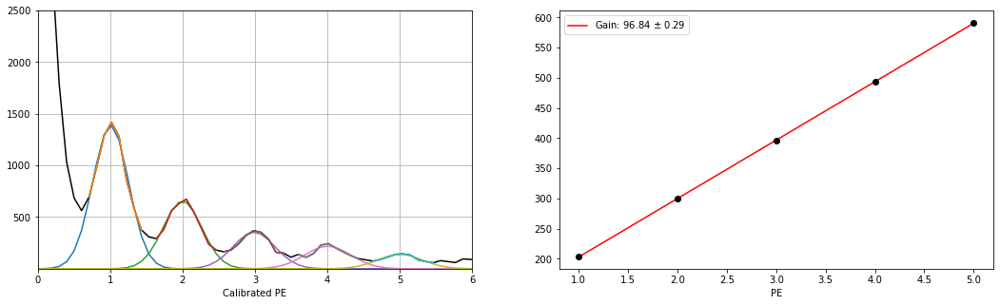

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_12.h5
Guess:  [1429, 205.0375457875458, 10]
Params:  [1401.74061168  203.50303083   24.2052886 ]
Guess:  [696, 295.0540293040293, 10]
Params:  [648.50245615 297.73228126  28.38174087]
Guess:  [379, 405.0741758241758, 10]
Params:  [357.08339699 397.00719987  27.97733797]
Guess:  [232, 495.09065934065933, 10]
Params:  [211.14741946 493.23780451  34.13496728]
Guess:  [140, 585.1071428571429, 10]
Params:  [142.47900476 589.76105849  37.26327665]
[96.80215785 -1.09338267]


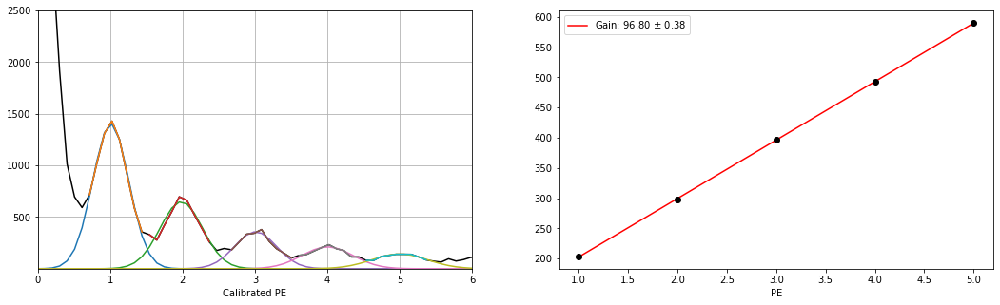

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_11.h5
Guess:  [1413, 205.0375457875458, 10]
Params:  [1390.79865729  204.17900178   23.91817361]
Guess:  [611, 295.0540293040293, 10]
Params:  [598.28929437 299.10819652  29.54580427]
Guess:  [407, 395.0723443223443, 10]
Params:  [364.22603442 394.6484273   28.21111246]
Guess:  [228, 495.09065934065933, 10]
Params:  [217.81692481 492.54382915  30.36450254]
Guess:  [139, 605.1108058608058, 10]
Params:  [133.8314958  593.44629752  34.30467952]
[97.19702244 -1.08227681]


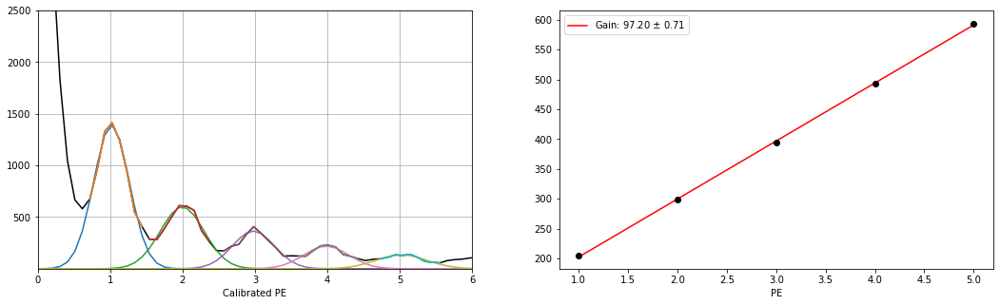

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_10.h5
Guess:  [1433, 205.0375457875458, 10]
Params:  [1411.48070972  203.76274167   23.71421957]
Guess:  [652, 305.0558608058608, 10]
Params:  [637.22142365 300.47839987  26.37627112]
Guess:  [402, 395.0723443223443, 10]
Params:  [380.40585407 395.61207998  26.60458713]
Guess:  [244, 505.09249084249086, 10]
Params:  [217.35861254 495.05357786  30.18555174]
Guess:  [163, 585.1071428571429, 10]
Params:  [147.40939927 589.51238992  33.55652409]
[96.60744747 -1.10821162]


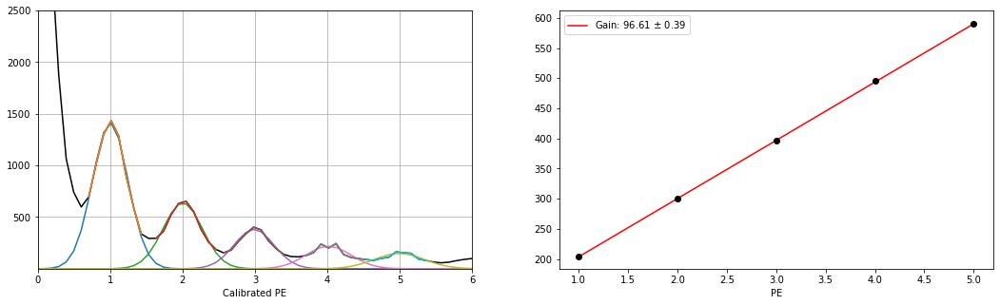

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_9.h5
Guess:  [1412, 205.0375457875458, 10]
Params:  [1378.68169552  203.48611494   24.32998489]
Guess:  [710, 305.0558608058608, 10]
Params:  [672.21598732 299.27991716  26.39050134]
Guess:  [371, 405.0741758241758, 10]
Params:  [351.78865039 397.15575141  29.45503543]
Guess:  [224, 495.09065934065933, 10]
Params:  [211.2259659  491.46430614  32.25928117]
Guess:  [165, 585.1071428571429, 10]
Params:  [145.53883434 584.29730719  33.9142789 ]
[95.38067737 -1.142733  ]


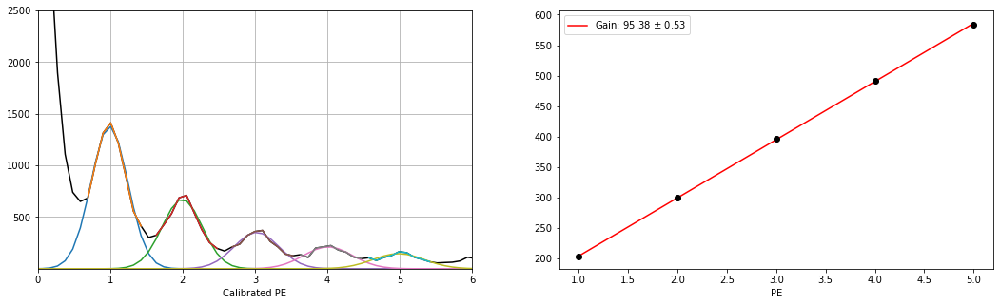

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_8.h5
Guess:  [1426, 205.0375457875458, 10]
Params:  [1341.91511745  203.90777357   23.87900515]
Guess:  [640, 305.0558608058608, 10]
Params:  [618.06649599 299.53567658  27.64674152]
Guess:  [373, 395.0723443223443, 10]
Params:  [354.84153383 395.43881193  30.65306127]
Guess:  [229, 505.09249084249086, 10]
Params:  [213.56011884 494.22095569  30.92481155]
Guess:  [150, 585.1071428571429, 10]
Params:  [131.12588922 589.11856253  39.43286379]
[96.51068571 -1.1077768 ]


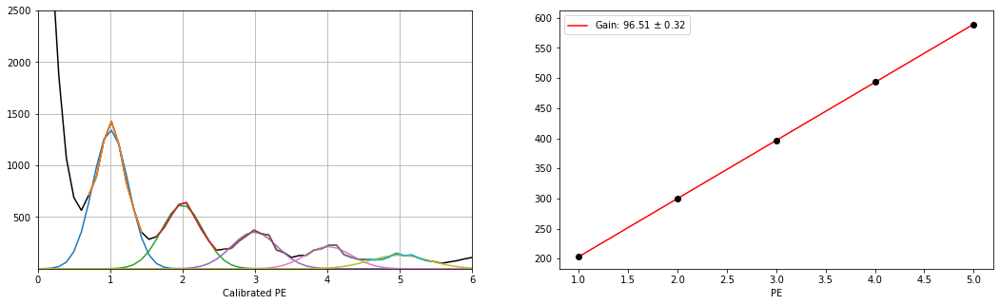

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_7.h5
Guess:  [1371, 205.0375457875458, 10]
Params:  [1368.44825113  203.61098378   24.78644991]
Guess:  [694, 295.0540293040293, 10]
Params:  [654.55454689 298.14549817  28.41510268]
Guess:  [355, 395.0723443223443, 10]
Params:  [360.66371612 395.99665307  29.54832484]
Guess:  [211, 495.09065934065933, 10]
Params:  [203.30874493 490.81264872  34.13066145]
Guess:  [143, 595.1089743589744, 10]
Params:  [141.79638973 593.6791661   31.33587995]
[97.2803516  -1.07532439]


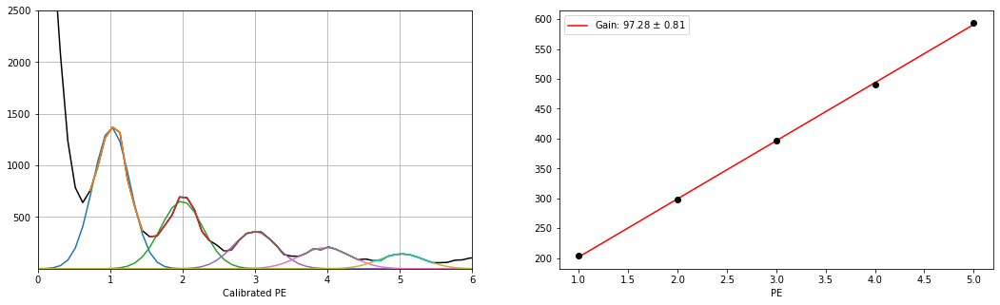

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_6.h5
Guess:  [1418, 205.0375457875458, 10]
Params:  [1366.60347891  204.50263421   23.5379652 ]
Guess:  [693, 305.0558608058608, 10]
Params:  [653.38141287 300.11302816  26.66011114]
Guess:  [368, 395.0723443223443, 10]
Params:  [342.19817478 397.11814443  30.22318908]
Guess:  [218, 495.09065934065933, 10]
Params:  [206.56204489 493.87680796  32.13576451]
Guess:  [154, 595.1089743589744, 10]
Params:  [138.95090346 594.27845775  32.71206139]
[97.33154265 -1.08888839]


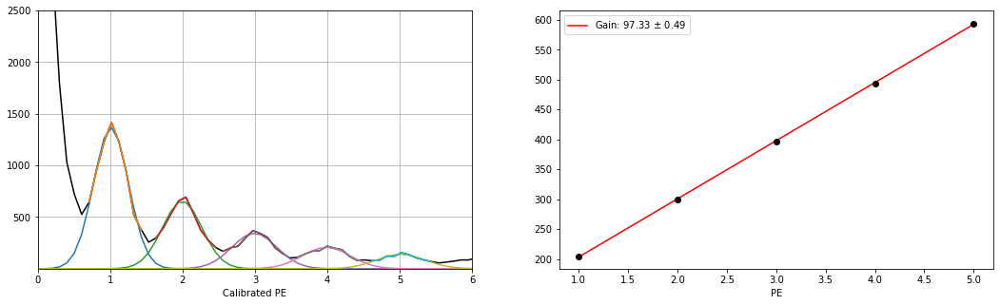

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_5.h5
Guess:  [1423, 205.0375457875458, 10]
Params:  [1415.83154907  203.86826028   24.03020578]
Guess:  [665, 305.0558608058608, 10]
Params:  [644.63124561 299.96824577  27.58424299]
Guess:  [363, 395.0723443223443, 10]
Params:  [345.66844442 395.0154319   31.21652303]
Guess:  [236, 495.09065934065933, 10]
Params:  [206.78359925 491.14957315  33.16779487]
Guess:  [168, 585.1071428571429, 10]
Params:  [142.5154845  589.01870587  36.32014269]
[96.14822186 -1.11660284]


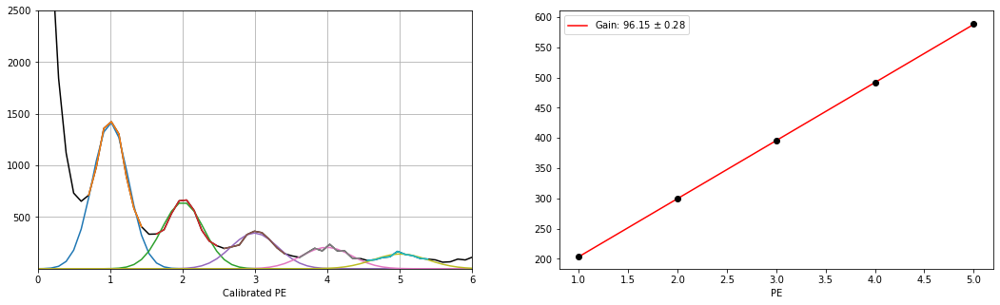

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_4.h5
Guess:  [1426, 205.0375457875458, 10]
Params:  [1395.36513715  203.32247474   23.97642655]
Guess:  [667, 305.0558608058608, 10]
Params:  [643.69493853 299.44640802  26.189731  ]
Guess:  [400, 395.0723443223443, 10]
Params:  [342.30783074 394.46960559  30.98243734]
Guess:  [218, 505.09249084249086, 10]
Params:  [212.62744946 491.83701818  32.21006994]
Guess:  [157, 585.1071428571429, 10]
Params:  [145.02508123 588.97421595  32.23701426]
[96.36940927 -1.10514029]


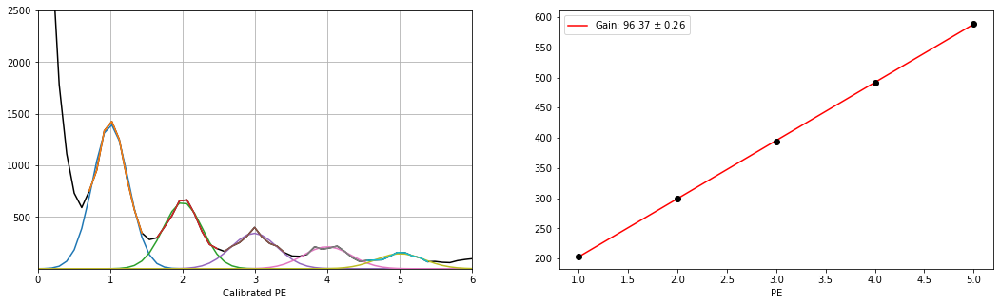

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_3.h5
Guess:  [1468, 205.0375457875458, 10]
Params:  [1385.96635524  204.08962327   23.73678937]
Guess:  [659, 295.0540293040293, 10]
Params:  [633.16808588 299.2657753   27.93838466]
Guess:  [410, 395.0723443223443, 10]
Params:  [379.12097582 395.45430206  25.93468427]
Guess:  [257, 495.09065934065933, 10]
Params:  [225.13081014 494.03004747  29.35458301]
Guess:  [145, 585.1071428571429, 10]
Params:  [135.4158374  588.15722172  35.19148024]
[96.28994692 -1.11464962]


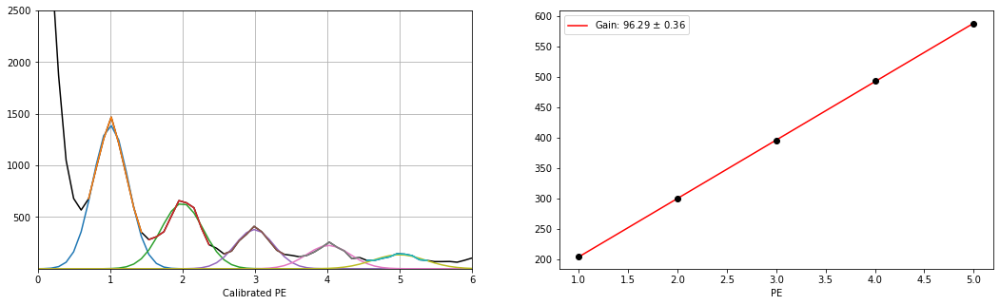

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_2.h5
Guess:  [1534, 205.0375457875458, 10]
Params:  [1438.98950698  204.27496963   23.0461564 ]
Guess:  [689, 305.0558608058608, 10]
Params:  [665.48096467 300.89969571  27.0348244 ]
Guess:  [373, 405.0741758241758, 10]
Params:  [364.5595437  395.84320387  28.77394573]
Guess:  [238, 495.09065934065933, 10]
Params:  [231.37506479 493.57417941  28.81086213]
Guess:  [157, 595.1089743589744, 10]
Params:  [135.78730092 591.23031951  37.05311538]
[96.65851836 -1.10894436]


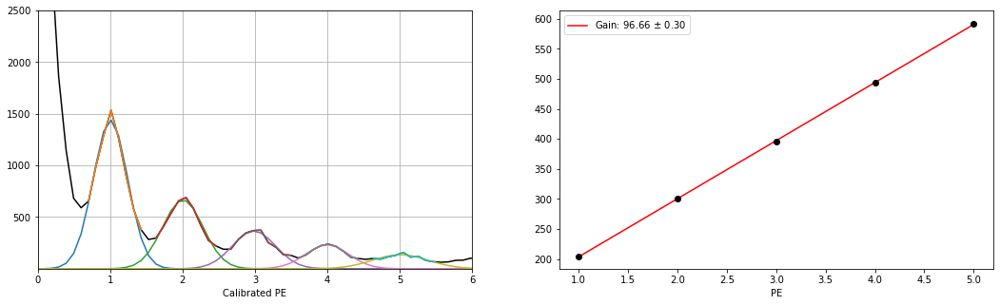

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_1.h5
Guess:  [1461, 205.0375457875458, 10]
Params:  [1424.97003214  204.22103401   24.33304183]
Guess:  [704, 295.0540293040293, 10]
Params:  [670.13197731 297.63852475  28.51719506]
Guess:  [385, 395.0723443223443, 10]
Params:  [362.83424032 396.4257211   30.26483555]
Guess:  [230, 485.0888278388278, 10]
Params:  [221.95064827 492.5994594   33.47514874]
Guess:  [181, 595.1089743589744, 10]
Params:  [150.68035478 593.30147795  31.39664651]
[97.31218236 -1.07798113]


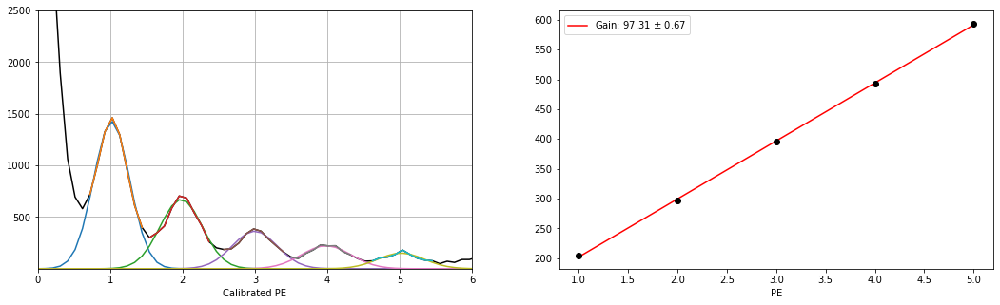

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_source_0.h5
Guess:  [1474, 205.0375457875458, 10]
Params:  [1402.12434421  203.73749808   23.88860336]
Guess:  [690, 295.0540293040293, 10]
Params:  [660.86510987 298.78400769  27.59704317]
Guess:  [379, 395.0723443223443, 10]
Params:  [347.4539097  395.41640687  31.20187733]
Guess:  [244, 485.0888278388278, 10]
Params:  [222.86666428 491.25431124  33.69486864]
Guess:  [173, 585.1071428571429, 10]
Params:  [156.32247847 588.33092715  32.44328071]
[96.16571616 -1.11274044]


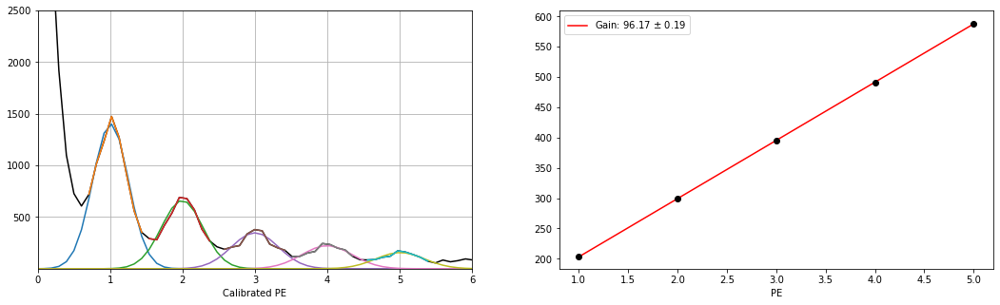

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_34.h5
Guess:  [387, 195.03571428571428, 10]
Params:  [375.48863005 200.86933383  24.82837515]
Guess:  [306, 295.0540293040293, 10]
Params:  [263.32216337 293.62310252  31.60807073]
Guess:  [196, 405.0741758241758, 10]
Params:  [184.76384636 384.76598067  53.3103334 ]
[91.94832343 -1.18750933]


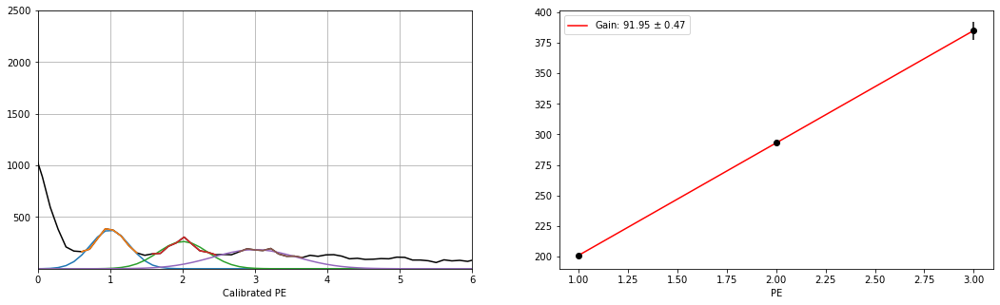

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_33.h5
Guess:  [400, 205.0375457875458, 10]
Params:  [366.39019167 201.98278496  26.23582496]
Guess:  [269, 285.05219780219784, 10]
Params:  [257.57713162 291.37382225  31.74538022]
Guess:  [202, 385.0705128205128, 10]
Params:  [183.13039579 380.94658099  43.99709496]
[89.48189801 -1.25690897]


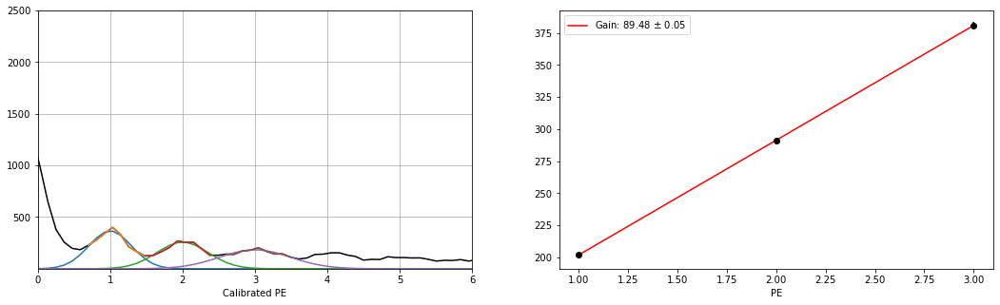

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_32.h5
Guess:  [390, 205.0375457875458, 10]
Params:  [373.61575541 201.01441154  26.43845724]
Guess:  [269, 295.0540293040293, 10]
Params:  [266.27707709 292.85467877  29.20651526]
Guess:  [196, 385.0705128205128, 10]
Params:  [181.53948371 384.66618048  41.72747866]
[91.82588447 -1.18913444]


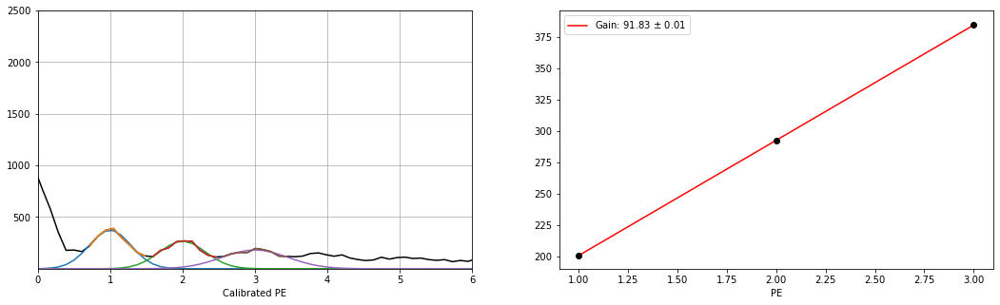

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_31.h5
Guess:  [377, 195.03571428571428, 10]
Params:  [372.32667793 201.42996014  25.50281757]
Guess:  [277, 295.0540293040293, 10]
Params:  [256.00911083 295.17353328  29.054508  ]
Guess:  [193, 375.06868131868134, 10]
Params:  [188.50971452 383.62850987  41.53619961]
[91.09927492 -1.2207794 ]


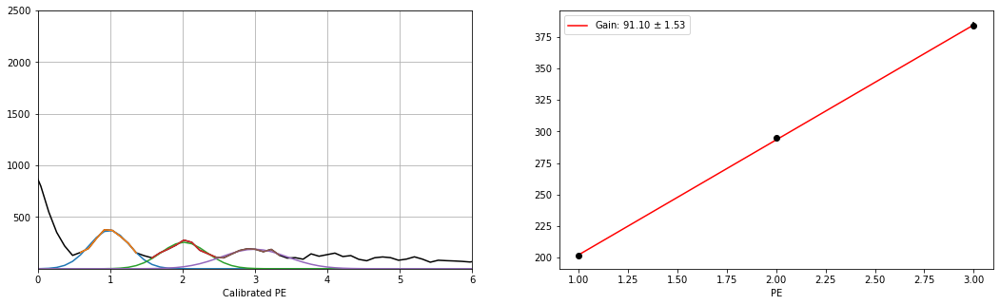

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_30.h5
Guess:  [383, 195.03571428571428, 10]
Params:  [389.90000991 199.97413382  24.89244738]
Guess:  [254, 295.0540293040293, 10]
Params:  [250.40489949 293.34641434  31.03939002]
Guess:  [219, 385.0705128205128, 10]
Params:  [198.8618934  383.67515312  34.31051249]
[91.85050961 -1.1826922 ]


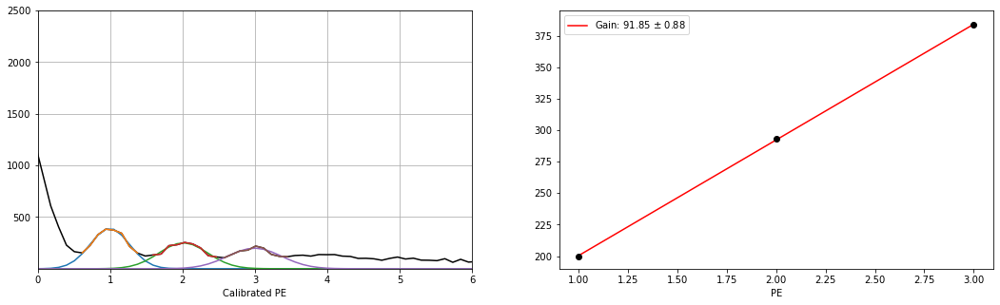

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_29.h5
Guess:  [361, 205.0375457875458, 10]
Params:  [363.40992194 202.60967104  25.92042727]
Guess:  [273, 295.0540293040293, 10]
Params:  [245.8909015  295.46351967  31.20431307]
Guess:  [212, 385.0705128205128, 10]
Params:  [189.85933357 385.52997508  38.97111377]
[91.46015206 -1.22035752]


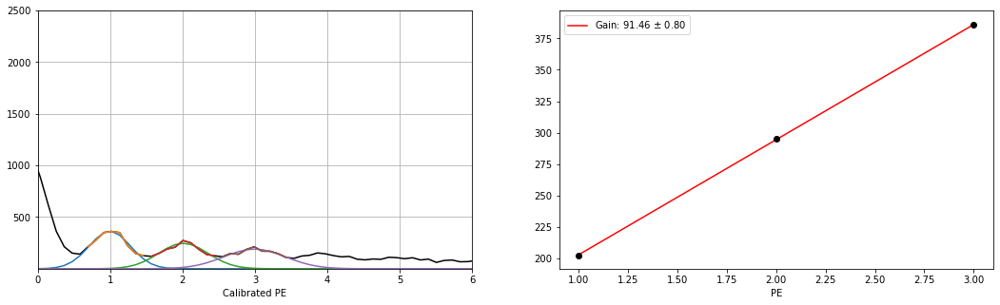

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_28.h5
Guess:  [410, 205.0375457875458, 10]
Params:  [388.56207547 200.82438843  25.94078008]
Guess:  [247, 285.05219780219784, 10]
Params:  [240.09286953 294.58911474  35.28108892]
Guess:  [212, 385.0705128205128, 10]
Params:  [198.12726484 383.6536692   34.87929954]
[91.41464039 -1.20542081]


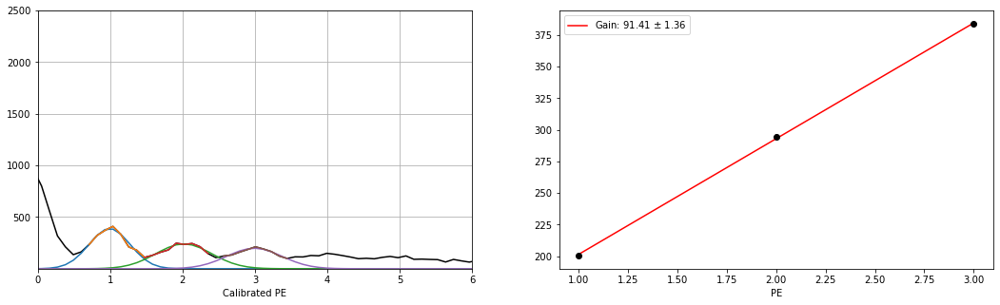

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_27.h5
Guess:  [388, 195.03571428571428, 10]
Params:  [370.76387792 200.32838548  24.27860336]
Guess:  [289, 285.05219780219784, 10]
Params:  [261.55686698 291.5697276   30.47897971]
Guess:  [209, 375.06868131868134, 10]
Params:  [184.99202994 382.95086507  41.87660701]
[91.3112398  -1.19365203]


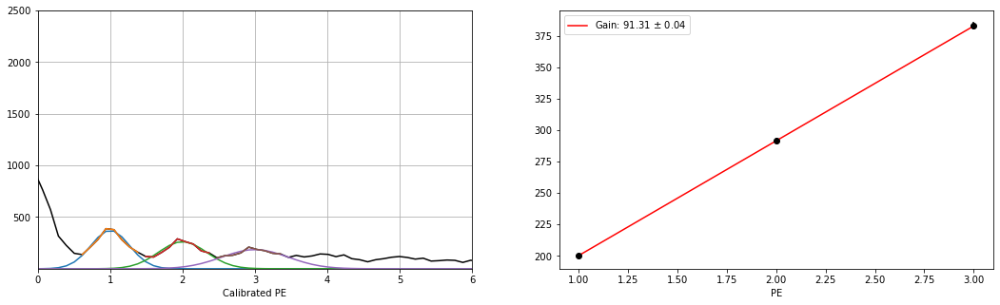

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_26.h5
Guess:  [409, 205.0375457875458, 10]
Params:  [395.03962792 201.16190403  25.09151747]
Guess:  [261, 285.05219780219784, 10]
Params:  [249.60437562 292.67287786  34.21858889]
Guess:  [210, 385.0705128205128, 10]
Params:  [199.66980681 382.08176031  37.81849636]
[90.45992815 -1.22764109]


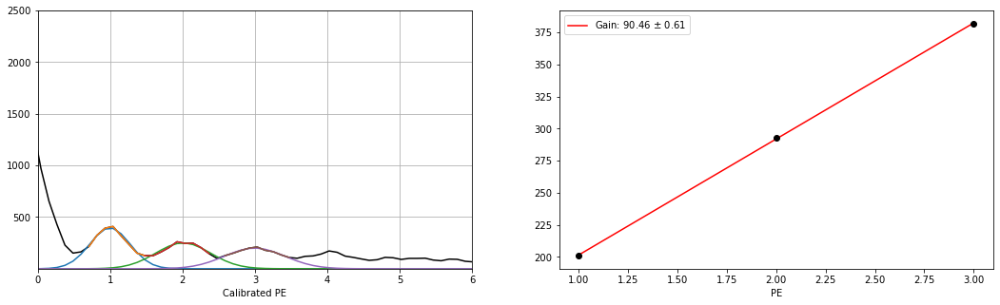

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_25.h5
Guess:  [391, 205.0375457875458, 10]
Params:  [371.48931182 203.37428849  25.52267757]
Guess:  [269, 295.0540293040293, 10]
Params:  [248.89155744 294.13195383  33.27389845]
Guess:  [201, 385.0705128205128, 10]
Params:  [191.53343136 385.91241591  39.24763621]
[91.26906371 -1.22642606]


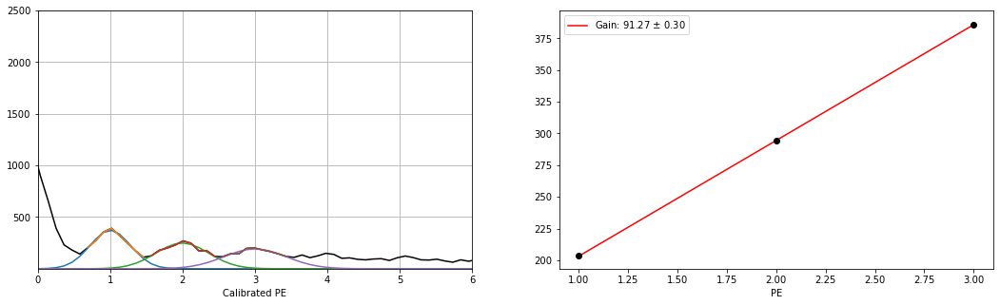

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_24.h5
Guess:  [405, 195.03571428571428, 10]
Params:  [397.13304909 200.48326819  23.46023485]
Guess:  [270, 285.05219780219784, 10]
Params:  [238.49003889 291.34041173  32.78200849]
Guess:  [195, 385.0705128205128, 10]
Params:  [174.77240681 388.1303896   48.00966141]
[93.82356071 -1.12627256]


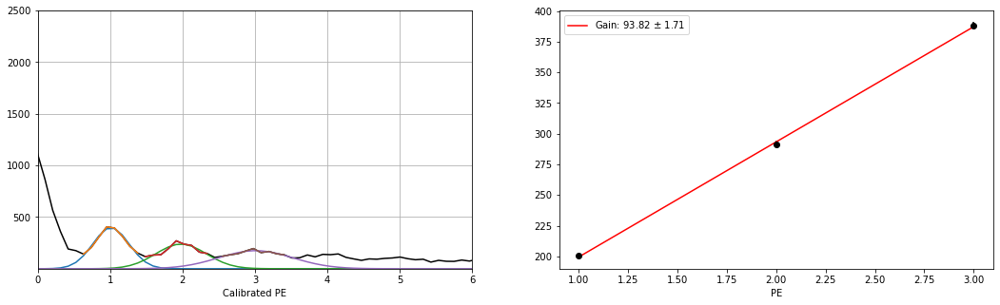

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_23.h5
Guess:  [408, 205.0375457875458, 10]
Params:  [387.78605192 202.22314912  24.5095703 ]
Guess:  [281, 285.05219780219784, 10]
Params:  [273.71414687 291.20187671  30.26334068]
Guess:  [204, 385.0705128205128, 10]
Params:  [192.64221845 384.93925268  38.82239299]
[91.35805182 -1.20484169]


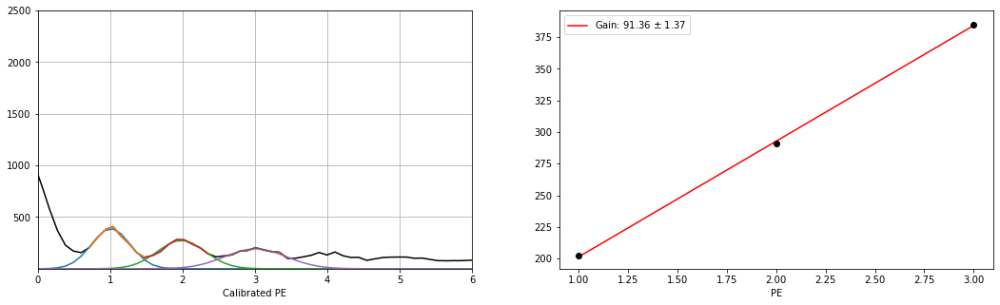

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_22.h5
Guess:  [389, 195.03571428571428, 10]
Params:  [361.61841647 201.21076628  25.70356108]
Guess:  [268, 295.0540293040293, 10]
Params:  [261.07711446 291.51496417  31.40499358]
Guess:  [204, 395.0723443223443, 10]
Params:  [183.58835849 383.30301708  42.36663128]
[91.0461254  -1.20727083]


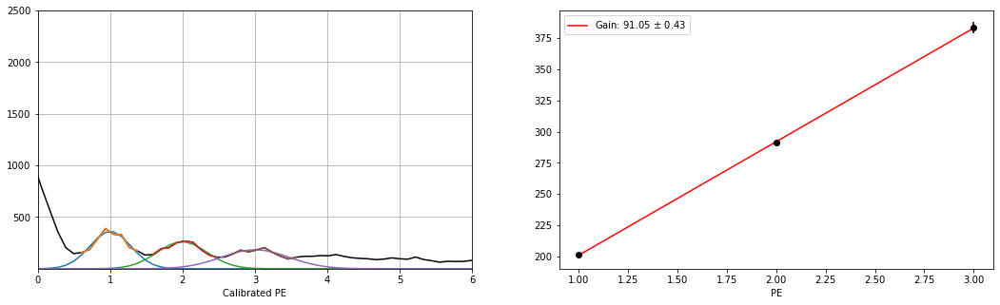

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_21.h5
Guess:  [409, 205.0375457875458, 10]
Params:  [383.93120046 202.6717352   24.99936326]
Guess:  [302, 295.0540293040293, 10]
Params:  [274.97584194 296.2555487   30.61464202]
Guess:  [215, 385.0705128205128, 10]
Params:  [193.79505621 383.86817101  39.20543649]
[90.59821793 -1.24802362]


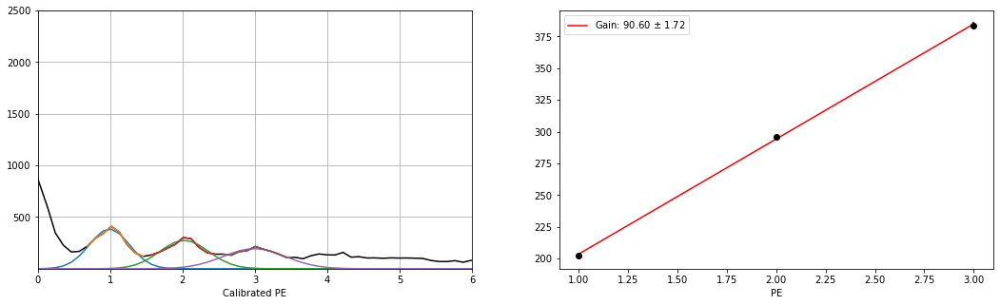

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_20.h5
Guess:  [379, 205.0375457875458, 10]
Params:  [371.72740756 202.77286786  24.97162232]
Guess:  [285, 305.0558608058608, 10]
Params:  [263.45251174 296.87024559  32.43521149]
Guess:  [196, 385.0705128205128, 10]
Params:  [168.28544873 381.69047298  49.96651088]
[89.45880259 -1.28394583]


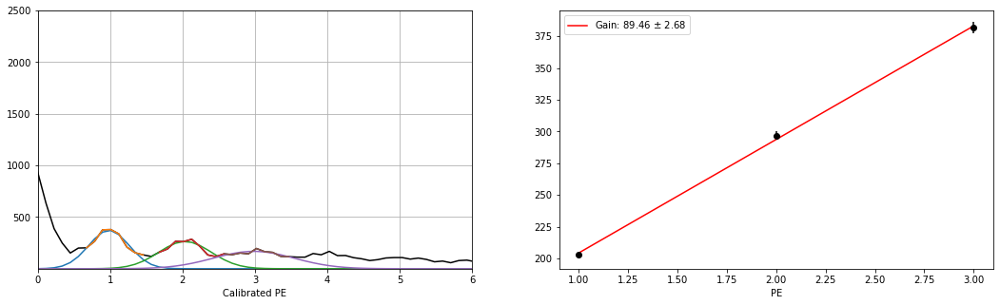

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_19.h5
Guess:  [383, 205.0375457875458, 10]
Params:  [378.96875599 203.16278367  25.62157666]
Guess:  [272, 295.0540293040293, 10]
Params:  [259.73212832 293.27728622  32.34854508]
Guess:  [209, 385.0705128205128, 10]
Params:  [196.75155948 385.8748549   32.98502412]
[91.35603562 -1.21932725]


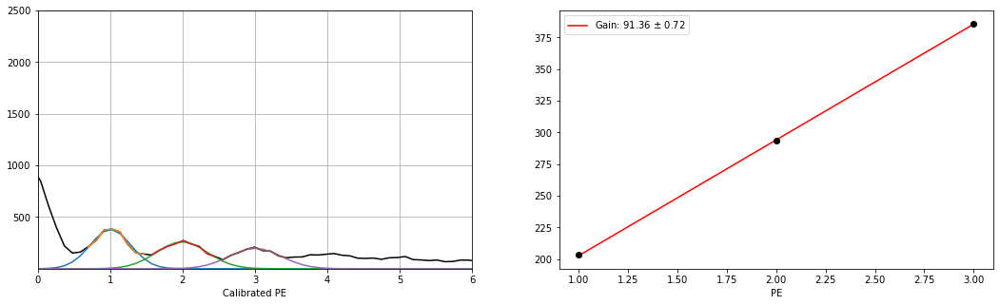

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_18.h5
Guess:  [357, 195.03571428571428, 10]
Params:  [353.23289515 200.01420646  26.8154226 ]
Guess:  [247, 285.05219780219784, 10]
Params:  [248.74068155 292.54308883  32.41143551]
Guess:  [223, 375.06868131868134, 10]
Params:  [195.80901909 380.69890076  38.63215697]
[90.34234722 -1.22202608]


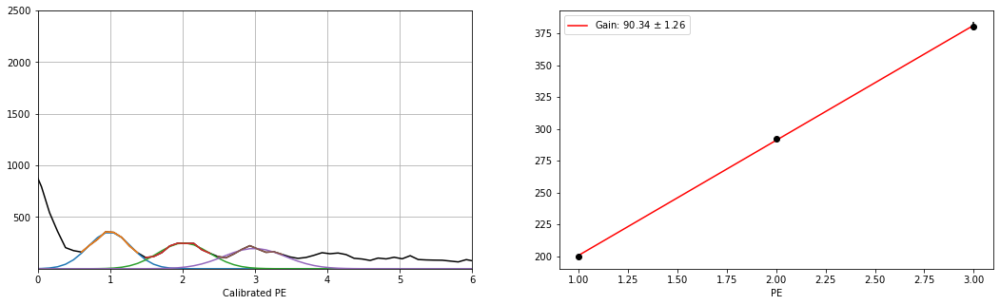

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_17.h5
Guess:  [398, 205.0375457875458, 10]
Params:  [372.43584846 203.52998104  23.94495199]
Guess:  [256, 285.05219780219784, 10]
Params:  [239.83035205 293.89148065  35.17231542]
Guess:  [214, 385.0705128205128, 10]
Params:  [193.62299975 384.4507697   34.26339336]
[90.46039433 -1.2495703 ]


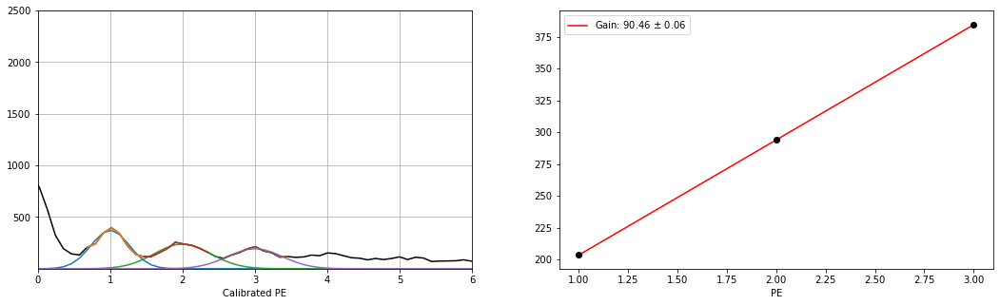

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_16.h5
Guess:  [401, 205.0375457875458, 10]
Params:  [403.28610708 202.42191232  24.20522113]
Guess:  [276, 295.0540293040293, 10]
Params:  [254.73519459 293.27357476  33.65362616]
Guess:  [212, 385.0705128205128, 10]
Params:  [195.06835825 385.6039147   37.48292613]
[91.59100118 -1.2073726 ]


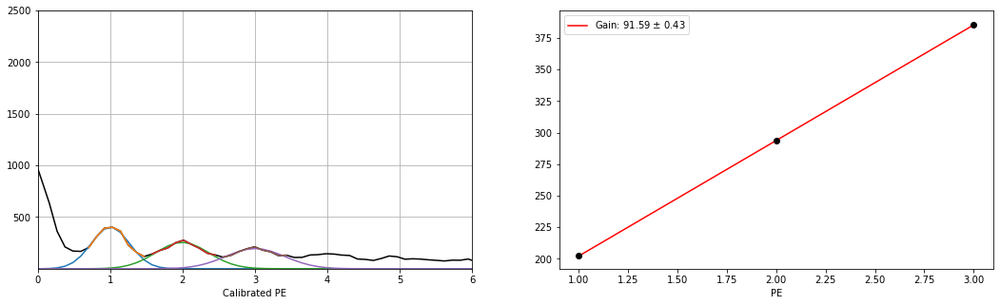

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_15.h5
Guess:  [381, 205.0375457875458, 10]
Params:  [389.79207111 202.38757169  25.092302  ]
Guess:  [304, 295.0540293040293, 10]
Params:  [276.72358253 294.24600277  28.031386  ]
Guess:  [214, 375.06868131868134, 10]
Params:  [196.00571336 382.92195327  37.21972471]
[90.26719084 -1.24797053]


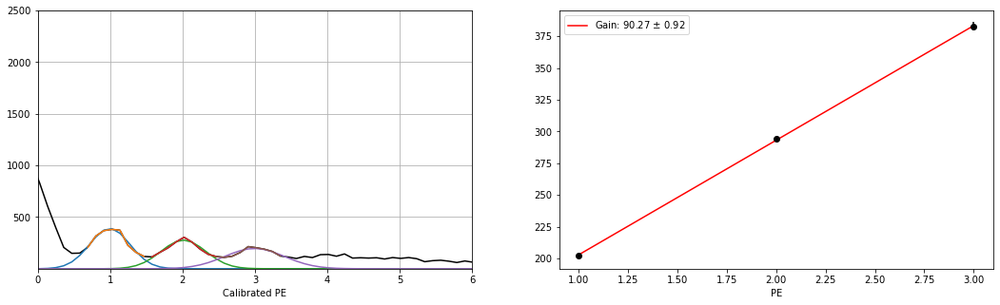

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_14.h5
Guess:  [401, 205.0375457875458, 10]
Params:  [397.90848564 201.91628002  24.08990838]
Guess:  [264, 285.05219780219784, 10]
Params:  [255.84809514 291.83519332  30.65873258]
Guess:  [196, 385.0705128205128, 10]
Params:  [187.12009359 381.95197951  38.19346142]
[90.01784974 -1.24270299]


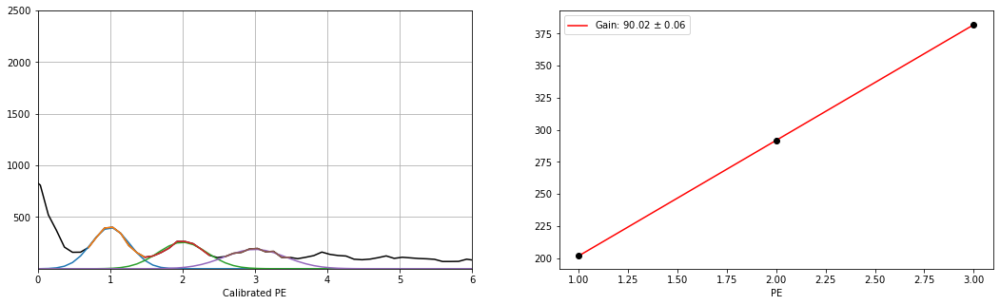

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_13.h5
Guess:  [382, 205.0375457875458, 10]
Params:  [376.22972826 202.30233649  25.22765118]
Guess:  [261, 295.0540293040293, 10]
Params:  [244.24331453 293.59541575  32.36543251]
Guess:  [204, 375.06868131868134, 10]
Params:  [192.01903206 380.20429218  38.06506865]
[88.95097783 -1.28308943]


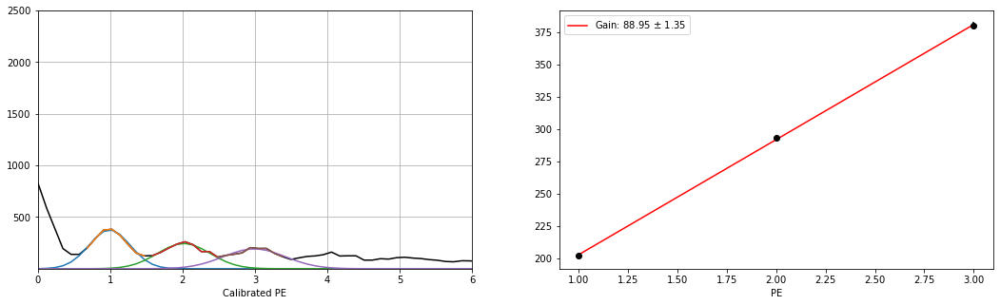

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_12.h5
Guess:  [378, 205.0375457875458, 10]
Params:  [369.89796545 202.42199749  23.45107275]
Guess:  [258, 295.0540293040293, 10]
Params:  [254.18611125 292.20467775  30.26026128]
Guess:  [185, 395.0723443223443, 10]
Params:  [173.38467893 383.68431219  43.72799615]
[90.63115736 -1.23034967]


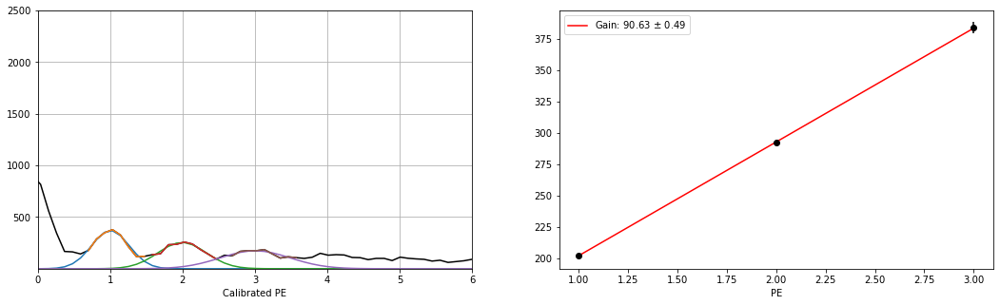

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_11.h5
Guess:  [402, 205.0375457875458, 10]
Params:  [376.39470321 201.80656195  24.79847086]
Guess:  [251, 285.05219780219784, 10]
Params:  [237.08057147 291.50088384  33.22857652]
Guess:  [186, 375.06868131868134, 10]
Params:  [172.72324405 379.59941261  41.34419462]
[88.89642533 -1.27312321]


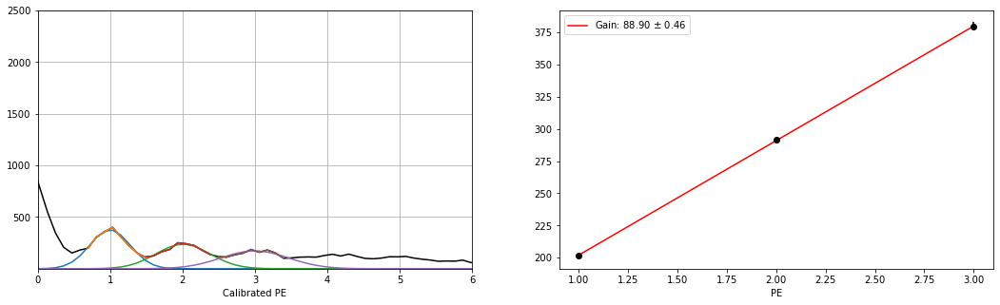

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_10.h5
Guess:  [385, 205.0375457875458, 10]
Params:  [365.55841345 201.79922012  24.5828228 ]
Guess:  [276, 285.05219780219784, 10]
Params:  [257.87585655 291.49048344  28.74414604]
Guess:  [209, 385.0705128205128, 10]
Params:  [194.12899137 384.27791964  35.77707374]
[91.23934977 -1.20610068]


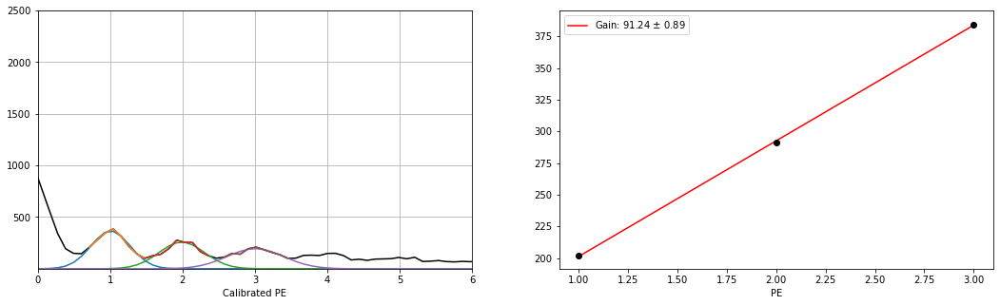

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_9.h5
Guess:  [434, 205.0375457875458, 10]
Params:  [410.78507187 201.38688233  24.11561049]
Guess:  [295, 295.0540293040293, 10]
Params:  [268.77961727 292.498377    30.39205127]
Guess:  [210, 375.06868131868134, 10]
Params:  [196.94610513 380.21429168  39.43144336]
[89.41370466 -1.25863376]


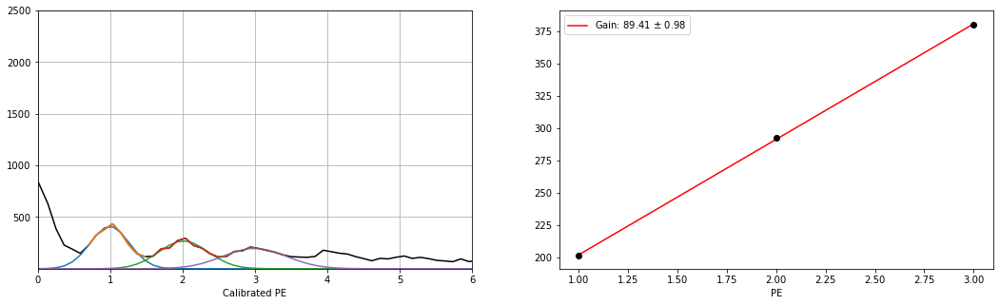

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_8.h5
Guess:  [389, 205.0375457875458, 10]
Params:  [378.7441413  201.66746552  24.99274297]
Guess:  [268, 295.0540293040293, 10]
Params:  [258.40858887 293.75960868  30.74838563]
Guess:  [191, 385.0705128205128, 10]
Params:  [189.25257741 381.27570136  38.46649162]
[89.80411793 -1.25412982]


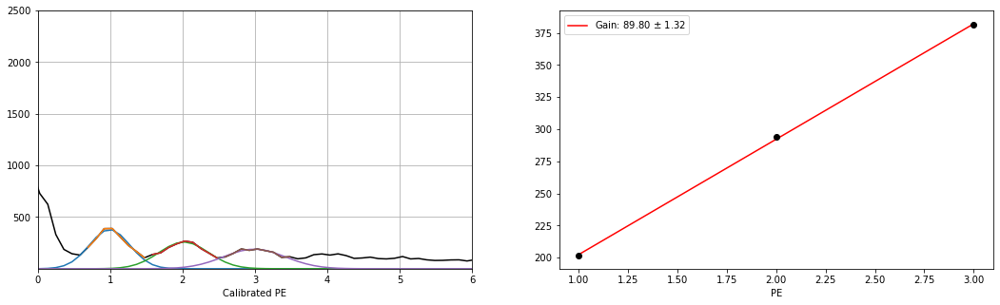

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_7.h5
Guess:  [390, 205.0375457875458, 10]
Params:  [380.55817608 202.49739794  24.09389146]
Guess:  [273, 295.0540293040293, 10]
Params:  [253.56956004 291.88099021  31.32305749]
Guess:  [194, 395.0723443223443, 10]
Params:  [184.52464919 386.05916618  45.00372226]
[91.78088413 -1.19760686]


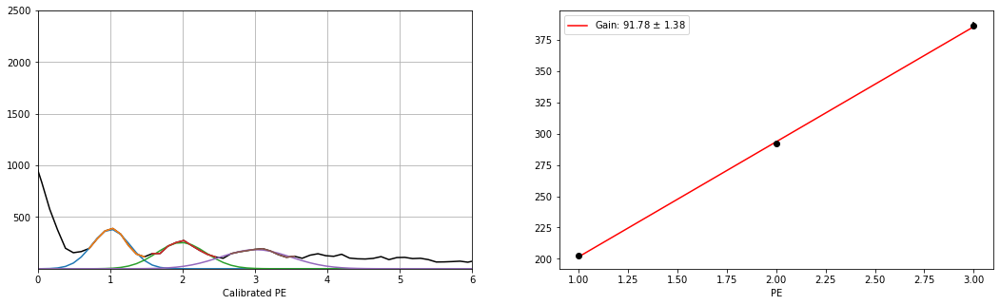

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_6.h5
Guess:  [452, 205.0375457875458, 10]
Params:  [393.30911037 202.96882816  23.34843018]
Guess:  [262, 295.0540293040293, 10]
Params:  [260.14458222 293.31328635  29.42029145]
Guess:  [201, 395.0723443223443, 10]
Params:  [191.97084994 387.15660997  39.51973851]
[92.09389098 -1.19760162]


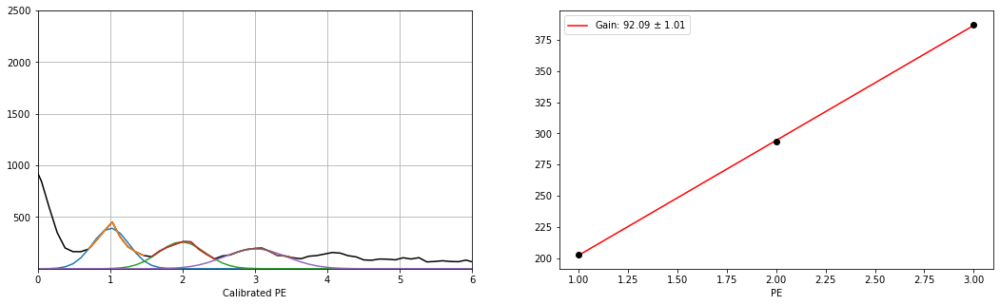

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_5.h5
Guess:  [389, 205.0375457875458, 10]
Params:  [383.55921242 201.91114367  23.90866933]
Guess:  [262, 295.0540293040293, 10]
Params:  [248.59463418 293.78455699  32.16911853]
Guess:  [191, 375.06868131868134, 10]
Params:  [181.07822312 381.27306238  44.35870861]
[89.68095944 -1.25958735]


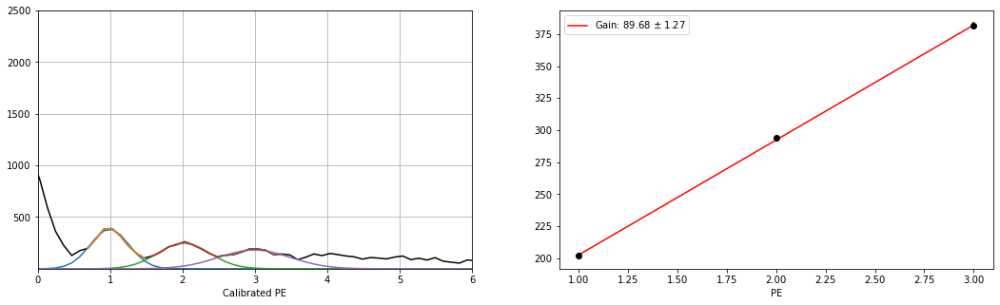

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_4.h5
Guess:  [380, 205.0375457875458, 10]
Params:  [370.23499091 201.38813888  26.22399565]
Guess:  [287, 295.0540293040293, 10]
Params:  [243.08596739 292.81626633  33.05157882]
Guess:  [197, 395.0723443223443, 10]
Params:  [185.78632756 384.88887192  41.35164013]
[91.75036652 -1.19378661]


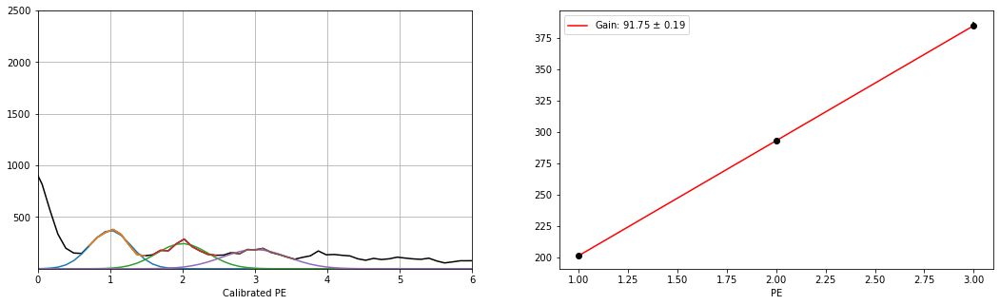

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_3.h5
Guess:  [413, 205.0375457875458, 10]
Params:  [389.39465906 200.95866215  24.29065163]
Guess:  [267, 285.05219780219784, 10]
Params:  [252.7762145  292.37721938  30.38985899]
Guess:  [212, 385.0705128205128, 10]
Params:  [199.08961195 383.2819019   33.67604905]
[91.16161987 -1.20536129]


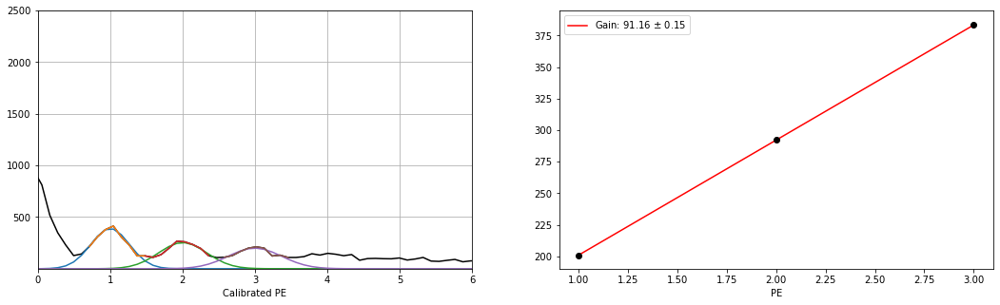

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_2.h5
Guess:  [421, 205.0375457875458, 10]
Params:  [381.0888034  202.14638731  23.35026323]
Guess:  [266, 295.0540293040293, 10]
Params:  [257.8201306  293.94815983  29.76529284]
Guess:  [195, 395.0723443223443, 10]
Params:  [186.48663267 386.63568903  44.72683708]
[92.24465088 -1.18981544]


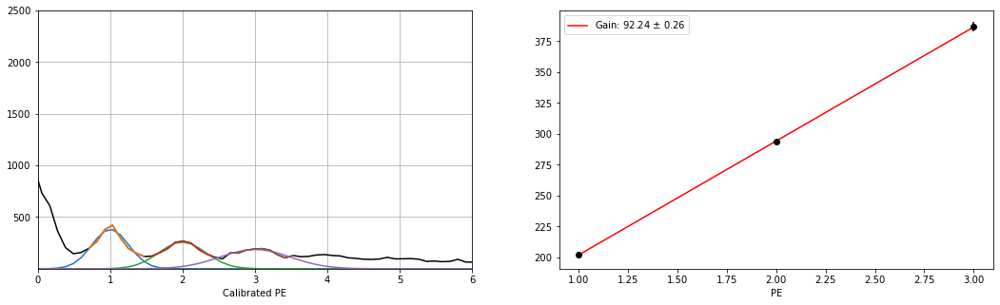

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_1.h5
Guess:  [416, 205.0375457875458, 10]
Params:  [386.24505739 202.2897208   24.99832645]
Guess:  [252, 295.0540293040293, 10]
Params:  [239.60267475 295.28671107  33.25467503]
Guess:  [206, 385.0705128205128, 10]
Params:  [195.47573416 386.55570106  35.86662205]
[92.1329901  -1.19875335]


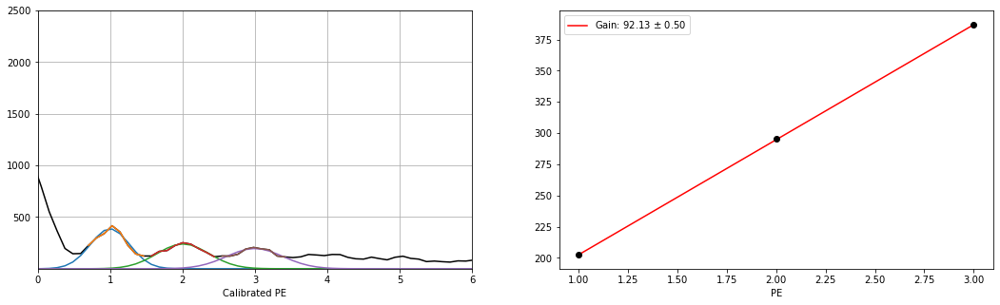

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_405_0.h5
Guess:  [393, 205.0375457875458, 10]
Params:  [364.31502095 203.15119406  25.45939431]
Guess:  [283, 285.05219780219784, 10]
Params:  [261.85334143 292.1216912   31.27624569]
Guess:  [204, 375.06868131868134, 10]
Params:  [186.87269329 382.52103049  45.02334098]
[89.68491822 -1.26251033]


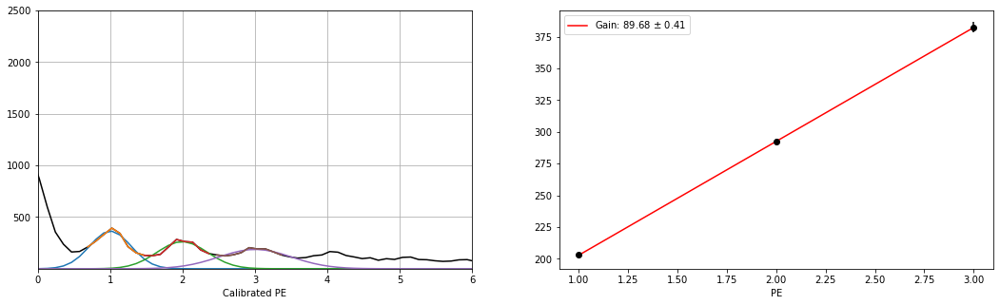

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_34.h5
Guess:  [262, 205.0375457875458, 10]
Params:  [245.59211615 203.19450213  24.11306293]
Guess:  [112, 285.05219780219784, 10]
Params:  [102.55849855 294.88770557  36.40785166]
Guess:  [85, 395.0723443223443, 10]
Params:  [ 66.27074741 390.44488223  39.63251252]
[93.62519005 -1.16341891]


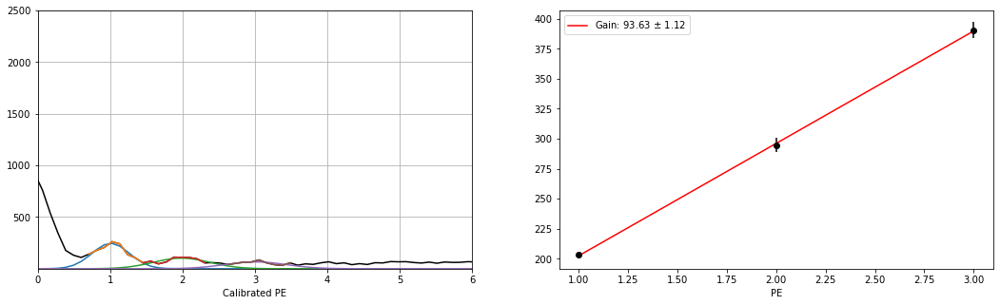

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_33.h5
Guess:  [267, 205.0375457875458, 10]
Params:  [239.61481837 201.77993766  26.59186073]
Guess:  [120, 295.0540293040293, 10]
Params:  [105.43996661 297.16007427  31.61591765]
Guess:  [80, 395.0723443223443, 10]
Params:  [ 71.61446796 390.7657518   41.85232782]
[94.49290708 -1.1385275 ]


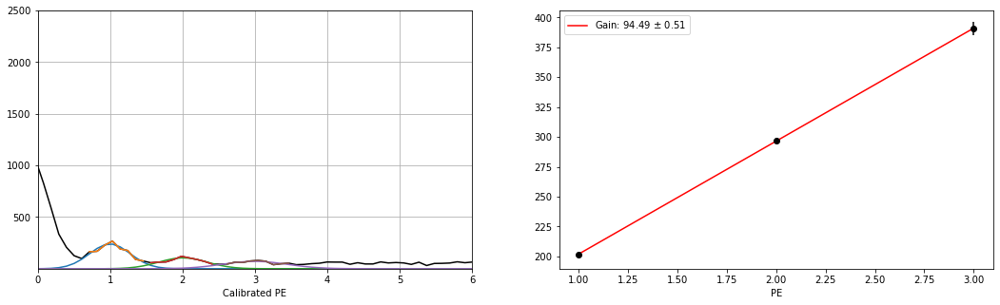

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_32.h5
Guess:  [223, 205.0375457875458, 10]
Params:  [231.31588417 200.53057897  24.19227028]
Guess:  [118, 295.0540293040293, 10]
Params:  [108.47532996 294.24097688  34.0927748 ]
Guess:  [95, 385.0705128205128, 10]
Params:  [ 72.55262995 385.16404871  35.6184161 ]
[92.31673488 -1.17723399]


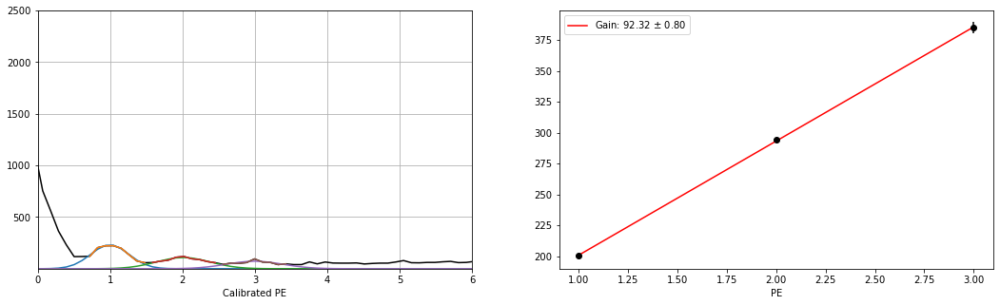

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_31.h5
Guess:  [259, 205.0375457875458, 10]
Params:  [251.54858658 202.10367573  23.59216762]
Guess:  [115, 305.0558608058608, 10]
Params:  [110.46715572 289.15761396  39.00339128]
Guess:  [82, 385.0705128205128, 10]
Params:  [ 74.05354294 385.26586622  38.16277798]
[91.58109522 -1.19034969]


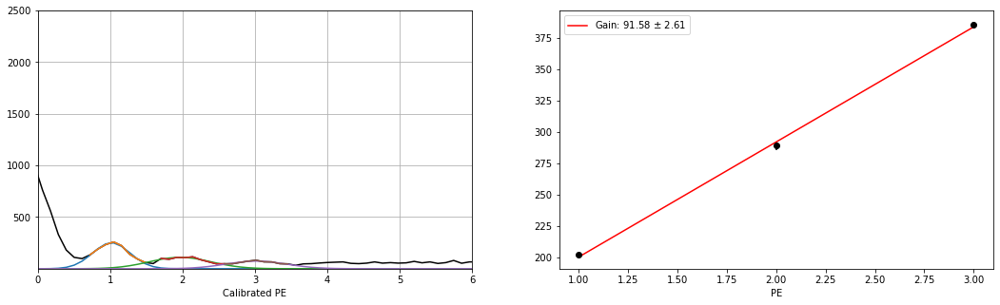

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_30.h5
Guess:  [223, 195.03571428571428, 10]
Params:  [220.79382243 199.62167184  26.54013648]
Guess:  [122, 295.0540293040293, 10]
Params:  [112.88197637 295.44877404  28.61856192]
Guess:  [80, 405.0741758241758, 10]
Params:  [ 68.93754148 396.70750696  49.98965183]
[98.54291763 -1.01654675]


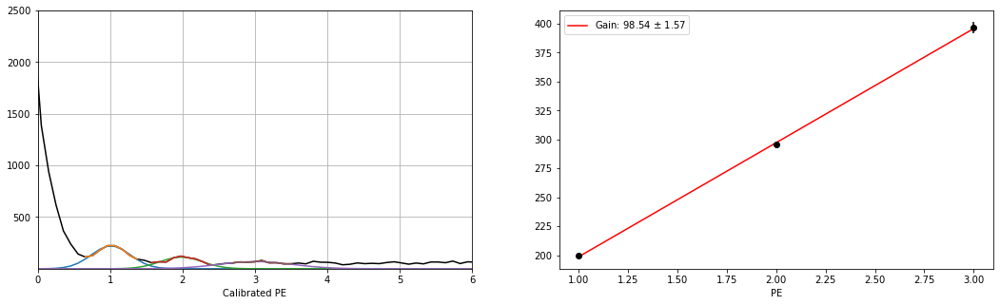

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_29.h5
Guess:  [242, 205.0375457875458, 10]
Params:  [229.43909947 201.86602865  27.04274833]
Guess:  [135, 305.0558608058608, 10]
Params:  [121.21461339 299.89878488  28.30262315]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 73.46278147 392.54909274  38.88334894]
[95.34153202 -1.1267028 ]


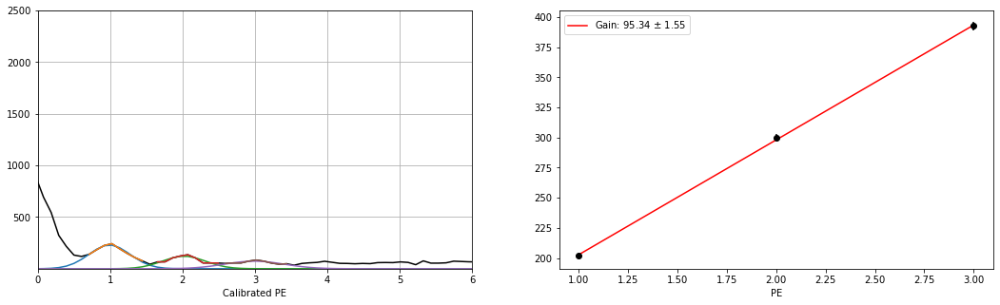

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_28.h5
Guess:  [244, 205.0375457875458, 10]
Params:  [226.28762419 204.14553444  26.25632534]
Guess:  [119, 295.0540293040293, 10]
Params:  [105.87174164 296.16044148  32.34659244]
Guess:  [86, 395.0723443223443, 10]
Params:  [ 82.52967654 393.06963694  29.68600899]
[94.4620513  -1.15250269]


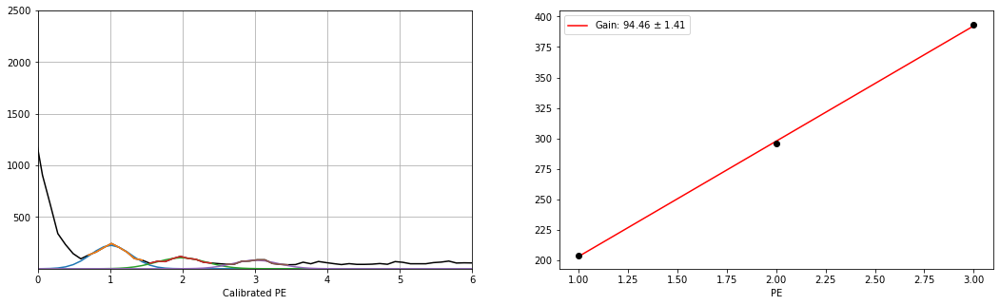

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_27.h5
Guess:  [241, 205.0375457875458, 10]
Params:  [238.48659    203.67221665  25.21577895]
Guess:  [126, 295.0540293040293, 10]
Params:  [115.47640221 295.75275835  28.12346207]
Guess:  [83, 395.0723443223443, 10]
Params:  [ 74.92556158 391.70930929  36.88021877]
[94.0185463 -1.1594273]


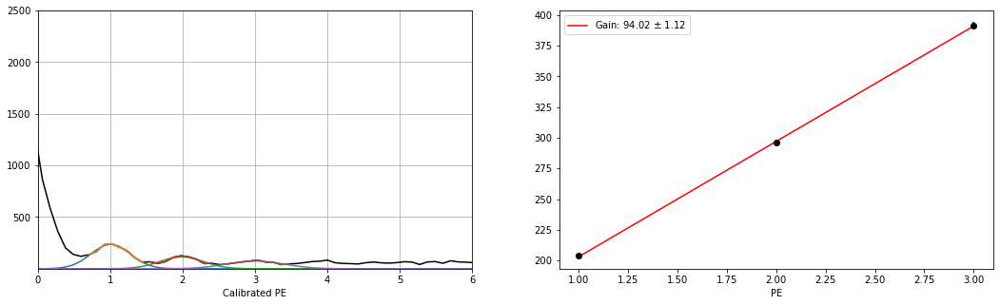

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_26.h5
Guess:  [224, 205.0375457875458, 10]
Params:  [215.28982328 203.50054578  25.28871836]
Guess:  [124, 295.0540293040293, 10]
Params:  [112.93904799 296.75604087  27.6100922 ]
Guess:  [87, 385.0705128205128, 10]
Params:  [ 76.19122008 385.91643979  32.62306649]
[91.20794694 -1.23865429]


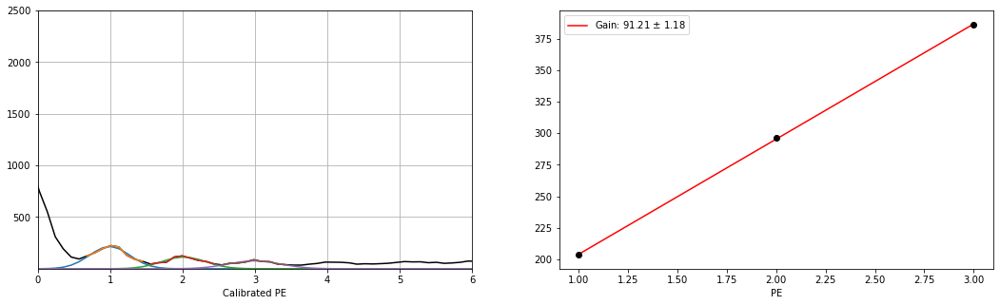

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_25.h5
Guess:  [234, 205.0375457875458, 10]
Params:  [235.69906883 201.2583207   25.76942726]
Guess:  [117, 295.0540293040293, 10]
Params:  [110.78106896 295.38429591  32.81825562]
Guess:  [83, 395.0723443223443, 10]
Params:  [ 64.59843404 390.65183194  48.39424601]
[94.69675562 -1.12328352]


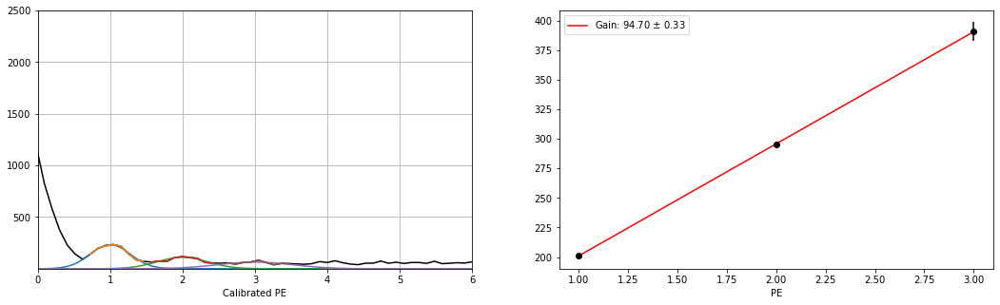

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_24.h5
Guess:  [221, 205.0375457875458, 10]
Params:  [226.28629381 201.24847776  25.11196384]
Guess:  [115, 305.0558608058608, 10]
Params:  [113.78493826 299.75356155  28.63998047]
Guess:  [68, 385.0705128205128, 10]
Params:  [ 67.09590792 387.95646797  37.98575916]
[93.35399518 -1.17414913]


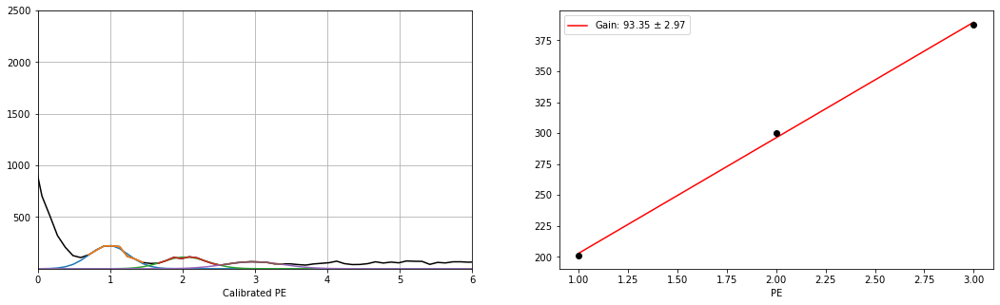

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_23.h5
Guess:  [248, 205.0375457875458, 10]
Params:  [233.89722461 204.77331382  22.29535899]
Guess:  [119, 305.0558608058608, 10]
Params:  [110.08421643 297.71200441  30.59910987]
Guess:  [97, 385.0705128205128, 10]
Params:  [ 70.04155829 385.36645978  36.99441755]
[90.29657304 -1.27753959]


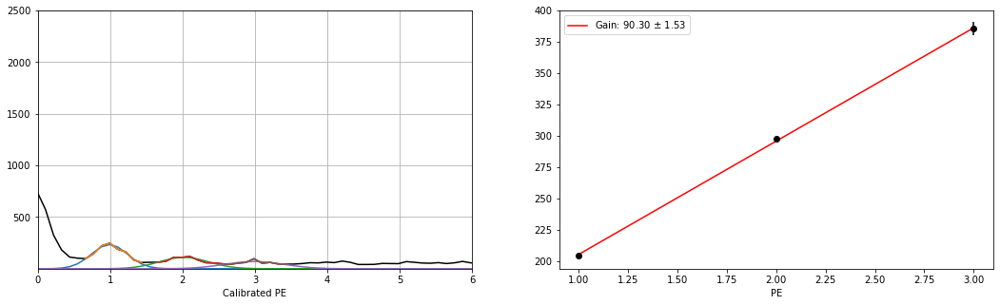

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_22.h5
Guess:  [236, 205.0375457875458, 10]
Params:  [229.49834712 204.22178138  23.90679559]
Guess:  [110, 295.0540293040293, 10]
Params:  [ 97.27831576 294.84108713  29.90559462]
Guess:  [74, 405.0741758241758, 10]
Params:  [ 68.31233917 391.48640073  44.19562325]
[93.63230967 -1.17037738]


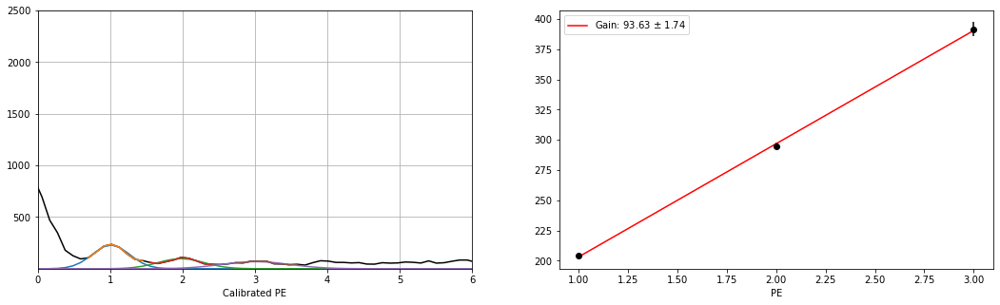

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_21.h5
Guess:  [253, 205.0375457875458, 10]
Params:  [243.2416044  203.1672507   23.30836388]
Guess:  [136, 295.0540293040293, 10]
Params:  [123.01784793 295.40443686  27.62653263]
Guess:  [83, 405.0741758241758, 10]
Params:  [ 72.45380529 393.8836082   40.40735487]
[95.35817877 -1.11966003]


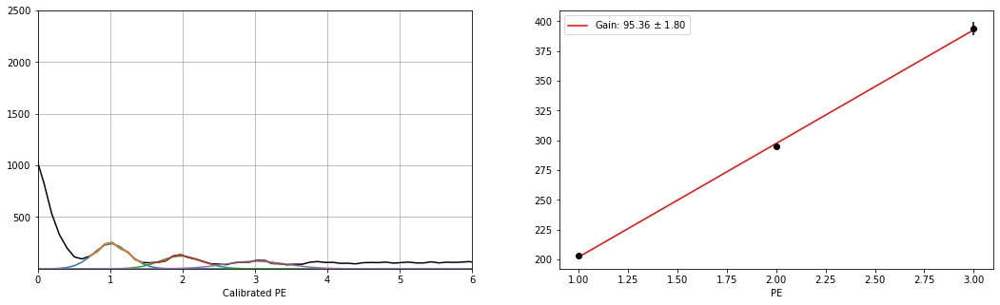

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_20.h5
Guess:  [246, 205.0375457875458, 10]
Params:  [241.15925657 203.19336655  23.02173064]
Guess:  [116, 305.0558608058608, 10]
Params:  [113.21732956 300.1991746   29.55854741]
Guess:  [76, 385.0705128205128, 10]
Params:  [ 71.62603661 388.01475412  36.9909553 ]
[92.41069371 -1.21538291]


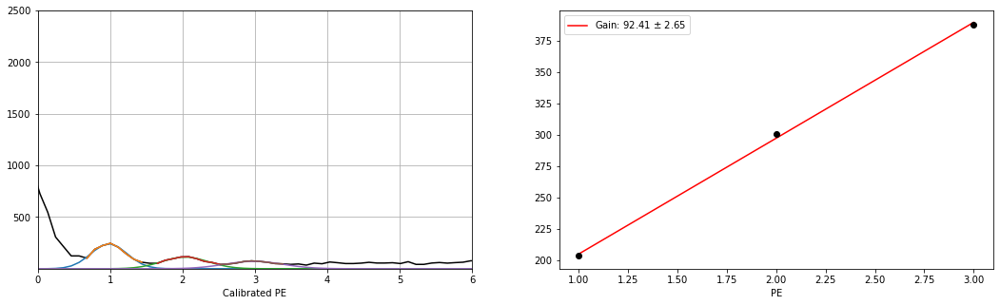

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_19.h5
Guess:  [256, 205.0375457875458, 10]
Params:  [226.63216262 202.11209971  25.55952523]
Guess:  [125, 305.0558608058608, 10]
Params:  [120.70727396 300.14659483  26.57995298]
Guess:  [80, 385.0705128205128, 10]
Params:  [ 75.40363369 385.89341043  38.62603521]
[91.89065545 -1.22177157]


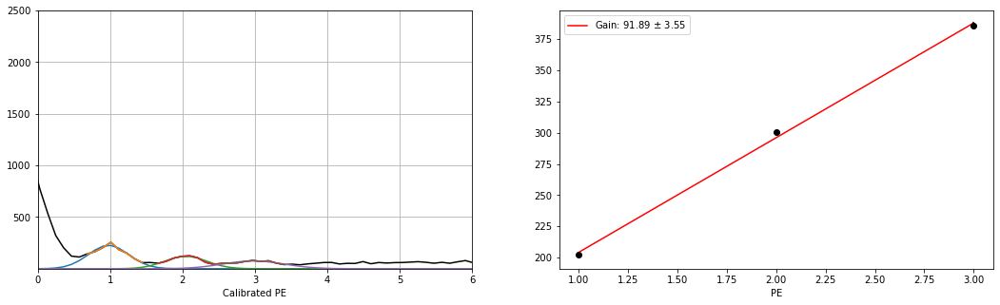

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_18.h5
Guess:  [249, 205.0375457875458, 10]
Params:  [242.87538353 202.63709689  24.32277807]
Guess:  [119, 295.0540293040293, 10]
Params:  [110.51126111 293.1319816   33.57853443]
Guess:  [101, 405.0741758241758, 10]
Params:  [ 80.89502852 396.15575202  34.09839068]
[96.75932773 -1.07265753]


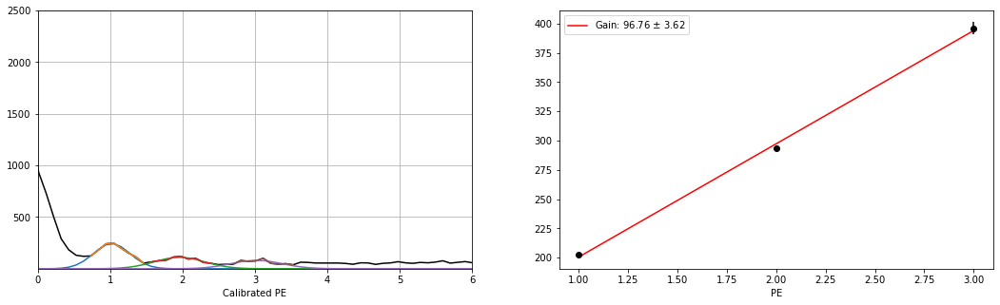

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_17.h5
Guess:  [227, 205.0375457875458, 10]
Params:  [220.20125852 203.52919034  23.91604425]
Guess:  [117, 305.0558608058608, 10]
Params:  [104.64347121 296.8981863   27.81349813]
Guess:  [78, 395.0723443223443, 10]
Params:  [ 76.50872001 388.83350841  37.81056539]
[92.65215906 -1.19928103]


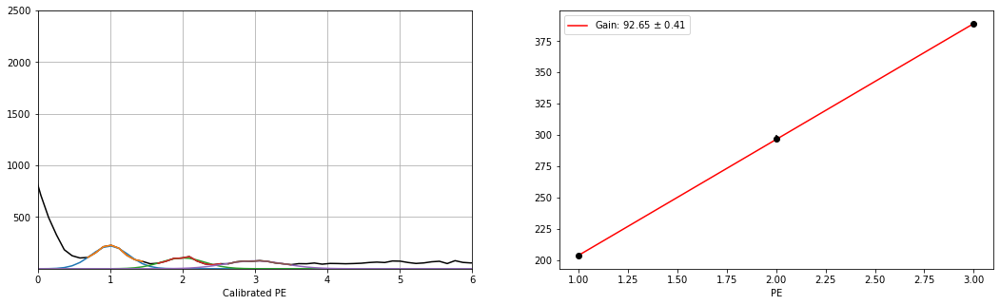

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_16.h5
Guess:  [273, 195.03571428571428, 10]
Params:  [243.45097184 200.39827217  26.29276405]
Guess:  [126, 295.0540293040293, 10]
Params:  [113.31757218 296.18554879  31.07268682]
Guess:  [87, 385.0705128205128, 10]
Params:  [ 71.30984741 391.75344197  38.31400655]
[95.6775849  -1.09489857]


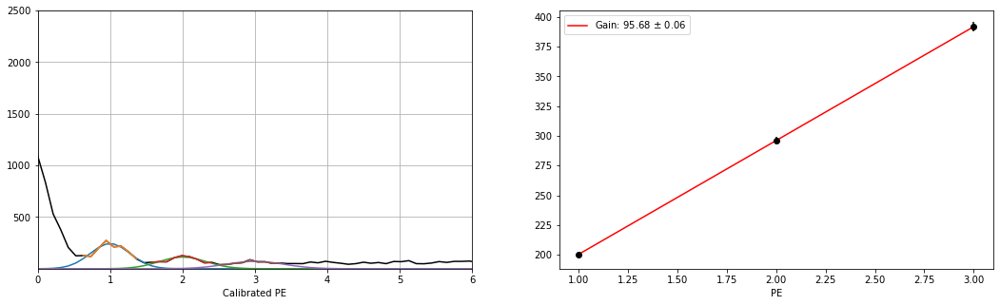

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_15.h5
Guess:  [240, 205.0375457875458, 10]
Params:  [220.79228875 202.5013164   25.12274209]
Guess:  [121, 295.0540293040293, 10]
Params:  [113.75887387 296.80043861  29.76323669]
Guess:  [77, 385.0705128205128, 10]
Params:  [ 65.74505192 391.86324294  41.35289166]
[94.68096329 -1.13743111]


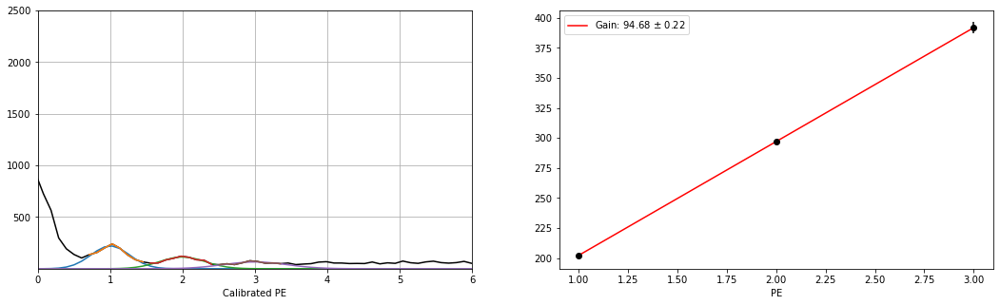

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_14.h5
Guess:  [234, 205.0375457875458, 10]
Params:  [238.05672175 204.31896135  24.26517852]
Guess:  [109, 305.0558608058608, 10]
Params:  [106.9840993  301.99094054  30.71656881]
Guess:  [75, 375.06868131868134, 10]
Params:  [ 70.35163143 376.27294495  38.63545893]
[85.97699221 -1.42177918]


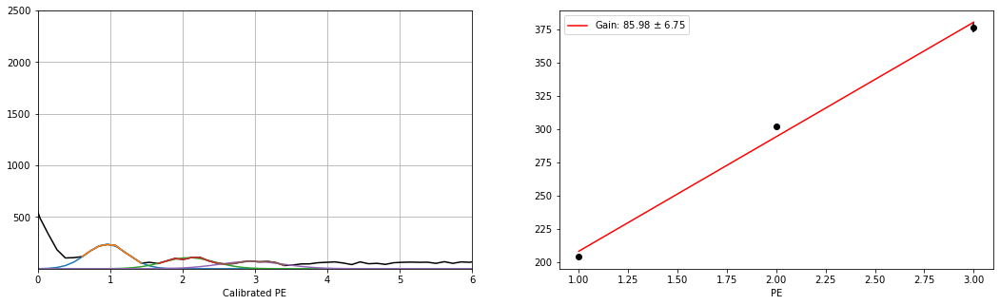

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_13.h5
Guess:  [233, 205.0375457875458, 10]
Params:  [227.40126484 201.95756596  24.63548722]
Guess:  [120, 295.0540293040293, 10]
Params:  [109.46560709 296.38153067  29.70964219]
Guess:  [67, 395.0723443223443, 10]
Params:  [ 63.14956963 387.73285682  40.47567439]
[92.88764544 -1.17972661]


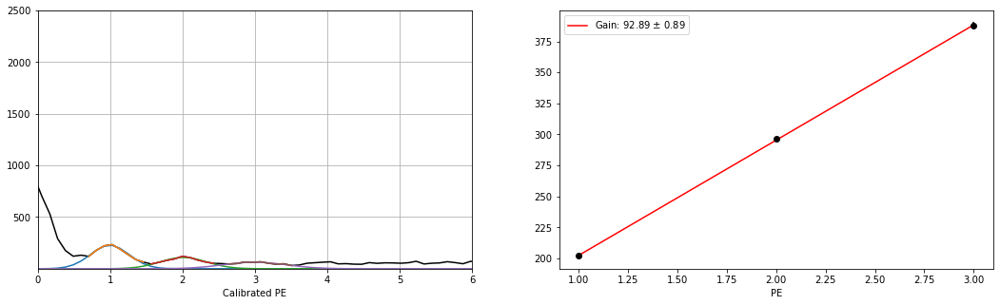

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_12.h5
Guess:  [234, 205.0375457875458, 10]
Params:  [230.56785897 202.37405737  24.53172912]
Guess:  [143, 295.0540293040293, 10]
Params:  [123.53512892 295.08787913  30.31413154]
Guess:  [85, 395.0723443223443, 10]
Params:  [ 75.65708635 390.54093335  35.47730538]
[94.08343802 -1.1461537 ]


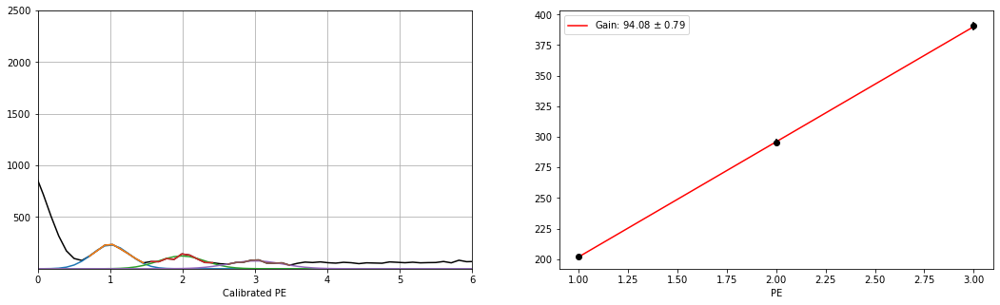

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_11.h5
Guess:  [255, 205.0375457875458, 10]
Params:  [237.95471175 202.6650727   25.33346973]
Guess:  [127, 295.0540293040293, 10]
Params:  [114.56350897 296.66201548  31.76790861]
Guess:  [85, 395.0723443223443, 10]
Params:  [ 75.14606445 389.38982062  40.72471449]
[93.36237398 -1.17300168]


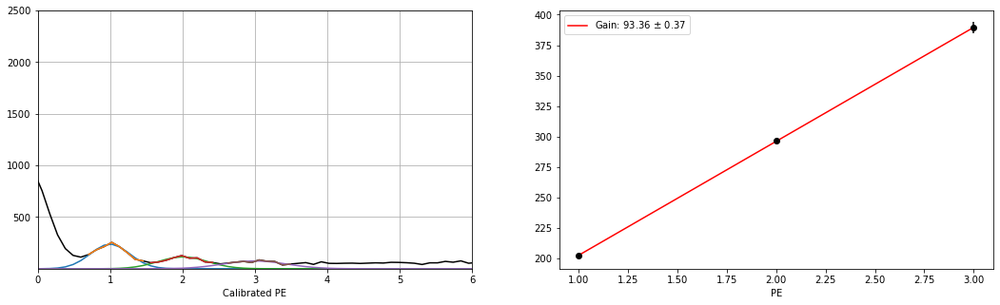

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_10.h5
Guess:  [236, 205.0375457875458, 10]
Params:  [228.74876556 203.31865884  25.17353849]
Guess:  [116, 295.0540293040293, 10]
Params:  [109.54301534 298.15516226  30.82953761]
Guess:  [94, 395.0723443223443, 10]
Params:  [ 74.14035603 395.96917566  32.67329847]
[96.32525841 -1.10559941]


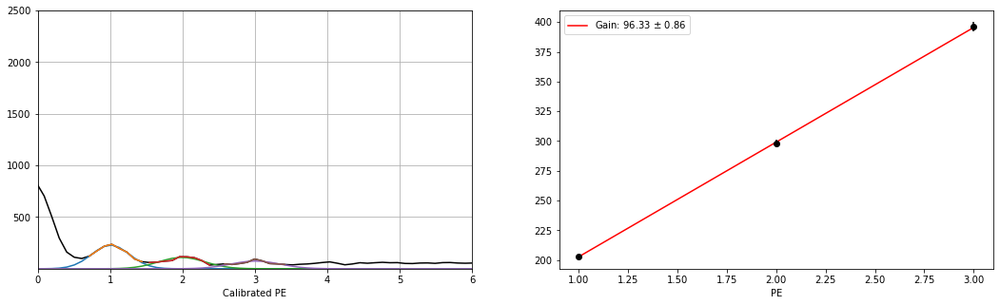

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_9.h5
Guess:  [225, 205.0375457875458, 10]
Params:  [227.23139037 203.52436719  25.04441099]
Guess:  [120, 295.0540293040293, 10]
Params:  [105.73144708 295.5132196   29.7149603 ]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 76.9666685  392.43278216  31.45409118]
[94.45420752 -1.14604079]


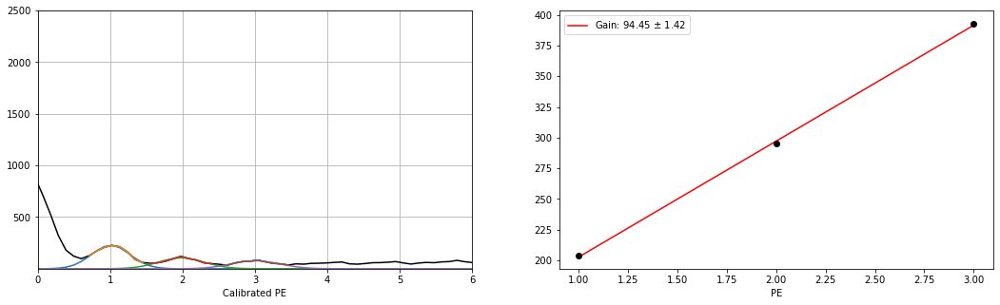

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_8.h5
Guess:  [238, 195.03571428571428, 10]
Params:  [226.82011855 200.15699147  24.63019458]
Guess:  [122, 295.0540293040293, 10]
Params:  [112.35295566 293.82066687  31.27955976]
Guess:  [79, 385.0705128205128, 10]
Params:  [ 72.6149362  389.60663369  34.13349347]
[94.72482112 -1.10930223]


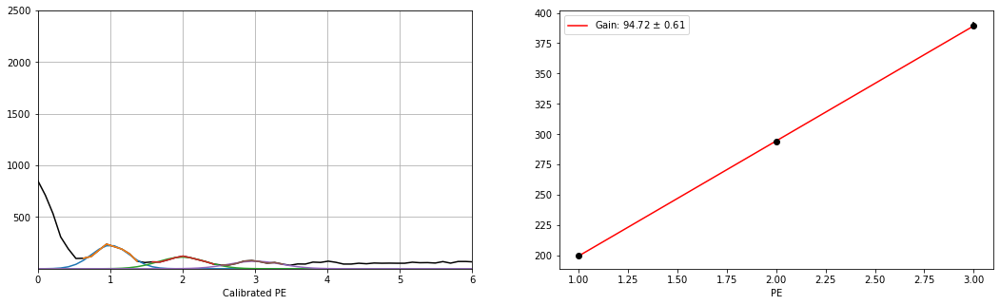

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_7.h5
Guess:  [239, 205.0375457875458, 10]
Params:  [234.67742753 204.18580697  23.68266572]
Guess:  [112, 305.0558608058608, 10]
Params:  [110.12902847 298.74123466  30.03135549]
Guess:  [90, 375.06868131868134, 10]
Params:  [ 71.56665843 386.86194755  44.84363421]
[91.33807029 -1.24723665]


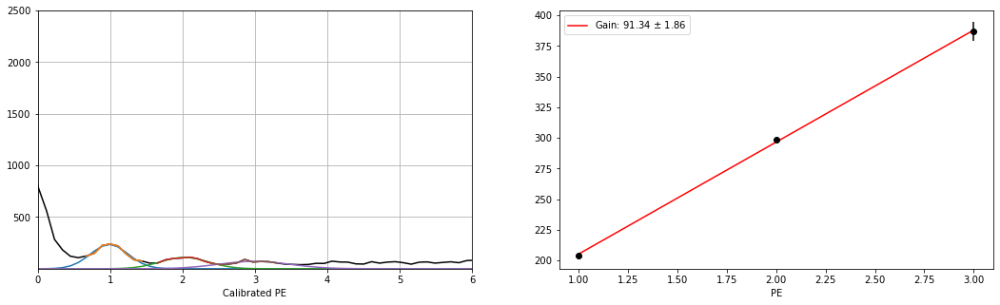

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_6.h5
Guess:  [239, 205.0375457875458, 10]
Params:  [238.93017359 203.03035642  24.34343755]
Guess:  [140, 295.0540293040293, 10]
Params:  [120.62409353 295.76528741  29.05691034]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 75.54665159 394.99723023  36.83313504]
[95.98343694 -1.10398302]


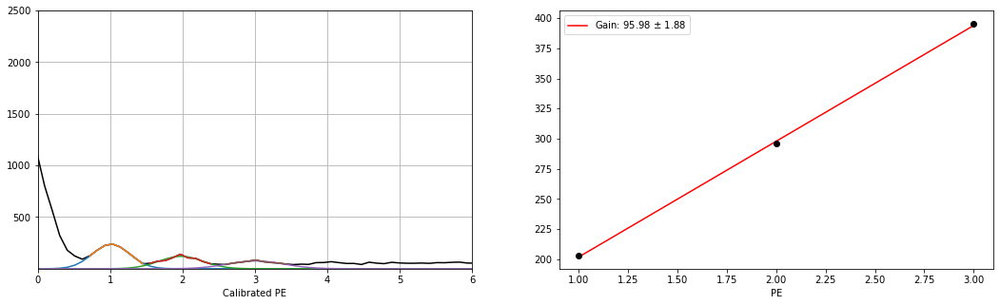

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_5.h5
Guess:  [258, 205.0375457875458, 10]
Params:  [255.99008088 203.4780657   23.74787513]
Guess:  [128, 285.05219780219784, 10]
Params:  [114.74683402 292.81710676  33.88667214]
Guess:  [75, 385.0705128205128, 10]
Params:  [ 71.15614094 392.60123443  40.37247306]
[94.56158436 -1.13339507]


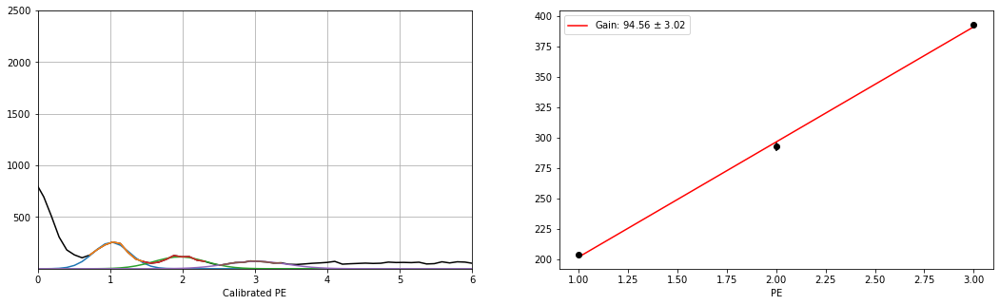

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_4.h5
Guess:  [240, 205.0375457875458, 10]
Params:  [241.59500639 203.64813127  23.5650916 ]
Guess:  [127, 295.0540293040293, 10]
Params:  [117.54366247 292.76164962  29.6072596 ]
Guess:  [91, 385.0705128205128, 10]
Params:  [ 80.79474488 387.68980131  31.59863911]
[92.02083504 -1.20253408]


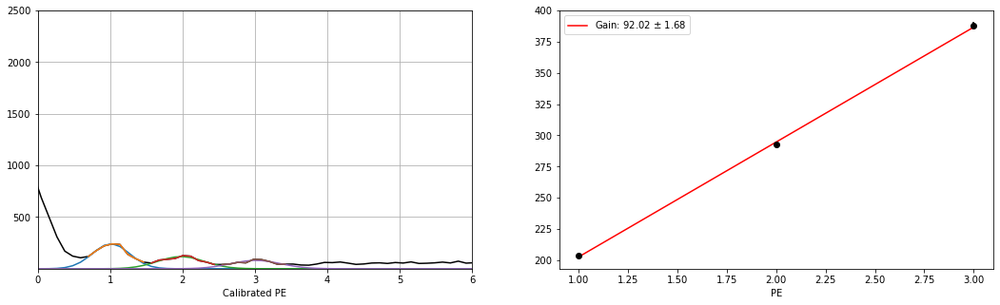

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_3.h5
Guess:  [234, 205.0375457875458, 10]
Params:  [233.75291641 202.58083367  24.45956274]
Guess:  [120, 305.0558608058608, 10]
Params:  [102.74975812 297.00916382  29.54555907]
Guess:  [80, 385.0705128205128, 10]
Params:  [ 78.77557647 388.23551708  33.39153986]
[92.82734164 -1.18808912]


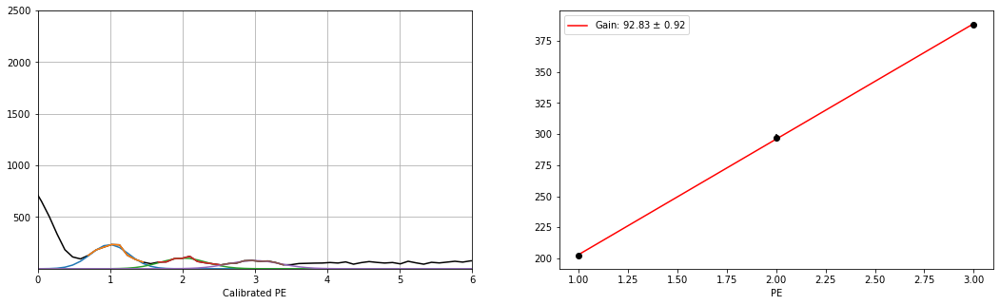

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_2.h5
Guess:  [253, 205.0375457875458, 10]
Params:  [239.93687546 203.58382021  22.53782393]
Guess:  [118, 295.0540293040293, 10]
Params:  [110.55925903 298.00277569  29.490305  ]
Guess:  [77, 405.0741758241758, 10]
Params:  [ 72.33986792 395.0685391   38.57651455]
[95.74235942 -1.12176394]


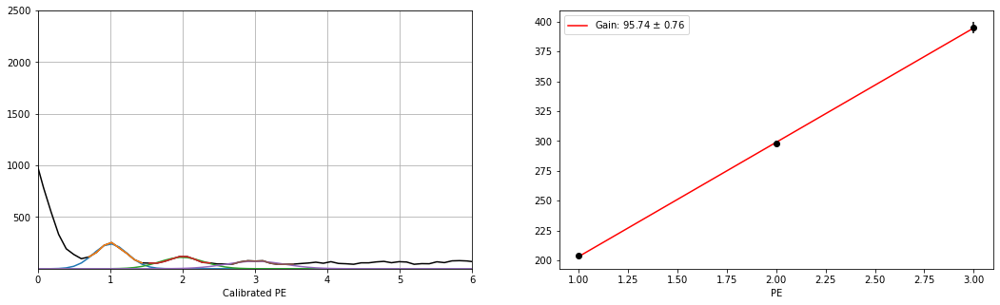

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_1.h5
Guess:  [265, 205.0375457875458, 10]
Params:  [242.56535199 202.89364539  23.78484691]
Guess:  [124, 295.0540293040293, 10]
Params:  [110.27394585 293.4572709   29.83024291]
Guess:  [69, 395.0723443223443, 10]
Params:  [ 68.40774568 394.40492893  39.29954225]
[95.75564185 -1.100795  ]


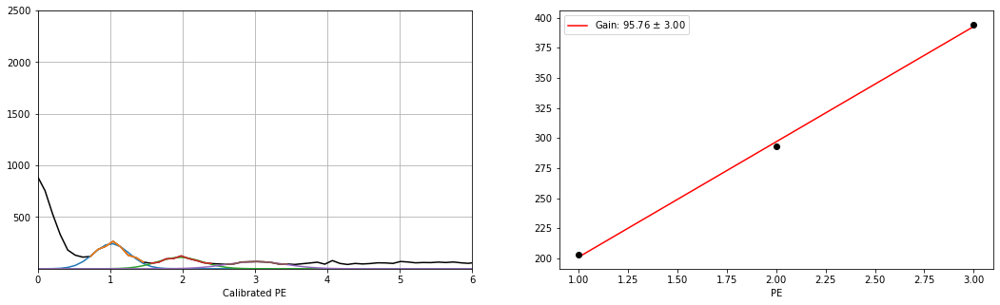

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step12/mca_keith_31.40OV_310_0.h5
Guess:  [246, 205.0375457875458, 10]
Params:  [235.49273418 203.11748499  23.28138085]
Guess:  [127, 305.0558608058608, 10]
Params:  [113.14050429 298.67065388  27.41172534]
Guess:  [83, 385.0705128205128, 10]
Params:  [ 69.4735214  386.25239106  37.50805052]
[91.56745306 -1.23273718]


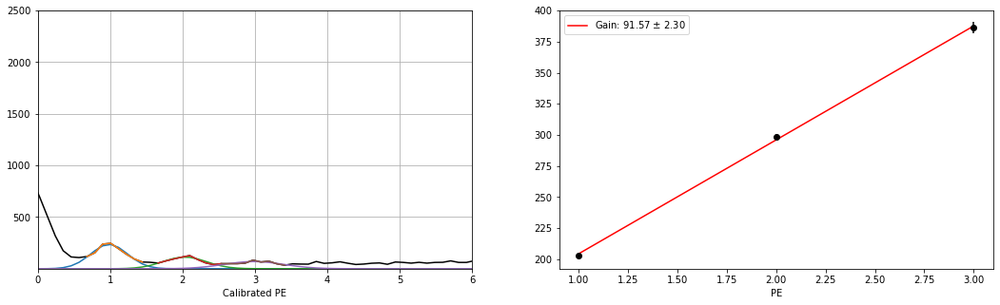

In [15]:
data_NEG_FIELD = {'source':{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[], 'dc_offset':[], 'mean_dc_offset': 0.0}, 
                  405.0:{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[],'dc_offset':[],'mean_dc_offset': 0.0},
                  310.0:{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[],'dc_offset':[],'mean_dc_offset': 0.0}}
                  
for file_type, file_list in files_12.items():
    for file in file_list:
        pe, counts, gain, gain_err, dc_offset = plot_fit_gain(file, 25, 10, 10)
        data_NEG_FIELD[file_type]['pe_data'].append(pe)
        data_NEG_FIELD[file_type]['counts'].append(counts)
        data_NEG_FIELD[file_type]['gain'].append(gain)
        data_NEG_FIELD[file_type]['gain_err'].append(gain_err)
        data_NEG_FIELD[file_type]['dc_offset'].append(dc_offset)
                  
    # Calculate the mean of the final dc_offset for each file_type
    data_NEG_FIELD[file_type]['mean_dc_offset'] = np.mean(data_NEG_FIELD[file_type]['dc_offset'])

Mean dc offset for 310 nm: -1.1651981127745483 with standard deviation: 0.06884592800020314
Mean dc offset for 405 nm: -1.2222941586100433 with standard deviation: 0.033111984055221
Mean dc offset for source: -1.100353737856193 with standard deviation: 0.016288706511276643


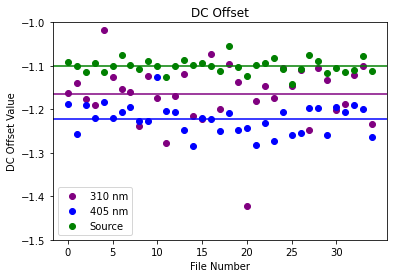

In [17]:
# Get the dc_offset data and mean_dc_offset for each file_type
NEG_dc_offset_310 = data_NEG_FIELD[310.0]['dc_offset']
NEG_dc_offset_405 = data_NEG_FIELD[405.0]['dc_offset']
NEG_dc_offset_source = data_NEG_FIELD['source']['dc_offset']

# Plot the dc_offset values
plt.ylim(-1.5,-1)
plt.xticks(np.arange(0,len(NEG_dc_offset_310),5))
plt.scatter(np.arange(0,len(NEG_dc_offset_310),1),NEG_dc_offset_310, color='purple', label='310 nm')
plt.axhline(y=data_NEG_FIELD[310.0]['mean_dc_offset'], color='purple')
plt.scatter(np.arange(0,len(NEG_dc_offset_405),1),NEG_dc_offset_405, color = 'blue', label='405 nm')
plt.axhline(y=data_NEG_FIELD[405.0]['mean_dc_offset'], color='blue')
plt.scatter(np.arange(0,len(NEG_dc_offset_source),1),NEG_dc_offset_source, color = 'green', label='Source')
plt.axhline(y=data_NEG_FIELD['source']['mean_dc_offset'], color='green')

print("Mean dc offset for 310 nm:", data_NEG_FIELD[310.0]['mean_dc_offset'], "with standard deviation:", np.std(NEG_dc_offset_310) )
print("Mean dc offset for 405 nm:", data_NEG_FIELD[405.0]['mean_dc_offset'], "with standard deviation:", np.std(NEG_dc_offset_405) )
print("Mean dc offset for source:", data_NEG_FIELD['source']['mean_dc_offset'], "with standard deviation:", np.std(NEG_dc_offset_source) )

# Add title and axis labels
plt.title("DC Offset")
plt.xlabel("File Number")
plt.ylabel("DC Offset Value")
plt.legend()

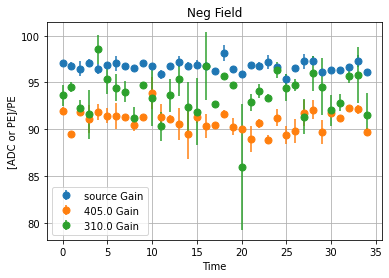

In [18]:
# plotting the gain over time

# getting the "time"
time_NEG_FIELD = {}
for key in files_12:
    time_NEG_FIELD[key] = np.arange(0, len(files_12[key]))
plt.figure(figsize=(6,4))
for key in data_NEG_FIELD:
    plt.errorbar(time_NEG_FIELD[key],np.array(data_NEG_FIELD[key]['gain']),yerr=data_NEG_FIELD[key]['gain_err'],fmt='o',ms=7,label= str(key)+' Gain')
# plt.errorbar(time_NO_FIELD,NO_FIELD_pe_corrected_gain,yerr=NO_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time')
plt.title('Neg Field')
plt.grid()
plt.legend(loc='best')
# plt.savefig('NO_FIELD_gain_comparison.pdf')
plt.show()

### No Field

In [19]:
# getting the data that we need
path_7 = '/gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/'
files_7 = load_directory(path_7)
SRS_gain_7 = 10 # gain on the SRS bandpass filter
# peak_threshold = 700 # upper bound of pedestal
# breakdown = 27.4 # breakdown voltage of the SiPM
pedestal_7 = 275 # center of noise pedestal peak

Number of files found:  104
Number of files:  104


Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_34.h5
Guess:  [1570, 205.0375457875458, 10]
Params:  [1515.66283453  204.43553119   24.07303356]
Guess:  [723, 295.0540293040293, 10]
Params:  [640.22310449 297.91657661  30.84700752]
Guess:  [398, 405.0741758241758, 10]
Params:  [377.53631454 397.28494787  29.46944338]
Guess:  [233, 485.0888278388278, 10]
Params:  [215.52667942 489.99061937  37.32235948]
Guess:  [154, 585.1071428571429, 10]
Params:  [147.43912246 590.14144816  33.5986548 ]
[96.34858769 -1.10959656]


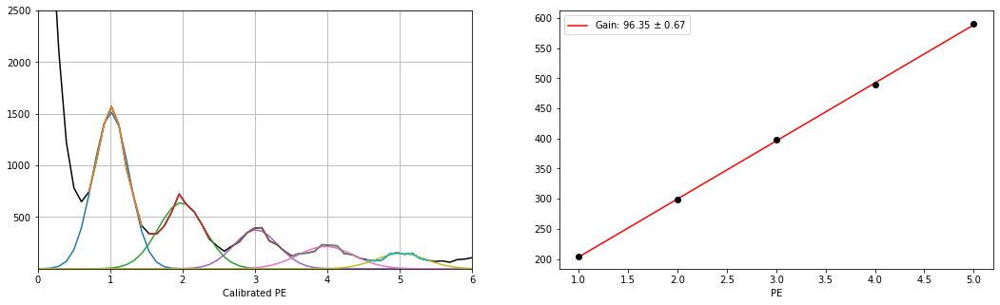

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_33.h5
Guess:  [1547, 205.0375457875458, 10]
Params:  [1473.75713094  203.4066389    24.98635408]
Guess:  [709, 295.0540293040293, 10]
Params:  [674.71434451 297.13538355  29.49656732]
Guess:  [378, 395.0723443223443, 10]
Params:  [377.31495208 394.01725139  30.37515925]
Guess:  [228, 495.09065934065933, 10]
Params:  [224.84252581 491.68036795  32.85404412]
Guess:  [153, 595.1089743589744, 10]
Params:  [151.8370839  591.02843387  32.98877767]
[96.97885745 -1.07773019]


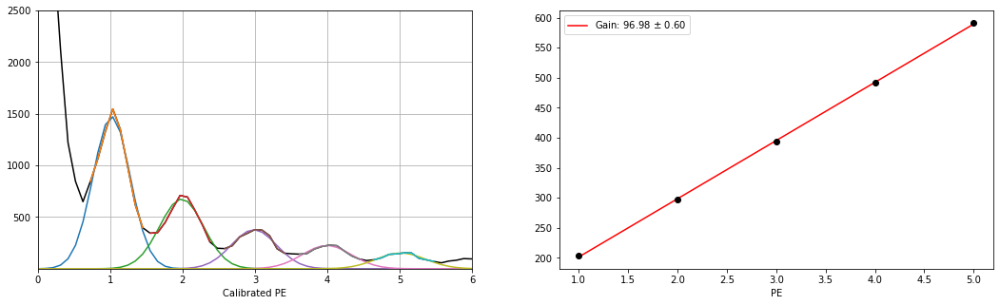

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_32.h5
Guess:  [1403, 205.0375457875458, 10]
Params:  [1350.54733888  204.13344323   26.14277466]
Guess:  [641, 305.0558608058608, 10]
Params:  [628.56196224 299.38111562  29.13377892]
Guess:  [375, 395.0723443223443, 10]
Params:  [365.79642303 396.41967127  29.98969028]
Guess:  [220, 505.09249084249086, 10]
Params:  [208.2759198  493.31078575  36.36976153]
Guess:  [158, 585.1071428571429, 10]
Params:  [140.32947672 590.21542486  34.98459153]
[96.60936333 -1.10614535]


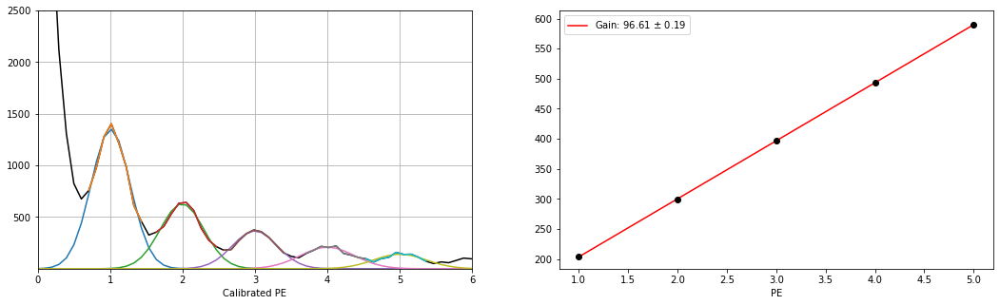

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_31.h5
Guess:  [1540, 205.0375457875458, 10]
Params:  [1491.4759263   204.43669575   23.60254306]
Guess:  [670, 295.0540293040293, 10]
Params:  [646.36114637 297.70010256  30.92242376]
Guess:  [363, 395.0723443223443, 10]
Params:  [351.79010193 395.72865176  30.63272965]
Guess:  [243, 485.0888278388278, 10]
Params:  [219.01029673 491.12476092  35.00668611]
Guess:  [146, 585.1071428571429, 10]
Params:  [139.4900255  594.02924161  42.39363555]
[97.26097499 -1.07772892]


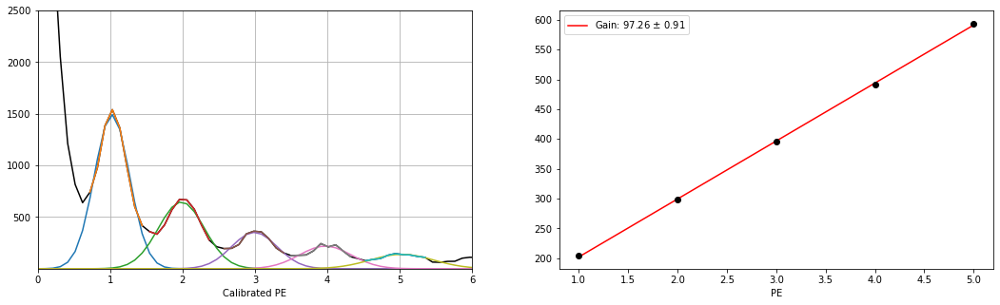

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_30.h5
Guess:  [1442, 205.0375457875458, 10]
Params:  [1400.67588193  204.24755139   24.75505909]
Guess:  [693, 295.0540293040293, 10]
Params:  [663.94142983 298.4566345   30.11071526]
Guess:  [397, 405.0741758241758, 10]
Params:  [373.23459245 398.25226609  28.84567396]
Guess:  [260, 495.09065934065933, 10]
Params:  [220.8118265  493.76713599  32.16858426]
Guess:  [162, 595.1089743589744, 10]
Params:  [144.63999481 590.55188024  35.06059873]
[96.79191592 -1.1021514 ]


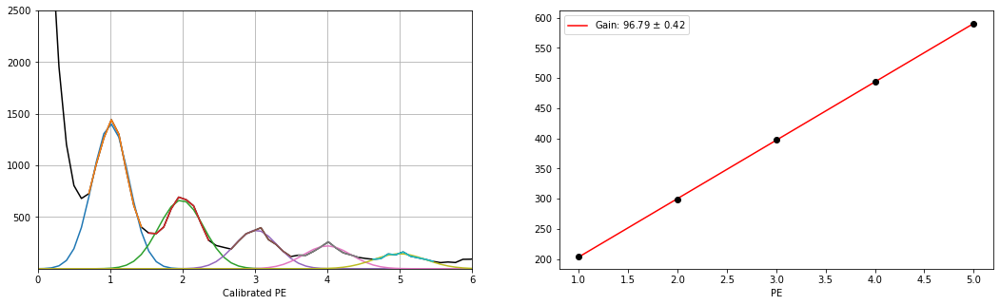

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_29.h5
Guess:  [1557, 205.0375457875458, 10]
Params:  [1497.21303688  204.26677262   23.98320867]
Guess:  [706, 295.0540293040293, 10]
Params:  [667.07107154 298.61880683  29.59611113]
Guess:  [398, 405.0741758241758, 10]
Params:  [374.7222353  397.53888016  28.54608406]
Guess:  [219, 485.0888278388278, 10]
Params:  [213.58356455 489.86421132  36.92369833]
Guess:  [143, 595.1089743589744, 10]
Params:  [140.35787542 588.41679325  40.21432607]
[95.95454456 -1.12425586]


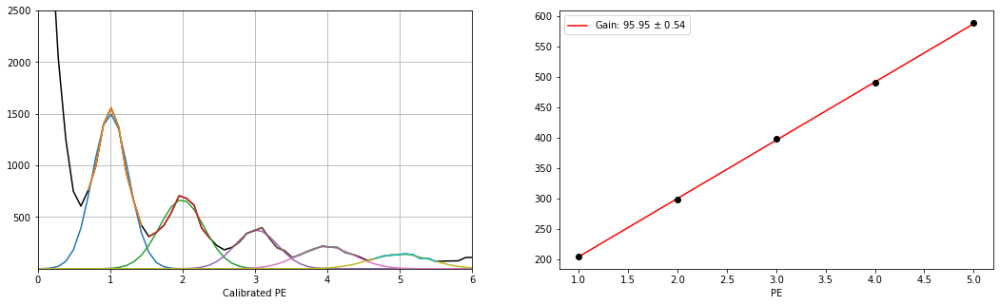

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_28.h5
Guess:  [1570, 205.0375457875458, 10]
Params:  [1551.39358604  203.32214865   22.46778306]
Guess:  [680, 295.0540293040293, 10]
Params:  [666.93610574 297.18345517  27.96450432]
Guess:  [389, 395.0723443223443, 10]
Params:  [368.30320885 394.79923506  28.74186042]
Guess:  [254, 495.09065934065933, 10]
Params:  [239.87579453 492.0296686   30.41316037]
Guess:  [163, 585.1071428571429, 10]
Params:  [148.74409418 584.4526556   33.96009812]
[95.71072273 -1.12030566]


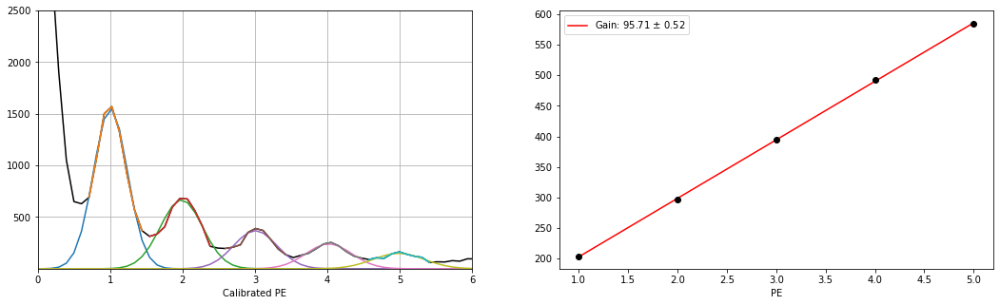

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_27.h5
Guess:  [1466, 205.0375457875458, 10]
Params:  [1437.28128852  203.25080407   22.83865135]
Guess:  [685, 305.0558608058608, 10]
Params:  [664.32991766 299.70234427  25.72265367]
Guess:  [397, 395.0723443223443, 10]
Params:  [372.46299329 395.51188605  28.15196424]
Guess:  [240, 495.09065934065933, 10]
Params:  [214.04342759 493.66474382  29.9761248 ]
Guess:  [162, 595.1089743589744, 10]
Params:  [154.06369603 592.5669022   29.57074154]
[97.25945958 -1.08124143]


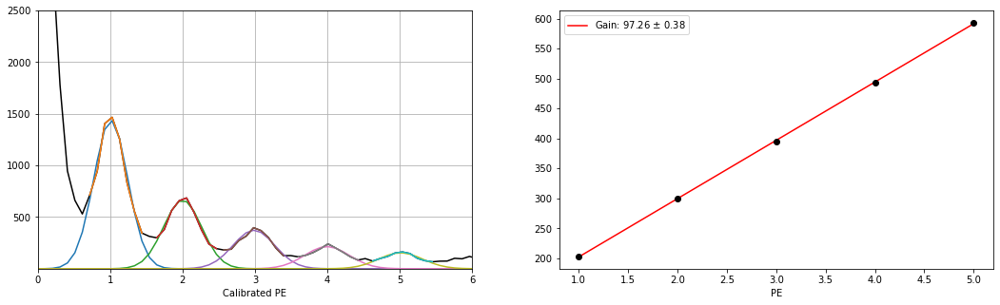

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_26.h5
Guess:  [1412, 205.0375457875458, 10]
Params:  [1392.07333397  203.42238456   26.63696493]
Guess:  [654, 295.0540293040293, 10]
Params:  [626.89823773 299.1474495   32.56710955]
Guess:  [405, 405.0741758241758, 10]
Params:  [372.4028096  398.25695403  29.47680175]
Guess:  [246, 495.09065934065933, 10]
Params:  [222.38124745 494.76533676  32.39337821]
Guess:  [156, 605.1108058608058, 10]
Params:  [138.43436771 593.68895037  39.91581212]
[97.61510193 -1.07576499]


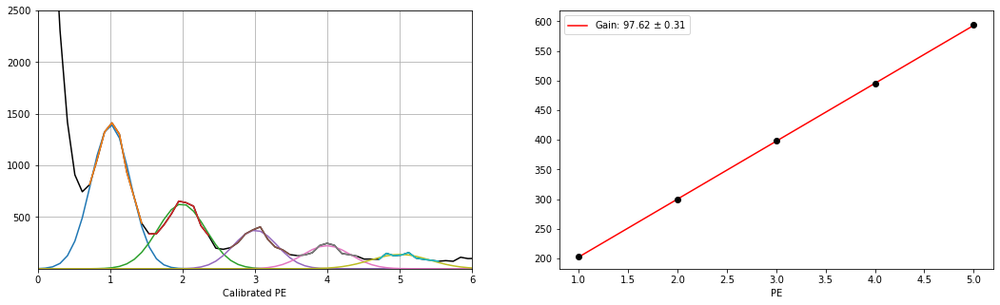

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_25.h5
Guess:  [1511, 205.0375457875458, 10]
Params:  [1458.38253749  204.19329517   24.44300571]
Guess:  [680, 305.0558608058608, 10]
Params:  [671.47231948 300.40459681  28.54886004]
Guess:  [392, 395.0723443223443, 10]
Params:  [361.8566148  396.65259049  32.40447729]
Guess:  [253, 495.09065934065933, 10]
Params:  [241.41674129 493.34804382  27.99135044]
Guess:  [150, 585.1071428571429, 10]
Params:  [137.72247047 589.8586018   41.71896996]
[96.42740602 -1.11596082]


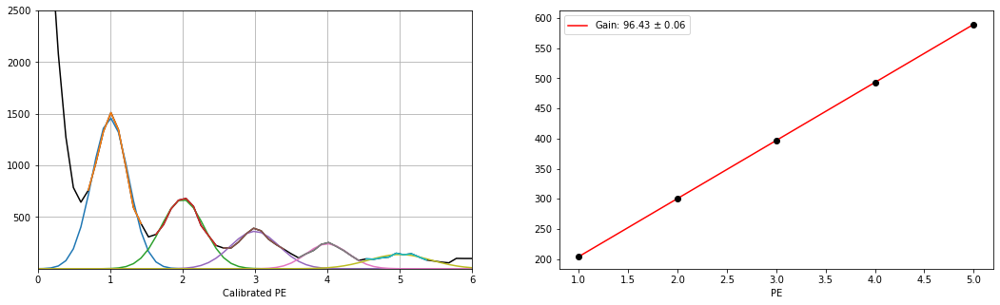

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_24.h5
Guess:  [1512, 205.0375457875458, 10]
Params:  [1515.56321559  203.39745196   23.14418247]
Guess:  [689, 305.0558608058608, 10]
Params:  [687.15574606 299.19630432  26.63231933]
Guess:  [407, 395.0723443223443, 10]
Params:  [398.19471758 394.10057978  27.4472409 ]
Guess:  [236, 485.0888278388278, 10]
Params:  [227.25461412 488.45683416  33.96904875]
Guess:  [153, 585.1071428571429, 10]
Params:  [150.62107307 586.35530698  31.37315407]
[95.51762401 -1.12804757]


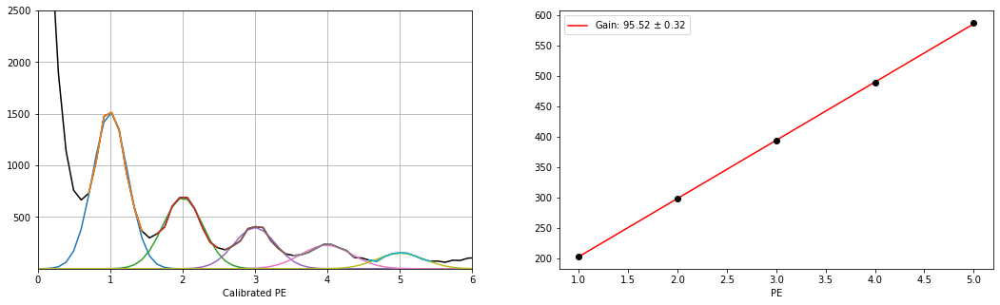

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_23.h5
Guess:  [1487, 205.0375457875458, 10]
Params:  [1487.79082165  202.69977856   23.92913707]
Guess:  [714, 295.0540293040293, 10]
Params:  [685.916944   297.54855153  27.65796905]
Guess:  [438, 395.0723443223443, 10]
Params:  [388.71448596 395.34877002  28.17894752]
Guess:  [253, 495.09065934065933, 10]
Params:  [227.54448015 493.22110561  31.63524921]
Guess:  [154, 595.1089743589744, 10]
Params:  [142.07845252 591.34227302  36.02709374]
[97.2957543  -1.07039442]


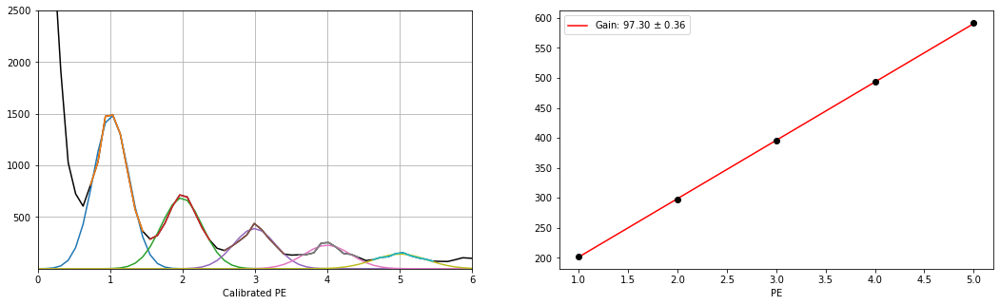

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_22.h5
Guess:  [1527, 205.0375457875458, 10]
Params:  [1469.78443583  204.10517696   23.09835859]
Guess:  [651, 305.0558608058608, 10]
Params:  [650.9803805  300.43471081  27.20008378]
Guess:  [375, 395.0723443223443, 10]
Params:  [358.09239143 394.9968195   29.55124943]
Guess:  [227, 485.0888278388278, 10]
Params:  [219.88146975 492.67244769  35.0921016 ]
Guess:  [170, 595.1089743589744, 10]
Params:  [142.38475379 592.50512775  32.06314364]
[96.90376385 -1.0962584 ]


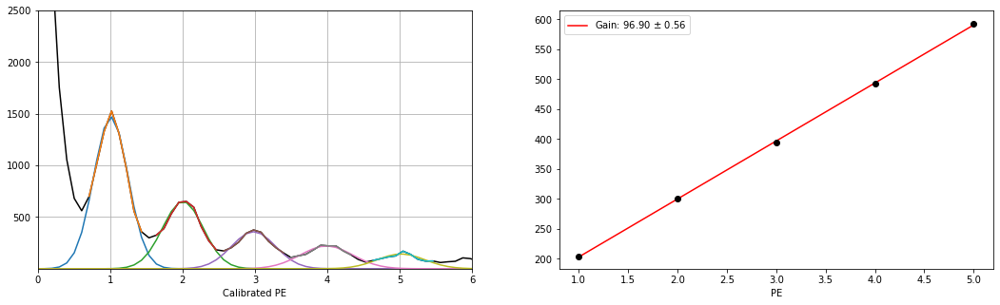

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_21.h5
Guess:  [1495, 205.0375457875458, 10]
Params:  [1416.20841485  203.58301871   24.28873107]
Guess:  [693, 305.0558608058608, 10]
Params:  [666.31973476 299.79957722  26.61946739]
Guess:  [389, 395.0723443223443, 10]
Params:  [372.37373912 395.25608272  29.55040821]
Guess:  [234, 485.0888278388278, 10]
Params:  [221.25469031 490.30663142  35.51275631]
Guess:  [163, 595.1089743589744, 10]
Params:  [146.4000081  592.75750902  32.57930665]
[96.8856035  -1.09080967]


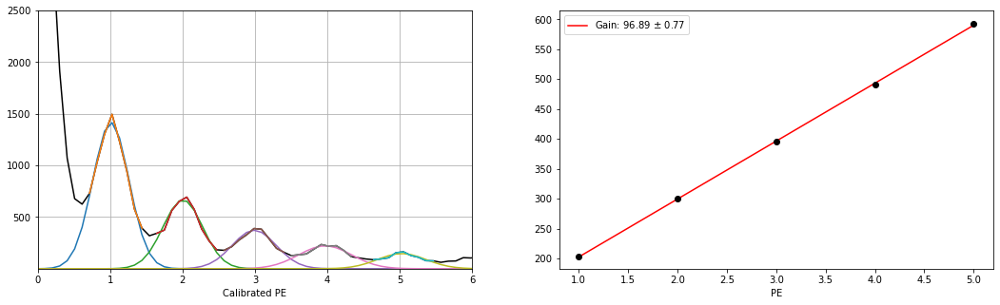

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_20.h5
Guess:  [1463, 205.0375457875458, 10]
Params:  [1445.97498002  203.64073549   25.0719423 ]
Guess:  [671, 305.0558608058608, 10]
Params:  [655.28110364 300.06922495  27.30919131]
Guess:  [352, 395.0723443223443, 10]
Params:  [345.04164562 395.25217521  32.59537145]
Guess:  [268, 495.09065934065933, 10]
Params:  [232.72068194 495.37186572  29.52881985]
Guess:  [147, 595.1089743589744, 10]
Params:  [134.64851361 589.46570085  42.48461643]
[96.69525715 -1.1031996 ]


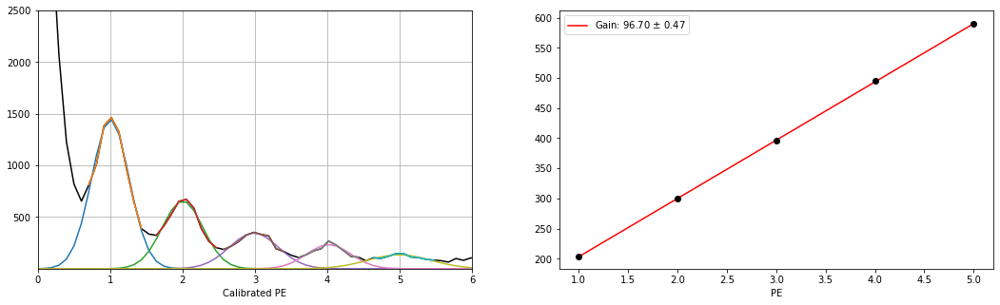

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_19.h5
Guess:  [1513, 205.0375457875458, 10]
Params:  [1427.05059335  204.2179985    24.55642409]
Guess:  [679, 295.0540293040293, 10]
Params:  [637.14461437 297.96888277  30.64856569]
Guess:  [364, 405.0741758241758, 10]
Params:  [353.89057291 396.42492208  30.88236804]
Guess:  [244, 495.09065934065933, 10]
Params:  [223.82298798 491.25870936  32.34855257]
Guess:  [160, 595.1089743589744, 10]
Params:  [152.9069447  589.12519418  33.10697869]
[96.31042178 -1.10961902]


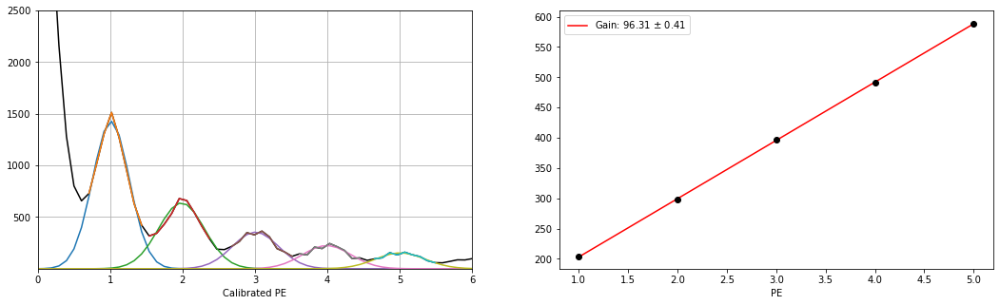

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_18.h5
Guess:  [1419, 205.0375457875458, 10]
Params:  [1386.08677961  204.38889464   25.34743625]
Guess:  [748, 295.0540293040293, 10]
Params:  [668.68839592 298.29001959  28.08534431]
Guess:  [401, 405.0741758241758, 10]
Params:  [352.3254782  398.58451971  31.46854084]
Guess:  [216, 495.09065934065933, 10]
Params:  [211.46370575 490.88168224  32.7286046 ]
Guess:  [150, 585.1071428571429, 10]
Params:  [141.87631875 586.66861659  34.14051046]
[95.71511066 -1.13479903]


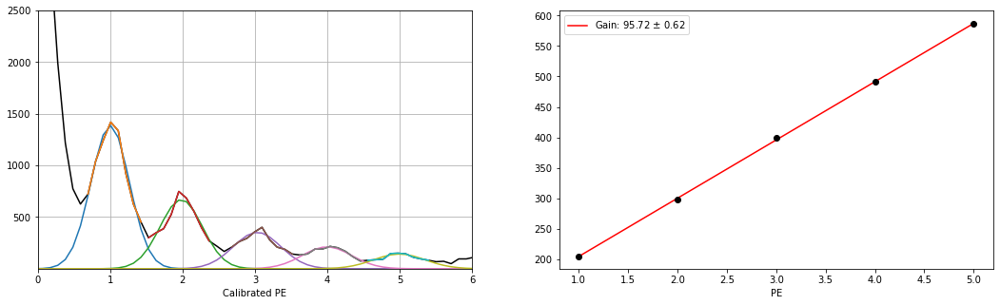

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_17.h5
Guess:  [1630, 205.0375457875458, 10]
Params:  [1491.7330378   203.16494289   23.52020448]
Guess:  [762, 295.0540293040293, 10]
Params:  [707.63662687 298.07010862  26.95501633]
Guess:  [409, 395.0723443223443, 10]
Params:  [387.77264545 396.44364203  29.51143728]
Guess:  [247, 495.09065934065933, 10]
Params:  [228.02696632 492.0910136   29.53681142]
Guess:  [180, 595.1089743589744, 10]
Params:  [157.31452853 588.23220454  31.95961872]
[96.41554284 -1.10307686]


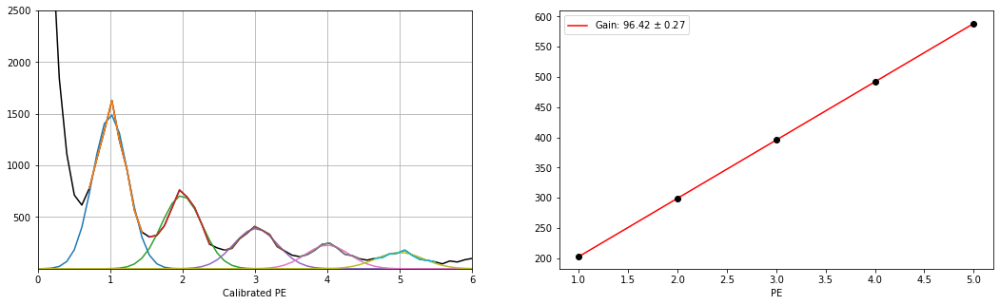

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_16.h5
Guess:  [1516, 205.0375457875458, 10]
Params:  [1494.77459242  203.79275023   24.10132667]
Guess:  [694, 295.0540293040293, 10]
Params:  [660.61268663 298.57644781  29.92589165]
Guess:  [380, 395.0723443223443, 10]
Params:  [354.33379144 394.69537376  31.54616282]
Guess:  [241, 495.09065934065933, 10]
Params:  [230.99896427 495.19397661  31.47560989]
Guess:  [154, 595.1089743589744, 10]
Params:  [149.66858123 587.40939169  33.36653904]
[96.38508114 -1.10783062]


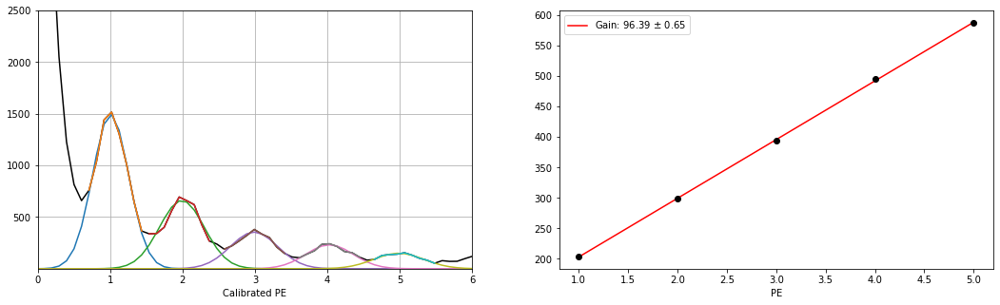

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_15.h5
Guess:  [1516, 205.0375457875458, 10]
Params:  [1496.44549612  203.45476371   23.86931654]
Guess:  [715, 295.0540293040293, 10]
Params:  [692.52578609 298.37426949  26.64811215]
Guess:  [390, 395.0723443223443, 10]
Params:  [370.51991829 395.70145332  30.45833097]
Guess:  [230, 495.09065934065933, 10]
Params:  [222.44660355 491.71199776  33.06933121]
Guess:  [146, 595.1089743589744, 10]
Params:  [142.34253614 590.00690101  34.29763456]
[96.64420027 -1.09595067]


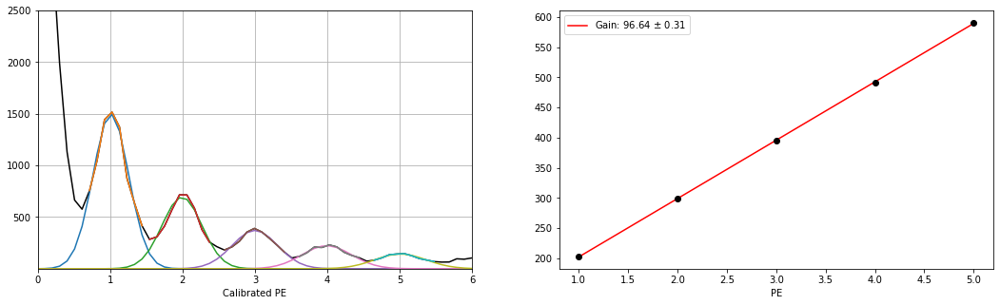

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_14.h5
Guess:  [1611, 205.0375457875458, 10]
Params:  [1545.25974065  203.11145844   22.99638666]
Guess:  [700, 305.0558608058608, 10]
Params:  [677.76612665 299.00274316  26.40185705]
Guess:  [405, 395.0723443223443, 10]
Params:  [376.22515697 394.36752873  28.94699291]
Guess:  [272, 495.09065934065933, 10]
Params:  [237.41170409 494.42687982  30.86163062]
Guess:  [169, 595.1089743589744, 10]
Params:  [154.83169766 590.59050147  30.68505051]
[97.0382223  -1.08395592]


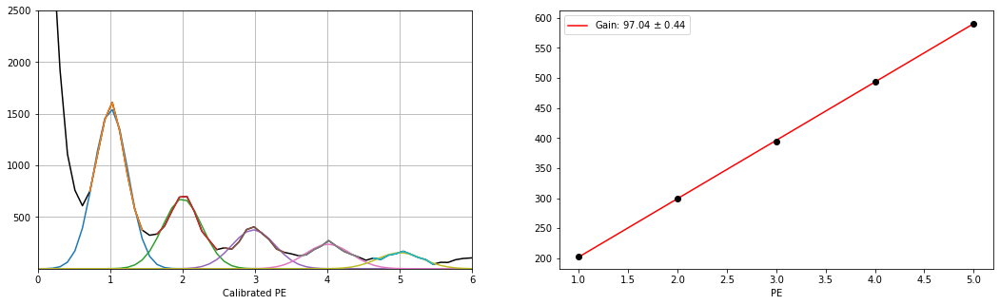

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_13.h5
Guess:  [1542, 205.0375457875458, 10]
Params:  [1499.17293725  203.36765493   23.27869732]
Guess:  [677, 295.0540293040293, 10]
Params:  [658.61833457 298.45828927  27.68978422]
Guess:  [368, 395.0723443223443, 10]
Params:  [356.55196861 394.5070366   30.18719261]
Guess:  [229, 495.09065934065933, 10]
Params:  [228.26035087 492.32343283  31.14991511]
Guess:  [160, 605.1108058608058, 10]
Params:  [147.46839422 591.00036497  35.89161853]
[96.91305637 -1.08542843]


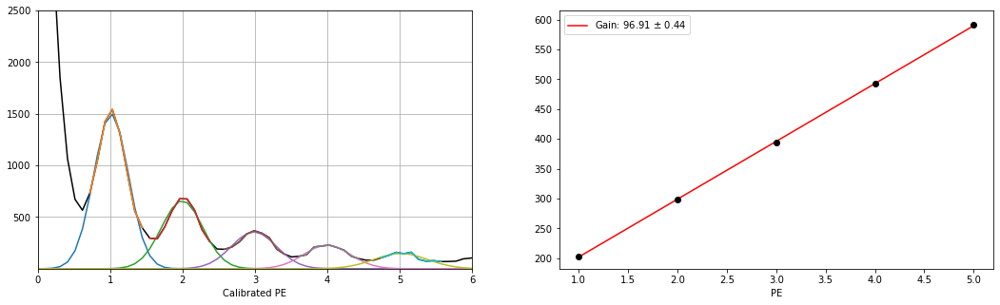

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_12.h5
Guess:  [1579, 205.0375457875458, 10]
Params:  [1535.29736568  203.90904319   23.21852328]
Guess:  [760, 295.0540293040293, 10]
Params:  [691.14709485 297.79877851  27.51780361]
Guess:  [413, 405.0741758241758, 10]
Params:  [376.58171533 396.17812444  30.08268151]
Guess:  [276, 495.09065934065933, 10]
Params:  [243.90316556 492.91720982  30.61955179]
Guess:  [172, 595.1089743589744, 10]
Params:  [155.05681088 589.97314217  30.65049679]
[96.72466293 -1.0957006 ]


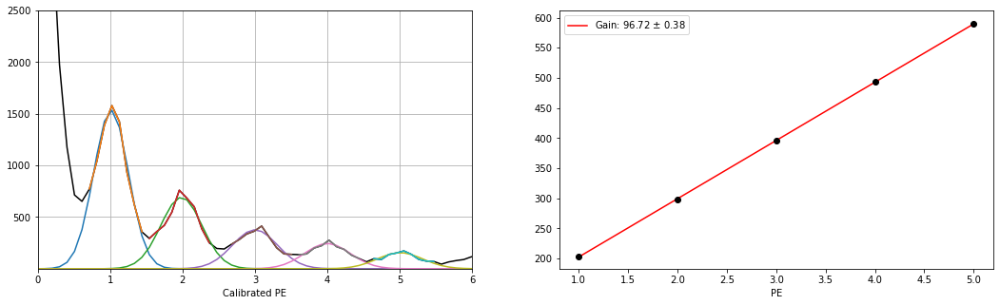

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_11.h5
Guess:  [1557, 205.0375457875458, 10]
Params:  [1494.56059873  203.68386349   23.27523545]
Guess:  [707, 305.0558608058608, 10]
Params:  [699.09688803 300.25329671  26.68591281]
Guess:  [397, 395.0723443223443, 10]
Params:  [369.09861083 395.31107799  29.74027175]
Guess:  [255, 495.09065934065933, 10]
Params:  [242.12347568 495.08875439  29.64677874]
Guess:  [157, 595.1089743589744, 10]
Params:  [148.06817021 589.26131406  37.49320575]
[96.59903587 -1.10686978]


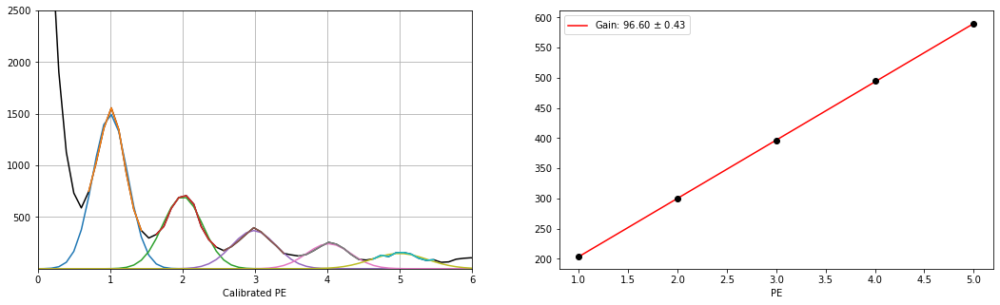

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_10.h5
Guess:  [1599, 205.0375457875458, 10]
Params:  [1570.92093449  203.3407446    22.20057356]
Guess:  [697, 295.0540293040293, 10]
Params:  [672.51862838 297.63027234  27.1586286 ]
Guess:  [417, 395.0723443223443, 10]
Params:  [388.26708611 394.63157793  28.90232322]
Guess:  [234, 505.09249084249086, 10]
Params:  [227.73528233 495.59714803  31.37123377]
Guess:  [149, 595.1089743589744, 10]
Params:  [136.32003959 594.06416976  34.16429894]
[97.9413726  -1.05398426]


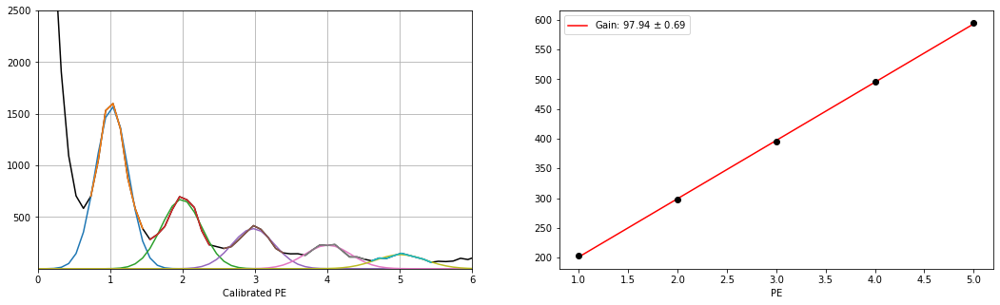

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_9.h5
Guess:  [1519, 205.0375457875458, 10]
Params:  [1476.22668856  203.23628586   23.30338414]
Guess:  [701, 305.0558608058608, 10]
Params:  [688.48342012 300.80643528  26.21518184]
Guess:  [390, 385.0705128205128, 10]
Params:  [358.76960249 390.88150728  35.70872525]
Guess:  [202, 495.09065934065933, 10]
Params:  [197.17170807 493.58071329  35.43196589]
Guess:  [162, 585.1071428571429, 10]
Params:  [142.45414839 586.9887613   38.6544493 ]
[96.02792289 -1.11441515]


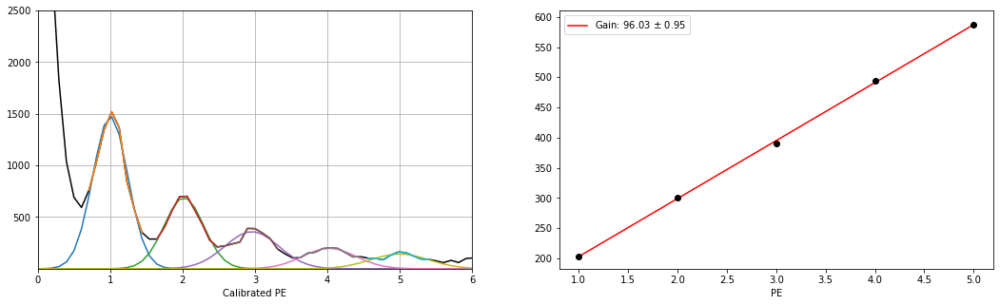

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_8.h5
Guess:  [1543, 205.0375457875458, 10]
Params:  [1511.3061854   203.79227523   23.42684524]
Guess:  [719, 305.0558608058608, 10]
Params:  [700.02330467 300.20254865  25.75426787]
Guess:  [415, 395.0723443223443, 10]
Params:  [392.69894816 395.22038988  28.47378753]
Guess:  [229, 505.09249084249086, 10]
Params:  [210.87224051 494.02014883  32.2357353 ]
Guess:  [155, 595.1089743589744, 10]
Params:  [143.3303901  588.13023118  36.20459892]
[96.2493512  -1.11715106]


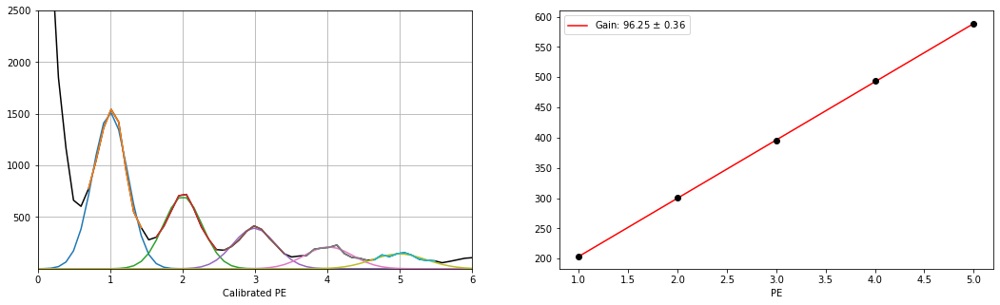

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_7.h5
Guess:  [1549, 205.0375457875458, 10]
Params:  [1487.39407014  204.30816162   23.60660838]
Guess:  [717, 295.0540293040293, 10]
Params:  [657.34856824 299.27420224  28.97863069]
Guess:  [402, 395.0723443223443, 10]
Params:  [380.30219839 395.30719623  30.11026072]
Guess:  [253, 495.09065934065933, 10]
Params:  [226.5137983  492.60045398  31.51946567]
Guess:  [164, 595.1089743589744, 10]
Params:  [164.66770233 590.34456387  29.26884852]
[96.53990564 -1.10573133]


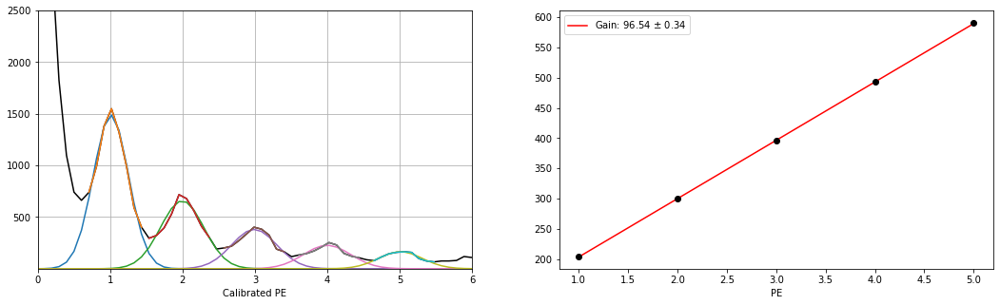

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_6.h5
Guess:  [1578, 205.0375457875458, 10]
Params:  [1524.21665845  203.12538401   23.29410787]
Guess:  [716, 305.0558608058608, 10]
Params:  [686.25626035 300.33339928  26.63365191]
Guess:  [388, 395.0723443223443, 10]
Params:  [359.85683292 396.66057959  30.40504414]
Guess:  [251, 495.09065934065933, 10]
Params:  [235.8130507  493.28525886  30.60101292]
Guess:  [163, 595.1089743589744, 10]
Params:  [149.05924268 591.7761905   31.25032392]
[97.02534725 -1.092087  ]


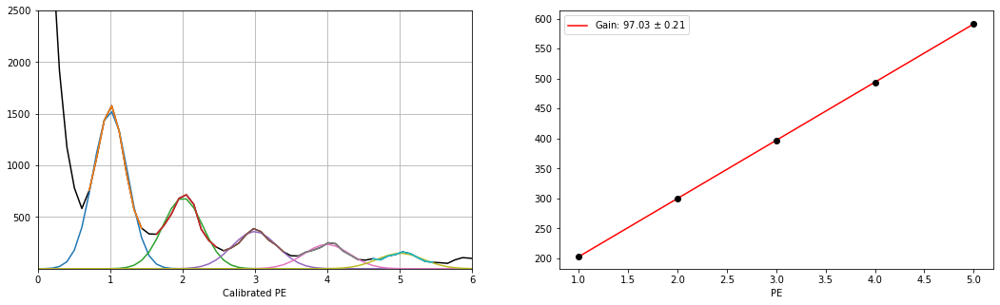

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_5.h5
Guess:  [1587, 205.0375457875458, 10]
Params:  [1529.6215049   203.98086303   22.81926234]
Guess:  [759, 295.0540293040293, 10]
Params:  [702.31950349 297.95669467  26.61084286]
Guess:  [390, 405.0741758241758, 10]
Params:  [375.18179237 395.64987415  28.16773639]
Guess:  [262, 495.09065934065933, 10]
Params:  [233.64844682 493.36614577  30.81664315]
Guess:  [161, 595.1089743589744, 10]
Params:  [154.12995874 589.02641142  29.16140009]
[96.5500548  -1.10145803]


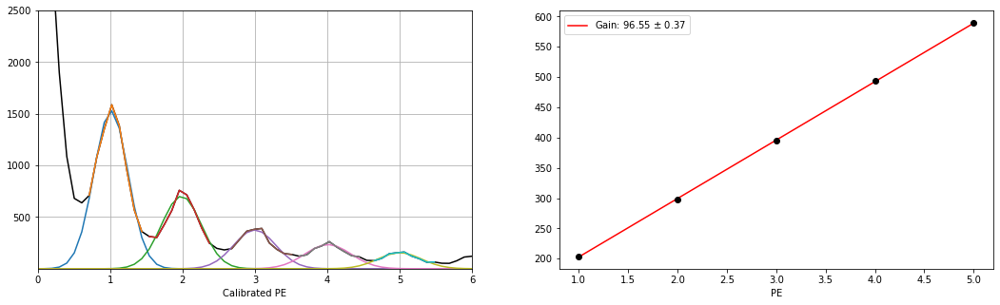

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_4.h5
Guess:  [1448, 205.0375457875458, 10]
Params:  [1433.4609211   204.10278586   22.45215605]
Guess:  [679, 305.0558608058608, 10]
Params:  [644.83221756 299.62624503  26.10254018]
Guess:  [363, 405.0741758241758, 10]
Params:  [343.67472494 397.01623722  28.71895853]
Guess:  [214, 495.09065934065933, 10]
Params:  [207.0079016  494.067677    31.72193035]
Guess:  [154, 585.1071428571429, 10]
Params:  [139.21041277 588.83798878  37.6274641 ]
[96.3911838  -1.11583478]


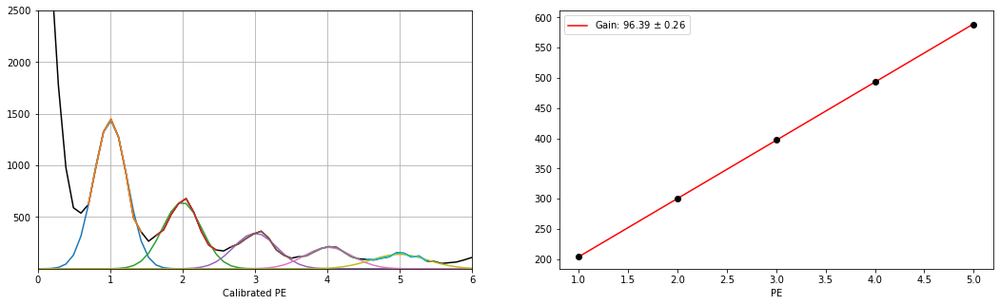

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_3.h5
Guess:  [1525, 205.0375457875458, 10]
Params:  [1455.53715101  203.80304723   24.30050713]
Guess:  [695, 295.0540293040293, 10]
Params:  [660.35868737 299.64185027  28.8520859 ]
Guess:  [384, 395.0723443223443, 10]
Params:  [377.74077744 395.54572949  29.01252615]
Guess:  [254, 485.0888278388278, 10]
Params:  [234.37165277 488.80281179  33.59702663]
Guess:  [158, 585.1071428571429, 10]
Params:  [142.61055841 589.37284012  39.75630321]
[96.03005476 -1.11780725]


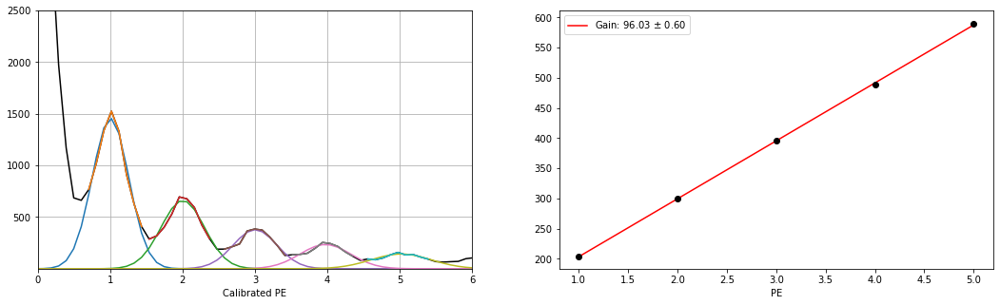

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_2.h5
Guess:  [1434, 205.0375457875458, 10]
Params:  [1385.13769742  204.25925272   25.47858205]
Guess:  [715, 305.0558608058608, 10]
Params:  [669.68581655 300.43742996  27.97316557]
Guess:  [359, 405.0741758241758, 10]
Params:  [355.16524254 397.7557636   31.3181558 ]
Guess:  [244, 495.09065934065933, 10]
Params:  [220.8177972  493.98428541  34.6735055 ]
Guess:  [159, 585.1071428571429, 10]
Params:  [146.27922803 588.4611948   36.00615558]
[96.19507396 -1.12681823]


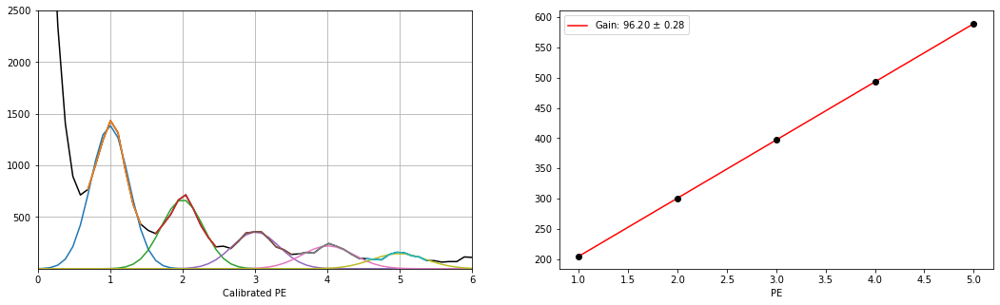

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_1.h5
Guess:  [1326, 205.0375457875458, 10]
Params:  [1352.16499298  204.32511863   27.58686432]
Guess:  [671, 305.0558608058608, 10]
Params:  [634.30828972 299.65859686  30.58372714]
Guess:  [375, 405.0741758241758, 10]
Params:  [354.39891825 399.0988074   31.56593453]
Guess:  [243, 495.09065934065933, 10]
Params:  [228.61721982 493.47875557  35.73978479]
Guess:  [146, 605.1108058608058, 10]
Params:  [130.63163697 594.85669137  42.09567461]
[97.4883305  -1.08544891]


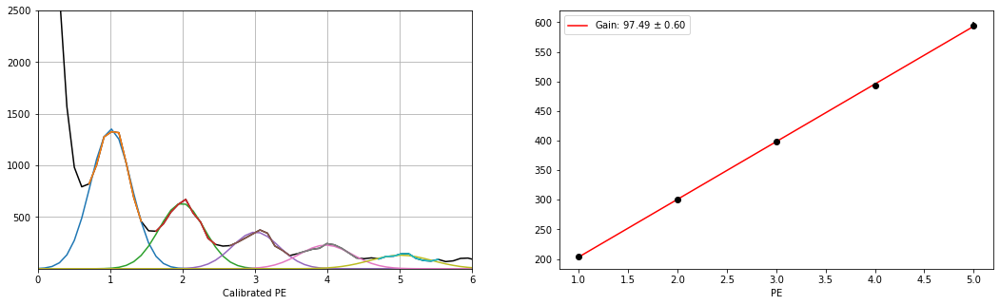

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_source_0.h5
Guess:  [1340, 205.0375457875458, 10]
Params:  [1307.30178709  204.0408482    27.94029339]
Guess:  [673, 305.0558608058608, 10]
Params:  [646.68556092 299.97108294  29.30121095]
Guess:  [359, 395.0723443223443, 10]
Params:  [351.10256467 395.1876152   31.34854722]
Guess:  [218, 485.0888278388278, 10]
Params:  [202.88821797 490.79391978  38.73786191]
Guess:  [141, 585.1071428571429, 10]
Params:  [127.49489801 585.16967292  45.6737198 ]
[95.30804864 -1.14479819]


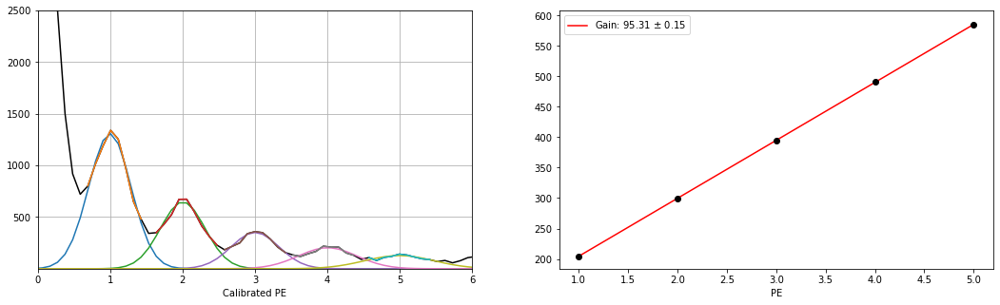

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_34.h5
Guess:  [401, 205.0375457875458, 10]
Params:  [410.13683229 202.55635922  25.64375071]
Guess:  [320, 295.0540293040293, 10]
Params:  [278.14551066 296.62649839  31.55743717]
Guess:  [220, 385.0705128205128, 10]
Params:  [216.97635914 384.0662661   33.69618242]
[90.75495354 -1.24408049]


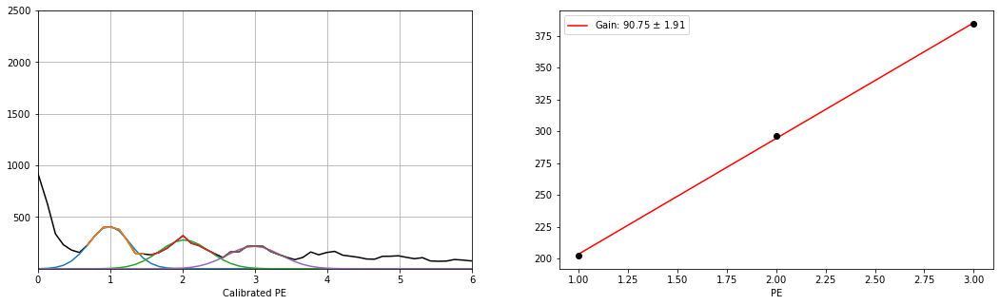

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_33.h5
Guess:  [431, 205.0375457875458, 10]
Params:  [400.98766391 202.46048173  25.38876393]
Guess:  [302, 295.0540293040293, 10]
Params:  [286.79845886 293.7482612   30.05246208]
Guess:  [206, 395.0723443223443, 10]
Params:  [189.12223441 382.56712856  42.46529313]
[90.05332343 -1.25279822]


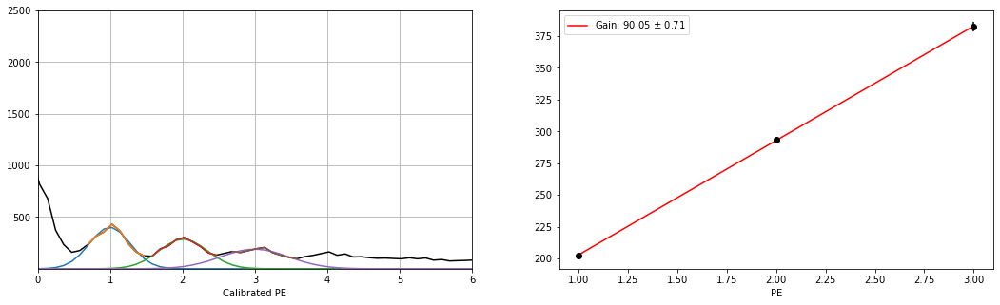

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_32.h5
Guess:  [394, 195.03571428571428, 10]
Params:  [376.44805074 199.8808969   26.29914878]
Guess:  [279, 295.0540293040293, 10]
Params:  [263.02029216 293.21280066  30.43133083]
Guess:  [200, 385.0705128205128, 10]
Params:  [195.69832148 383.19072223  38.88168386]
[91.65491265 -1.18689744]


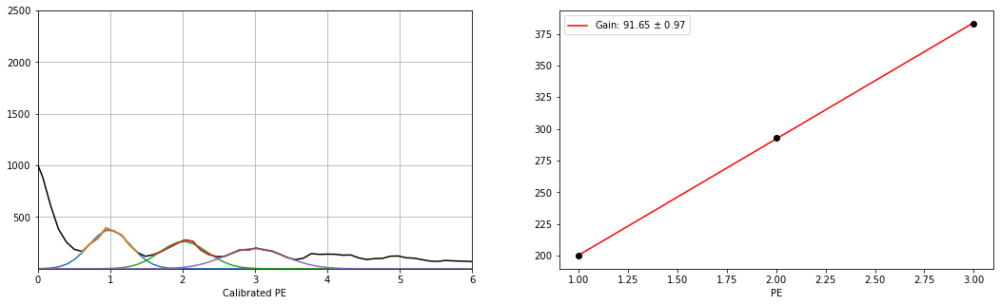

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_31.h5
Guess:  [393, 205.0375457875458, 10]
Params:  [396.58639654 203.29109055  25.44584944]
Guess:  [301, 295.0540293040293, 10]
Params:  [278.21425282 295.12608756  29.04825339]
Guess:  [199, 385.0705128205128, 10]
Params:  [197.4983294  383.47127312  38.55502698]
[90.09009127 -1.26298723]


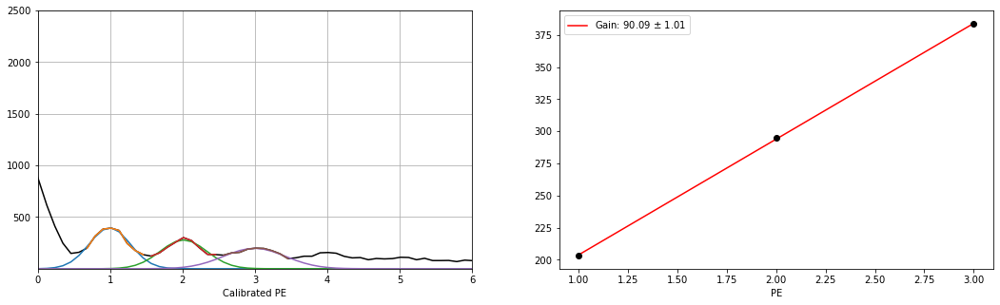

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_30.h5
Guess:  [423, 205.0375457875458, 10]
Params:  [399.65158688 202.95783834  24.75587003]
Guess:  [292, 295.0540293040293, 10]
Params:  [266.54145439 295.45866097  29.04239339]
Guess:  [199, 375.06868131868134, 10]
Params:  [187.10463033 382.37047817  44.79519825]
[89.70631989 -1.27285368]


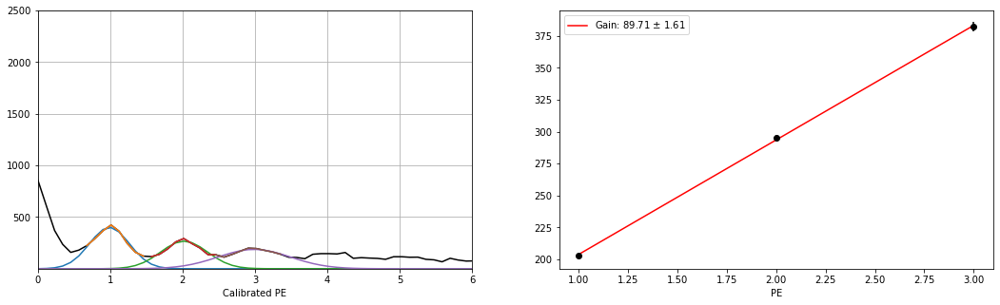

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_29.h5
Guess:  [418, 205.0375457875458, 10]
Params:  [384.9524158  202.36742695  24.85949651]
Guess:  [260, 295.0540293040293, 10]
Params:  [249.95593474 295.03073207  31.72282716]
Guess:  [207, 395.0723443223443, 10]
Params:  [199.80559315 387.17181545  37.19144571]
[92.40219426 -1.1910136 ]


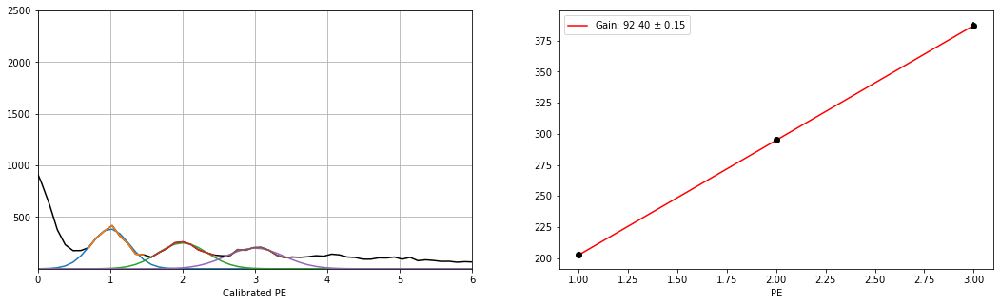

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_28.h5
Guess:  [428, 205.0375457875458, 10]
Params:  [400.75227825 201.9450187   25.48708135]
Guess:  [287, 295.0540293040293, 10]
Params:  [262.70267765 291.6207992   32.58374033]
Guess:  [229, 385.0705128205128, 10]
Params:  [210.94165926 384.87768503  36.37128333]
[91.46633319 -1.20133639]


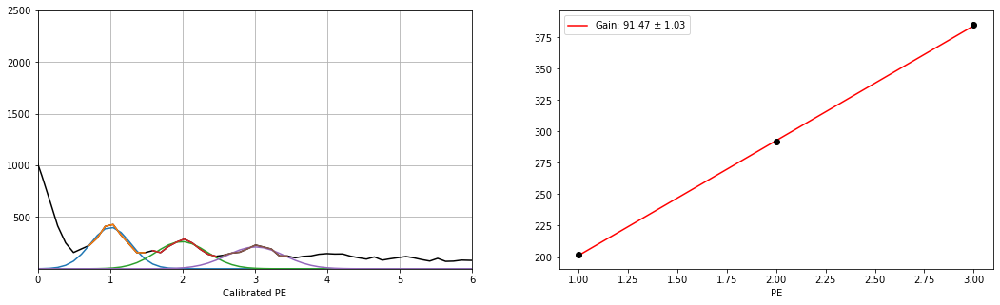

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_27.h5
Guess:  [415, 205.0375457875458, 10]
Params:  [385.50465795 201.62488305  24.54174077]
Guess:  [293, 295.0540293040293, 10]
Params:  [268.70518075 293.99435286  29.16428662]
Guess:  [213, 385.0705128205128, 10]
Params:  [195.97031541 383.90263905  35.01361449]
[91.13887802 -1.21678261]


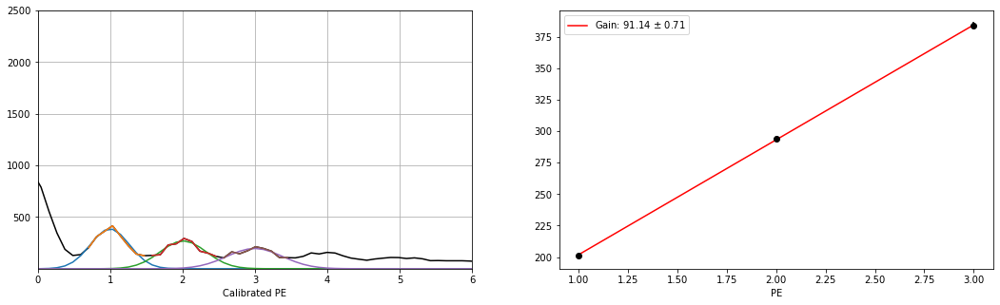

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_26.h5
Guess:  [398, 205.0375457875458, 10]
Params:  [373.0954297  202.40940185  26.12548793]
Guess:  [271, 295.0540293040293, 10]
Params:  [250.46096908 293.24345686  33.0323066 ]
Guess:  [195, 385.0705128205128, 10]
Params:  [176.20444803 388.81264665  51.11230321]
[93.20162239 -1.16326935]


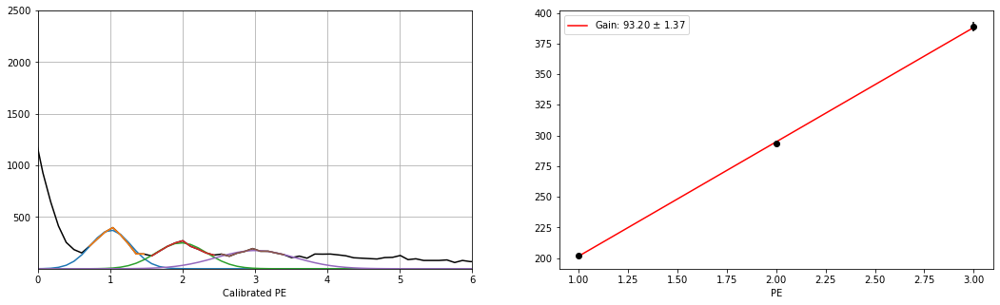

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_25.h5
Guess:  [386, 205.0375457875458, 10]
Params:  [364.93164364 203.87775146  26.98687916]
Guess:  [277, 295.0540293040293, 10]
Params:  [255.30549391 294.10154657  31.80321784]
Guess:  [190, 375.06868131868134, 10]
Params:  [184.90331632 382.51684274  44.69664763]
[89.31954564 -1.28594051]


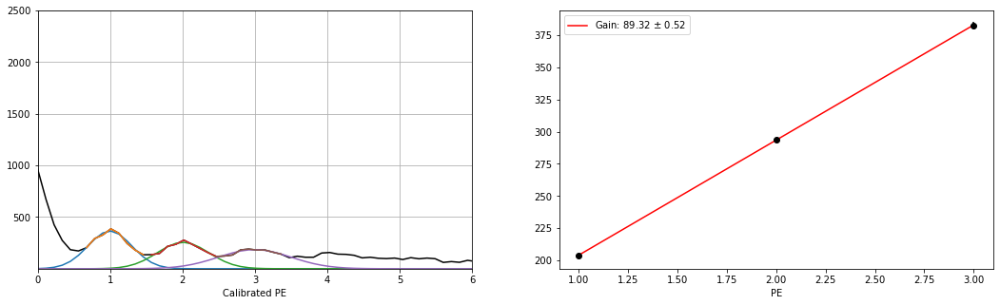

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_24.h5
Guess:  [405, 205.0375457875458, 10]
Params:  [396.7514592  202.45908568  25.36436558]
Guess:  [262, 295.0540293040293, 10]
Params:  [253.10250089 294.73653832  31.76574495]
Guess:  [211, 375.06868131868134, 10]
Params:  [206.42002708 380.99611993  39.05193226]
[89.26851706 -1.27921412]


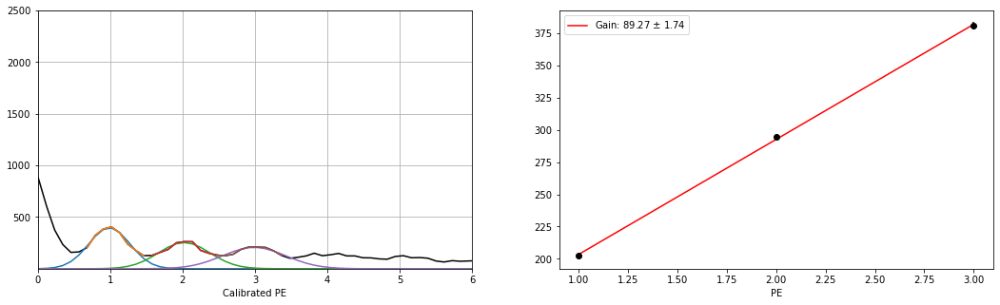

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_23.h5
Guess:  [458, 195.03571428571428, 10]
Params:  [443.20683578 200.35607994  23.53074855]
Guess:  [304, 295.0540293040293, 10]
Params:  [281.50152404 291.89416259  30.26277617]
Guess:  [226, 375.06868131868134, 10]
Params:  [207.6491279  381.78086247  38.25294786]
[90.71239126 -1.21172993]


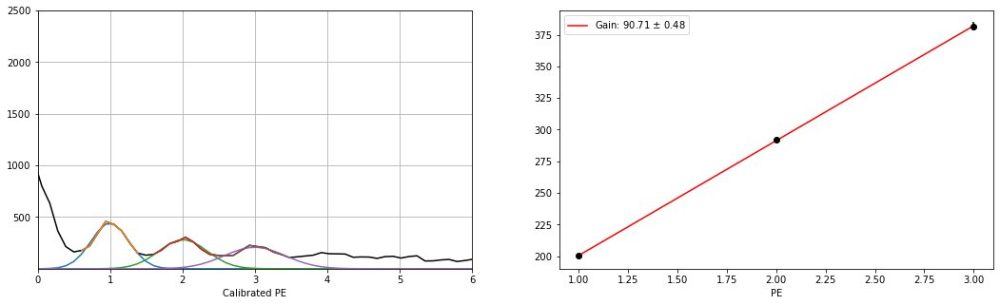

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_22.h5
Guess:  [395, 205.0375457875458, 10]
Params:  [388.01122786 201.4201136   24.42346689]
Guess:  [286, 295.0540293040293, 10]
Params:  [267.83027864 294.12092356  28.72228385]
Guess:  [213, 385.0705128205128, 10]
Params:  [206.28479309 382.0578581   34.74367719]
[90.31887233 -1.2388908 ]


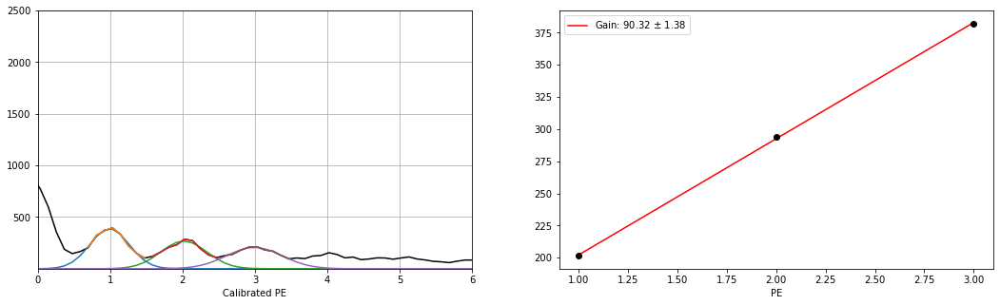

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_21.h5
Guess:  [398, 195.03571428571428, 10]
Params:  [400.536802   199.97505553  25.32540629]
Guess:  [261, 285.05219780219784, 10]
Params:  [249.64878811 291.30832196  33.37608824]
Guess:  [192, 375.06868131868134, 10]
Params:  [188.06386642 380.60663573  36.57515624]
[90.31579012 -1.21793126]


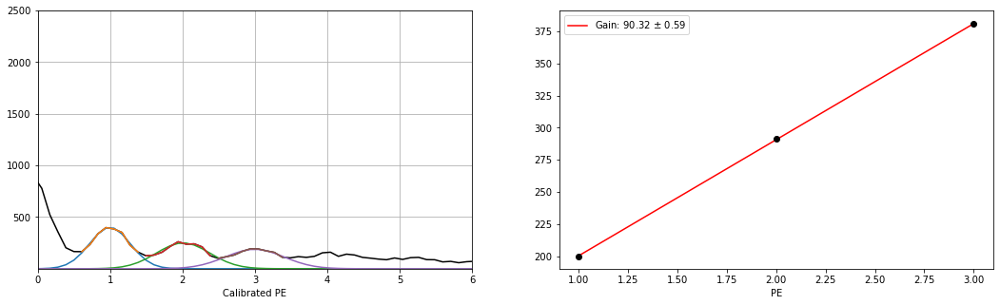

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_20.h5
Guess:  [384, 205.0375457875458, 10]
Params:  [370.60427659 202.32849375  28.18012808]
Guess:  [287, 305.0558608058608, 10]
Params:  [281.9332669  295.14683804  30.65063207]
Guess:  [220, 385.0705128205128, 10]
Params:  [207.62708943 388.25960123  36.67258481]
[92.96555374 -1.17585348]


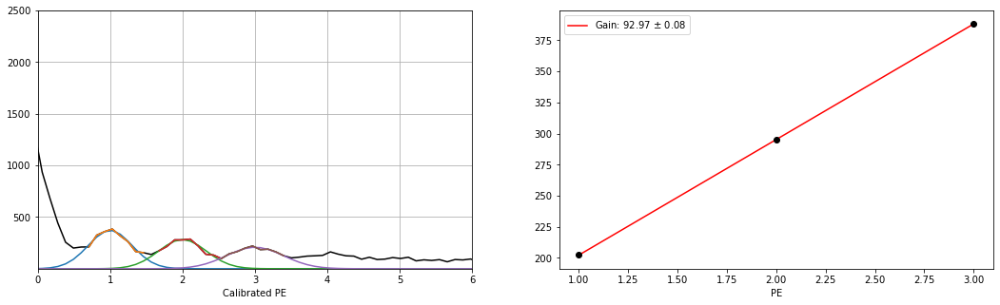

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_19.h5
Guess:  [404, 205.0375457875458, 10]
Params:  [394.8379209  202.80541108  26.34445635]
Guess:  [268, 285.05219780219784, 10]
Params:  [246.81381043 290.32712519  36.46218143]
Guess:  [204, 385.0705128205128, 10]
Params:  [189.90035629 383.79502343  39.26311991]
[90.49480616 -1.23012114]


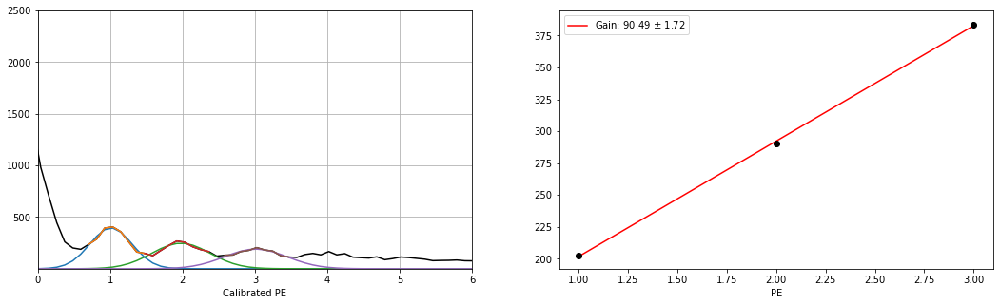

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_18.h5
Guess:  [415, 195.03571428571428, 10]
Params:  [414.68192596 201.19317272  25.78487003]
Guess:  [295, 295.0540293040293, 10]
Params:  [281.32488648 294.2791272   32.85115209]
Guess:  [228, 385.0705128205128, 10]
Params:  [206.88876908 384.01390428  37.60489269]
[91.41036579 -1.20709873]


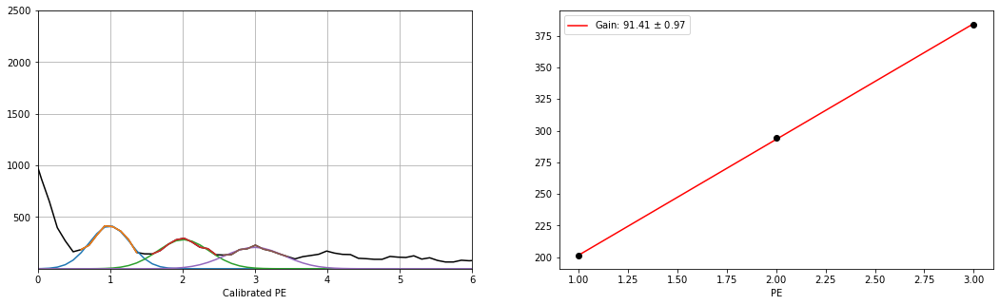

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_17.h5
Guess:  [442, 195.03571428571428, 10]
Params:  [427.46097666 200.21367051  23.47438373]
Guess:  [290, 295.0540293040293, 10]
Params:  [274.98290467 292.49430461  31.76260819]
Guess:  [220, 385.0705128205128, 10]
Params:  [208.53552237 385.15891094  35.89099272]
[92.47262021 -1.16442094]


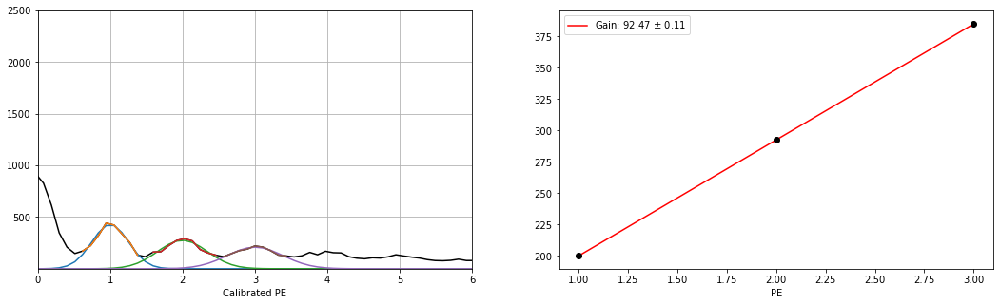

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_16.h5
Guess:  [448, 205.0375457875458, 10]
Params:  [412.78264832 201.19551448  24.77901241]
Guess:  [291, 295.0540293040293, 10]
Params:  [274.74742632 292.91102622  32.45467633]
Guess:  [221, 385.0705128205128, 10]
Params:  [204.83450879 385.45979388  34.51113748]
[92.1321397  -1.18226386]


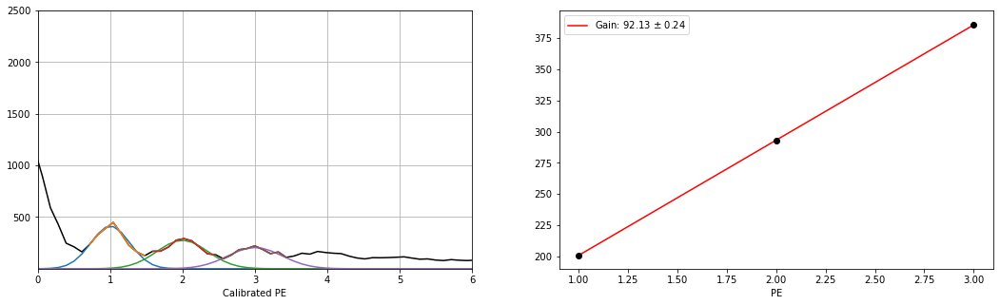

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_15.h5
Guess:  [402, 205.0375457875458, 10]
Params:  [407.33468749 201.60725456  23.65861912]
Guess:  [272, 285.05219780219784, 10]
Params:  [251.74163379 289.59912399  32.35011679]
Guess:  [210, 375.06868131868134, 10]
Params:  [200.09033479 382.33065543  41.12950419]
[90.36170042 -1.22237198]


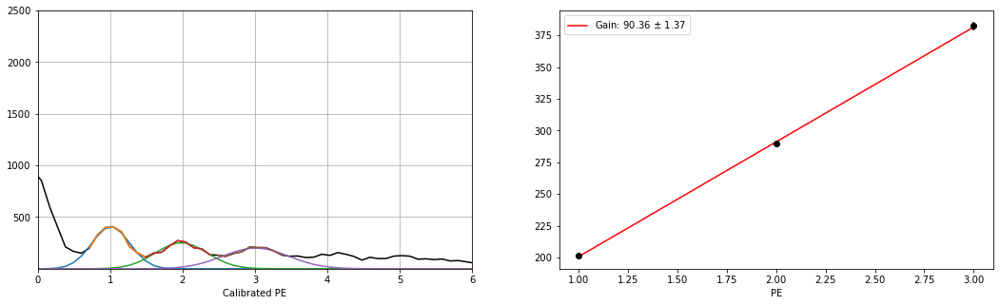

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_14.h5
Guess:  [411, 205.0375457875458, 10]
Params:  [404.72424058 200.26409331  25.90297158]
Guess:  [298, 295.0540293040293, 10]
Params:  [286.99020301 294.26535637  28.89290322]
Guess:  [205, 385.0705128205128, 10]
Params:  [204.5792134  383.95200198  35.91099671]
[91.84395435 -1.18831166]


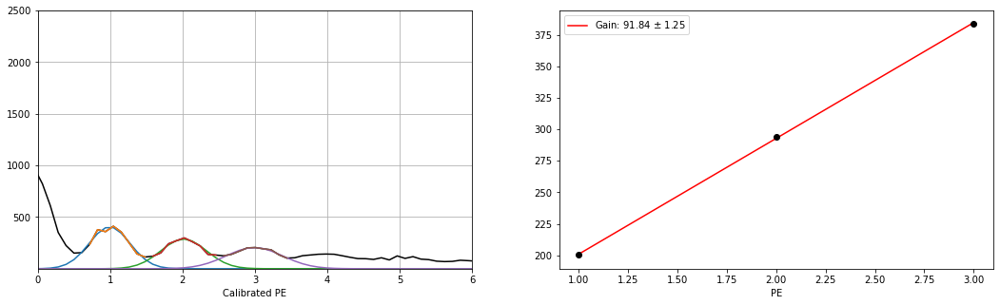

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_13.h5
Guess:  [399, 195.03571428571428, 10]
Params:  [400.33105195 201.03776562  24.01496012]
Guess:  [289, 295.0540293040293, 10]
Params:  [278.10517331 293.21853806  29.58136437]
Guess:  [204, 395.0723443223443, 10]
Params:  [194.75141341 388.8494504   41.34655902]
[93.90584246 -1.13472066]


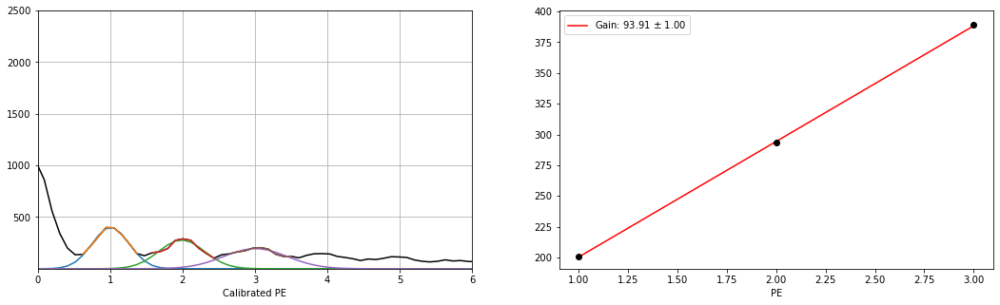

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_12.h5
Guess:  [434, 205.0375457875458, 10]
Params:  [428.51080489 201.9272399   23.57449639]
Guess:  [305, 295.0540293040293, 10]
Params:  [278.8820188  294.20683033  29.1307739 ]
Guess:  [239, 385.0705128205128, 10]
Params:  [211.5871915  385.97649858  35.04854195]
[92.02462935 -1.1951974 ]


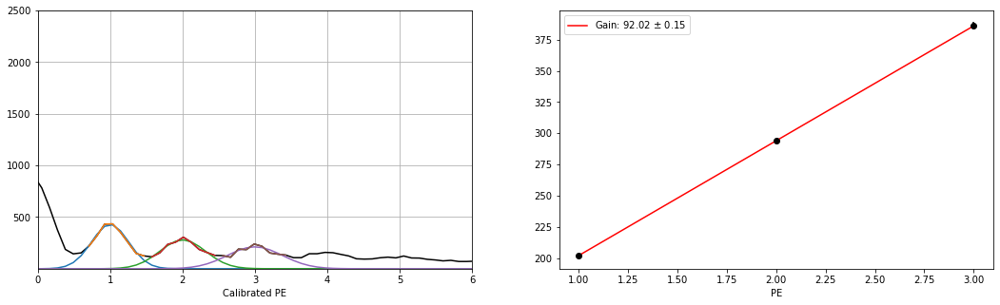

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_11.h5
Guess:  [431, 205.0375457875458, 10]
Params:  [420.00941381 202.63809017  24.49021564]
Guess:  [310, 295.0540293040293, 10]
Params:  [263.17876632 292.76445449  31.03094713]
Guess:  [213, 395.0723443223443, 10]
Params:  [201.31290453 386.41852983  37.61519598]
[91.89021988 -1.19882092]


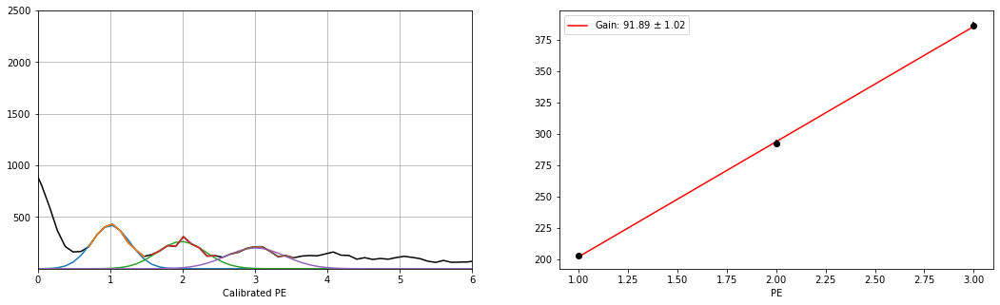

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_10.h5
Guess:  [433, 205.0375457875458, 10]
Params:  [414.09263559 201.44541079  25.06528048]
Guess:  [265, 295.0540293040293, 10]
Params:  [252.24999647 293.45217667  33.36837707]
Guess:  [194, 385.0705128205128, 10]
Params:  [183.41837617 382.84103418  39.34610778]
[90.69781175 -1.2258721 ]


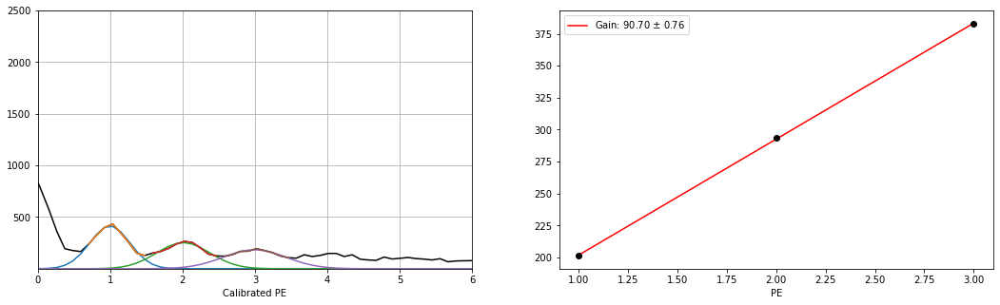

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_9.h5
Guess:  [445, 205.0375457875458, 10]
Params:  [423.02304084 201.49948921  23.61332266]
Guess:  [299, 295.0540293040293, 10]
Params:  [276.4368984  291.91372874  29.84624081]
Guess:  [215, 385.0705128205128, 10]
Params:  [206.08463367 382.70238731  35.96999685]
[90.60144903 -1.22333184]


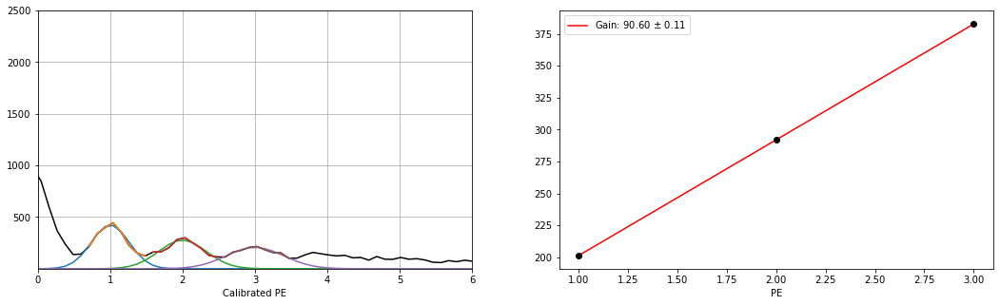

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_8.h5
Guess:  [437, 205.0375457875458, 10]
Params:  [419.98641154 202.68225364  23.773593  ]
Guess:  [286, 305.0558608058608, 10]
Params:  [257.81651061 295.78727669  33.6430194 ]
Guess:  [208, 395.0723443223443, 10]
Params:  [190.41545803 388.72275475  38.87425613]
[93.02025056 -1.1792084 ]


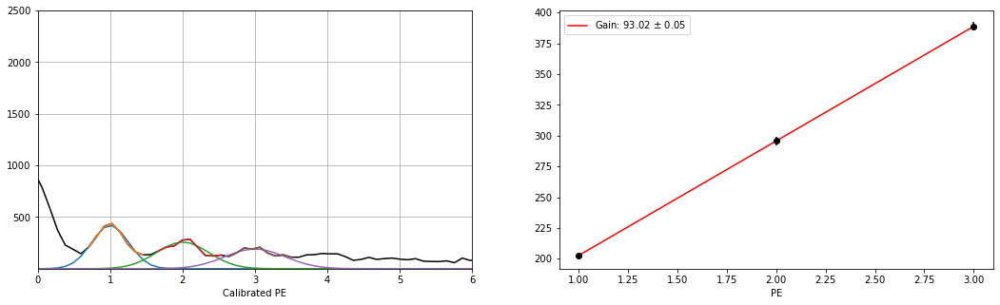

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_7.h5
Guess:  [405, 205.0375457875458, 10]
Params:  [392.55315319 202.10472241  25.48047704]
Guess:  [291, 295.0540293040293, 10]
Params:  [275.3076796  294.81173911  29.20091597]
Guess:  [211, 375.06868131868134, 10]
Params:  [195.90293185 383.81187968  37.64519357]
[90.85357863 -1.2313104 ]


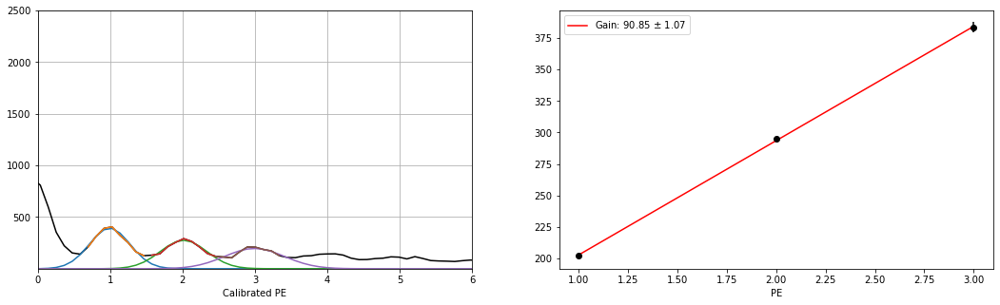

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_6.h5
Guess:  [379, 205.0375457875458, 10]
Params:  [379.83603187 202.54591865  25.89086268]
Guess:  [262, 295.0540293040293, 10]
Params:  [257.5178895  293.21542826  28.87913834]
Guess:  [216, 385.0705128205128, 10]
Params:  [189.87740457 385.63205687  37.95551177]
[91.54306911 -1.20939427]


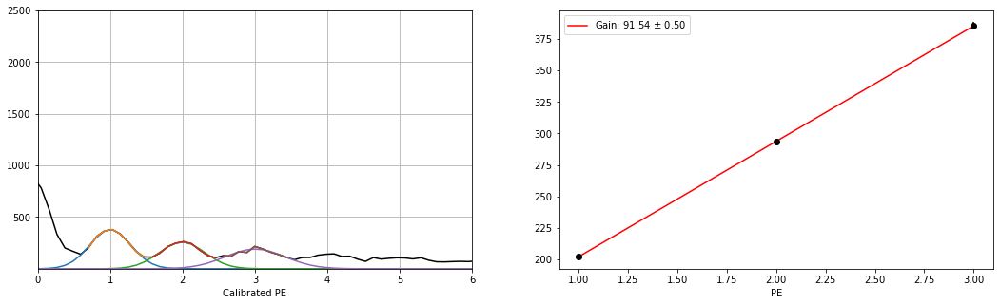

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_5.h5
Guess:  [390, 205.0375457875458, 10]
Params:  [379.27796945 200.68377447  25.04421941]
Guess:  [283, 295.0540293040293, 10]
Params:  [274.45057944 294.245787    27.63054124]
Guess:  [217, 385.0705128205128, 10]
Params:  [196.58425107 384.08312055  37.59516132]
[91.69967308 -1.19525924]


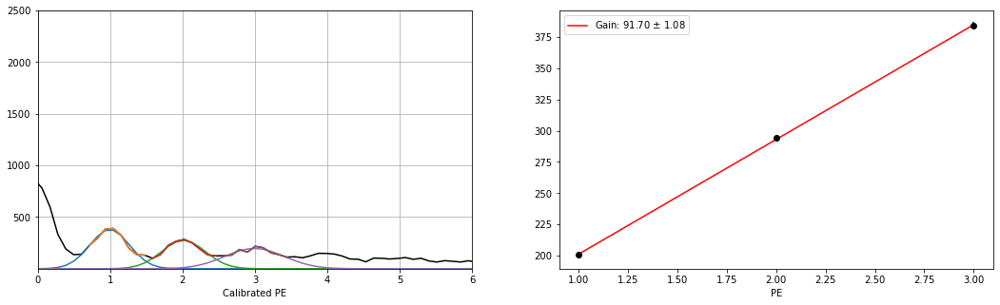

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_4.h5
Guess:  [399, 195.03571428571428, 10]
Params:  [392.26164505 200.91058296  24.05077201]
Guess:  [274, 285.05219780219784, 10]
Params:  [268.90545371 290.90027409  28.23423566]
Guess:  [203, 375.06868131868134, 10]
Params:  [194.08957606 381.35917557  37.66607631]
[90.22429631 -1.2259235 ]


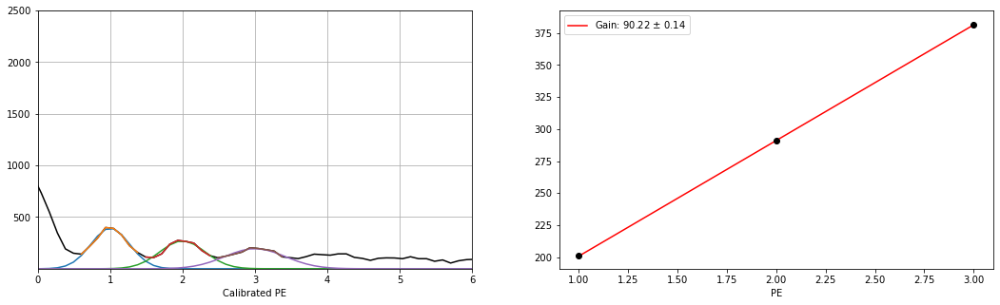

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_3.h5
Guess:  [429, 205.0375457875458, 10]
Params:  [413.27502392 200.82198644  24.13329984]
Guess:  [278, 295.0540293040293, 10]
Params:  [269.83433015 292.02548052  31.85278057]
Guess:  [207, 375.06868131868134, 10]
Params:  [199.87625996 384.61260202  39.69280919]
[91.89530782 -1.18282507]


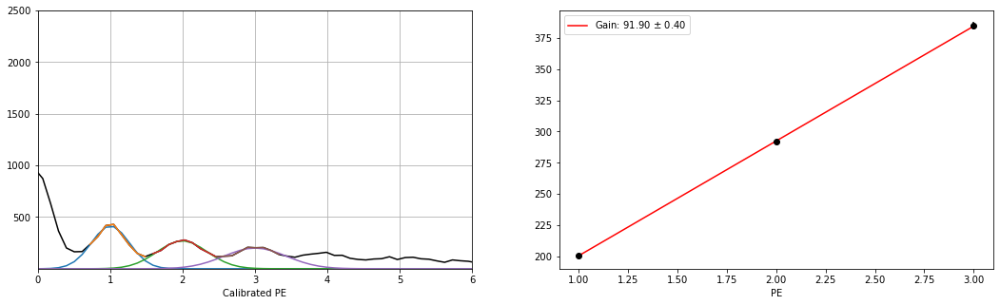

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_2.h5
Guess:  [416, 195.03571428571428, 10]
Params:  [405.26337957 200.9354829   24.93349518]
Guess:  [279, 285.05219780219784, 10]
Params:  [266.64353815 291.40511602  33.26244731]
Guess:  [238, 375.06868131868134, 10]
Params:  [207.69268717 383.29633644  38.90925665]
[91.18042676 -1.20111441]


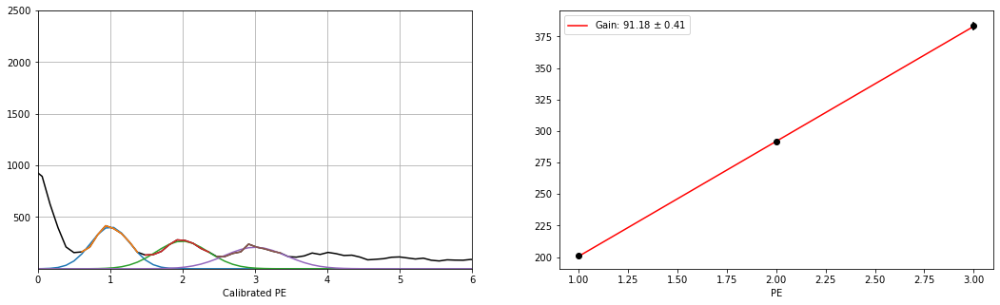

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_1.h5
Guess:  [364, 205.0375457875458, 10]
Params:  [357.97275539 202.26295894  31.84131758]
Guess:  [257, 305.0558608058608, 10]
Params:  [247.66988617 296.11641782  37.62384207]
Guess:  [199, 385.0705128205128, 10]
Params:  [187.29148712 382.45835166  46.79881416]
[90.09769644 -1.25882445]


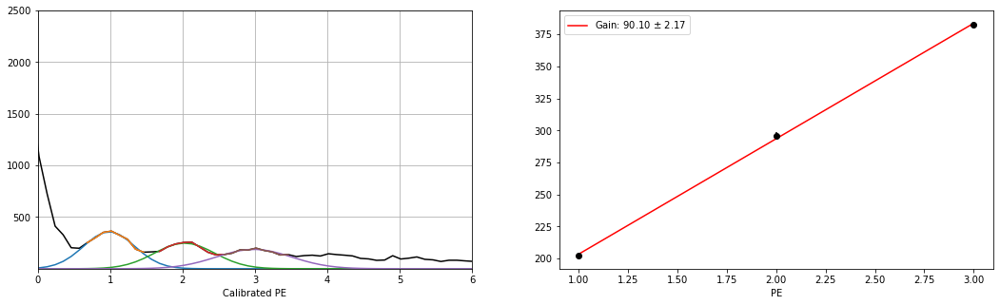

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_405_0.h5
Guess:  [416, 195.03571428571428, 10]
Params:  [387.30054543 198.68188747  27.56919365]
Guess:  [296, 295.0540293040293, 10]
Params:  [271.79408463 293.61078096  31.43624212]
Guess:  [240, 385.0705128205128, 10]
Params:  [202.6836921  383.83095568  37.3675349 ]
[92.5745341  -1.15466031]


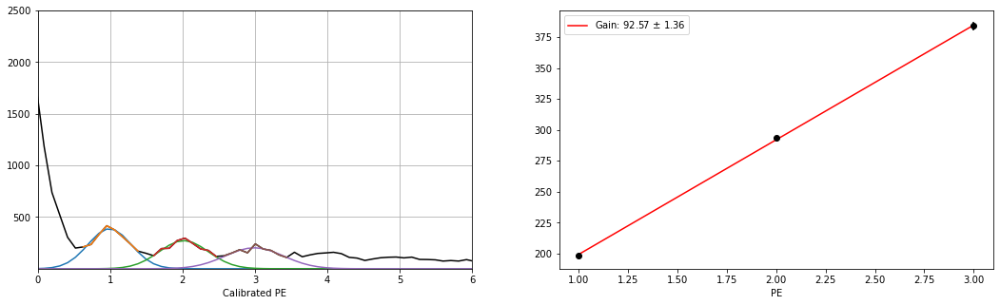

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_33.h5
Guess:  [255, 205.0375457875458, 10]
Params:  [236.28434148 201.6334885   28.49386983]
Guess:  [134, 295.0540293040293, 10]
Params:  [125.62121273 293.97706233  27.79172942]
Guess:  [75, 395.0723443223443, 10]
Params:  [ 74.81997909 394.2396501   39.68751965]
[96.30308076 -1.08003369]


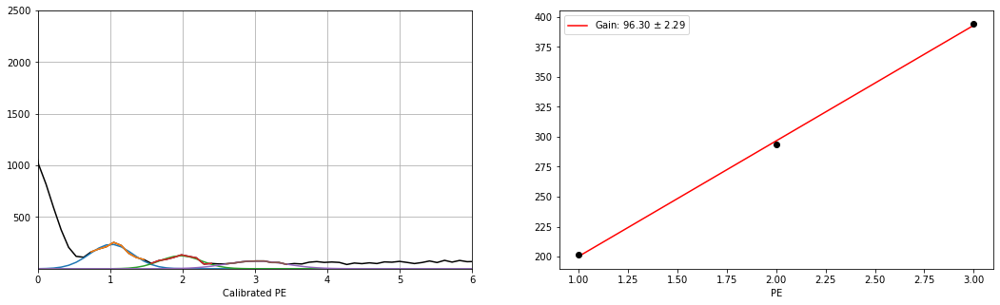

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_32.h5
Guess:  [245, 205.0375457875458, 10]
Params:  [235.32316801 202.25632174  24.02248955]
Guess:  [119, 295.0540293040293, 10]
Params:  [121.60696427 297.84467643  29.45622748]
Guess:  [78, 385.0705128205128, 10]
Params:  [ 75.231262   390.95232987  32.05220441]
[94.34800411 -1.14810874]


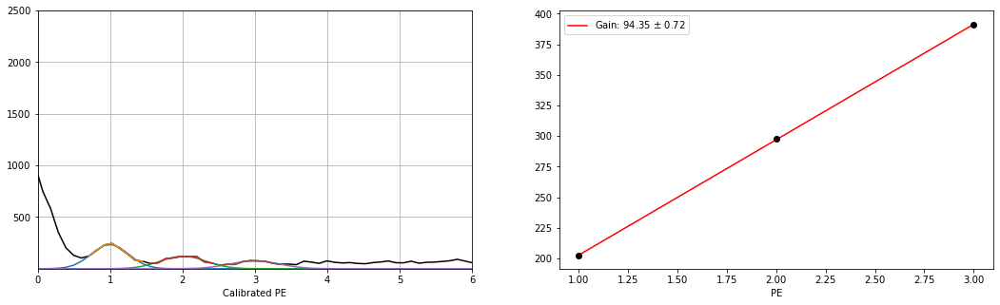

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_31.h5
Guess:  [247, 205.0375457875458, 10]
Params:  [224.60431671 203.01951016  23.52530206]
Guess:  [107, 295.0540293040293, 10]
Params:  [103.70728137 298.23723248  34.48380889]
Guess:  [86, 395.0723443223443, 10]
Params:  [ 74.16960506 395.16521094  34.49710253]
[96.07285035 -1.11021602]


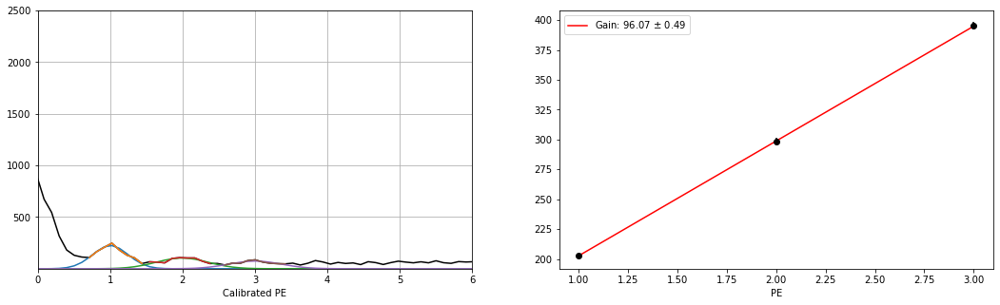

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_30.h5
Guess:  [247, 205.0375457875458, 10]
Params:  [235.85691343 204.4999064   23.85530284]
Guess:  [134, 295.0540293040293, 10]
Params:  [112.21063407 294.22627556  29.14848808]
Guess:  [71, 385.0705128205128, 10]
Params:  [ 65.98053432 391.58591738  41.04861224]
[93.54300544 -1.17255896]


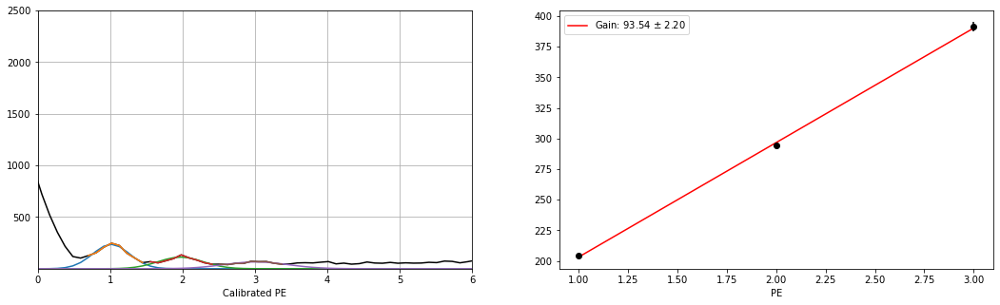

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_29.h5
Guess:  [237, 205.0375457875458, 10]
Params:  [231.80328771 203.19754696  25.30388321]
Guess:  [130, 295.0540293040293, 10]
Params:  [114.87430743 299.50883169  30.54736825]
Guess:  [72, 385.0705128205128, 10]
Params:  [ 67.38888146 392.83149432  43.73663339]
[94.81697366 -1.14830365]


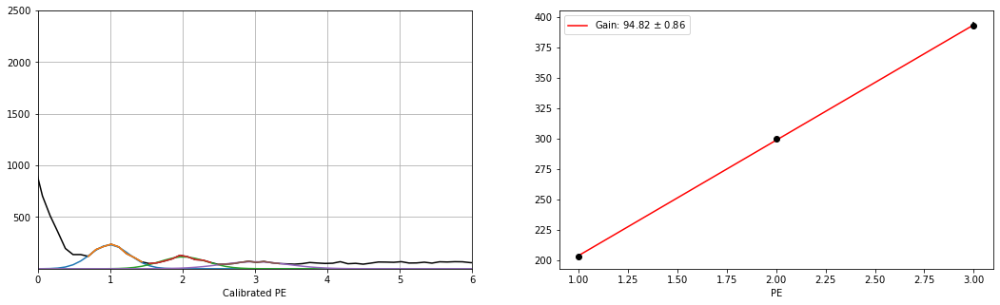

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_28.h5
Guess:  [279, 205.0375457875458, 10]
Params:  [262.72837605 202.81656115  23.2096323 ]
Guess:  [113, 295.0540293040293, 10]
Params:  [106.92274265 296.69081073  35.78585596]
Guess:  [90, 395.0723443223443, 10]
Params:  [ 76.39335804 390.22244462  30.55696519]
[93.70294174 -1.16507252]


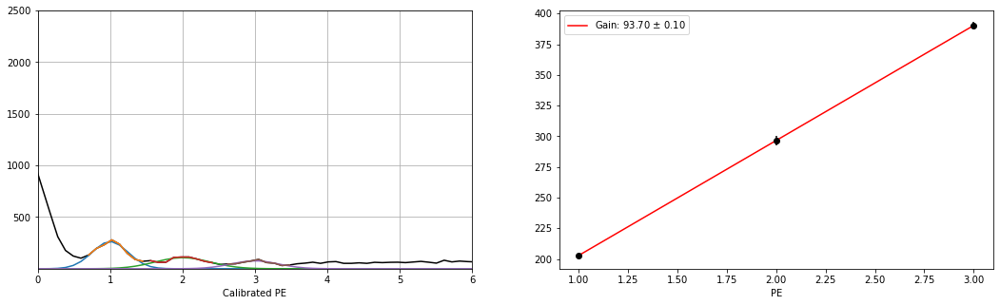

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_27.h5
Guess:  [252, 195.03571428571428, 10]
Params:  [239.89239718 199.36255164  23.17640523]
Guess:  [116, 295.0540293040293, 10]
Params:  [111.90420534 296.12541944  28.52269746]
Guess:  [79, 395.0723443223443, 10]
Params:  [ 70.95977802 399.13919313  43.77002634]
[99.88832067 -0.98542465]


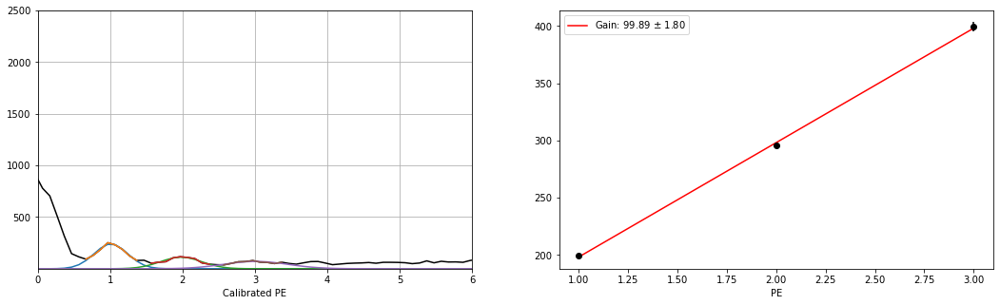

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_26.h5
Guess:  [232, 195.03571428571428, 10]
Params:  [231.95462692 201.37674923  27.86545455]
Guess:  [117, 285.05219780219784, 10]
Params:  [ 97.31512125 289.78909732  42.70194362]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 73.25503971 389.89419631  44.69068738]
[94.25872356 -1.11575067]


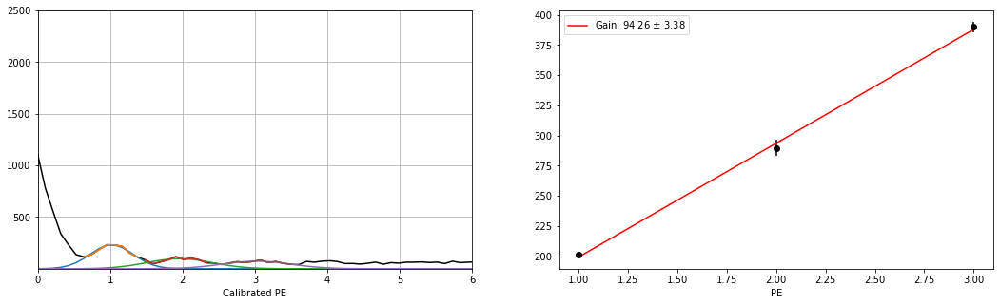

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_25.h5
Guess:  [231, 205.0375457875458, 10]
Params:  [213.83520017 203.87174713  26.23887444]
Guess:  [131, 305.0558608058608, 10]
Params:  [120.13921677 298.17358753  29.40548572]
Guess:  [79, 395.0723443223443, 10]
Params:  [ 76.06558735 395.38593311  34.60504888]
[95.757093   -1.12398535]


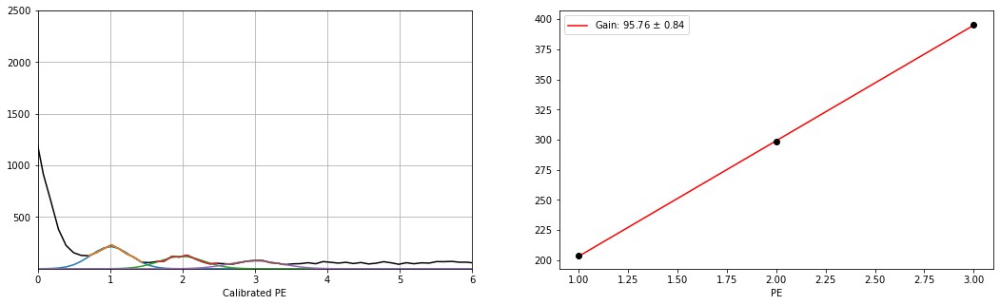

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_24.h5
Guess:  [244, 205.0375457875458, 10]
Params:  [241.8135773  202.94031536  24.22082642]
Guess:  [118, 295.0540293040293, 10]
Params:  [113.02129176 295.69479134  31.22701397]
Guess:  [91, 395.0723443223443, 10]
Params:  [ 77.66955761 393.51467153  34.82016377]
[95.28717809 -1.1209158 ]


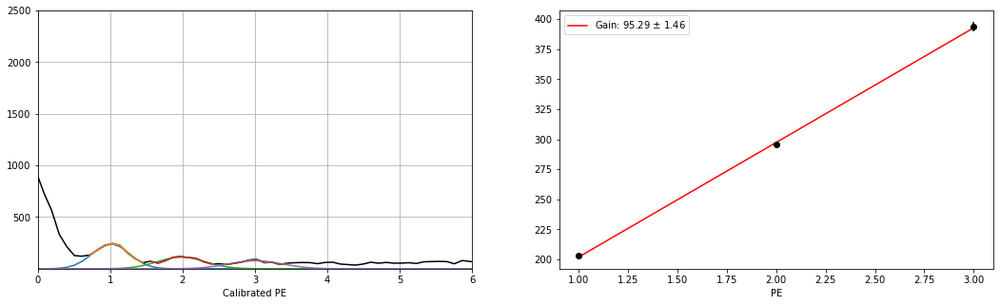

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_23.h5
Guess:  [275, 195.03571428571428, 10]
Params:  [258.565201   200.41179014  27.29684806]
Guess:  [124, 305.0558608058608, 10]
Params:  [119.59950609 298.15829721  32.35428024]
Guess:  [95, 395.0723443223443, 10]
Params:  [ 82.87968741 386.59231691  38.71654882]
[93.09026349 -1.16954882]


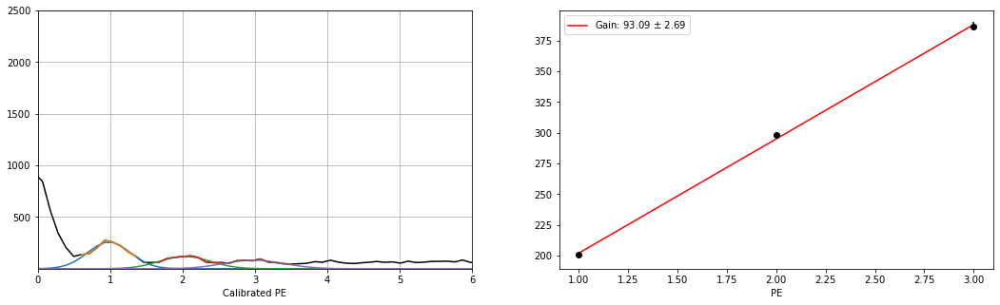

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_22.h5
Guess:  [230, 205.0375457875458, 10]
Params:  [239.00737827 199.9847052   23.50417473]
Guess:  [129, 305.0558608058608, 10]
Params:  [110.2629609  297.99372136  30.70333918]
Guess:  [83, 395.0723443223443, 10]
Params:  [ 74.03095772 391.75329512  36.29474119]
[95.88429499 -1.09307422]


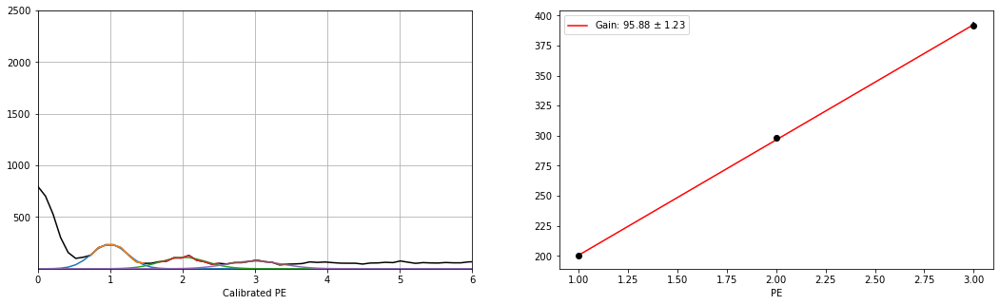

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_21.h5
Guess:  [264, 205.0375457875458, 10]
Params:  [247.20767854 202.63587279  24.58854471]
Guess:  [124, 295.0540293040293, 10]
Params:  [114.54605524 292.49151387  29.35467491]
Guess:  [100, 385.0705128205128, 10]
Params:  [ 83.51395286 386.55964588  30.11630023]
[91.96188655 -1.1958422 ]


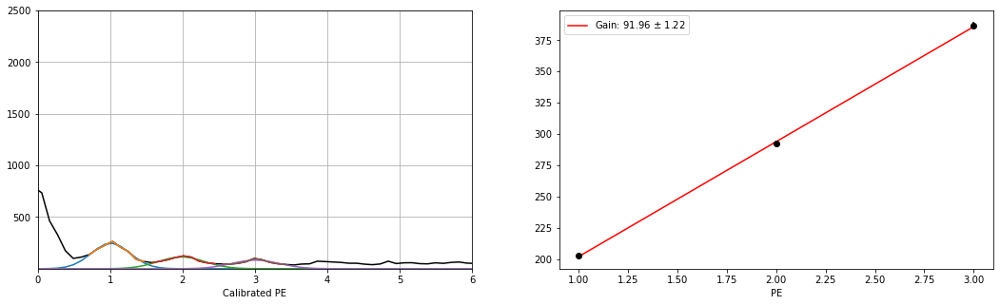

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_20.h5
Guess:  [244, 195.03571428571428, 10]
Params:  [235.44624663 202.55501108  27.98879213]
Guess:  [121, 295.0540293040293, 10]
Params:  [116.58102864 299.1539134   32.91904476]
Guess:  [78, 385.0705128205128, 10]
Params:  [ 70.9515058  394.61118345  40.41819765]
[96.0280862  -1.11131234]


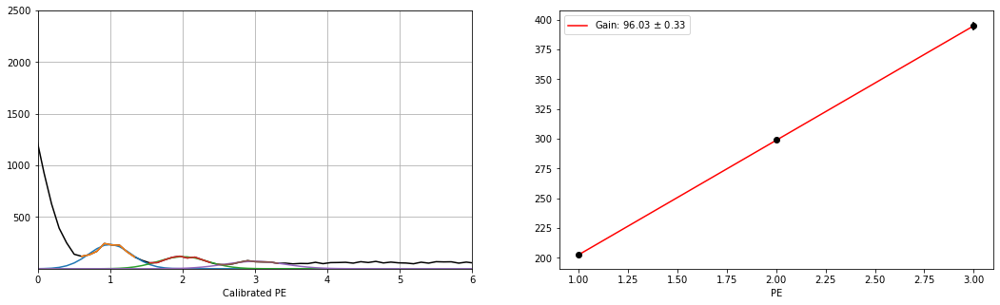

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_19.h5
Guess:  [223, 195.03571428571428, 10]
Params:  [218.22936036 200.82858914  29.82569396]
Guess:  [113, 305.0558608058608, 10]
Params:  [108.74990486 297.45451431  35.19968021]
Guess:  [77, 385.0705128205128, 10]
Params:  [ 67.28856316 384.91534676  40.43025706]
[92.0433786  -1.19848628]


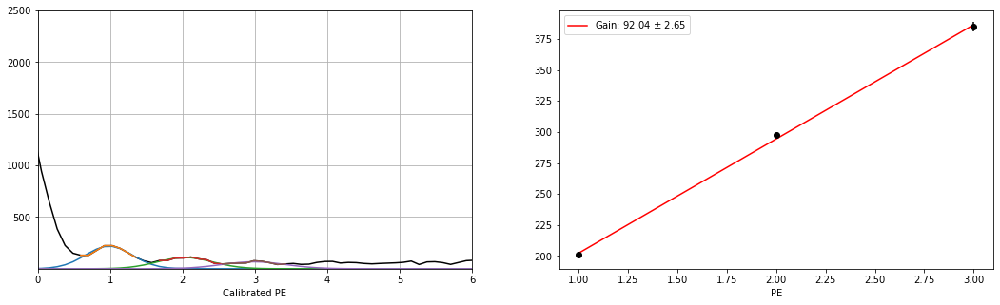

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_18.h5
Guess:  [258, 205.0375457875458, 10]
Params:  [243.65793481 201.94733501  24.35131907]
Guess:  [118, 295.0540293040293, 10]
Params:  [114.1870288  296.04520987  30.40457717]
Guess:  [77, 395.0723443223443, 10]
Params:  [ 72.65684998 387.59855776  39.43419655]
[92.82561144 -1.18012486]


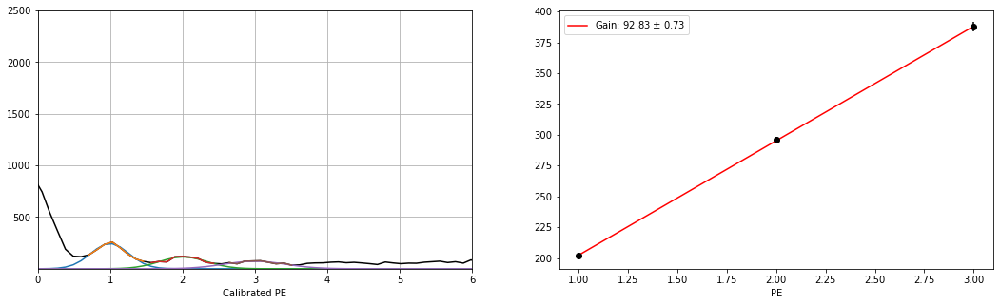

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_17.h5
Guess:  [251, 205.0375457875458, 10]
Params:  [248.73530033 203.90390729  24.02572468]
Guess:  [123, 295.0540293040293, 10]
Params:  [116.65227031 298.11351841  30.83019264]
Guess:  [83, 395.0723443223443, 10]
Params:  [ 76.08740647 392.63163907  37.27455329]
[94.3638659  -1.16028124]


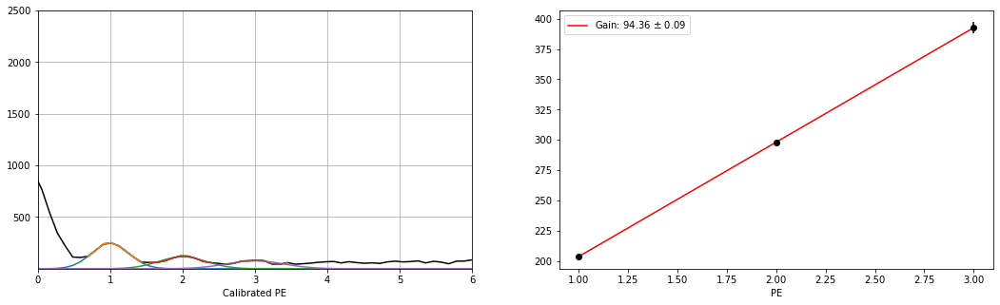

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_16.h5
Guess:  [284, 205.0375457875458, 10]
Params:  [264.02076176 204.36568518  22.43325585]
Guess:  [121, 285.05219780219784, 10]
Params:  [112.03398119 293.84673951  31.3912937 ]
Guess:  [78, 375.06868131868134, 10]
Params:  [ 67.90664462 387.34038311  41.69925093]
[91.487349   -1.22650369]


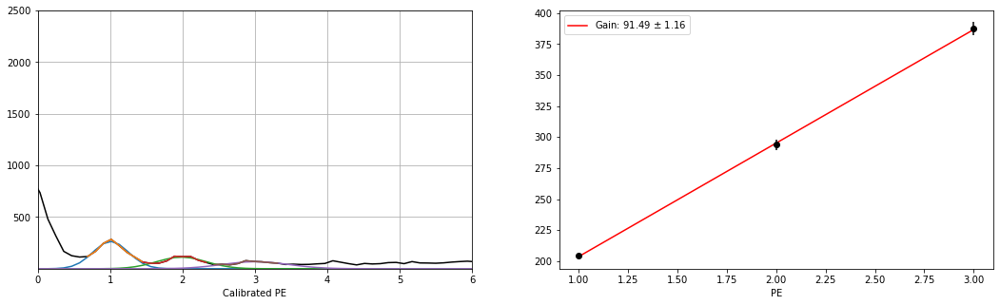

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_15.h5
Guess:  [264, 205.0375457875458, 10]
Params:  [247.44647138 201.73547581  24.68576938]
Guess:  [117, 295.0540293040293, 10]
Params:  [112.0676364  295.36878073  29.75855881]
Guess:  [76, 395.0723443223443, 10]
Params:  [ 74.3690728  396.04149666  38.98418495]
[97.15301054 -1.06439553]


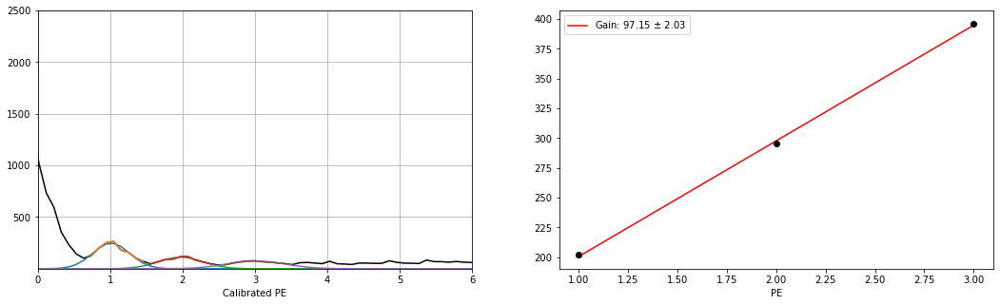

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_14.h5
Guess:  [247, 205.0375457875458, 10]
Params:  [233.79826085 203.68115228  23.71144679]
Guess:  [126, 285.05219780219784, 10]
Params:  [111.93450946 295.11274918  33.63030219]
Guess:  [77, 405.0741758241758, 10]
Params:  [ 72.99105748 392.49883623  46.77578292]
[94.40884199 -1.14692536]


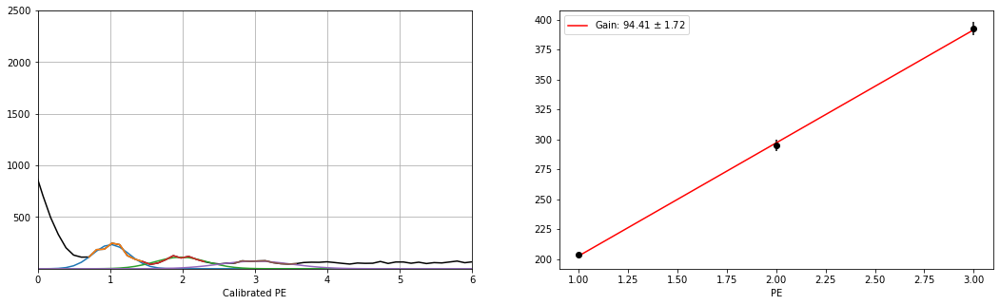

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_13.h5
Guess:  [237, 205.0375457875458, 10]
Params:  [237.14637068 202.94553297  24.77989469]
Guess:  [129, 295.0540293040293, 10]
Params:  [121.00559716 294.59390602  28.91192427]
Guess:  [76, 385.0705128205128, 10]
Params:  [ 72.94775617 388.56989011  42.32164452]
[92.81217851 -1.18244633]


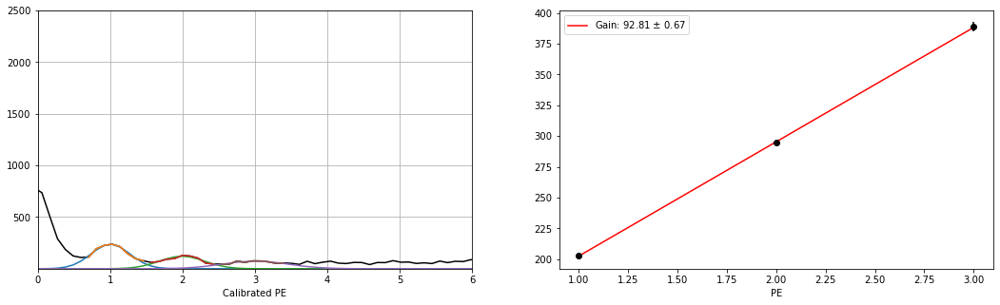

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_12.h5
Guess:  [262, 205.0375457875458, 10]
Params:  [263.44119063 202.60039091  22.82243048]
Guess:  [116, 305.0558608058608, 10]
Params:  [110.42541363 297.97236048  32.85980938]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 74.49814344 395.65938569  35.86062295]
[96.52949736 -1.09484721]


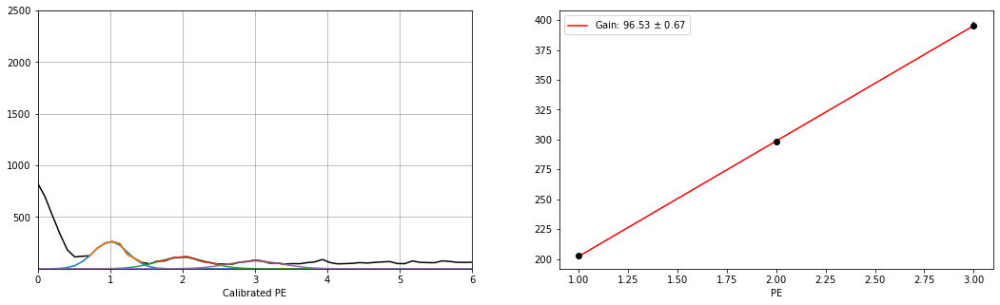

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_11.h5
Guess:  [268, 205.0375457875458, 10]
Params:  [260.36062772 202.80550269  23.38056035]
Guess:  [134, 295.0540293040293, 10]
Params:  [128.63711432 294.745862    27.31636343]
Guess:  [86, 395.0723443223443, 10]
Params:  [ 74.69547428 391.17620236  39.34579683]
[94.18534978 -1.14531425]


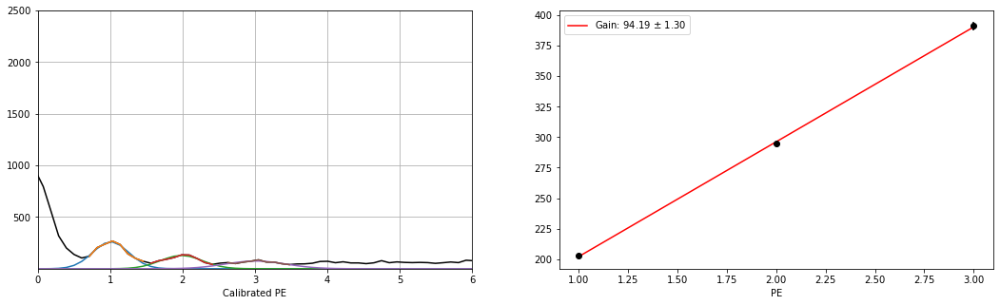

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_10.h5
Guess:  [250, 205.0375457875458, 10]
Params:  [239.71506936 201.18312345  24.53621869]
Guess:  [115, 295.0540293040293, 10]
Params:  [108.97607587 297.56742655  31.79497491]
Guess:  [92, 395.0723443223443, 10]
Params:  [ 84.30711422 392.44399608  31.04092291]
[95.63043633 -1.10638391]


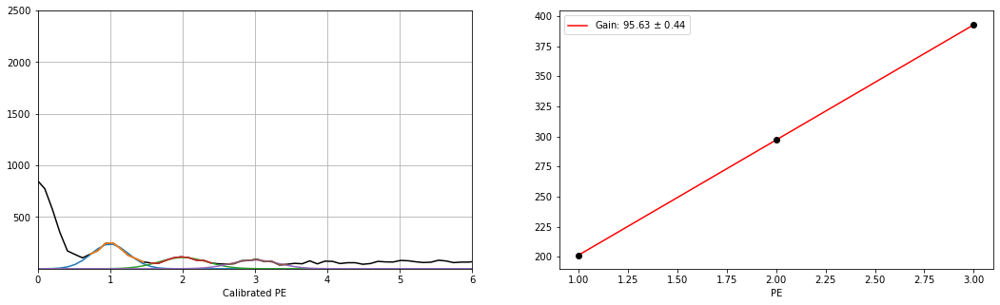

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_9.h5
Guess:  [260, 195.03571428571428, 10]
Params:  [252.44115247 201.76666662  25.80843741]
Guess:  [145, 295.0540293040293, 10]
Params:  [117.41811351 294.72334462  29.06073148]
Guess:  [100, 395.0723443223443, 10]
Params:  [ 91.00018962 390.97689659  31.13442168]
[94.60511498 -1.12691658]


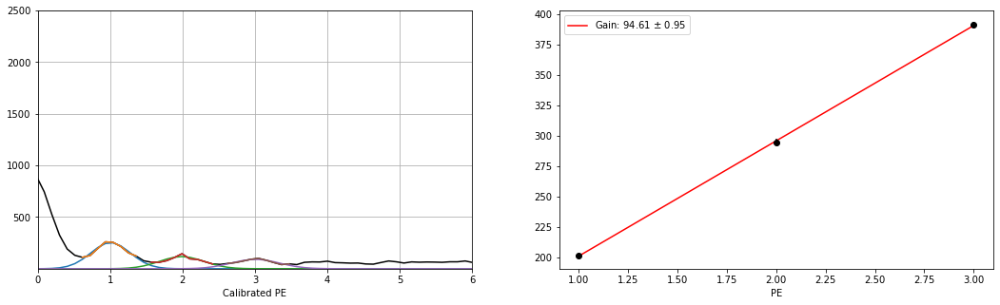

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_8.h5
Guess:  [242, 195.03571428571428, 10]
Params:  [239.71333845 201.96977392  26.8009966 ]
Guess:  [120, 295.0540293040293, 10]
Params:  [118.23380739 297.56424165  30.30736989]
Guess:  [99, 395.0723443223443, 10]
Params:  [ 75.28167181 387.40121212  41.94677204]
[92.71571897 -1.18872656]


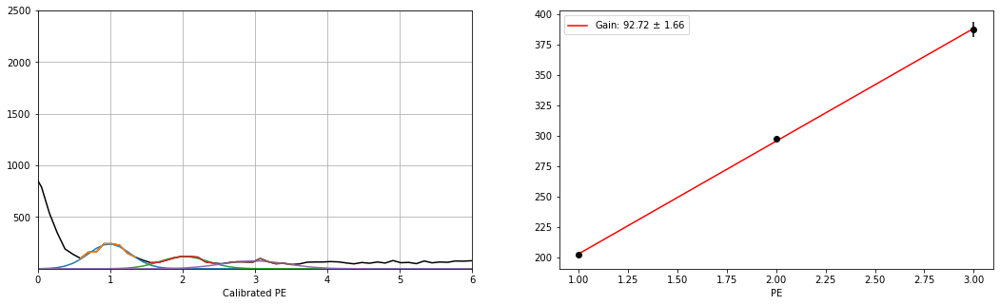

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_7.h5
Guess:  [248, 205.0375457875458, 10]
Params:  [242.20066833 201.30987956  24.77023441]
Guess:  [130, 295.0540293040293, 10]
Params:  [114.1125652  295.37312372  27.54709906]
Guess:  [88, 395.0723443223443, 10]
Params:  [ 72.10878957 388.94631208  40.8215665 ]
[93.81821625 -1.14661463]


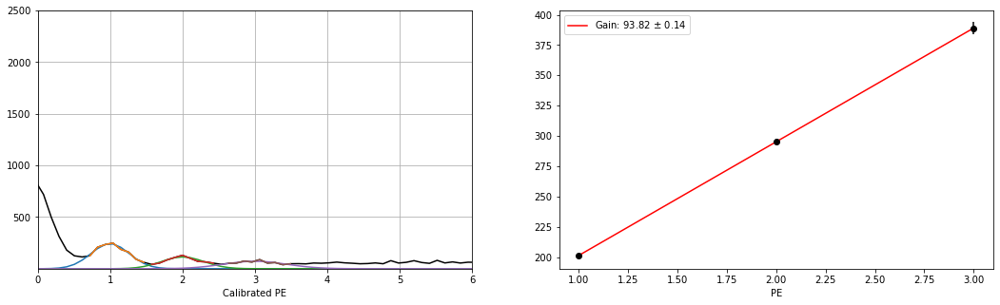

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_6.h5
Guess:  [259, 205.0375457875458, 10]
Params:  [242.80329987 201.42539253  24.18028824]
Guess:  [126, 295.0540293040293, 10]
Params:  [118.38553156 295.33904178  26.7330872 ]
Guess:  [75, 395.0723443223443, 10]
Params:  [ 73.19362433 390.67726462  37.35824309]
[94.62593606 -1.12613975]


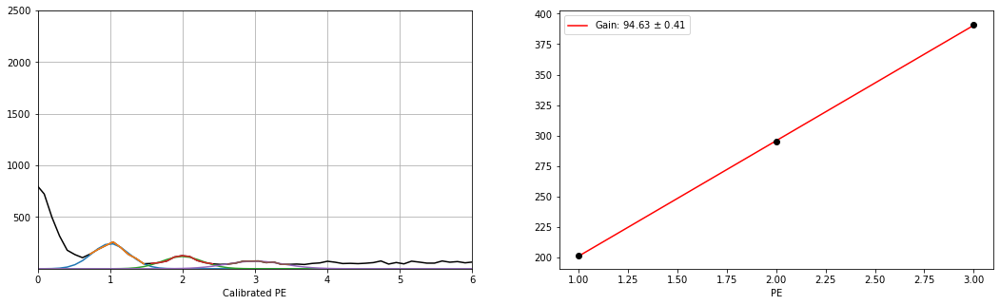

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_5.h5
Guess:  [248, 205.0375457875458, 10]
Params:  [239.02219559 201.57483533  24.30780716]
Guess:  [110, 295.0540293040293, 10]
Params:  [104.0458894  296.24789165  34.99901926]
Guess:  [84, 395.0723443223443, 10]
Params:  [ 68.42822629 396.38786116  51.37632969]
[97.4065129  -1.06006433]


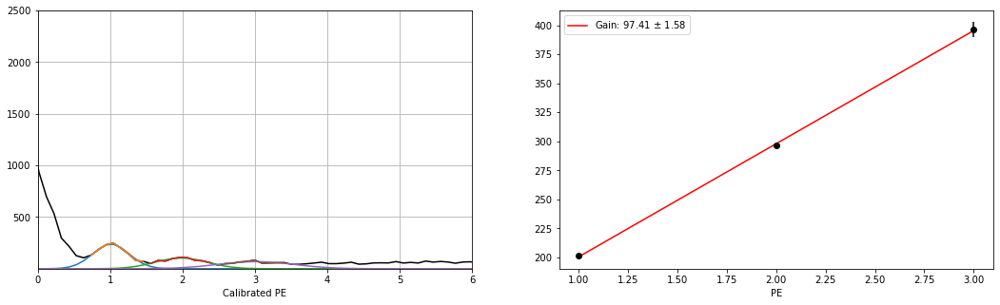

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_4.h5
Guess:  [253, 205.0375457875458, 10]
Params:  [241.200013   202.69993708  23.01341777]
Guess:  [136, 295.0540293040293, 10]
Params:  [123.98765823 294.0126931   24.72112459]
Guess:  [79, 395.0723443223443, 10]
Params:  [ 69.75313602 390.6611939   42.66561297]
[93.98062843 -1.1473643 ]


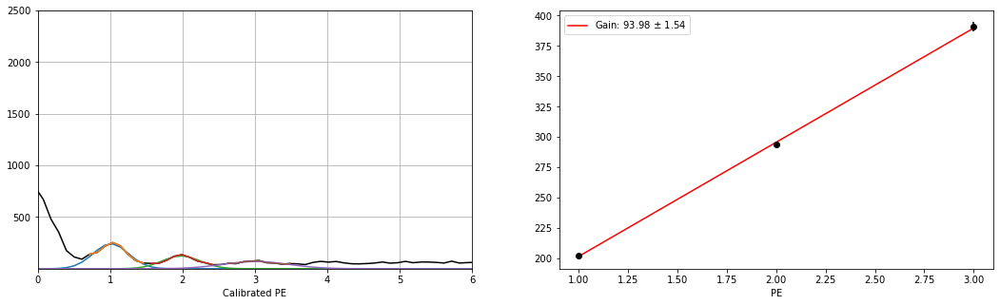

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_3.h5
Guess:  [241, 195.03571428571428, 10]
Params:  [229.70313919 202.64708061  24.02840585]
Guess:  [128, 295.0540293040293, 10]
Params:  [110.64436137 298.63695151  26.77980751]
Guess:  [80, 395.0723443223443, 10]
Params:  [ 71.70690141 393.19752308  36.21728916]
[95.27522124 -1.12946551]


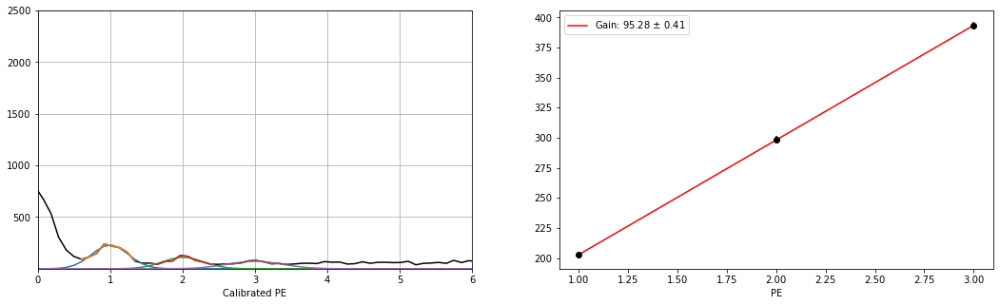

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_2.h5
Guess:  [275, 205.0375457875458, 10]
Params:  [273.41674006 203.16385581  23.81585502]
Guess:  [120, 305.0558608058608, 10]
Params:  [123.11473738 297.15249631  30.29770932]
Guess:  [86, 415.07600732600736, 10]
Params:  [ 76.6641952  394.42863062  52.28983102]
[95.63238736 -1.11869583]


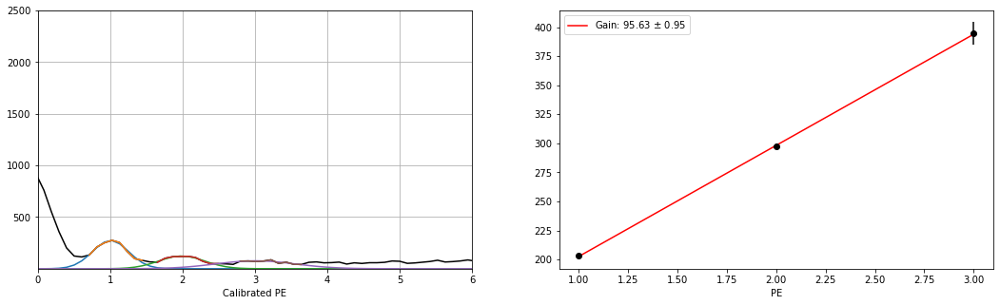

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_1.h5
Guess:  [234, 205.0375457875458, 10]
Params:  [224.58924059 204.88653513  26.88298764]
Guess:  [104, 305.0558608058608, 10]
Params:  [ 96.16610175 299.4037136   37.25519807]
Guess:  [81, 395.0723443223443, 10]
Params:  [ 72.12446108 390.44049145  39.29214112]
[92.77697822 -1.21462917]


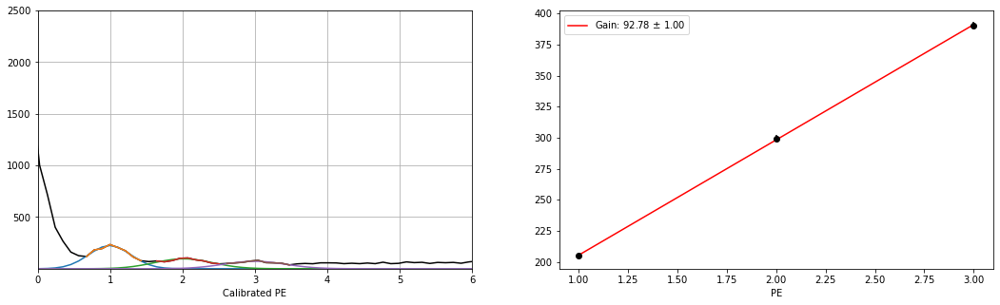

Working on file /gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/mca_keith_31.40OV_310_0.h5
Guess:  [220, 195.03571428571428, 10]
Params:  [225.21265328 200.54117956  29.13508599]
Guess:  [117, 305.0558608058608, 10]
Params:  [113.16938034 298.54012555  33.84131611]
Guess:  [81, 375.06868131868134, 10]
Params:  [ 68.22669105 380.11831036  51.86697264]
[89.78856537 -1.26396281]


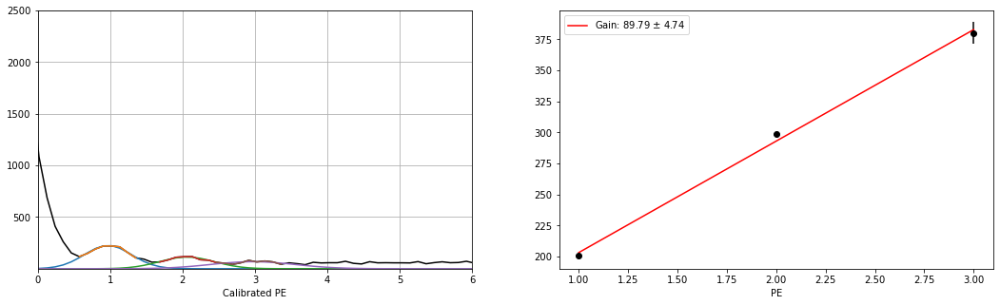

In [20]:
data_NO_FIELD = {'source':{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[], 'dc_offset':[], 'mean_dc_offset': 0.0}, 
                  405.0:{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[],'dc_offset':[],'mean_dc_offset': 0.0},
                  310.0:{'pe_data':[], 'counts':[], 'gain':[], 'gain_err':[],'dc_offset':[],'mean_dc_offset': 0.0}}

for file_type, file_list in files_7.items():
    for file in file_list:
        pe, counts, gain, gain_err, dc_offset = plot_fit_gain(file, 25, 10, 10)
        data_NO_FIELD[file_type]['pe_data'].append(pe)
        data_NO_FIELD[file_type]['counts'].append(counts)
        data_NO_FIELD[file_type]['gain'].append(gain)
        data_NO_FIELD[file_type]['gain_err'].append(gain_err)
        data_NO_FIELD[file_type]['dc_offset'].append(dc_offset)
    #data_NO_FIELD[file_type]['dc'] = np.mean(data_NO_FIELD[file_type]['dc_offset'])
    
                      
    # Calculate the mean of the final dc_offset for each file_type
    data_NO_FIELD[file_type]['mean_dc_offset'] = np.mean(data_NO_FIELD[file_type]['dc_offset'])

Mean dc offset for 310 nm: -1.1402481092503292 with standard deviation: 0.05225421776008627
Mean dc offset for 405 nm: -1.2117894396027578 with standard deviation: 0.03542552806400595
Mean dc offset for source: -1.1022387428742475 with standard deviation: 0.0193215411946153


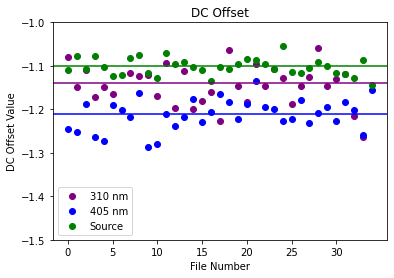

In [22]:
# Get the dc_offset data and mean_dc_offset for each file_type
NO_dc_offset_310 = data_NO_FIELD[310.0]['dc_offset']
NO_dc_offset_405 = data_NO_FIELD[405.0]['dc_offset']
NO_dc_offset_source = data_NO_FIELD['source']['dc_offset']

# Plot the dc_offset values
plt.ylim(-1.5,-1)
plt.xticks(np.arange(0,len(NO_dc_offset_310),5))
plt.scatter(np.arange(0,len(NO_dc_offset_310),1),NO_dc_offset_310, color='purple', label='310 nm')
plt.axhline(y=data_NO_FIELD[310.0]['mean_dc_offset'], color='purple')
plt.scatter(np.arange(0,len(NO_dc_offset_405),1),NO_dc_offset_405, color = 'blue', label='405 nm')
plt.axhline(y=data_NO_FIELD[405.0]['mean_dc_offset'], color='blue')
plt.scatter(np.arange(0,len(NO_dc_offset_source),1),NO_dc_offset_source, color = 'green', label='Source')
plt.axhline(y=data_NEG_FIELD['source']['mean_dc_offset'], color='green')

print("Mean dc offset for 310 nm:", data_NO_FIELD[310.0]['mean_dc_offset'], "with standard deviation:", np.std(NO_dc_offset_310) )
print("Mean dc offset for 405 nm:", data_NO_FIELD[405.0]['mean_dc_offset'], "with standard deviation:", np.std(NO_dc_offset_405) )
print("Mean dc offset for source:", data_NO_FIELD['source']['mean_dc_offset'], "with standard deviation:", np.std(NO_dc_offset_source) )

# Add title and axis labels
plt.title("DC Offset")
plt.xlabel("File Number")
plt.ylabel("DC Offset Value")
plt.legend()

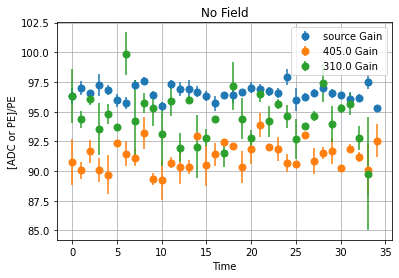

In [23]:
# plotting the gain over time

# getting the "time"
time_NO_FIELD = {}
for key in files_7:
    time_NO_FIELD[key] = np.arange(0, len(files_7[key]))
plt.figure(figsize=(6,4))
for key in data_NO_FIELD:
    plt.errorbar(time_NO_FIELD[key],np.array(data_NO_FIELD[key]['gain']),yerr=data_NO_FIELD[key]['gain_err'],fmt='o',ms=7,label= str(key)+' Gain')
# plt.errorbar(time_NO_FIELD,NO_FIELD_pe_corrected_gain,yerr=NO_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time')
plt.title('No Field')
plt.grid()
plt.legend(loc='best')
# plt.savefig('NO_FIELD_gain_comparison.pdf')
plt.show()

### Compare various fields uncalibrated gain

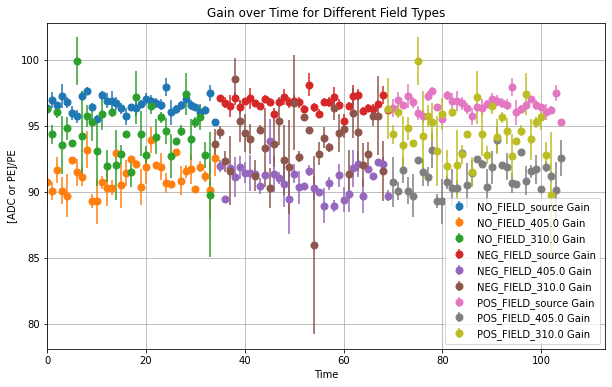

In [24]:
# plotting the gain over time
# getting the "time" for each field type
plot_order = ['NO_FIELD', 'POS_FIELD', 'NEG_FIELD']

time_NO_FIELD = {}
for key in files_7:
    time_NO_FIELD[key] = np.arange(0, len(files_7[key]))

time_NEG_FIELD = {}
for key in files_12:
    time_NEG_FIELD[key] = np.arange(len(time_NO_FIELD[key]), len(time_NO_FIELD[key]) + len(files_12[key]))

time_POS_FIELD = {}
for key in files_10:
    time_POS_FIELD[key] = np.arange(len(time_NO_FIELD[key])+len(time_NEG_FIELD[key]),  len(time_NO_FIELD[key]) + len(time_NEG_FIELD[key]) + len(files_10[key]))

# plot the data for each field type with an x-offset
plt.figure(figsize=(10,6))
for key in data_NO_FIELD:
    plt.errorbar(time_NO_FIELD[key],np.array(data_NO_FIELD[key]['gain']),yerr=data_NO_FIELD[key]['gain_err'],fmt='o',ms=7,label= 'NO_FIELD_' + str(key)+' Gain')
for key in data_NEG_FIELD:
    plt.errorbar(time_NEG_FIELD[key],np.array(data_NEG_FIELD[key]['gain']),yerr=data_NEG_FIELD[key]['gain_err'],fmt='o',ms=7,label= 'NEG_FIELD_' + str(key)+' Gain')
for key in data_POS_FIELD:
    plt.errorbar(time_POS_FIELD[key],np.array(data_POS_FIELD[key]['gain']),yerr=data_POS_FIELD[key]['gain_err'],fmt='o',ms=7,label= 'POS_FIELD_' + str(key)+' Gain')

plt.xlim(0, len(time_NO_FIELD[key]) + len(time_NEG_FIELD[key]) + len(files_10[key])+10)
plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time')
plt.title('Gain over Time for Different Field Types')
plt.grid()
plt.legend(loc='best')
plt.show()

In [ ]:
combined_time = {}
gain = {}
gain_error = {}
#offset_means = {}
plt.figure(figsize = (9, 6))
plt.title('DC Offset for all fields')
plt.xlabel('Time')
plt.ylabel('DC Offset')

for file_type in data_NO_FIELD:
    combined_time[file_type] = np.arange(0, (len(time_NO_FIELD[file_type])+len(time_POS_FIELD[file_type])+len(time_NEG_FIELD[file_type])))
    combined gain = np.concatenate()
    for key in data_NO_FIELD:
        plt.errorbar(time_NO_FIELD[key],np.array(data_NO_FIELD[key]['gain']),yerr=data_NO_FIELD[key]['gain_err'],fmt='o',ms=7,label= 'NO_FIELD_' + str(key)+' Gain')
    for key in data_NEG_FIELD:
        plt.errorbar(time_NEG_FIELD[key],np.array(data_NEG_FIELD[key]['gain']),yerr=data_NEG_FIELD[key]['gain_err'],fmt='o',ms=7,label= 'NEG_FIELD_' + str(key)+' Gain')
    for key in data_POS_FIELD:
        plt.errorbar(time_POS_FIELD[key],np.array(data_POS_FIELD[key]['gain']),yerr=data_POS_FIELD[key]['gain_err'],fmt='o',ms=7,label= 'POS_FIELD_' + str(key)+' Gain')
    combined_offsets = np.concatenate((data_NO_FIELD[file_type]['dc_offset'], data_POS_FIELD[file_type]['dc_offset'], data_NEG_FIELD[file_type]['dc_offset']))
#    combined_masked_data = np.ma.masked_array(combined_offsets, np.isnan(combined_offsets)) # creating a masked array to ignore the nan when tkaing the average dc offset
#    combined_dc_offset_mean = np.ma.average(combined_masked_data)
    print(combined_dc_offset_mean)
    offset_means[file_type] = combined_dc_offset_mean
    plt.scatter(combined_time[file_type], combined_offsets, label=file_type)
    plt.axvline(x=len(time_NO_FIELD['source'])-1, color='k')
    plt.axvline(x=len(time_NO_FIELD['source'])+len(time_POS_FIELD['source'])-1, color='k')
    plt.axhline(y=combined_dc_offset_mean, color='r')
plt.legend()

In [10]:
#path = r"C:/Data/20220630/LXe_Full_E_field_-2kV_source_reposition_Gain_source_removed/"
path_10 = '/gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/'
SRS_gain_10 = 10 # gain on the SRS bandpass filter
# peak_threshold = 700 # upper bound of pedestal
# breakdown = 27.4 # breakdown voltage of the SiPM
pedestal_10 = 275 # center of noise pedestal peak

file_list_10 = natsort.realsorted(glob.glob(path_10 + "mca_*.h5"))[::-1]
print("Found %d files"%len(file_list_10))

# splitting files by type/wavelength
file_by_wavelength = {}

for file in file_list_10:
    wavelength = file.split('_')
    try:
        file_wavelength = float(file_parts[-2]) # get wavelength from filename (float bc a number)
    except ValueError:
        file_wavelength = file_parts[-2] # leaving tag as a string for source data (otherwise have string: 'source')
    


Found 104 files


In [23]:
# def separate_files(file_list):
#     # create empty dictionaries for each wavelength
#     wavelength_310 = {}
#     wavelength_405 = {}
#     wavelength_source = {}

#     for file in file_list:
#         #print("Working on file %s" % (file))

#         # extract wavelength tag from file name
#         file_parts = file.split("_")
#         try:
#             file_wavelength = float(file_parts[-2])
#         except ValueError:
#             file_wavelength = file_parts[-2]

#         if file_wavelength == 310:
#             if file not in wavelength_310:
#                 wavelength_310[file] = 1
#             else:
#                 wavelength_310[file] += 1

#         elif file_wavelength == 405:
#             if file not in wavelength_405:
#                 wavelength_405[file] = 1
                
#         elif file_wavelength == 'source':
#             if file not in wavelength_source:
#                 wavelength_source[file] = 1
#             else:
#                 wavelength_source[file] += 1

#     return wavelength_310, wavelength_405, wavelength_source
    

In [ ]:
#Uncalibrated gain


IDK if we need this

In [ ]:
# getting the data that we need
path_10 = '/gpfs/gibbs/project/david_moore/mpw46/purity_monitor/20230213/step10/'
files_10 = load_directory(path_10)
SRS_gain_10 = 10 # gain on the SRS bandpass filter
# peak_threshold = 700 # upper bound of pedestal
# breakdown = 27.4 # breakdown voltage of the SiPM
pedestal_10 = 275 # center of noise pedestal peak

In [6]:
def rebin_center(hx,h,bins):
    # rebinning the data with the new x values corresponding to the mean of the old?
    h_rebin=[]
    hx_rebin=[]
    for i in range(int(len(h)/bins)):
        start_idx=i*bins
        end_idx=(i+1)*bins
        h_rebin.append(np.sum(h[start_idx:end_idx]))
        hx_rebin.append(np.mean(hx[start_idx:end_idx])) # finding the mean of the x values in the bin
    # hx_rebin=range(len(h_rebin))
    return np.array(hx_rebin), np.array(h_rebin)

### This is the function for calculating gain, if we use ours instead it will look different
#### maybe try putting our gain function and anything else that has an overlap into a separate python file that we can import?
#### also if using ours we might want to add a rebinning feature like the one here

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


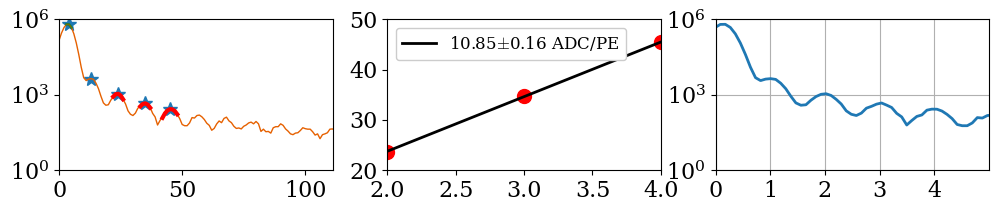

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_1.h5


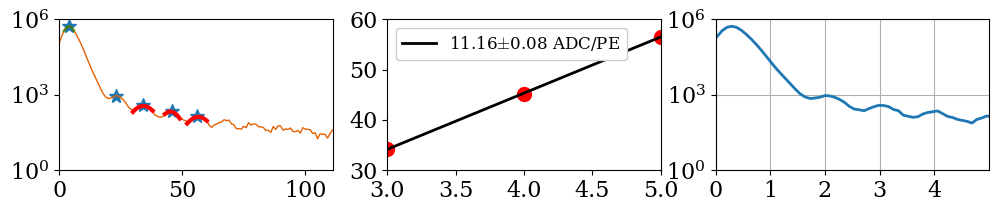

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_2.h5


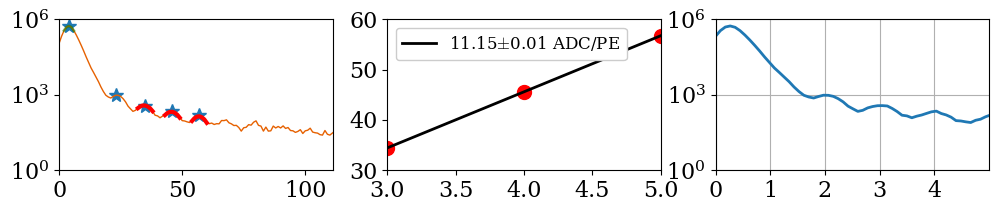

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_3.h5


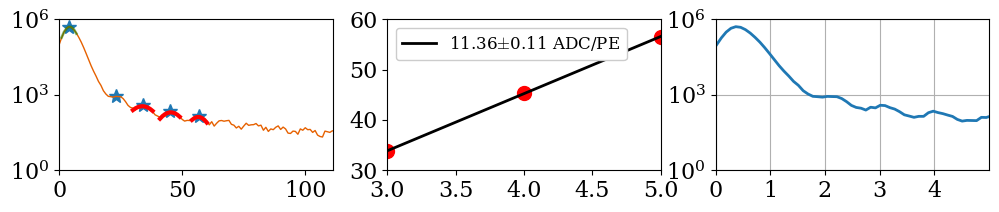

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_4.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


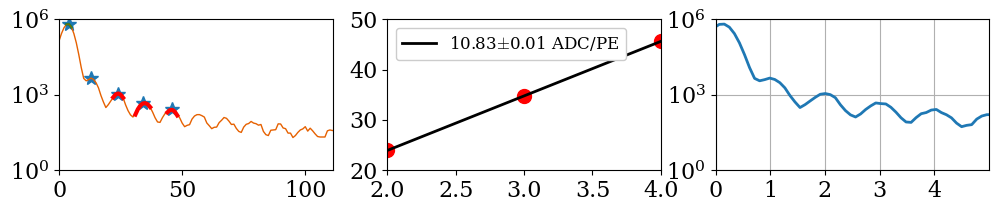

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_5.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


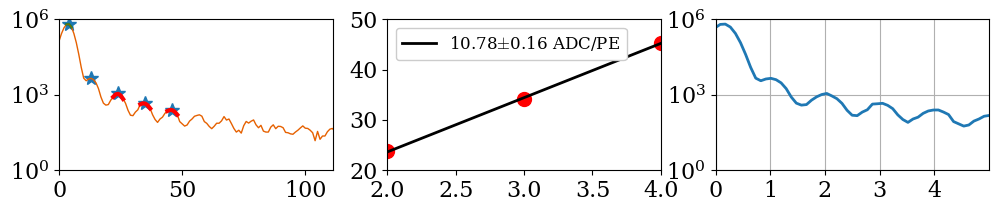

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_6.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


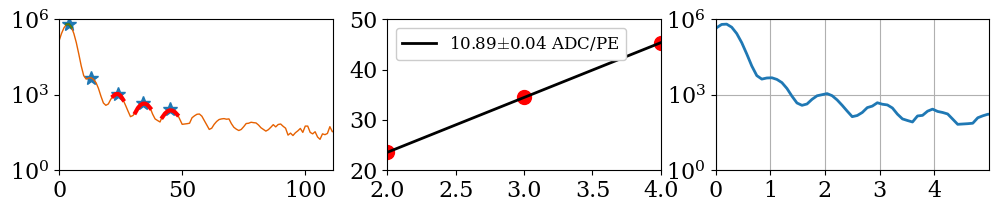

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_7.h5


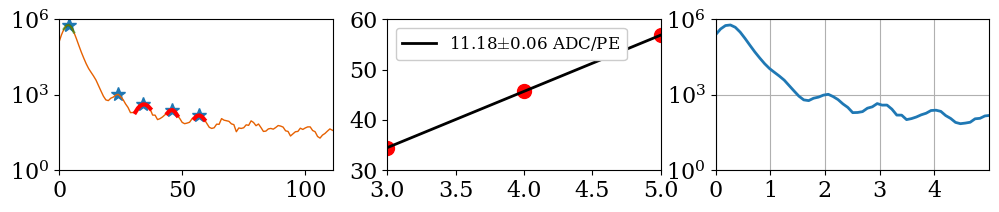

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_8.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


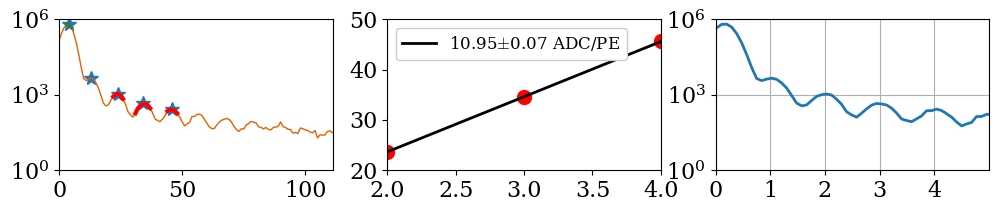

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_9.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


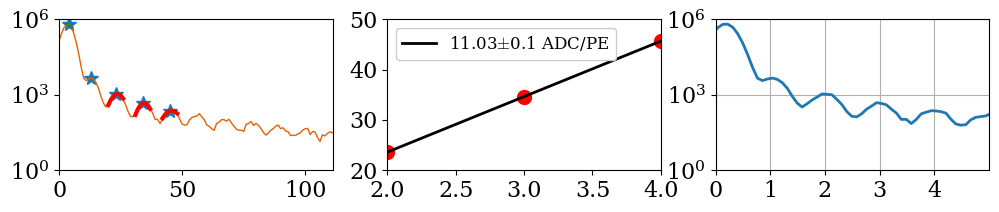

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_10.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


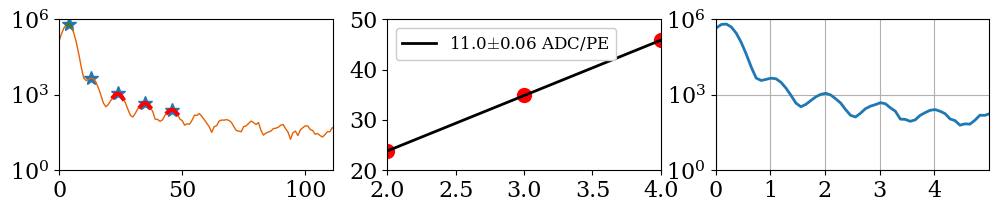

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_11.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


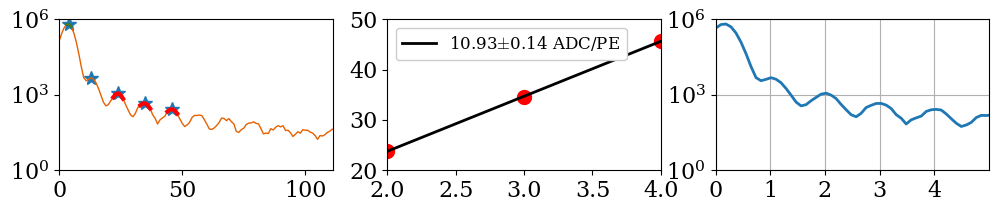

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_12.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


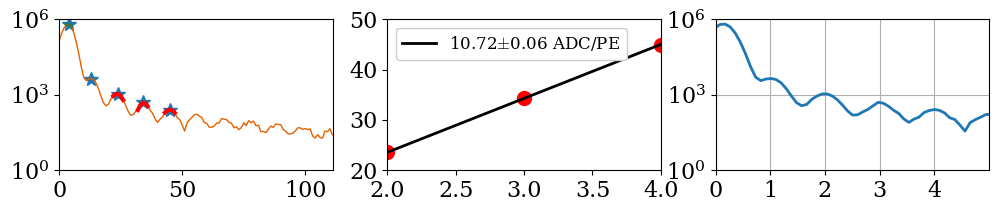

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_13.h5


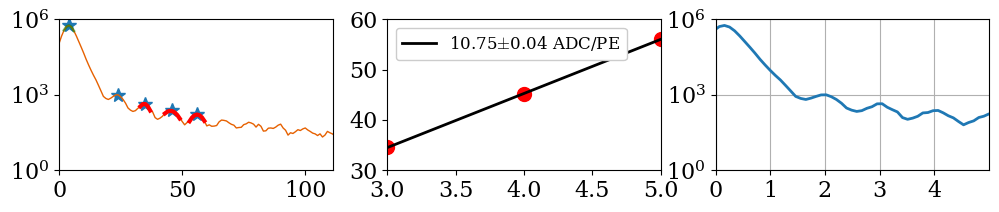

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_14.h5


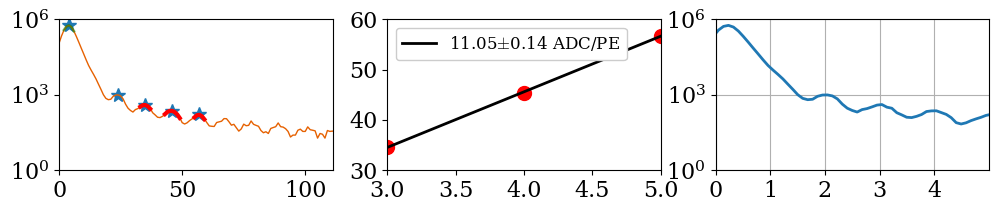

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_15.h5


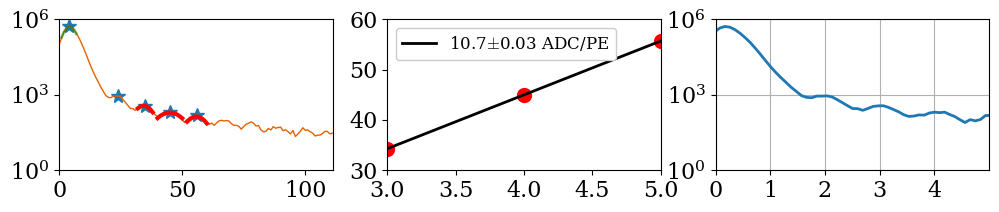

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_16.h5


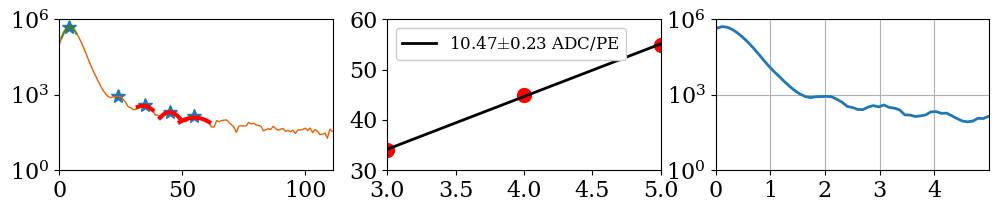

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_17.h5


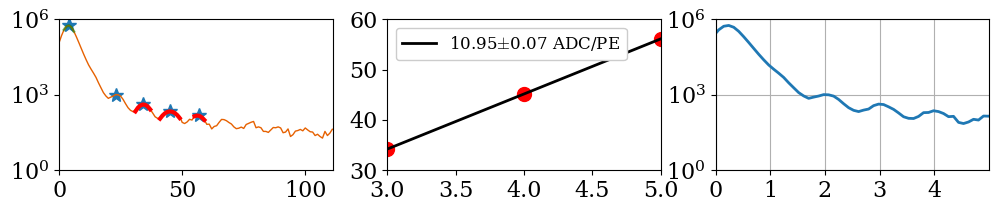

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_18.h5


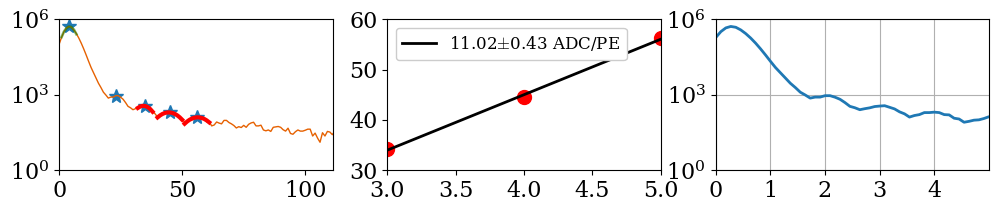

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_19.h5


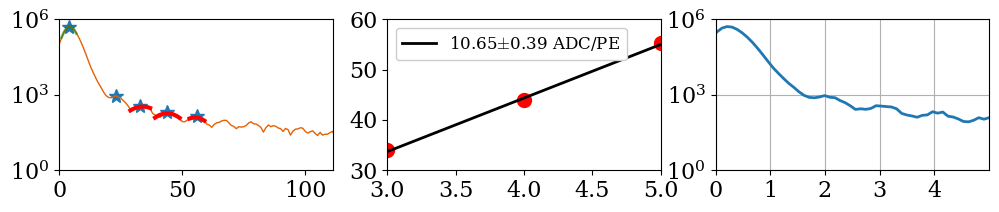

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_20.h5


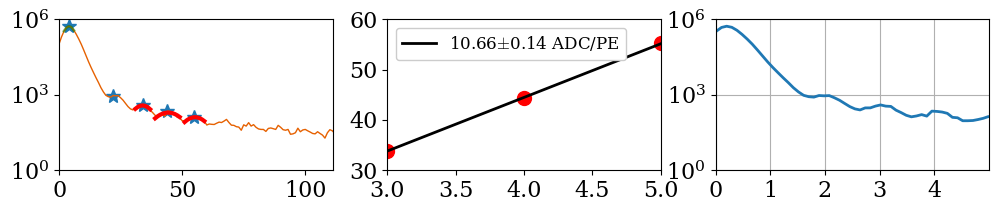

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


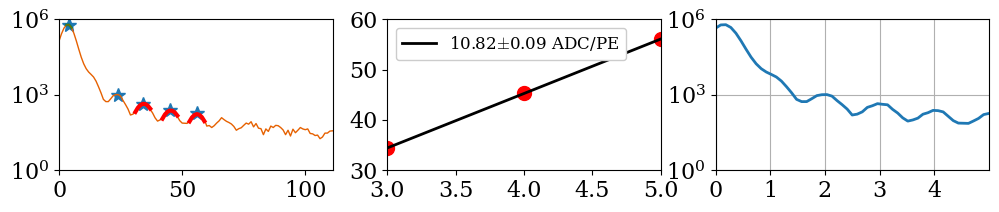

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_22.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


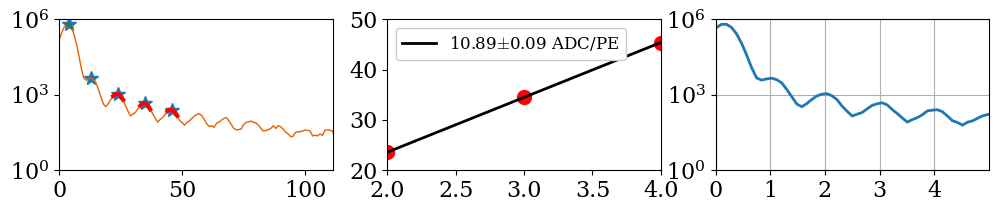

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_23.h5


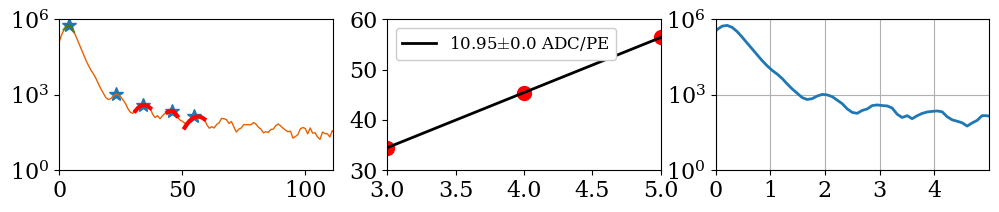

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_24.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


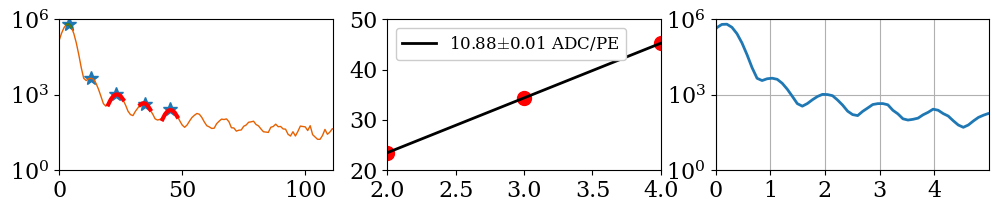

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_25.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


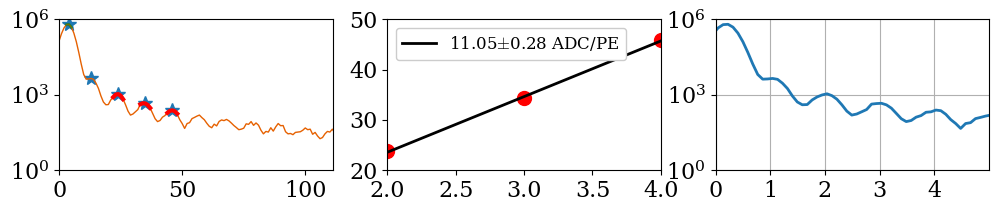

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_26.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


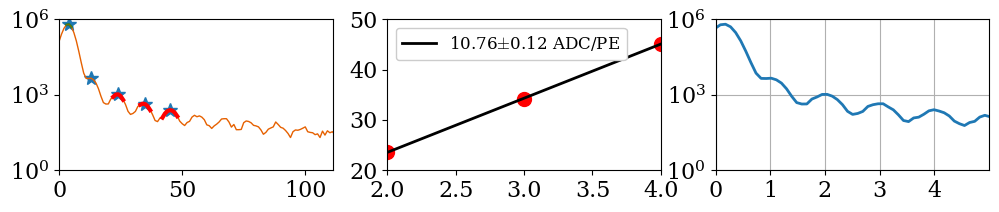

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_27.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


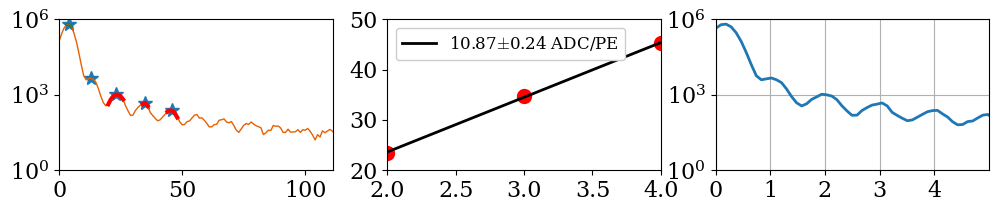

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_28.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


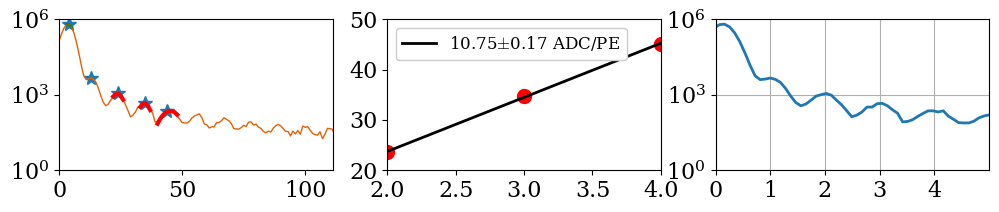

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_29.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


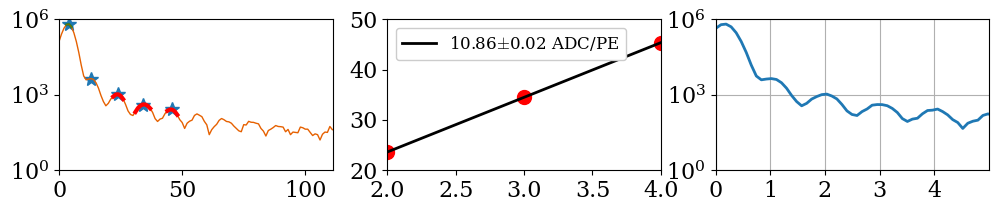

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_30.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


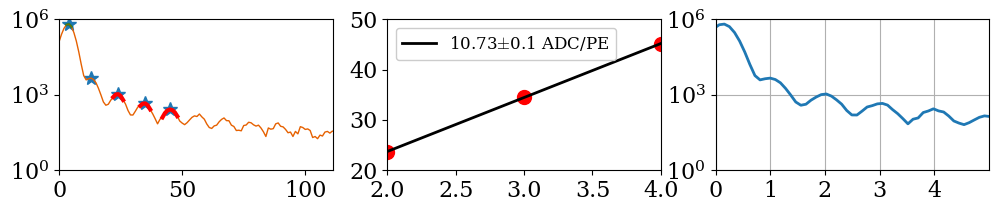

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_31.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


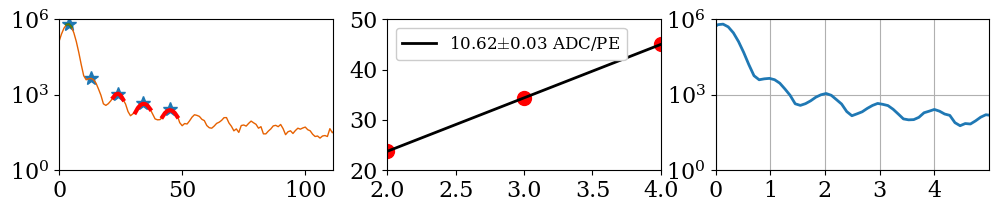

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_32.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


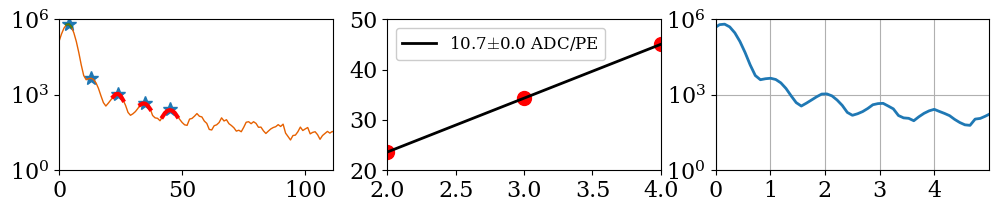

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_33.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


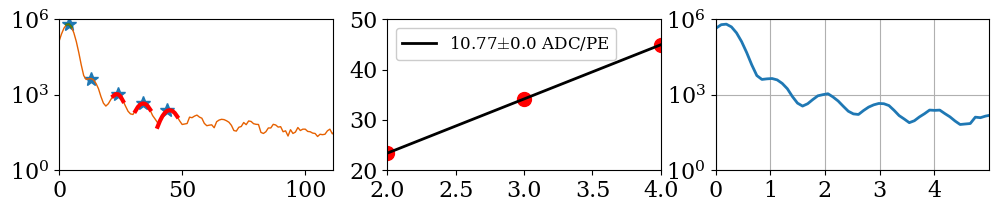

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_34.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


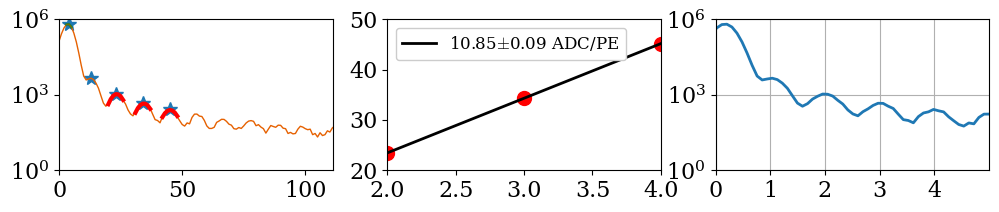

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_35.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


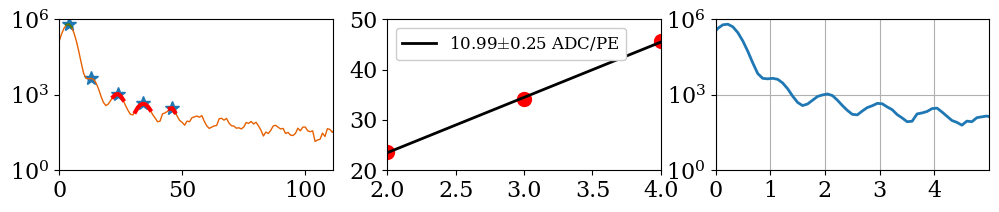

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_36.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


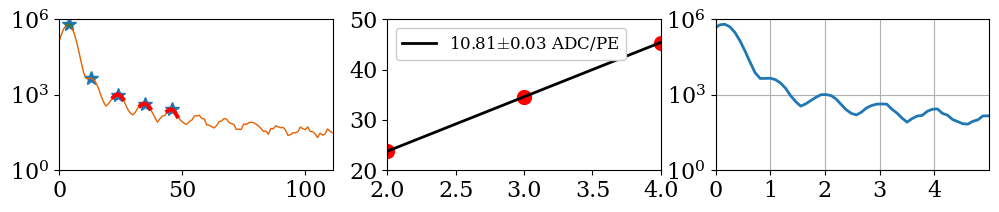

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_37.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


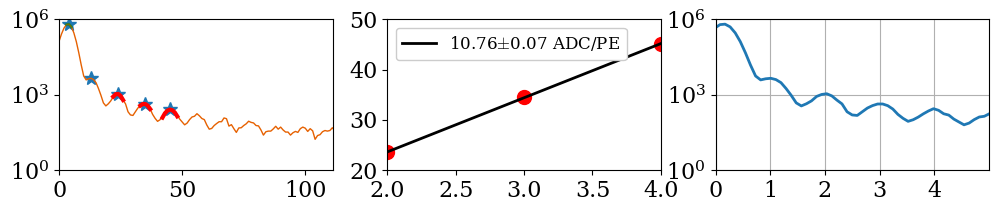

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_38.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


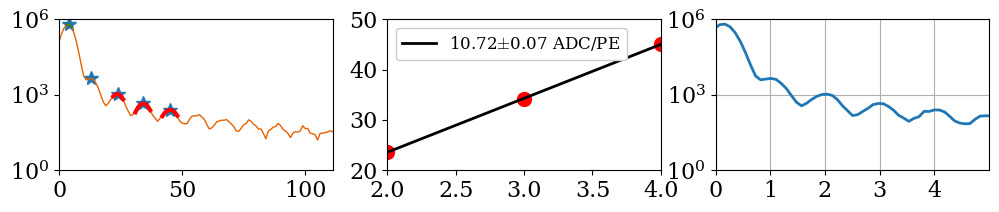

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_39.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


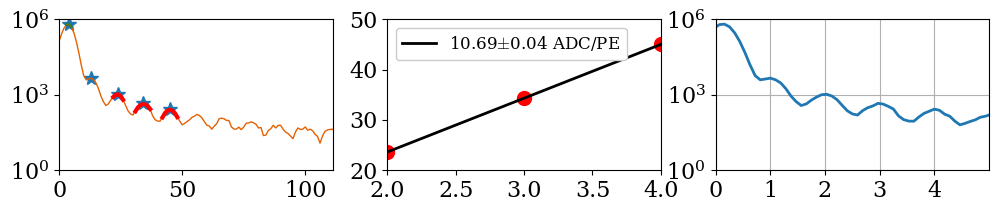

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_40.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


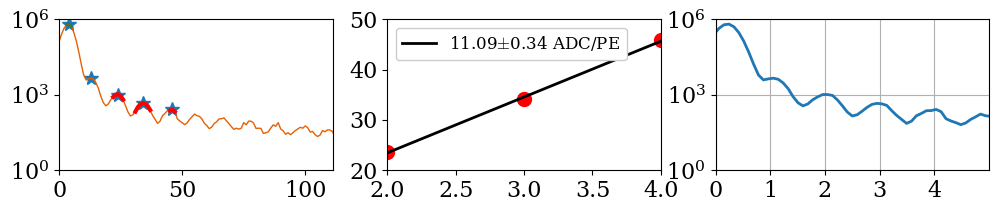

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_41.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


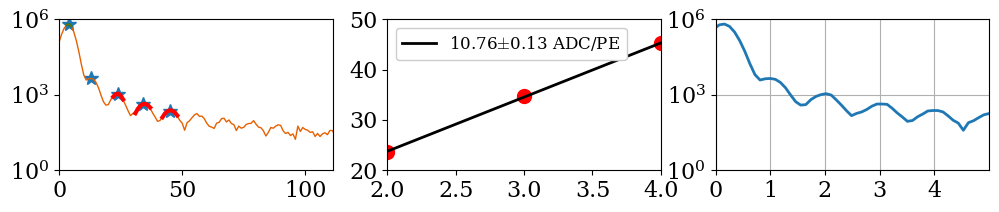

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_42.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


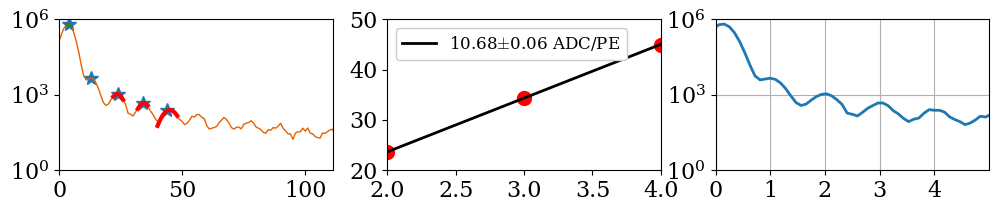

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_43.h5


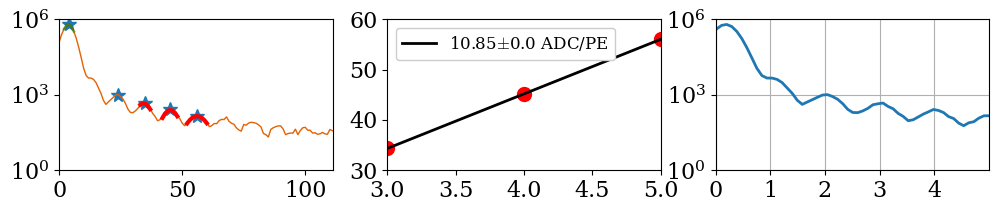

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_44.h5


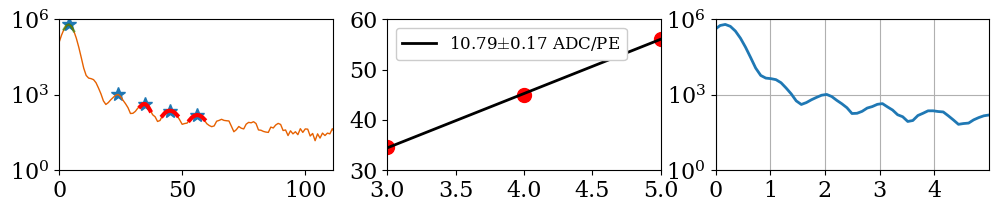

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_45.h5


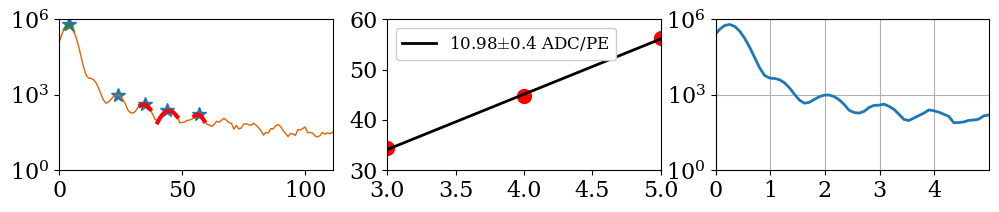

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_46.h5


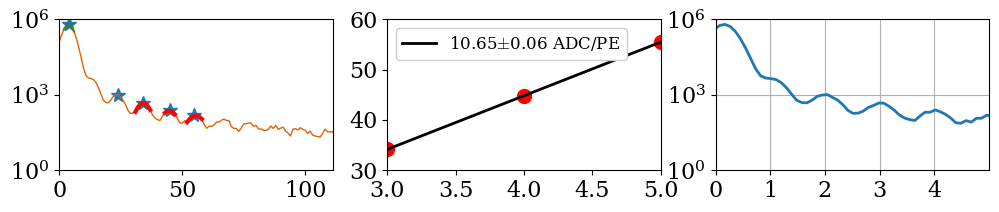

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_47.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


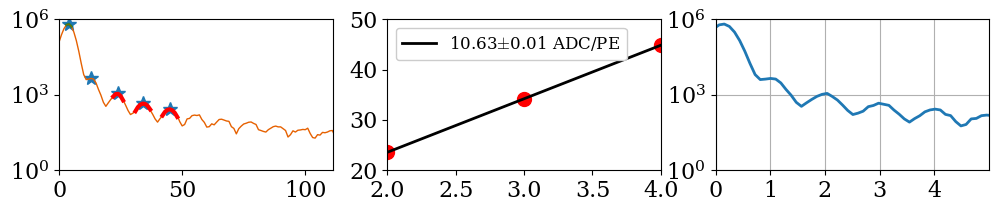

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_48.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


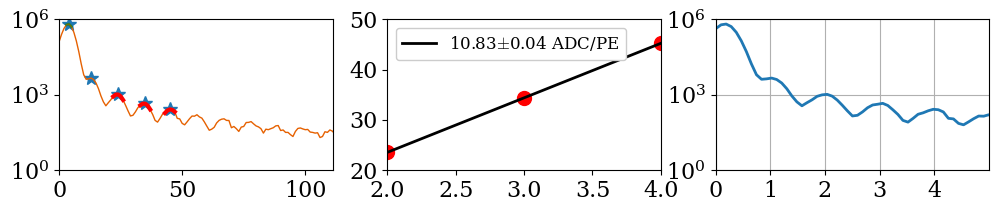

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_49.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


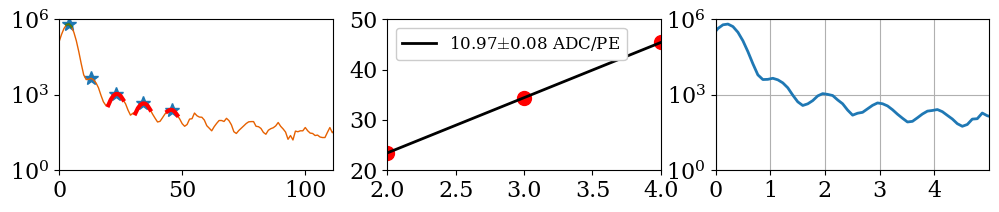

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_50.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


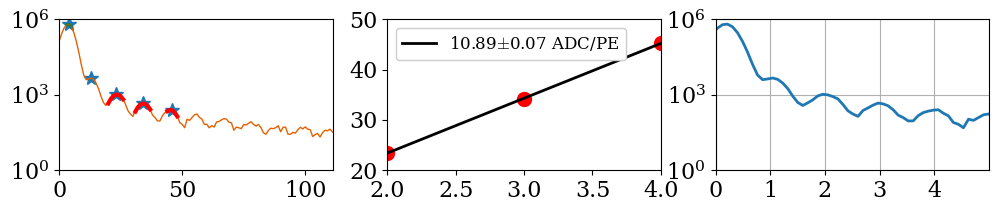

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_51.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


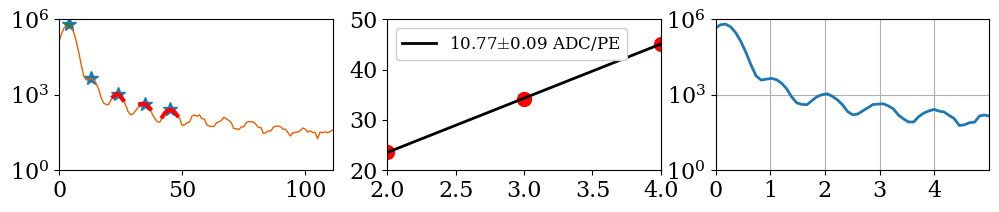

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_52.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


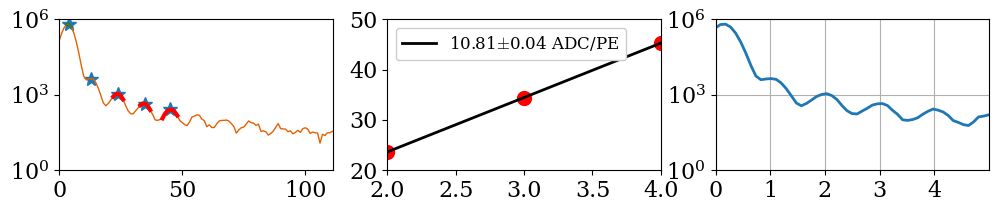

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_53.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


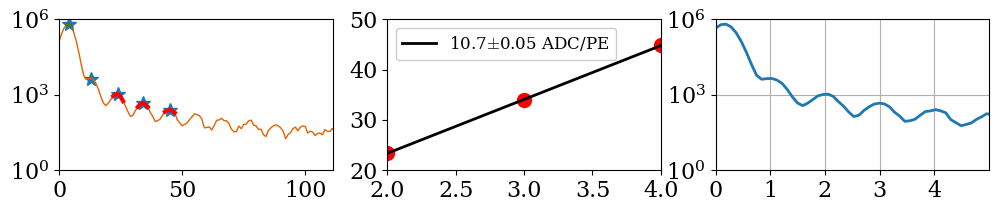

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_54.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


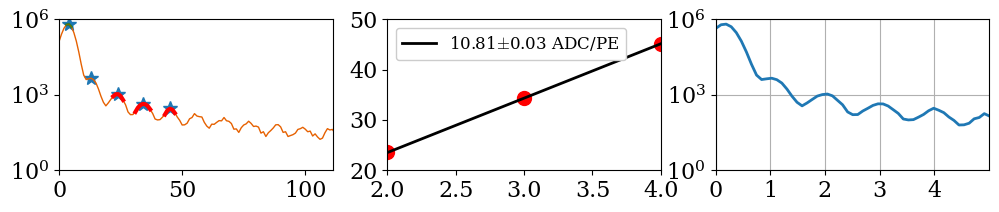

C:\Data\20220630\LXe_Full_Source_PDE\mca_keith_31.00OV_55.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


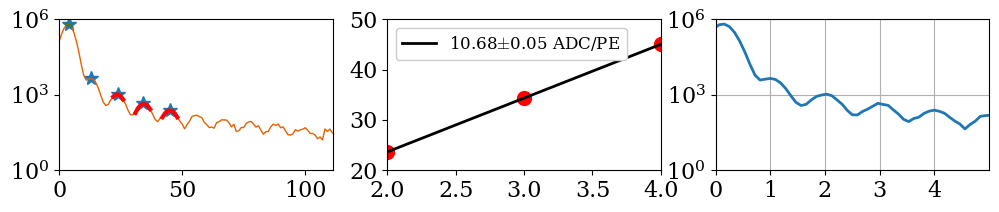

In [10]:
NO_FIELD_calib_pe,NO_FIELD_calib_count,NO_FIELD_gain_list,NO_FIELD_gain_err=gain_calculator(NO_FIELD,9,4)

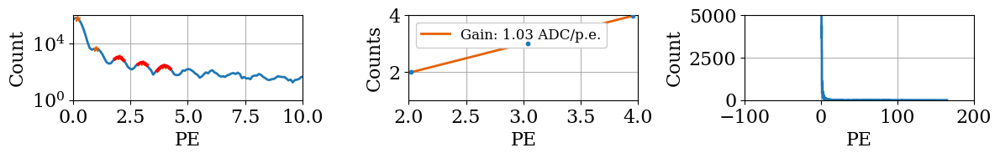

4.603524430349338e-10


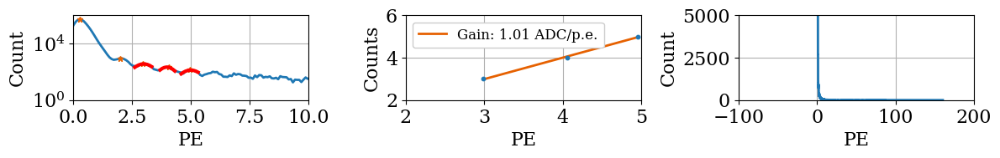

5.319363326925193e-10


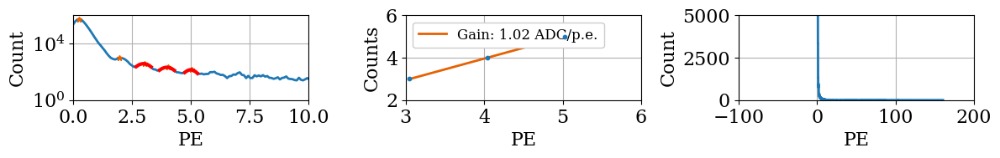

5.374512662224864e-10


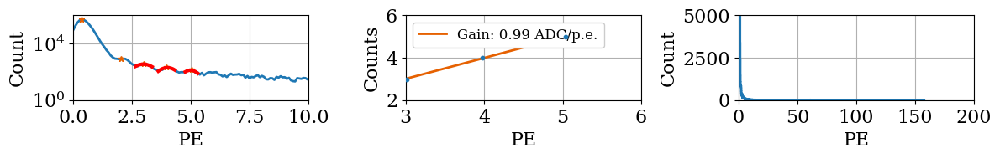

6.500339307698989e-10


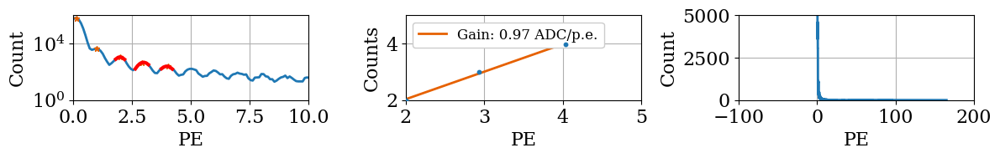

4.617155582328975e-10


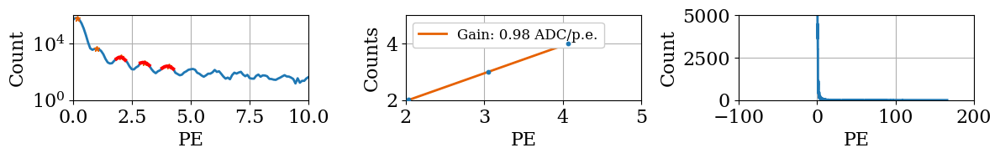

4.6166578222044e-10


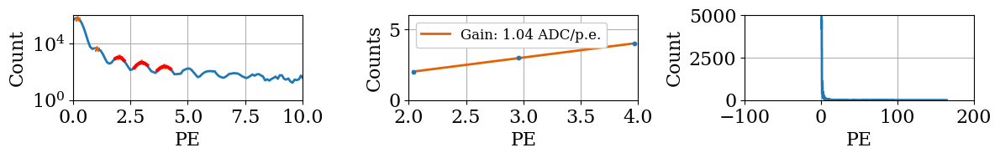

4.661613813398194e-10


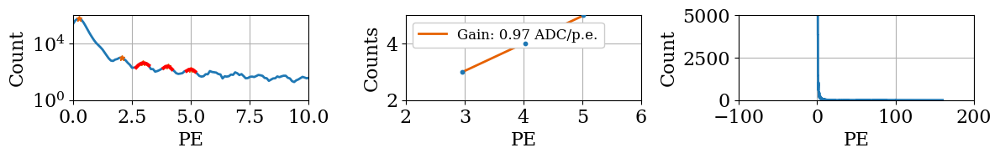

4.949182083467816e-10


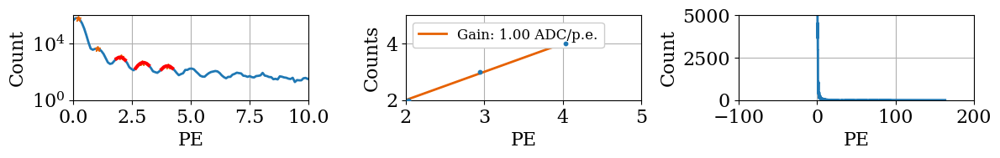

4.640757414150816e-10


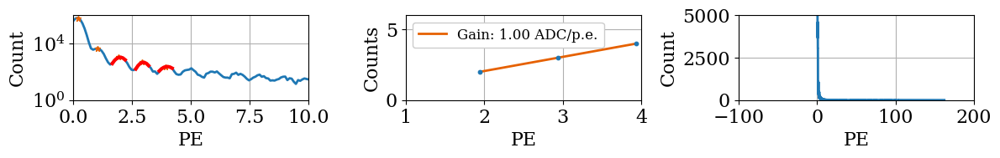

4.629226547580234e-10


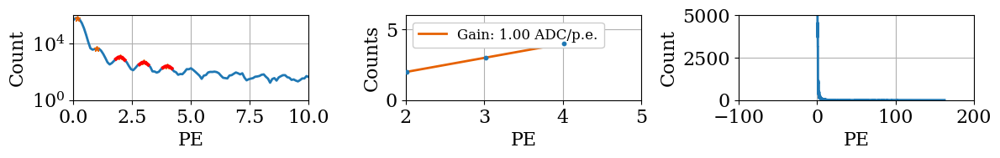

4.490643018690904e-10


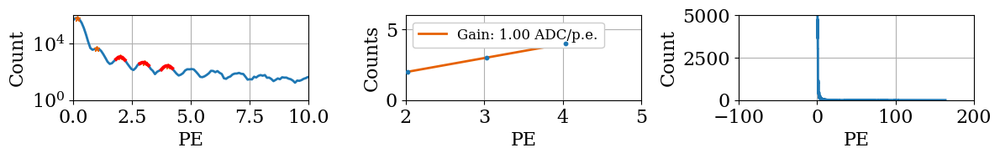

4.667351316639035e-10


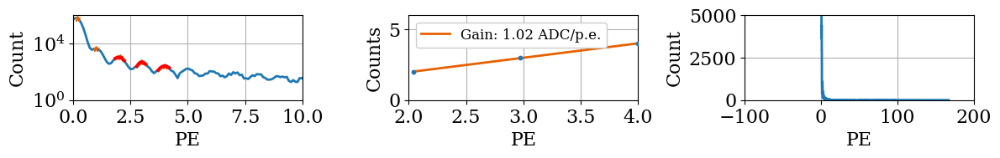

4.762864588600659e-10


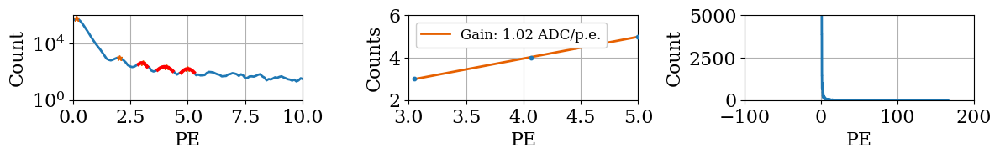

4.981857743933481e-10


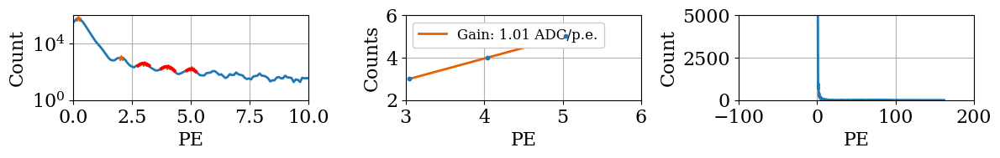

5.126069020618814e-10


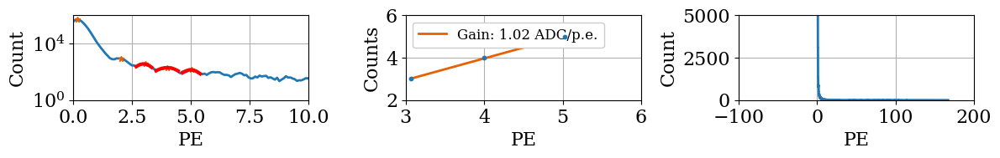

5.132242665068594e-10


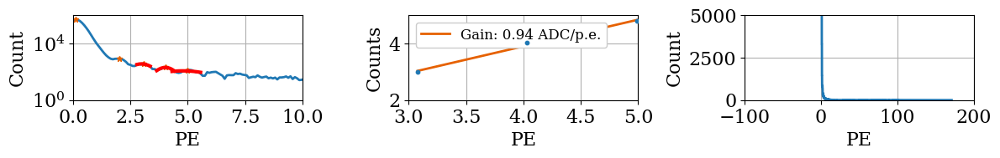

5.255332880191106e-10


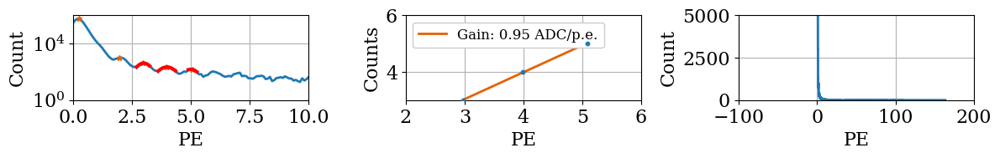

5.270716048451134e-10


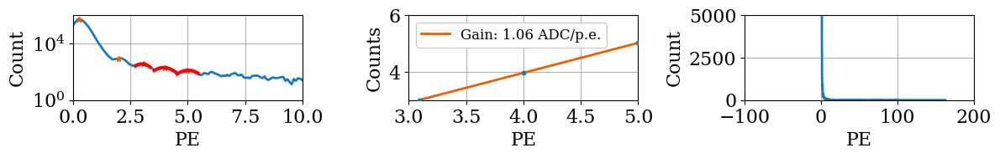

5.437476525160145e-10


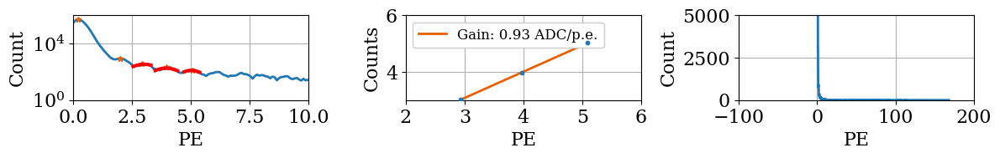

5.571207821966495e-10


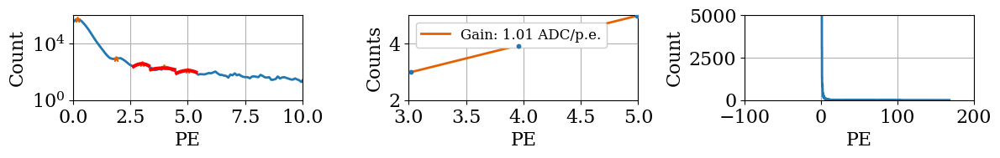

5.544270270144842e-10


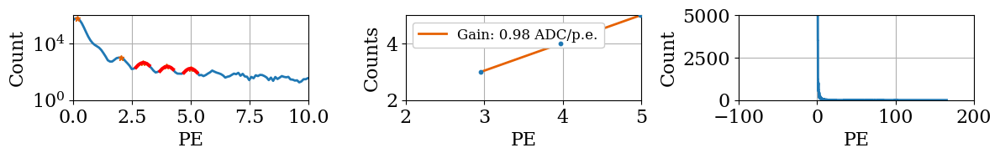

4.807883944438369e-10


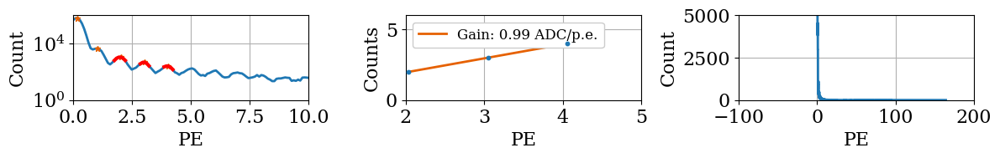

4.703698782452017e-10


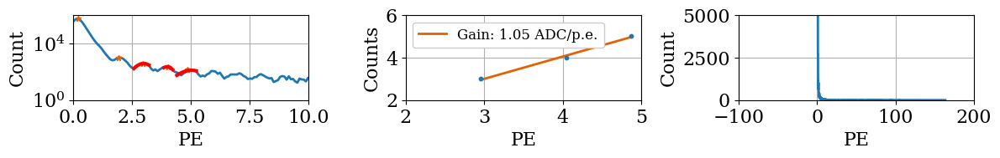

5.134053385610187e-10


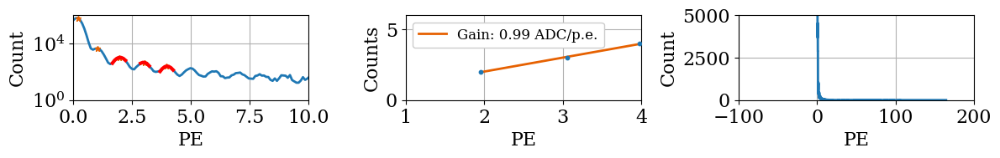

4.742835486166233e-10


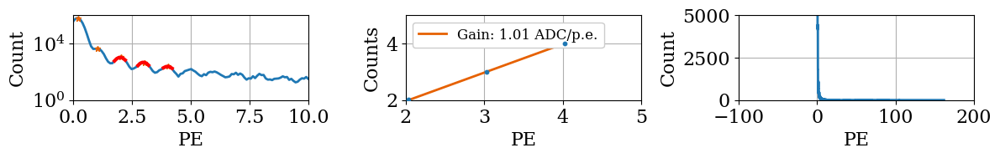

4.693114837877733e-10


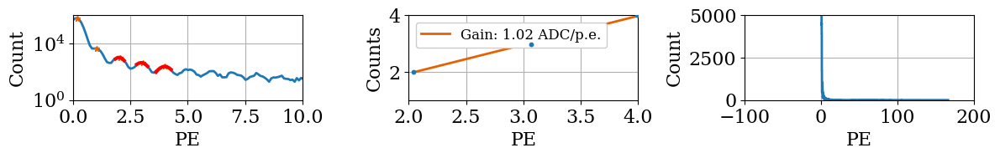

4.6333443765799776e-10


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


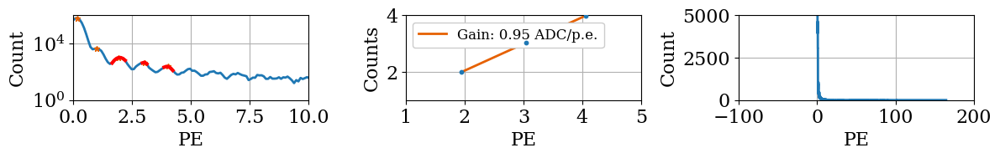

4.6504468665625047e-10


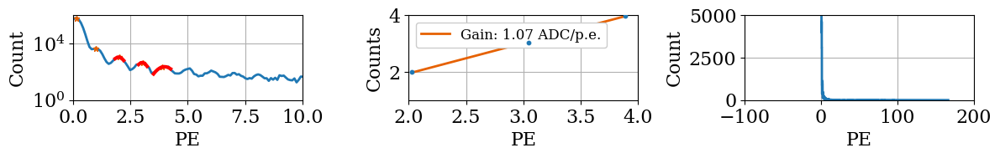

4.752365627104169e-10


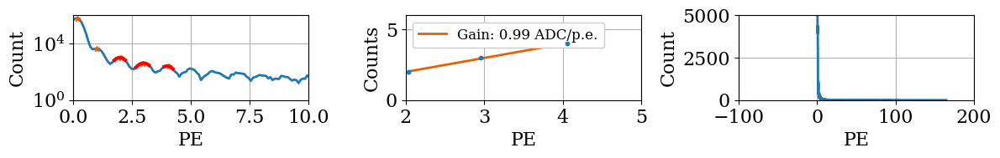

4.750772815289976e-10


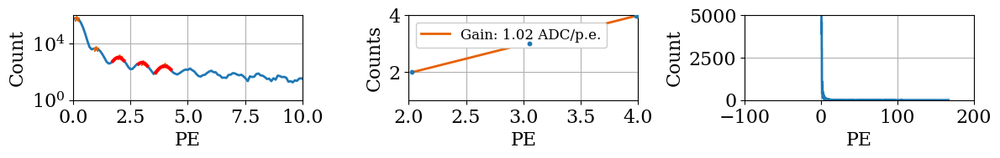

4.671302335341237e-10


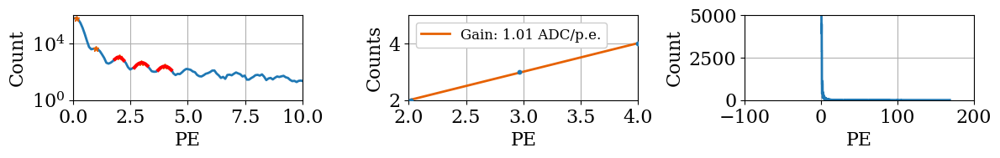

4.792458410516635e-10


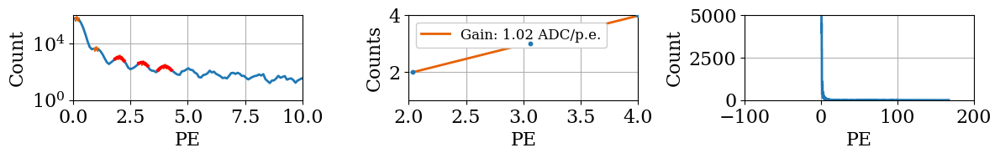

4.772320740044518e-10


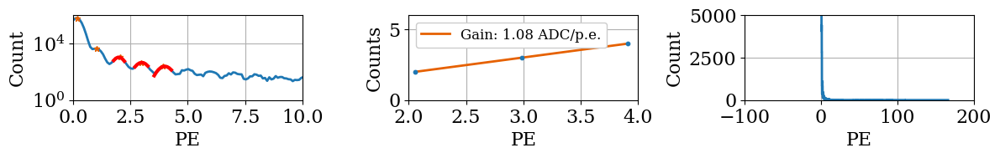

4.749128854126539e-10


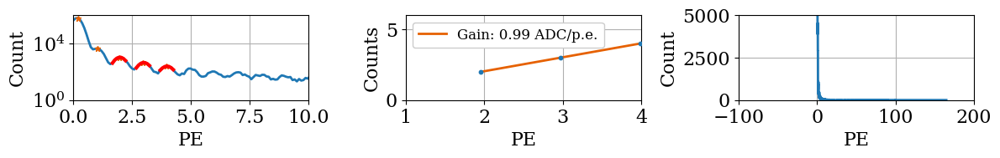

4.672327376510458e-10


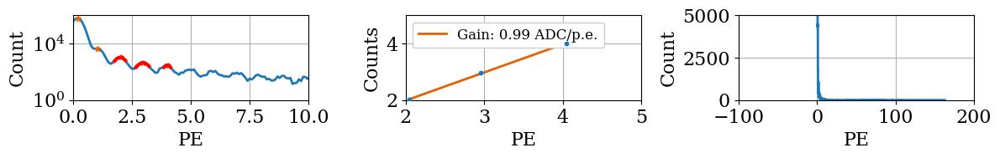

4.746025577711077e-10


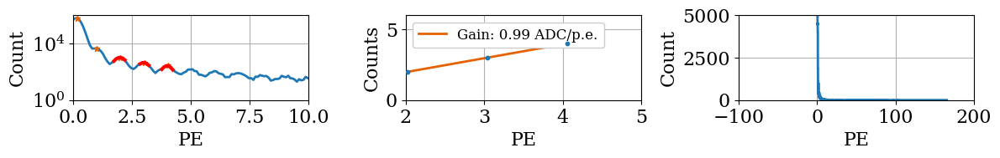

4.673098681043464e-10


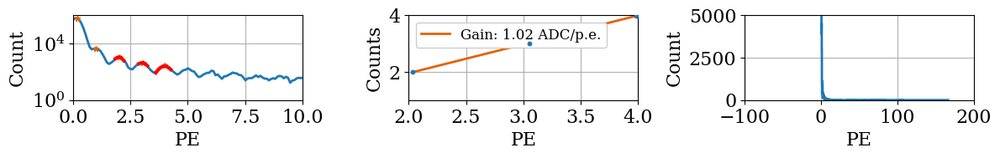

4.648030400008799e-10


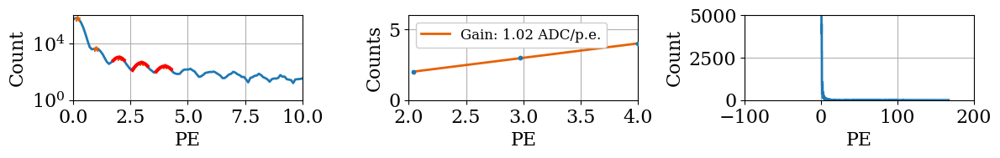

4.759969174473054e-10


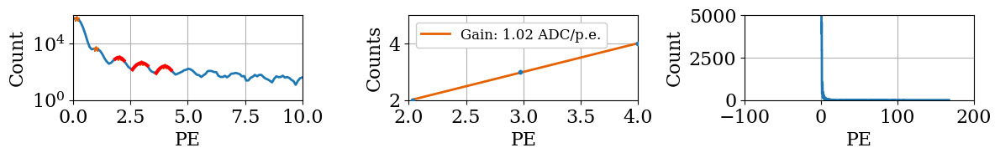

4.72611679995283e-10


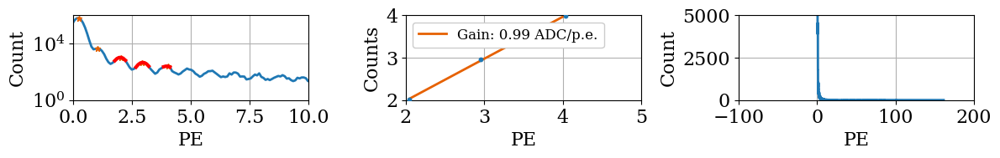

4.6550659740309974e-10


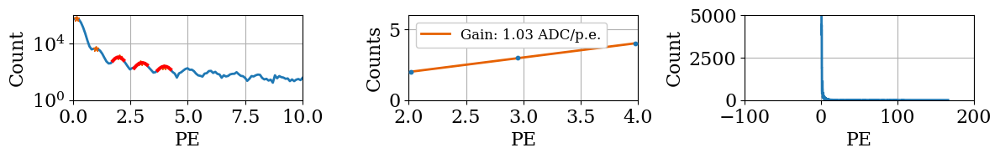

4.6483087281431074e-10


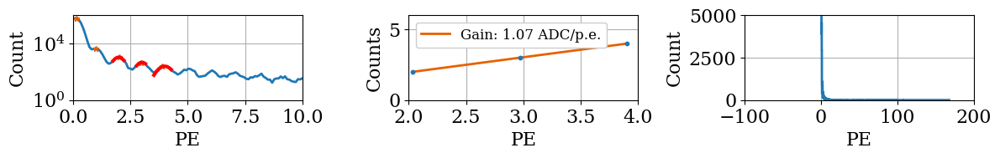

4.738332429443809e-10


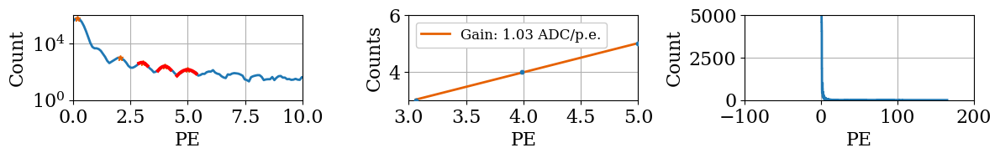

4.828050914480639e-10


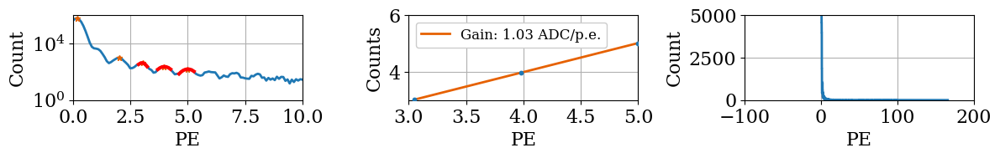

4.678261585739138e-10


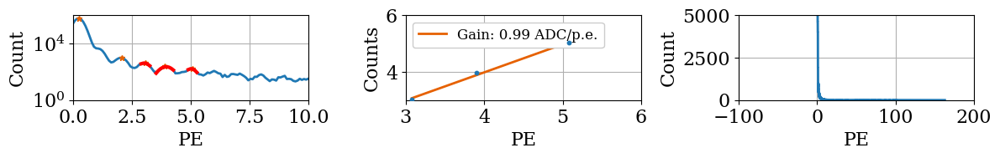

4.768870979416146e-10


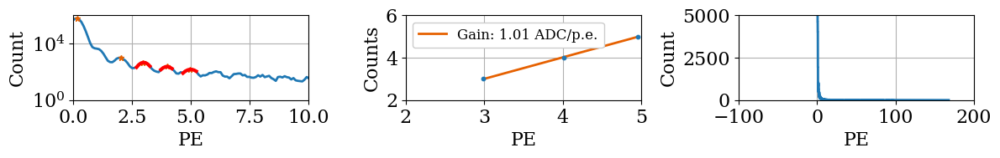

4.769614642683732e-10


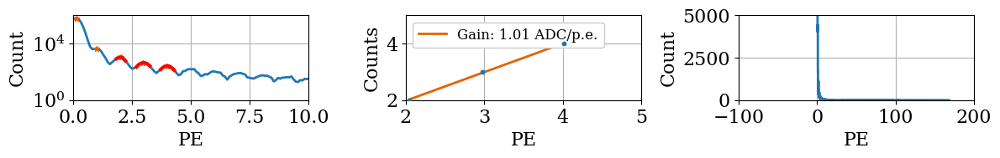

4.782574768685401e-10


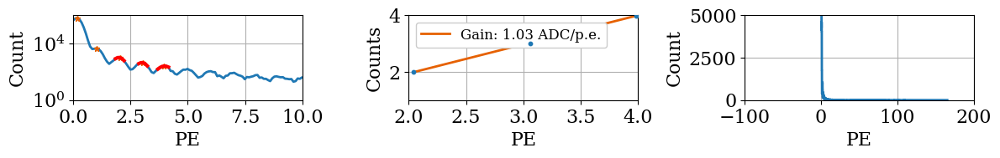

4.6443935311655376e-10


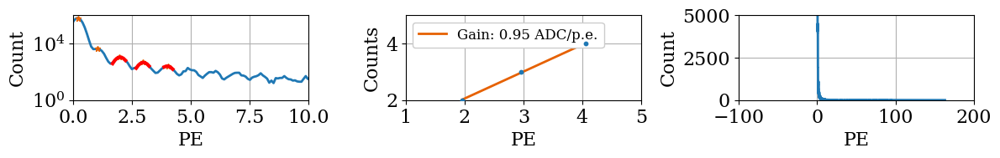

4.642297899657886e-10


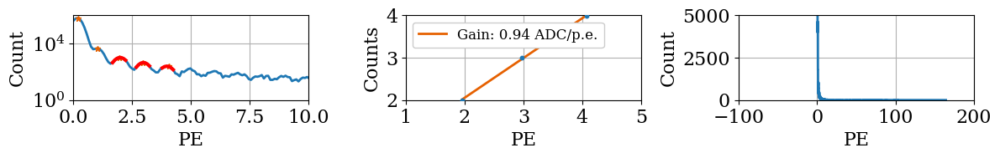

4.683402434241343e-10


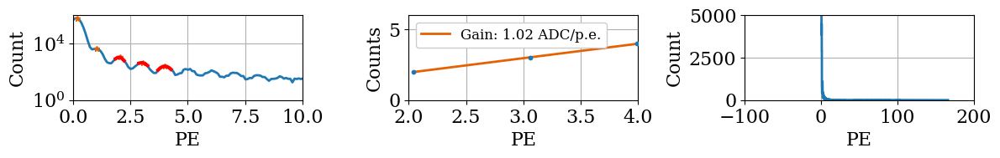

4.759044503185982e-10


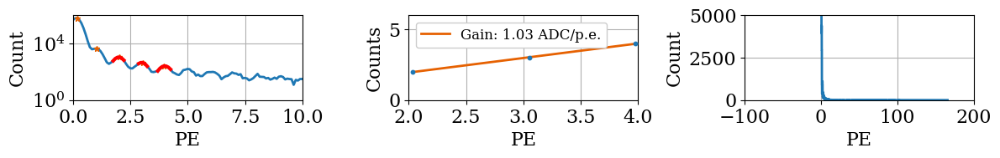

4.690906631206124e-10


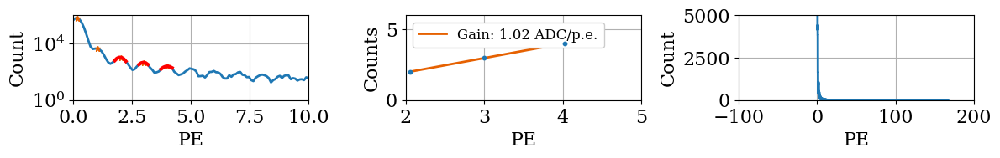

4.728132269129898e-10


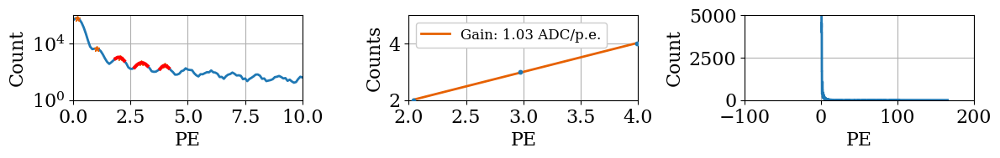

4.706017323192345e-10


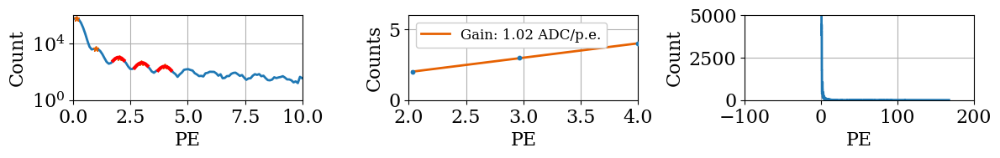

4.6029847812122494e-10


In [11]:
NO_FIELD_pe_corrected_gain=[]
NO_FIELD_pe_corrected_gain_err=[]
NO_FIELD_calib_pe_updated=[]

# looping through calibrated data that was generated by gain_calculator
for x,y in zip(NO_FIELD_calib_pe,NO_FIELD_calib_count):
    plt.figure(figsize=(12,2))
    plt.subplot(1,3,1)
    plt.plot(x,y)
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    
    ####### It looks like the code is refitting the peaks that we just fit? idk why
    ####### I think that we already have that info from the gain calcuator
    
    N_peaks=4
    PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
    peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
    peak_length=len(peaks)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
    while (peak_length<N_peaks+1):
        PROMINENCE=PROMINENCE-1
            
        peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
        peak_length=len(peaks)


        
    plt.plot(x[peaks],y[peaks],'*',ms=5) # plot the peak markers
    first_pe_max=x[peaks[2]] # The x-value of the 3rd peak.Index=1 means the second peak will be used for getting fit parameters
    max_value=y[peaks[2]] # The height of the 3rd peak
    x_idx_array=(y<0.5*max_value) & (x>first_pe_max)# returns a boolean array where both conditions are true
    right_side_x= x[np.where(x_idx_array)[0][0]] #finding the first time where x_idx_array is True
    sigma_guess=np.abs(first_pe_max-right_side_x) #We need this to fit the width of the Gaussian peaks
    cut= (x < first_pe_max+sigma_guess) & (x > first_pe_max-sigma_guess) # This cut helps to fix the width of the peak-fit
    popt,pcov=curve_fit(gauss,x[cut],y[cut],p0=[max_value,first_pe_max,sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
    plt.plot(x[cut],gauss(x[cut],*popt),color='r',label='Fit',lw=2) # Here we plot the fit on the 2nd peak to see if everything looks ok.
    
    params_pe = []
    params_pe_count=[]
    for i,peak in enumerate(peaks[2:]): #here we ignore the first peak because it could be the pedestal
        new_first_pe_max=x[peak] #x-value of the peak
        new_max_value=y[peak] #height of the peak
        new_x_idx_array=(y<0.5*new_max_value) & (x>new_first_pe_max) # returns a boolean array where both conditions are true
        new_right_side_x= x[np.where(new_x_idx_array)[0][0]] #finding the first time where x_idx_array is True
        new_sigma_guess=np.abs(new_first_pe_max-new_right_side_x) #We need this to fit the width of the Gaussian peaks


        new_cut= (x < new_first_pe_max+new_sigma_guess) & (x > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
        popt_new,pcov_new=curve_fit(gauss,x[new_cut],y[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
        plt.plot(x[new_cut],gauss(x[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
        params_pe.append(popt_new[1]) #Here we append the value of the peak fit mean 
        params_pe_count.append((x[peak]))
        
    ###### I think everything above here is redundant and that we do all this in gain_calculator

    plt.subplot(1,3,2) 
    
    plt.scatter(params_pe_count, np.array(params_pe), s=10, zorder=10)
    popt_line,pcov_line = curve_fit(line, params_pe_count, np.array(params_pe), p0=[10,0])
    plt.plot(params_pe_count, line(params_pe_count, *popt_line), color=colors[1], label='Gain: {:.2f} ADC/p.e.'.format(popt_line[0]))
    NO_FIELD_pe_corrected_gain.append(popt_line[0])
    NO_FIELD_pe_corrected_gain_err.append(np.sqrt(np.diag(pcov_line)[0]))
    plt.legend(loc=2)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Counts')



    plt.subplot(1,3,3) # I think that this is just a zoomed out version of the data
    NO_FIELD_calib_pe_updated.append(x/popt_line[0])
    plt.step(x,y)
    # plt.yscale('log')
    # plt.xlim(0.75,10)
    plt.ylim(0,5000)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    # print(x,y)



    plt.tight_layout()
    plt.show()


    value=0
    for i,val in enumerate(x):
        if x[i]>0.75:
            # print(i,x[i],y[i])
            value+=x[i]*y[i]
    n_electrons=value*9*((104.83*31)+26.44)
    charge=n_electrons*1.6*10E-19
    current=charge/60
    print(current)


### I think that we can combine the two above cells by just adding a fourth column so doing original peak fits, BV fit, calibrated data showing low PEs, and zoomed out calibrated data

### Not sure what ADC means, so I am confused what is being plotted here

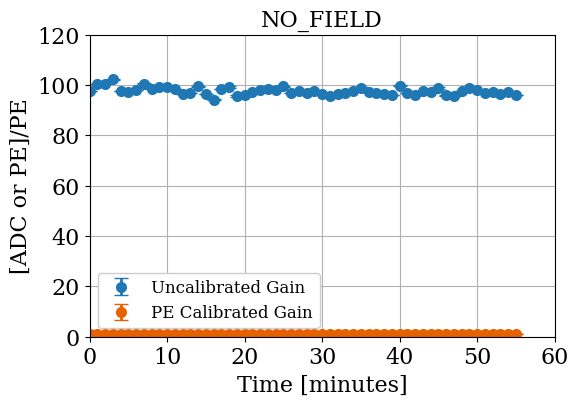

In [12]:
plt.figure(figsize=(6,4))
time_NO_FIELD=np.arange(0,len(NO_FIELD_calib_pe))
plt.errorbar(time_NO_FIELD,NO_FIELD_gain_list*9,yerr=NO_FIELD_gain_err,fmt='o',ms=7,label='Uncalibrated Gain')
plt.errorbar(time_NO_FIELD,NO_FIELD_pe_corrected_gain,yerr=NO_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time [minutes]')
plt.title('NO_FIELD')
plt.grid()
plt.legend(loc='best')
plt.savefig('NO_FIELD_gain_comparison.pdf')
plt.show()

### Doing the same here for the positive E field

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_0.h5


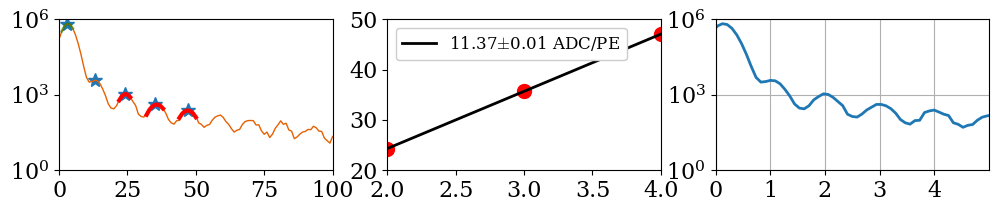

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_1.h5


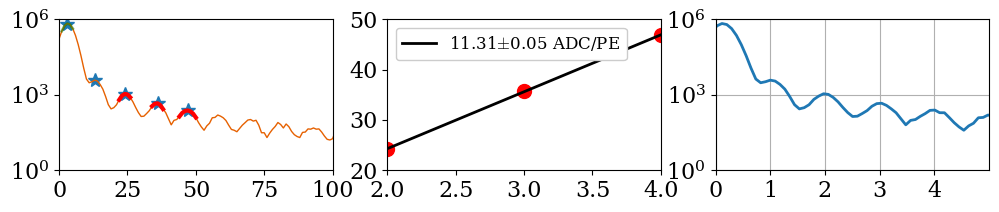

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_2.h5


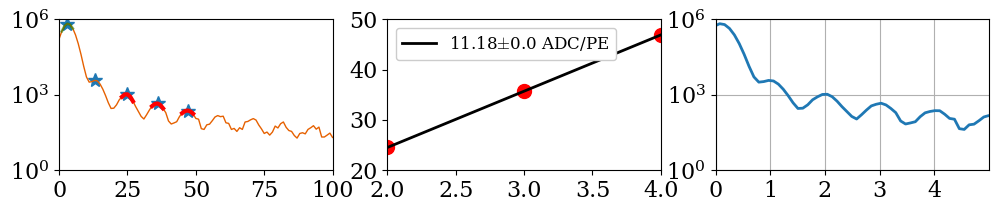

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_3.h5


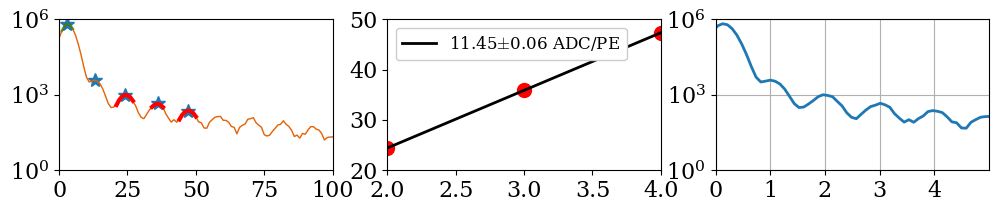

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_4.h5


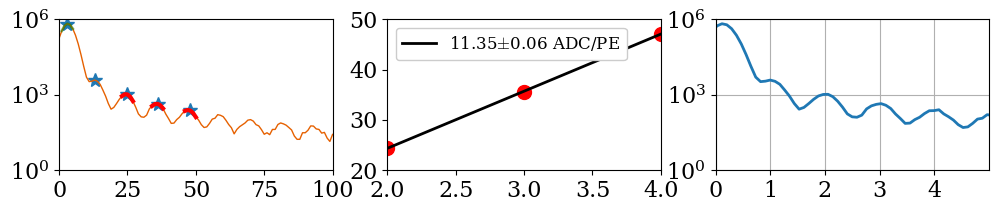

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_5.h5


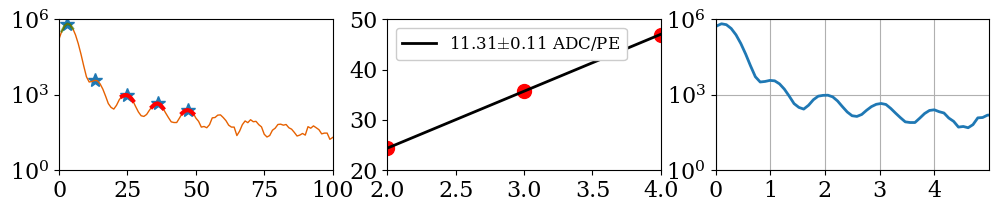

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_6.h5


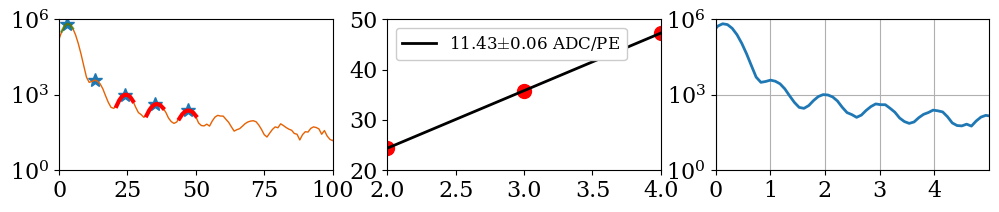

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_7.h5


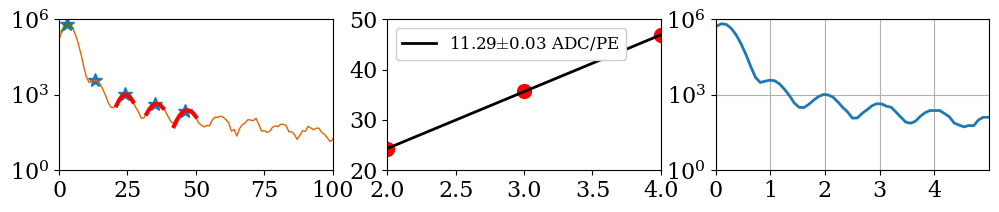

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_8.h5


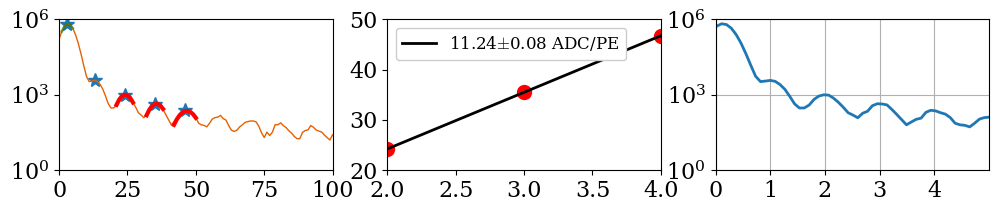

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_9.h5


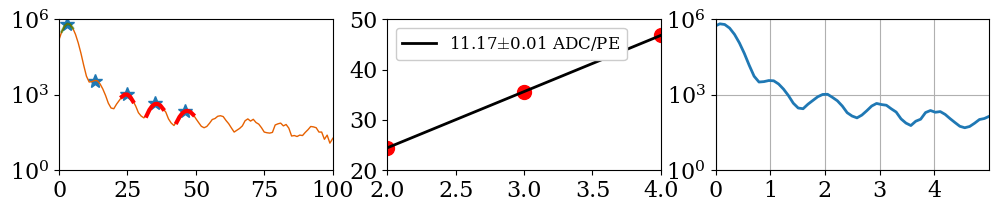

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_10.h5


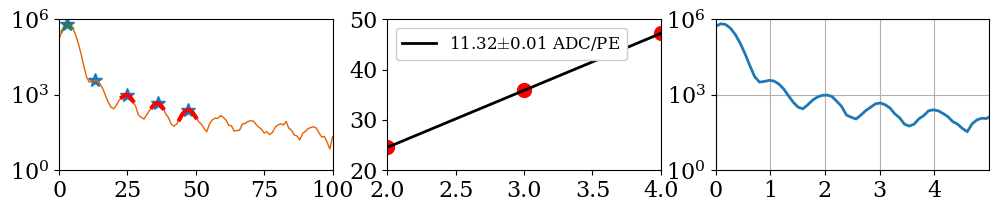

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_11.h5


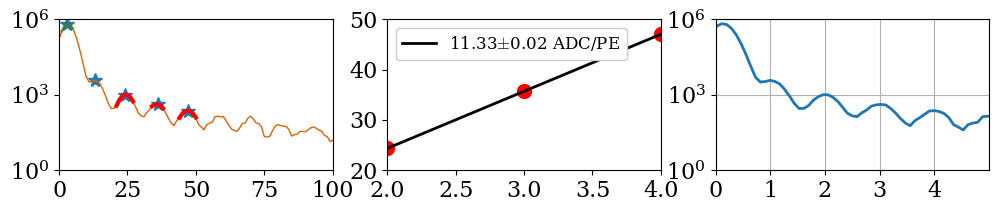

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_12.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


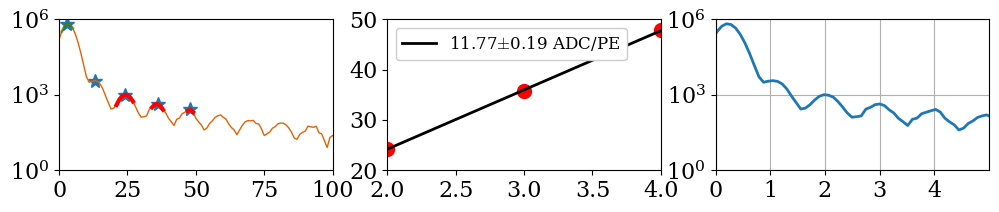

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_13.h5


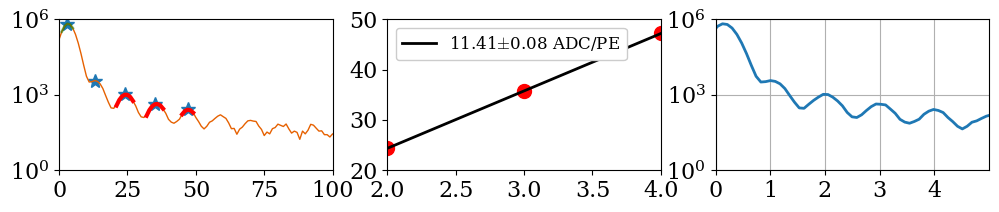

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_14.h5


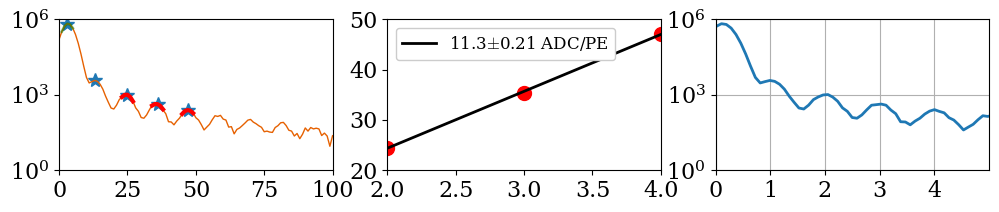

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_15.h5


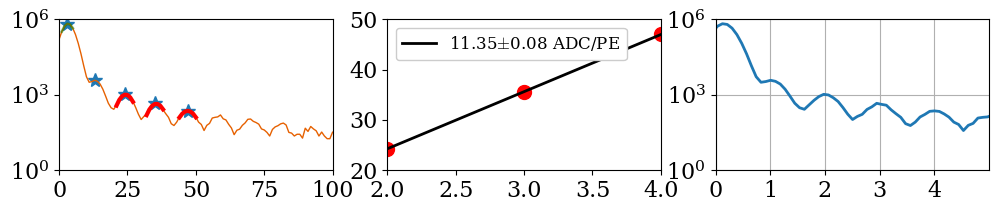

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_16.h5


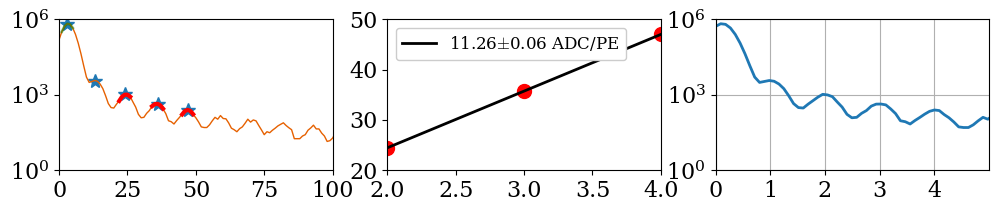

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_17.h5


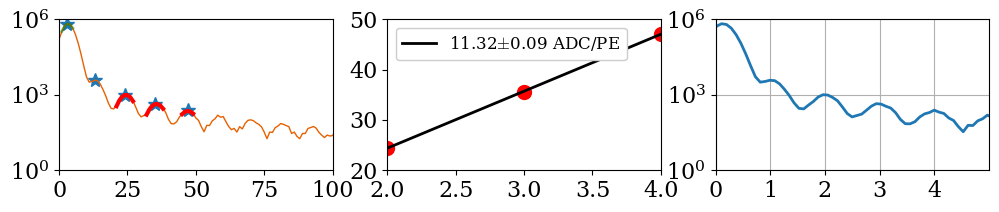

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_18.h5


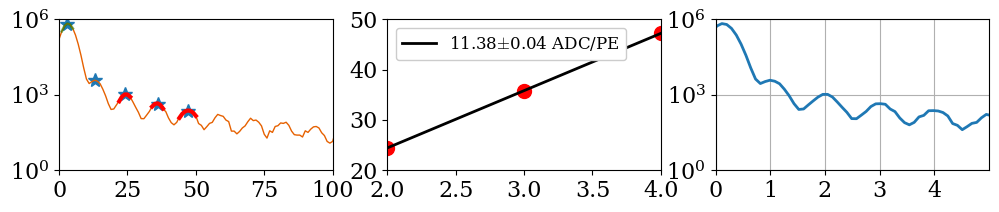

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_19.h5


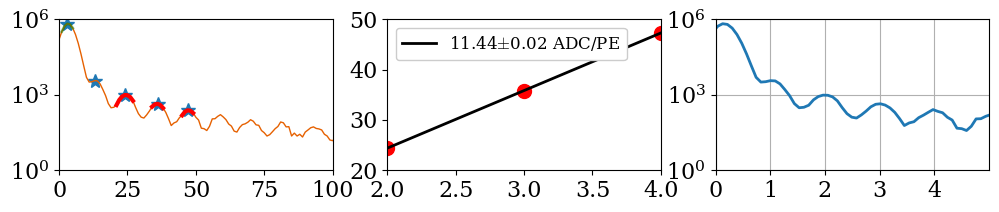

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_20.h5


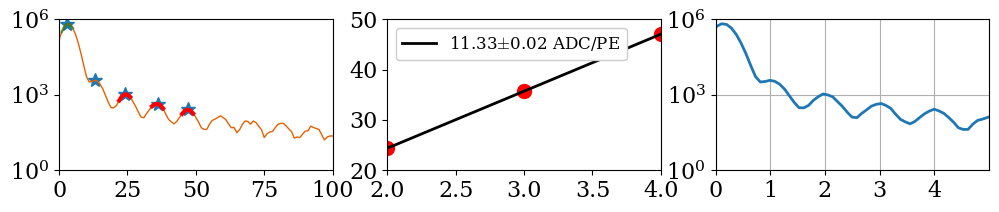

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


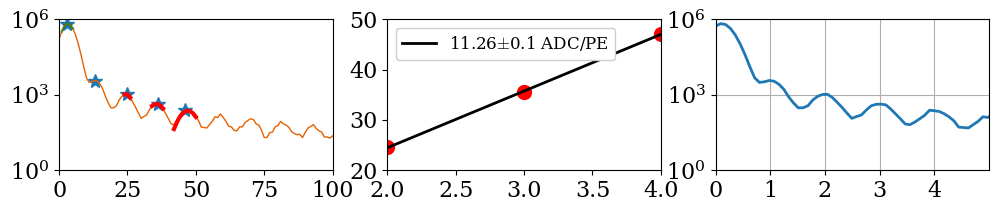

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_22.h5


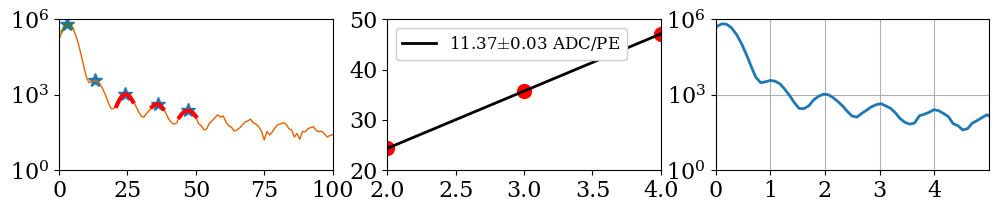

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_23.h5


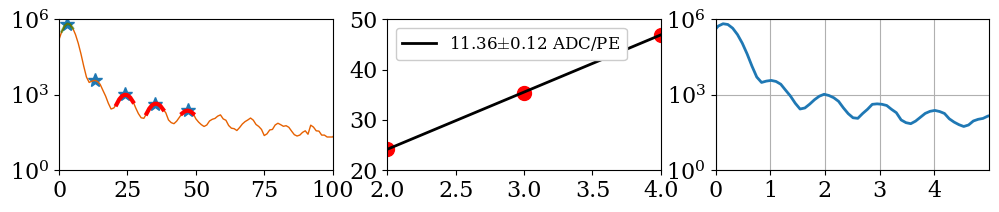

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_24.h5


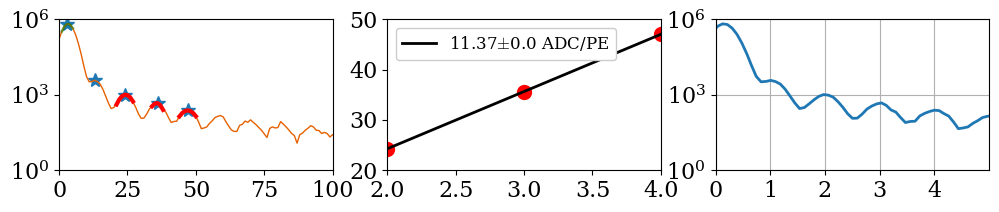

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_25.h5


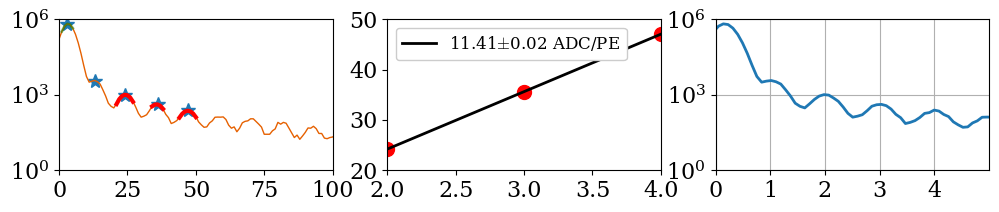

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_26.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


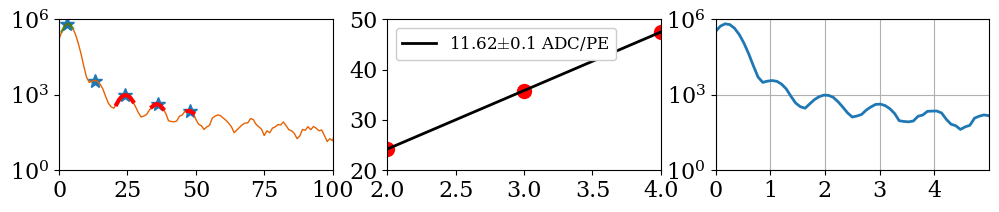

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_27.h5


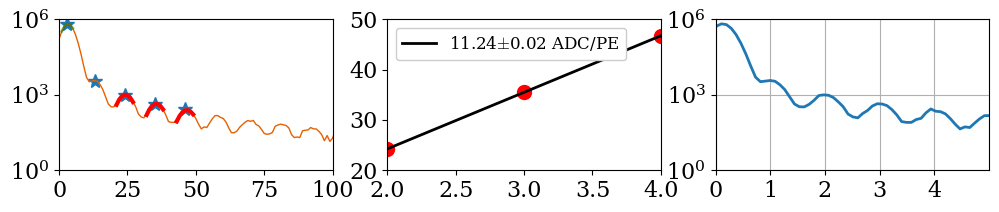

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_28.h5


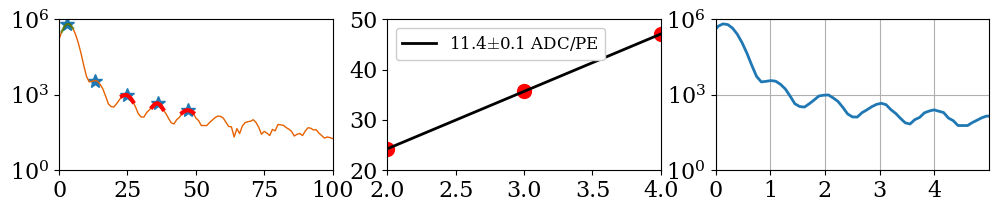

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_29.h5


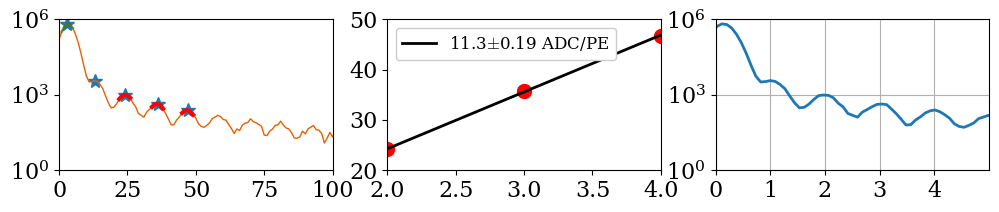

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_30.h5


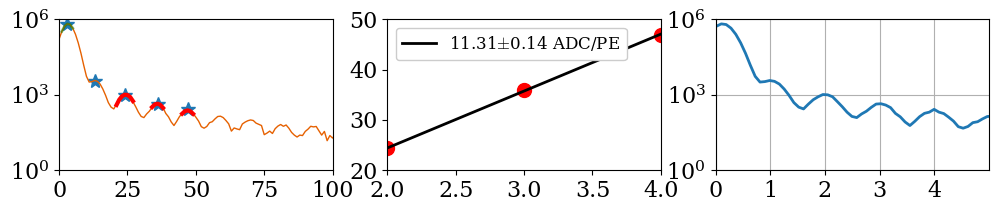

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_31.h5


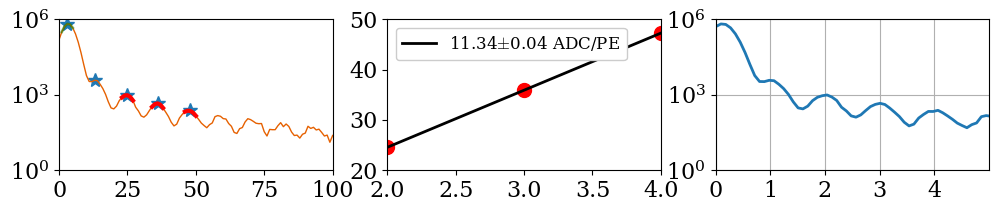

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_32.h5


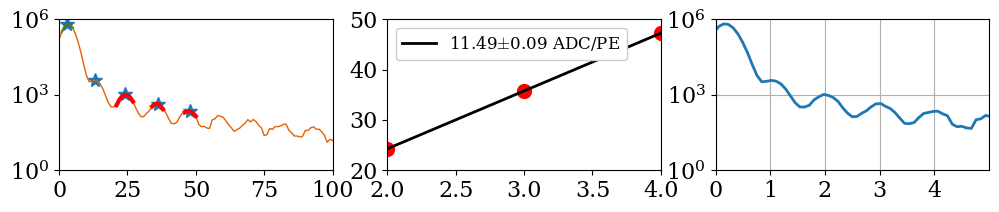

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_33.h5


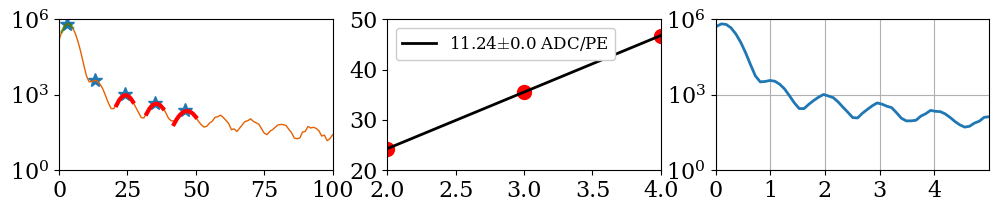

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_34.h5


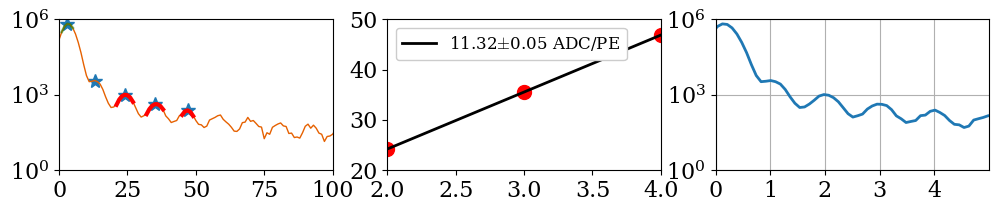

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_35.h5


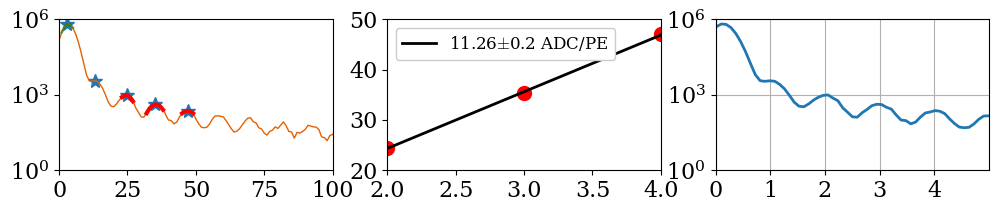

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_36.h5


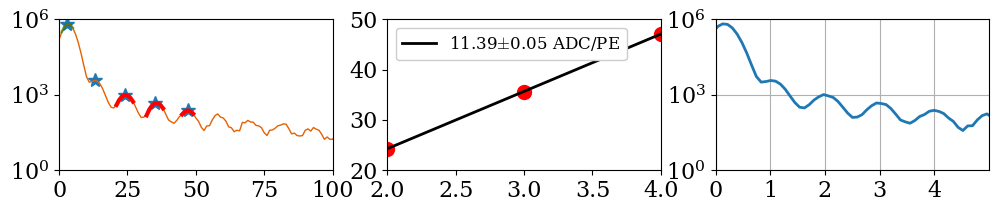

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_37.h5


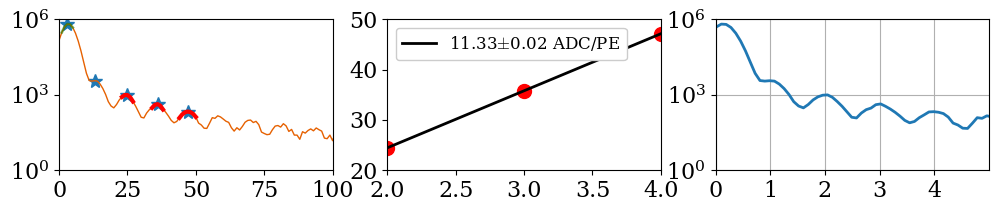

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_38.h5


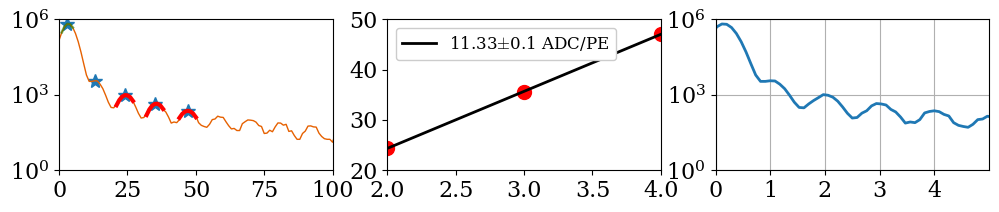

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_39.h5


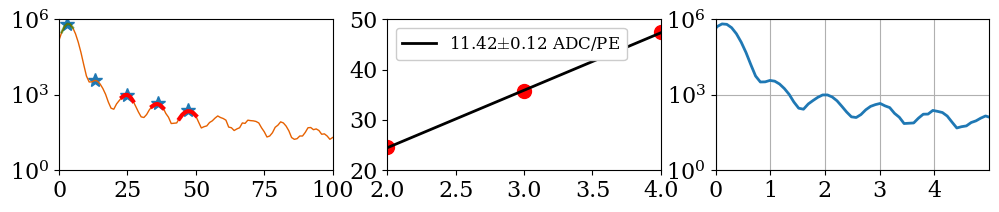

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_40.h5


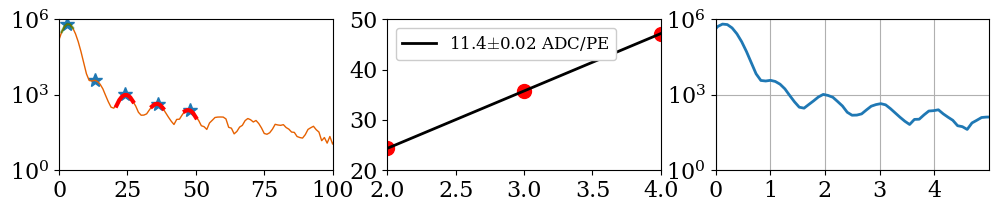

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_41.h5


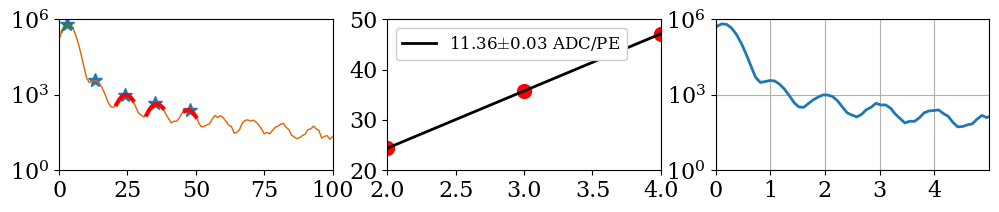

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_42.h5


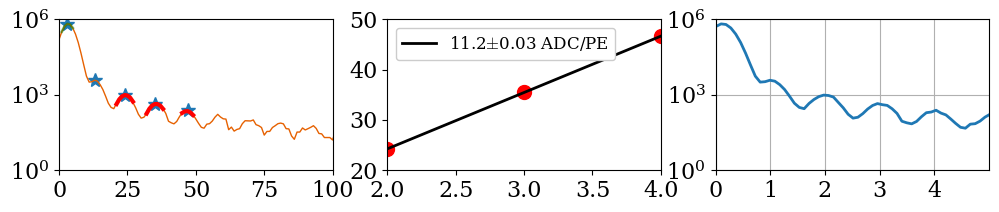

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_43.h5


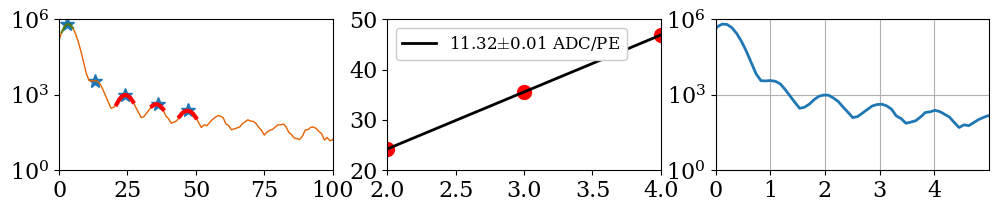

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_44.h5


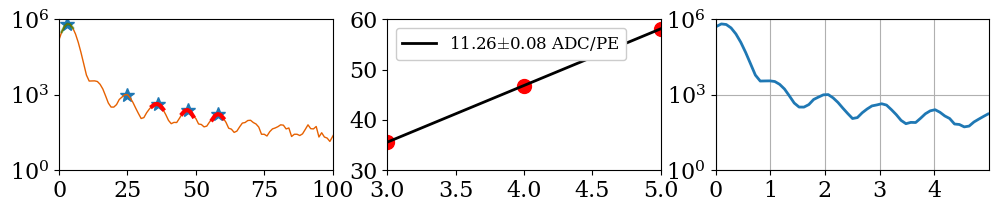

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_45.h5


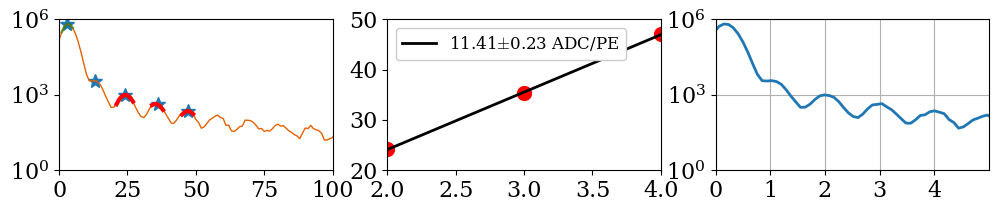

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_46.h5


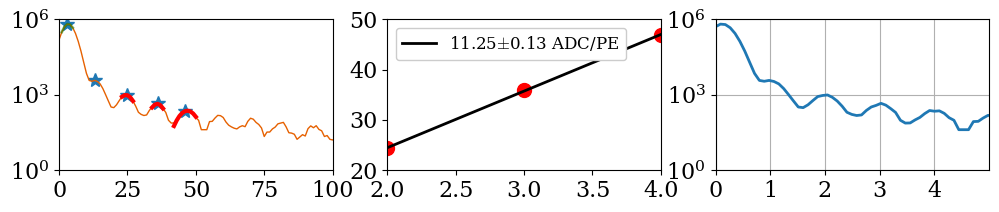

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_47.h5


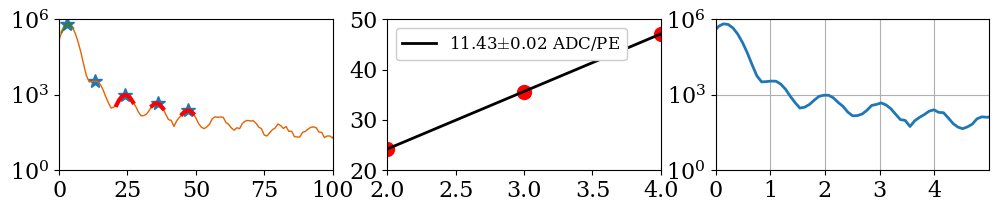

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_48.h5


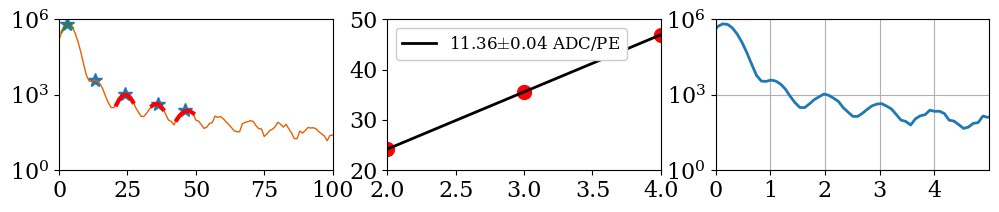

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_49.h5


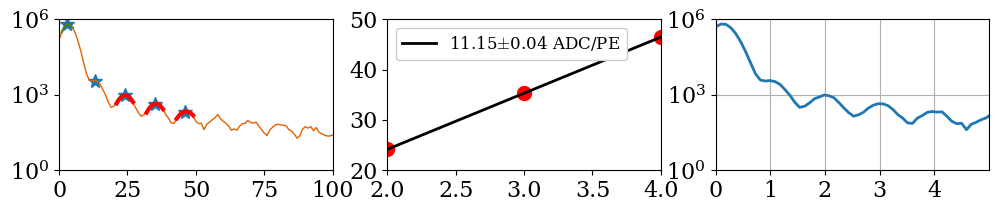

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_50.h5


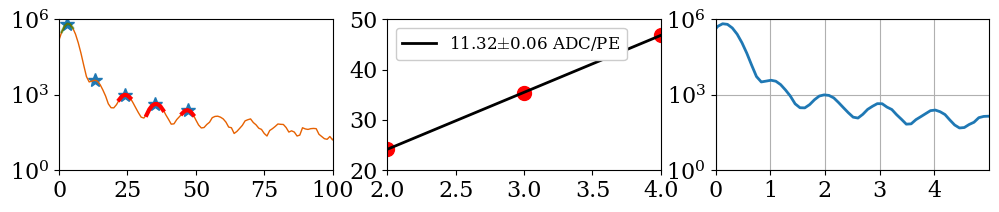

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_51.h5


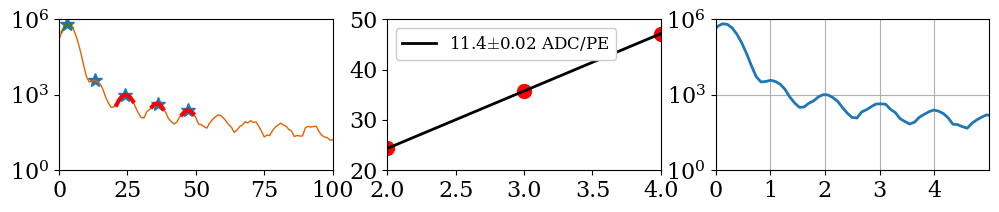

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_52.h5


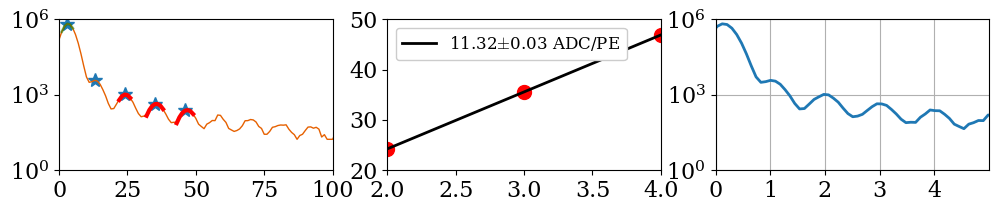

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_53.h5


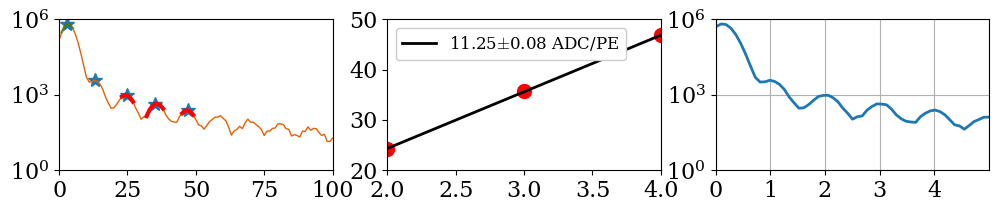

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_54.h5


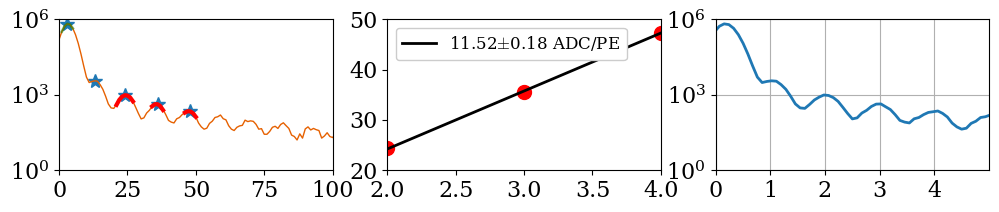

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_55.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


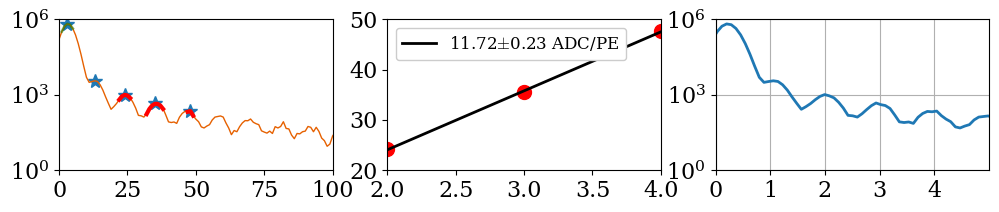

C:\Data\20220630\LXe_Full_E_field_2kV_source_reposition_PDE\mca_keith_31.00OV_56.h5


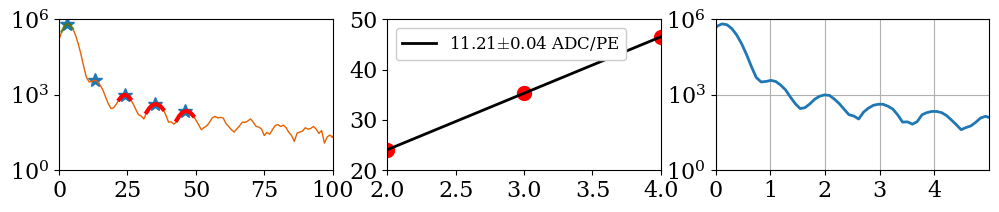

In [13]:
POS_FIELD_calib_pe,POS_FIELD_calib_count,POS_FIELD_gain_list,POS_FIELD_gain_err=gain_calculator(POS_FIELD,10,4)

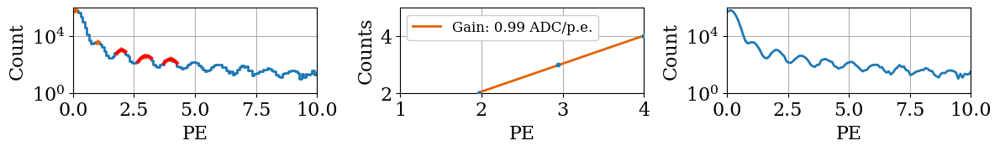

1.072551843046738e-12


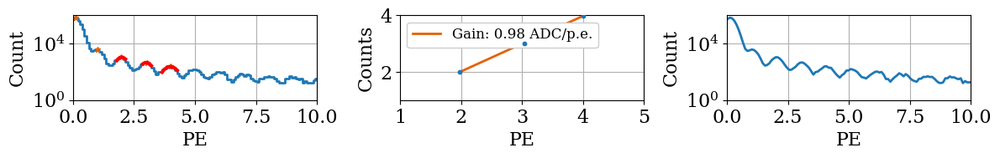

1.0745339881996128e-12


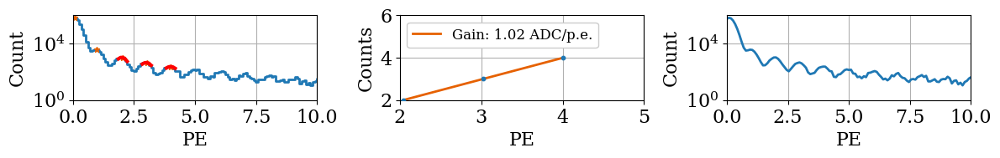

1.0893907215010675e-12


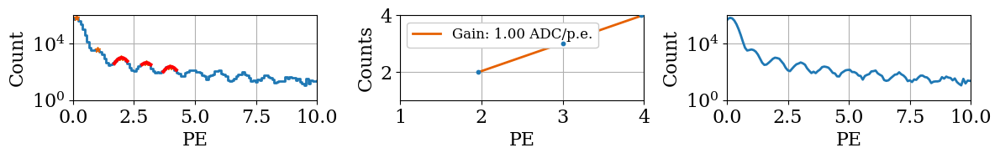

1.0503652026774473e-12


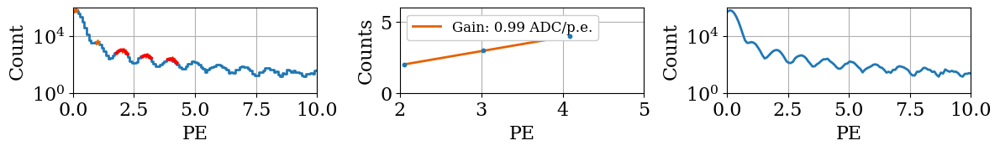

1.074656006589871e-12


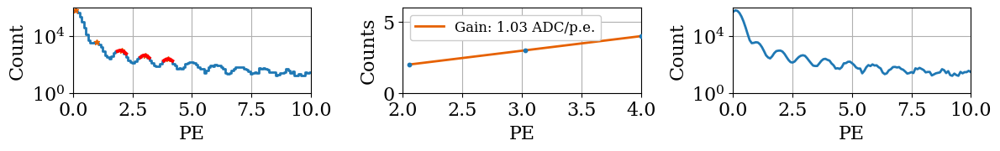

1.0712886289242434e-12


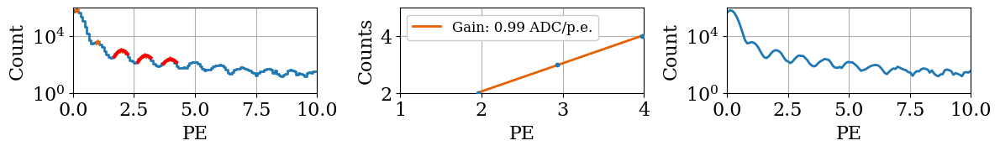

1.0744120720852977e-12


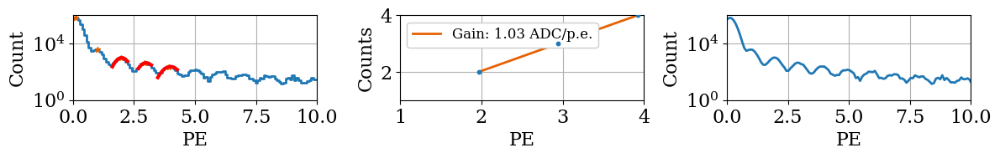

1.0853515783088922e-12


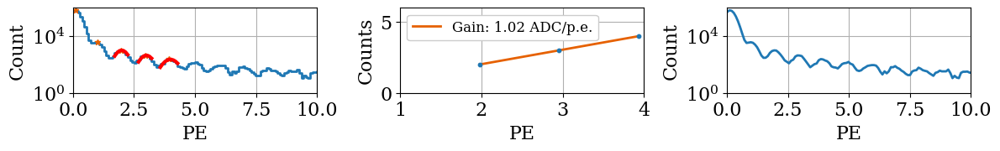

1.0870669990513642e-12


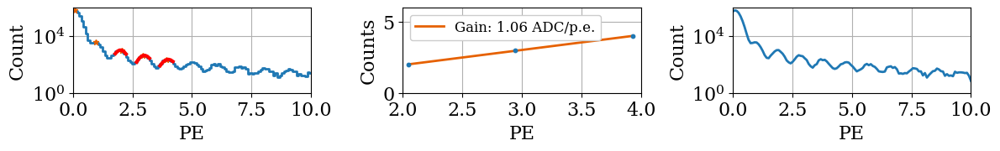

1.091769174626697e-12


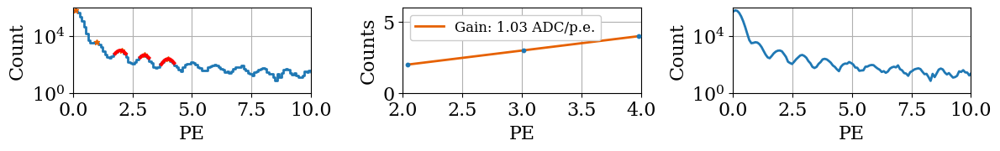

1.078089421438442e-12


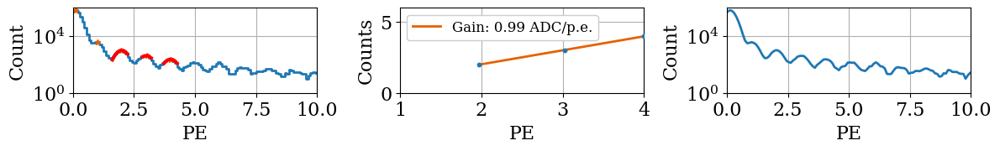

1.0712967853435723e-12


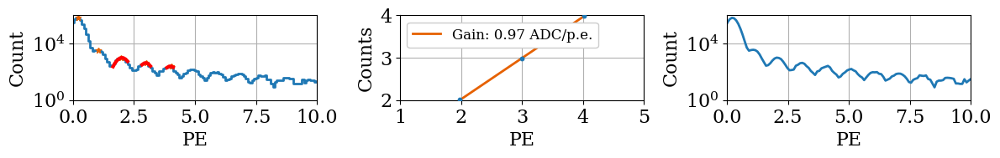

1.0405079556992946e-12


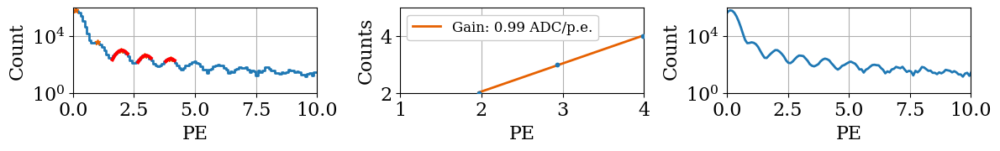

1.0828128465604406e-12


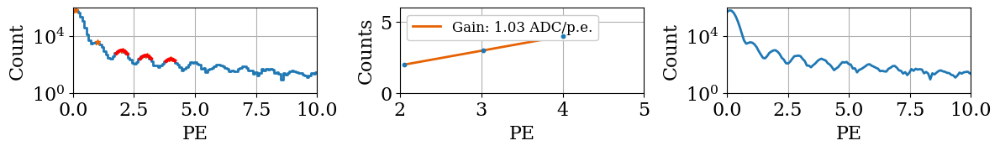

1.0962553462021476e-12


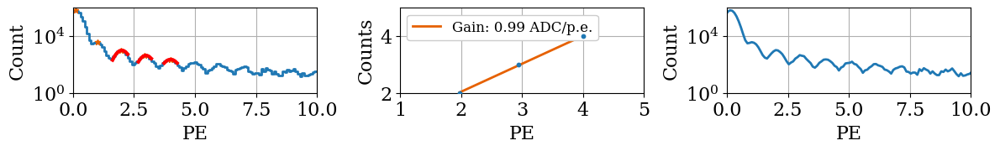

1.0883158089420433e-12


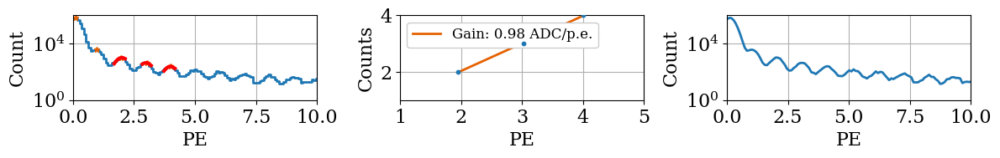

1.0722139466628246e-12


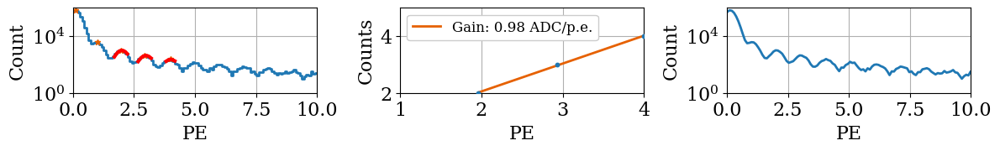

1.0863943732035964e-12


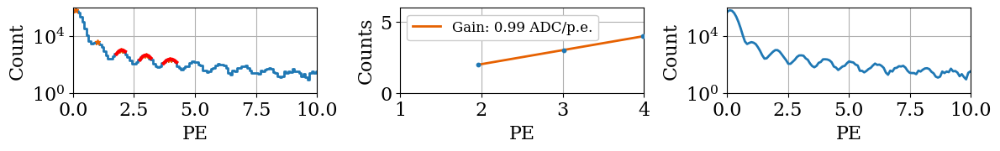

1.0800277836478121e-12


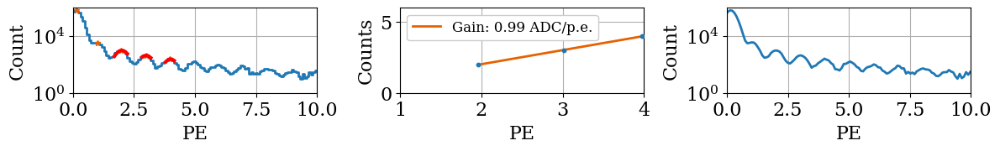

1.058385838032597e-12


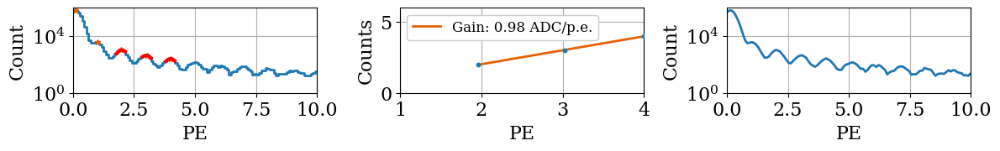

1.0780771356403416e-12


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


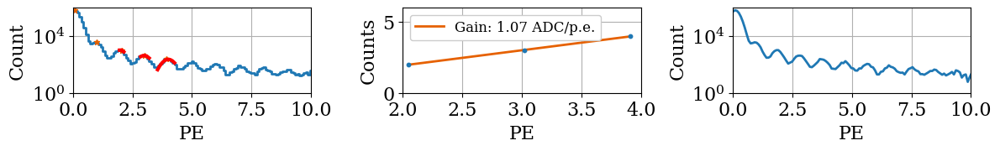

1.1014519855801349e-12


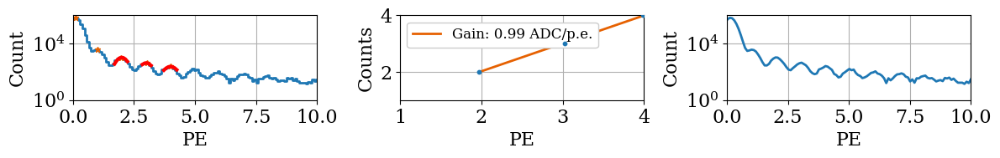

1.072310805846665e-12


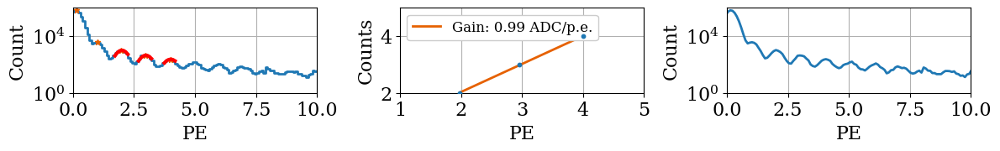

1.0768784789836294e-12


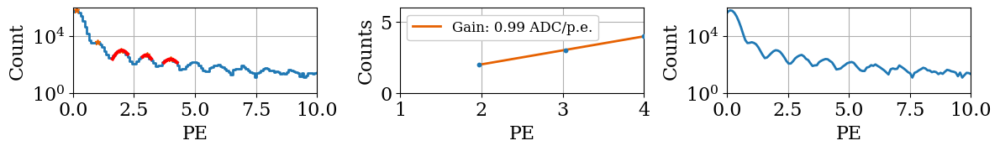

1.0829901950638485e-12


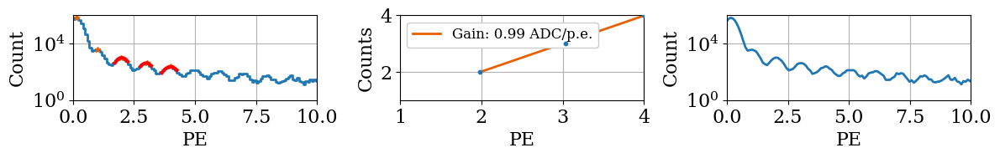

1.0892285031111221e-12


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


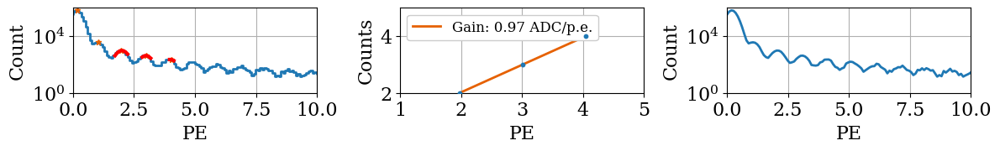

1.0732396838378438e-12


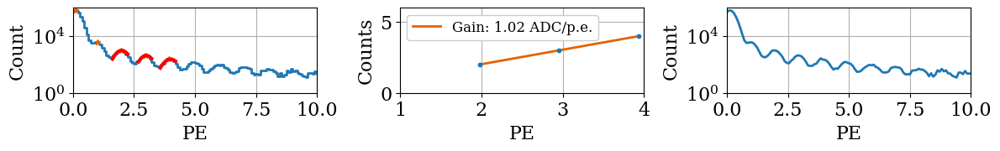

1.0805915415275584e-12


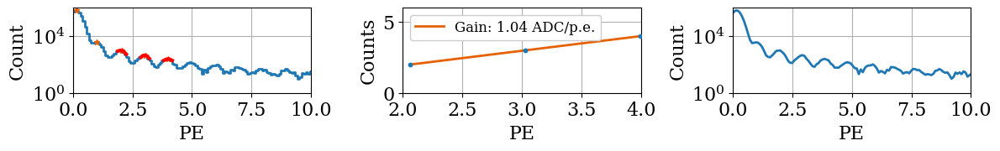

1.0906528710775368e-12


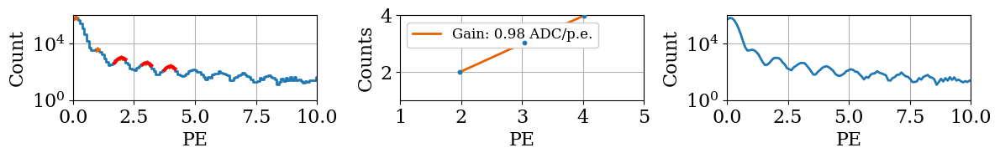

1.0706647153551493e-12


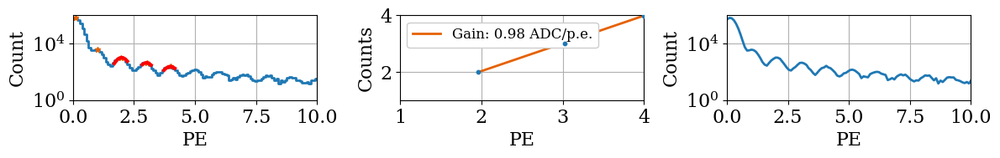

1.0682526184124735e-12


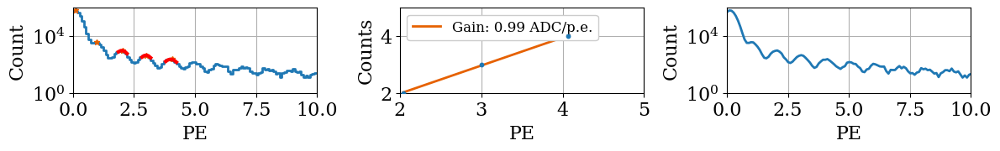

1.0721662431721559e-12


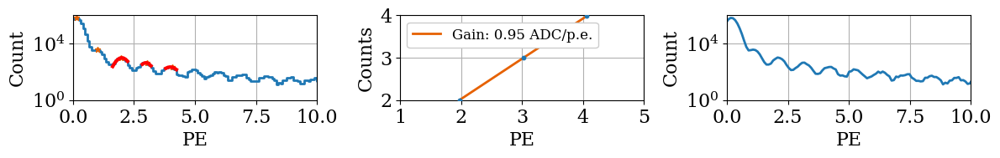

1.0882272659358543e-12


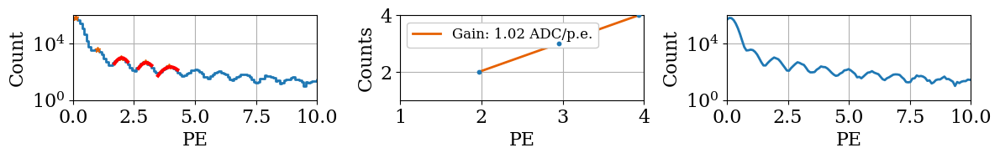

1.0894896937058796e-12


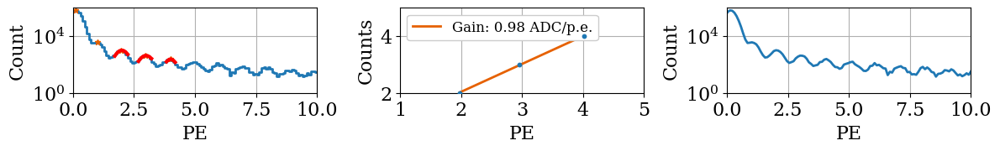

1.0789607348493875e-12


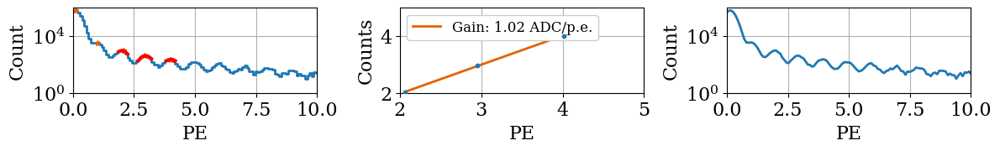

1.0790851172300199e-12


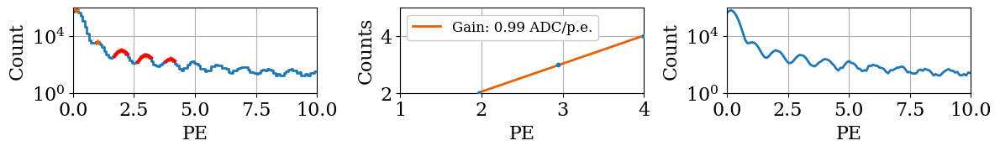

1.078394387836177e-12


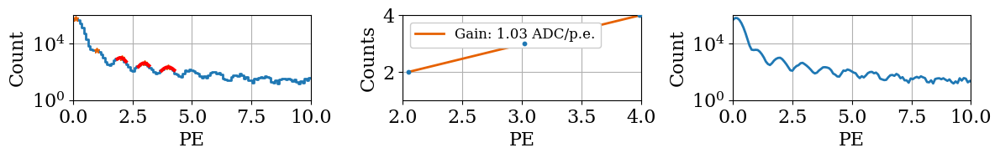

1.068089545620089e-12


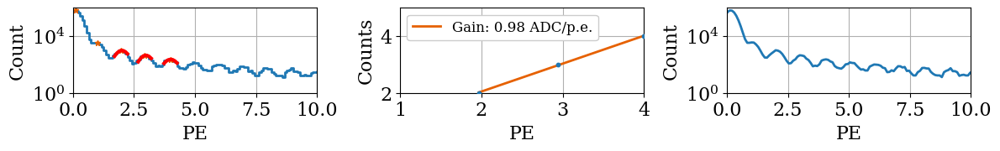

1.058361075456439e-12


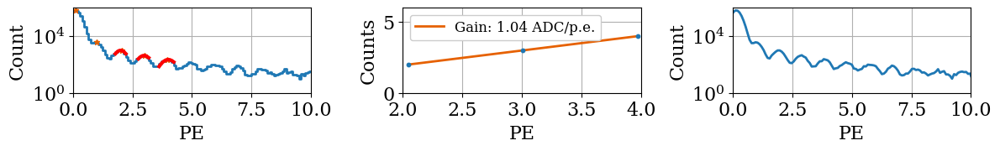

1.0761784358781255e-12


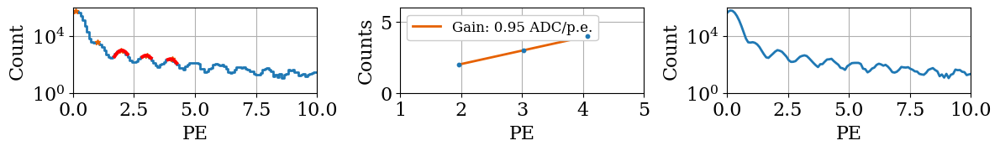

1.0867224871711449e-12


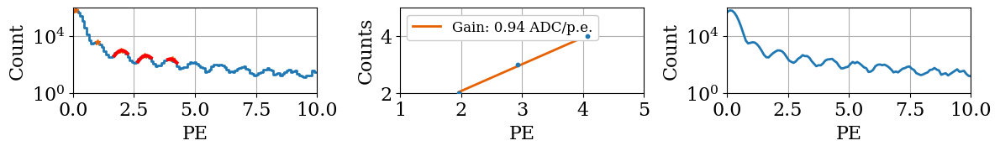

1.0911528618466851e-12


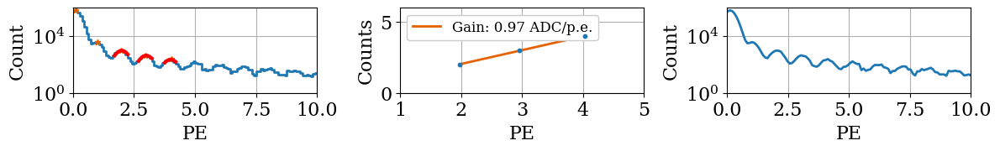

1.0902420485323639e-12


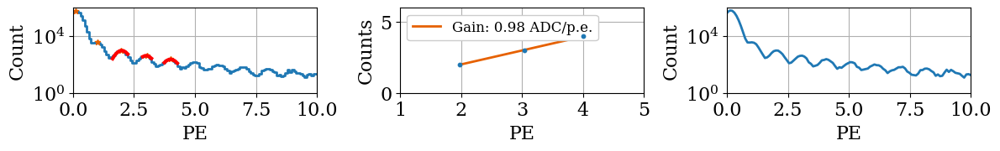

1.0856265350900072e-12


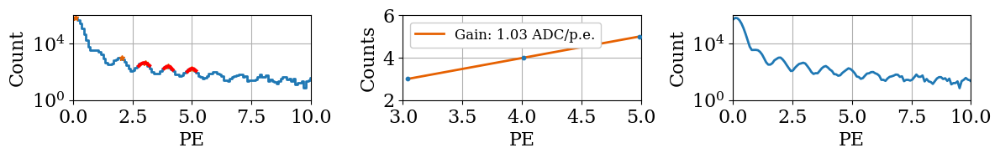

1.103233888788634e-12


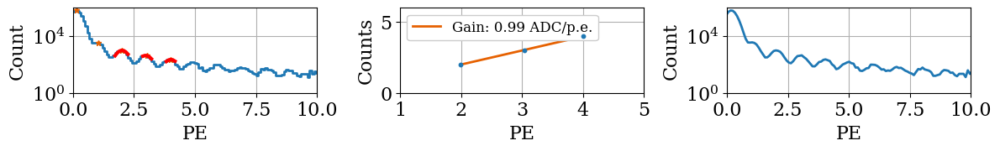

1.073636167549126e-12


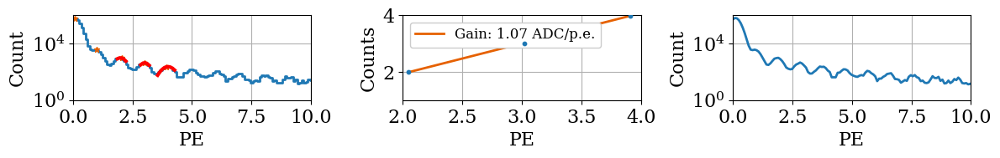

1.1028529809547902e-12


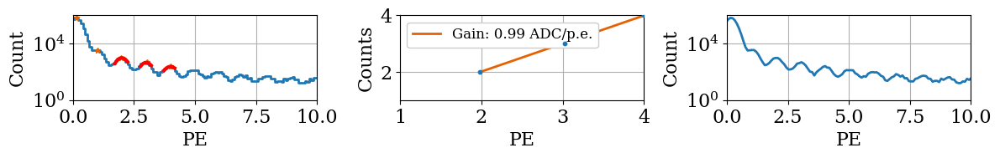

1.0682174538692143e-12


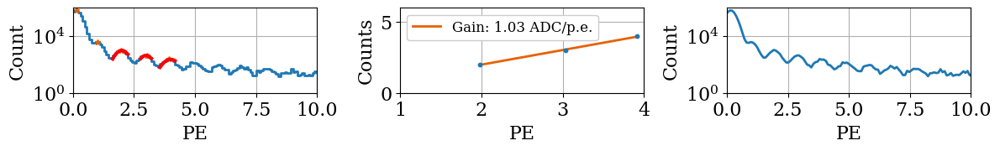

1.0828100347547937e-12


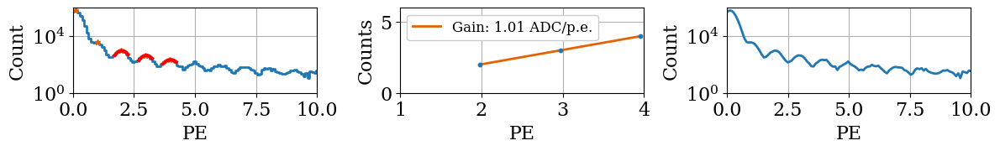

1.1040729149779797e-12


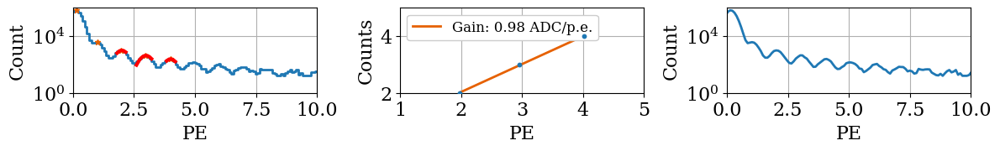

1.093896014560478e-12


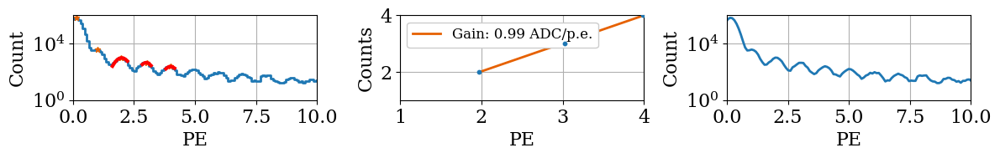

1.0865593484565276e-12


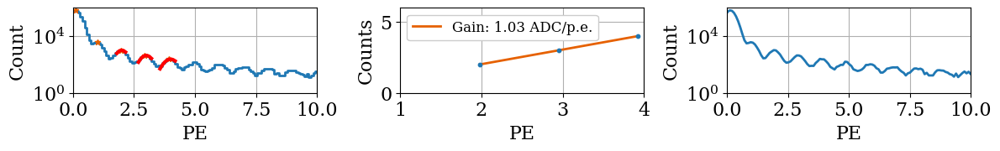

1.0822356138208303e-12


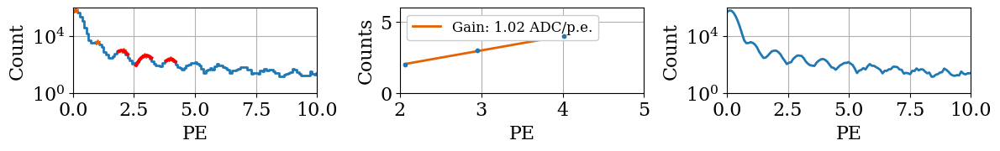

1.0558282078212123e-12


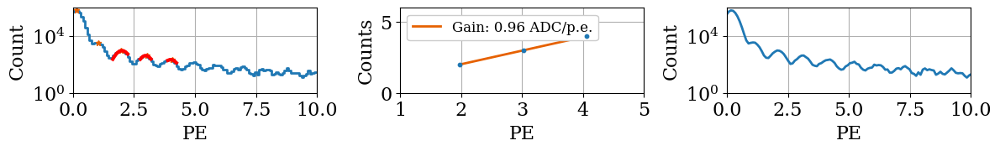

1.0666683690201684e-12


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


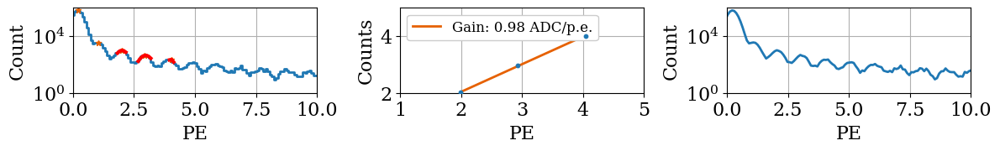

1.0712330798773966e-12


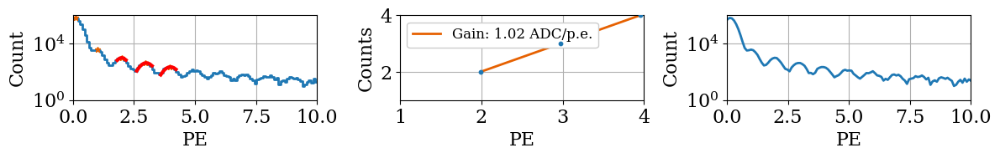

1.0950524629784843e-12


In [14]:
POS_FIELD_pe_corrected_gain=[]
POS_FIELD_pe_corrected_gain_err=[]
POS_FIELD_calib_pe_updated=[]
for x,y in zip(POS_FIELD_calib_pe,POS_FIELD_calib_count):
    plt.figure(figsize=(12,2))
    plt.subplot(1,3,1)
    plt.step(x,y)
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    
    
    N_peaks=4
    PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
    peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
    peak_length=len(peaks)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
    while (peak_length<N_peaks+1):
        PROMINENCE=PROMINENCE-1
            
        peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
        peak_length=len(peaks)


        
    plt.plot(x[peaks],y[peaks],'*',ms=5) # plot the peak markers
    first_pe_max=x[peaks[2]] # The x-value of the 3rd peak.Index=1 means the second peak will be used for getting fit parameters
    max_value=y[peaks[2]] # The height of the 3rd peak
    x_idx_array=(y<0.5*max_value) & (x>first_pe_max)# returns a boolean array where both conditions are true
    right_side_x= x[np.where(x_idx_array)[0][0]] #finding the first time where x_idx_array is True
    sigma_guess=np.abs(first_pe_max-right_side_x) #We need this to fit the width of the Gaussian peaks
    cut= (x < first_pe_max+sigma_guess) & (x > first_pe_max-sigma_guess) # This cut helps to fix the width of the peak-fit
    popt,pcov=curve_fit(gauss,x[cut],y[cut],p0=[max_value,first_pe_max,sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
    plt.plot(x[cut],gauss(x[cut],*popt),color='r',label='Fit',lw=2) # Here we plot the fit on the 2nd peak to see if everything looks ok.
    
    params_pe = []
    params_pe_count=[]
    for i,peak in enumerate(peaks[2:]): #here we ignore the first peak because it could be the pedestal
        new_first_pe_max=x[peak] #x-value of the peak
        new_max_value=y[peak] #height of the peak
        new_x_idx_array=(y<0.5*new_max_value) & (x>new_first_pe_max) # returns a boolean array where both conditions are true
        new_right_side_x= x[np.where(new_x_idx_array)[0][0]] #finding the first time where x_idx_array is True
        new_sigma_guess=np.abs(new_first_pe_max-new_right_side_x) #We need this to fit the width of the Gaussian peaks


        new_cut= (x < new_first_pe_max+new_sigma_guess) & (x > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
        popt_new,pcov_new=curve_fit(gauss,x[new_cut],y[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
        plt.plot(x[new_cut],gauss(x[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
        params_pe.append(popt_new[1]) #Here we append the value of the peak fit mean 
        params_pe_count.append((x[peak]))

    plt.subplot(1,3,2) 
    
    plt.scatter(params_pe_count, np.array(params_pe), s=10, zorder=10)
    popt_line,pcov_line = curve_fit(line, params_pe_count, np.array(params_pe), p0=[10,0])
    plt.plot(params_pe_count, line(params_pe_count, *popt_line), color=colors[1], label='Gain: {:.2f} ADC/p.e.'.format(popt_line[0]))
    POS_FIELD_pe_corrected_gain.append(popt_line[0])
    POS_FIELD_pe_corrected_gain_err.append(np.sqrt(np.diag(pcov_line)[0]))
    plt.legend(loc=2)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Counts')

    plt.subplot(1,3,3)
    plt.plot(x/popt_line[0],y)
    POS_FIELD_calib_pe_updated.append(x/popt_line[0])
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')


    plt.tight_layout()
    plt.show()

    value=0
    for i,val in enumerate(x):
        if x[i]>0.75:
            # print(i,x[i],y[i])
            value+=x[i]*y[i]
    n_electrons=value*10.7*9
    charge=n_electrons*1.6*10E-19
    current=charge/60
    print(current)

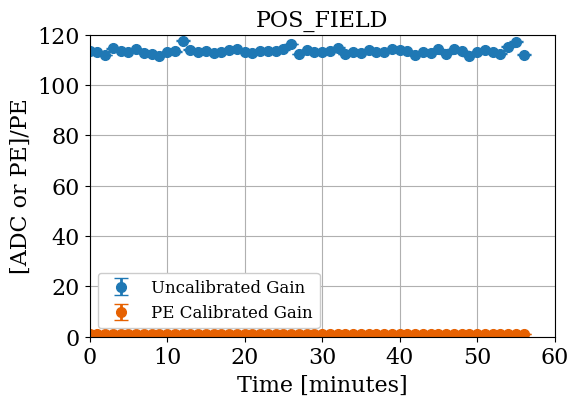

In [15]:
plt.figure(figsize=(6,4))
time_POS_FIELD=np.arange(0,len(POS_FIELD_gain_list))

plt.errorbar(time_POS_FIELD,POS_FIELD_gain_list*10,yerr=POS_FIELD_gain_err,fmt='o',ms=7,label='Uncalibrated Gain')
plt.errorbar(time_POS_FIELD,POS_FIELD_pe_corrected_gain,yerr=POS_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time [minutes]')
plt.title('POS_FIELD')
plt.grid()
plt.legend(loc='best')
plt.savefig('POS_FIELD_gain_comparison.pdf')
plt.show()

### Doing the same here for the negative E field

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_0.h5


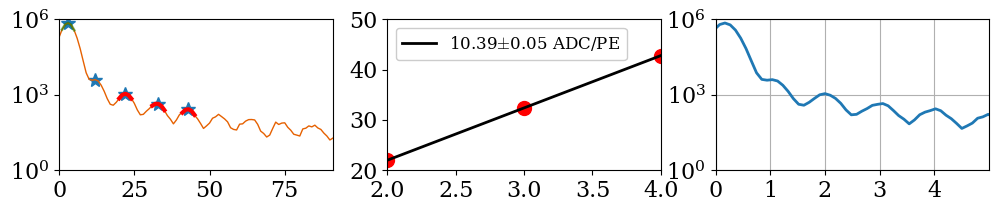

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_1.h5


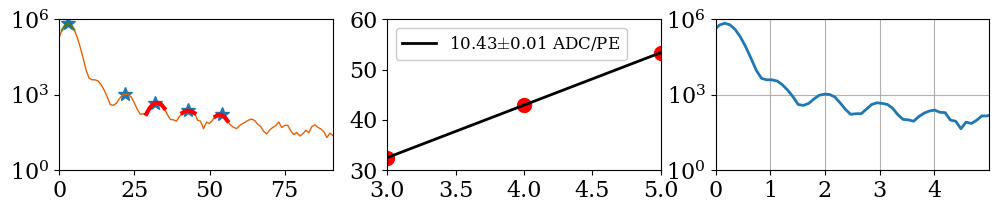

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_2.h5


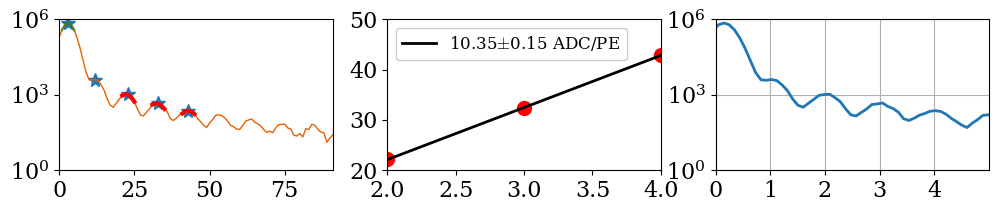

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_3.h5


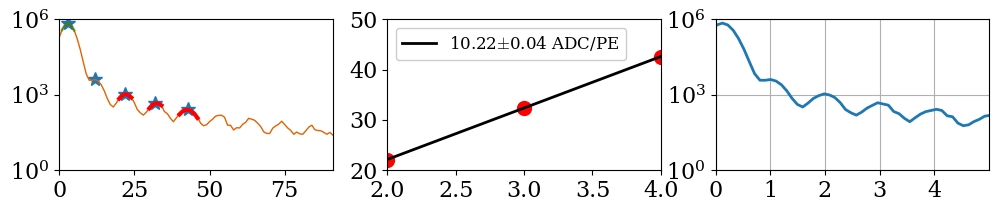

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_4.h5


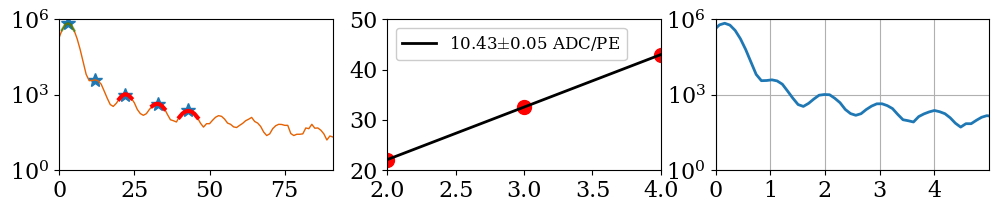

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_5.h5


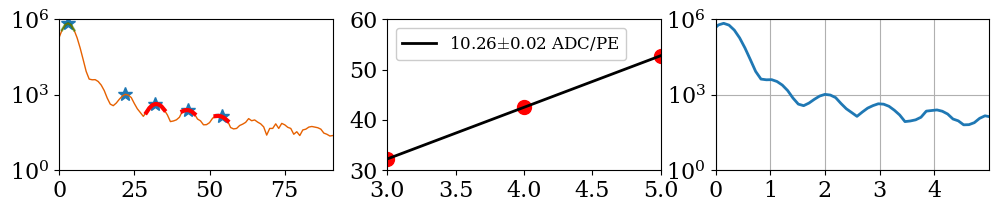

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_6.h5


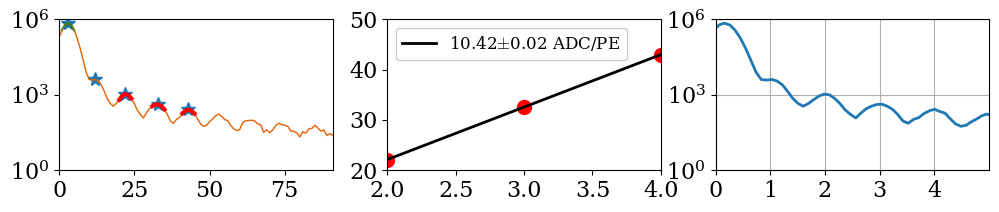

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_7.h5


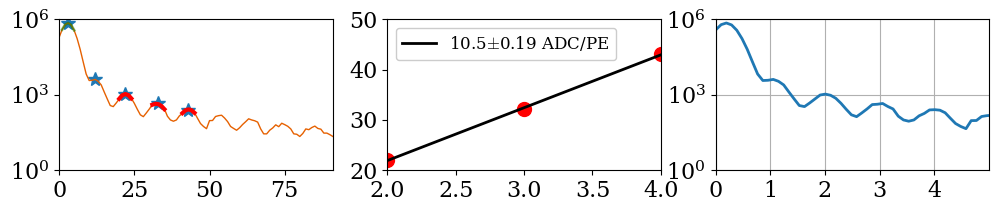

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_8.h5


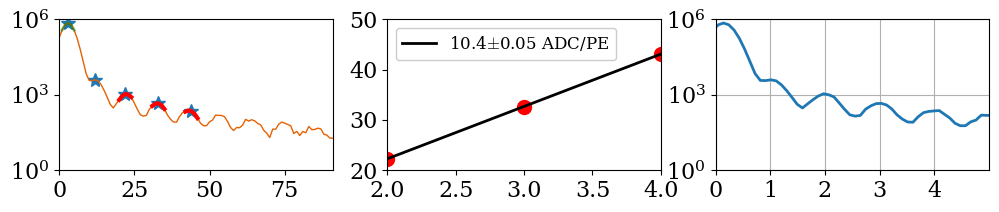

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_9.h5


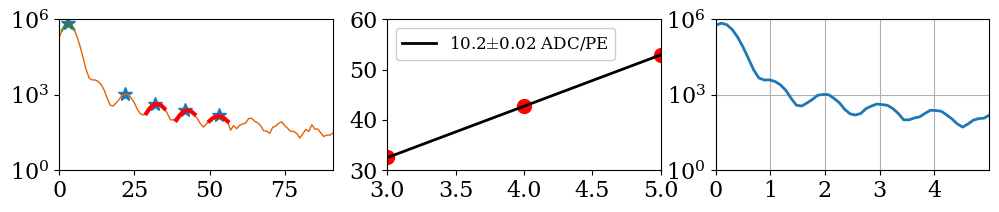

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_10.h5


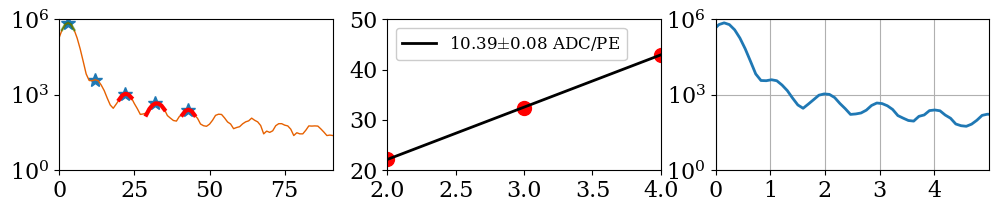

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_11.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


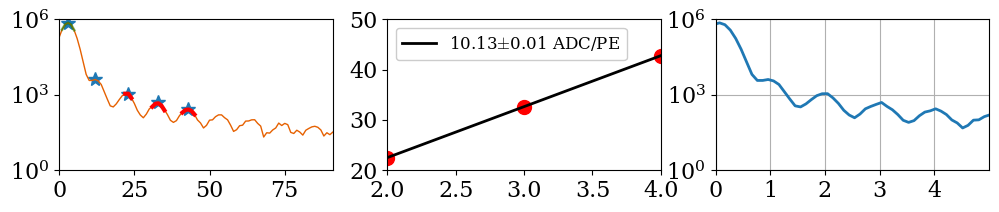

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_12.h5


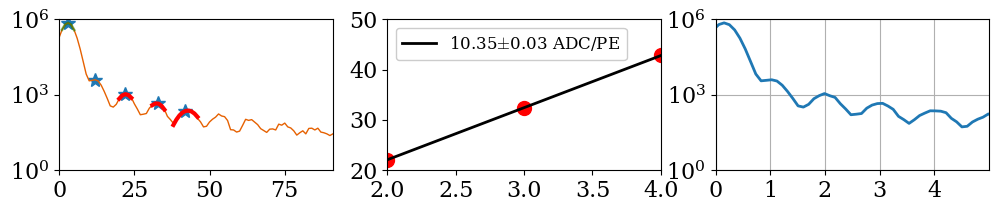

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_13.h5


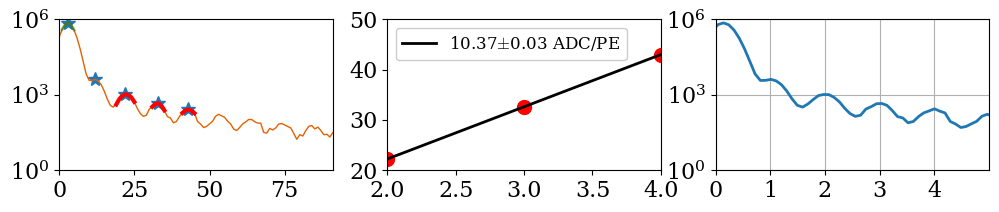

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_14.h5


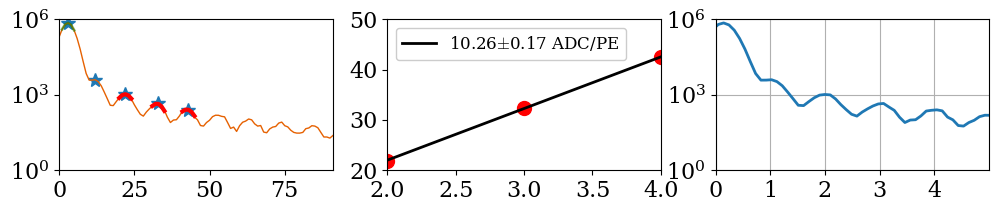

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_15.h5


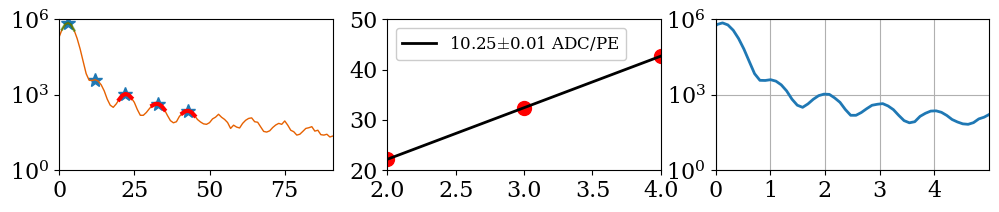

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_16.h5


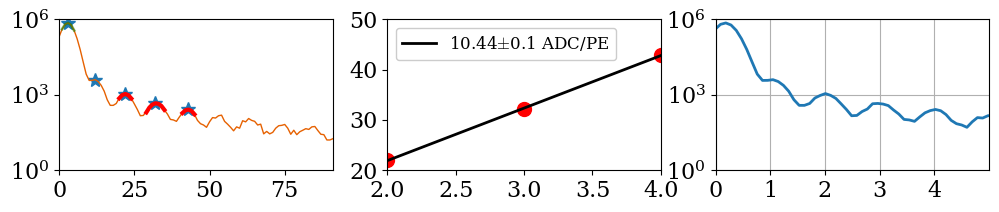

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_17.h5


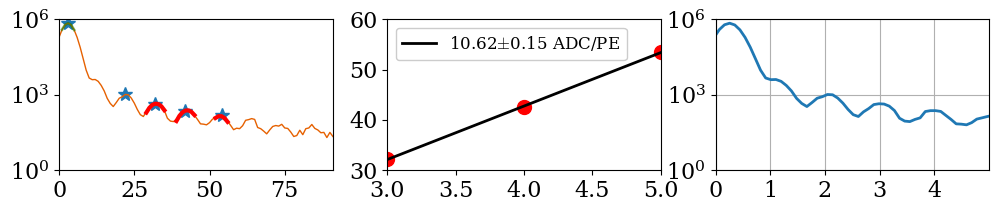

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_18.h5


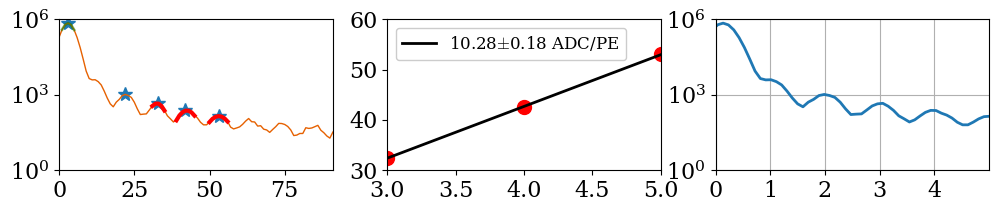

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_19.h5


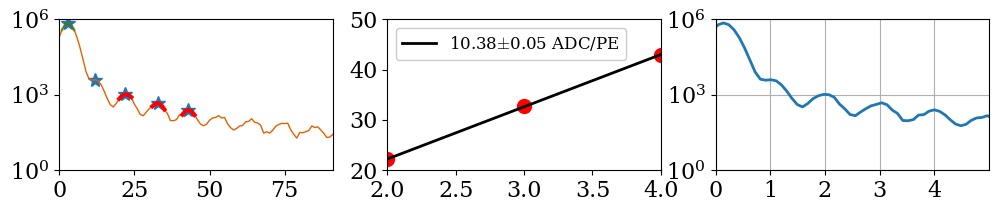

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_20.h5


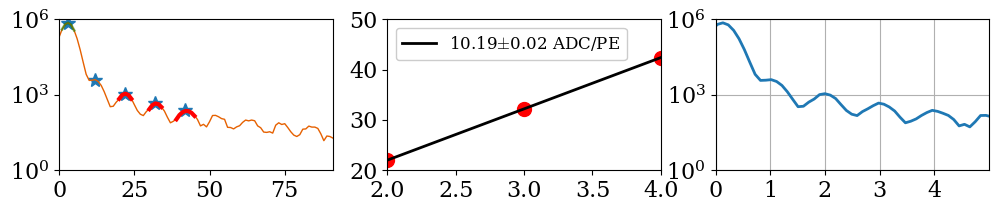

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


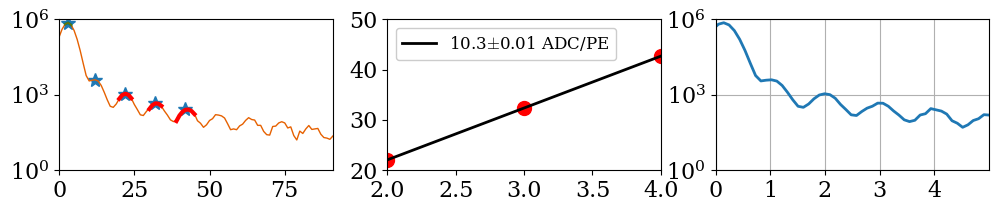

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_22.h5


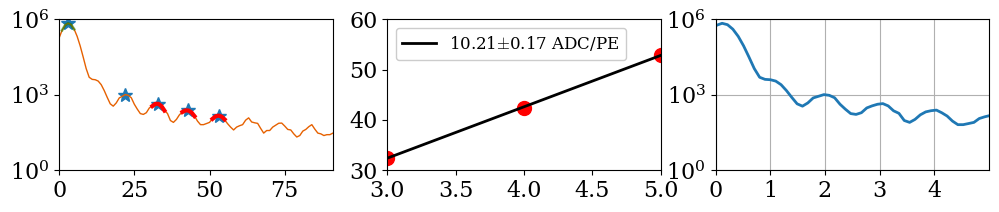

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_23.h5


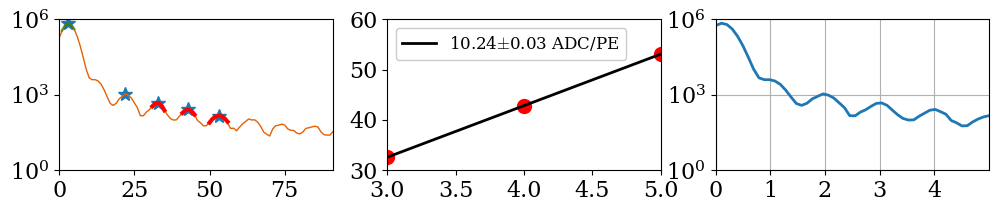

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_24.h5


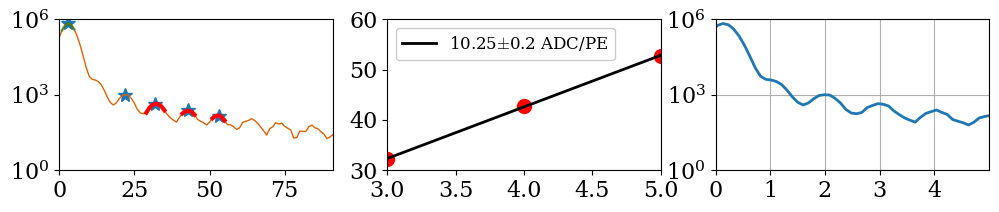

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_25.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


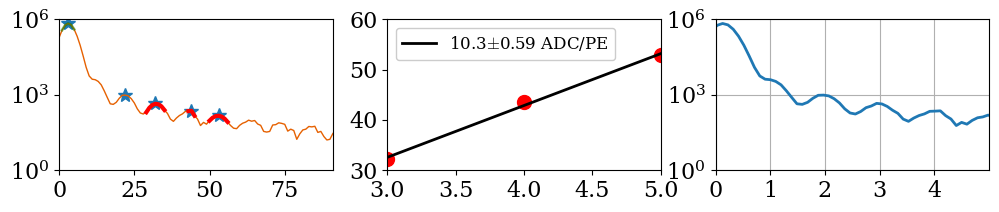

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_26.h5


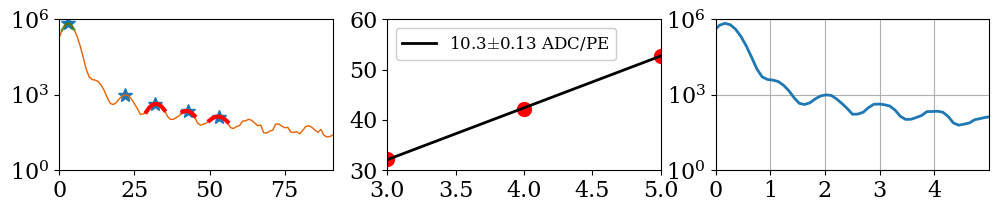

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_27.h5


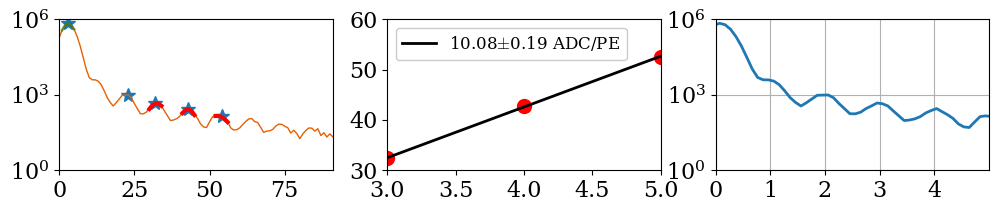

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_28.h5


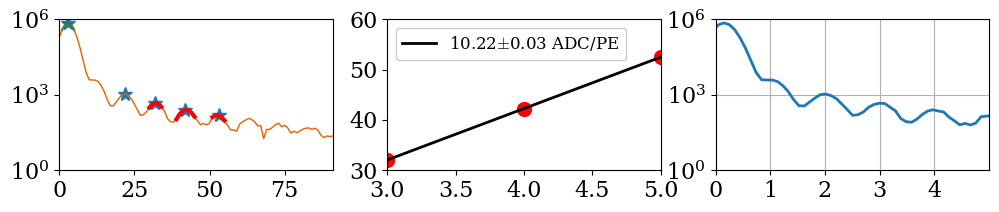

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_29.h5


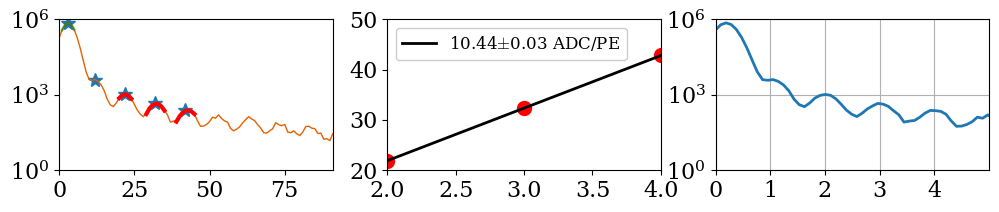

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_30.h5


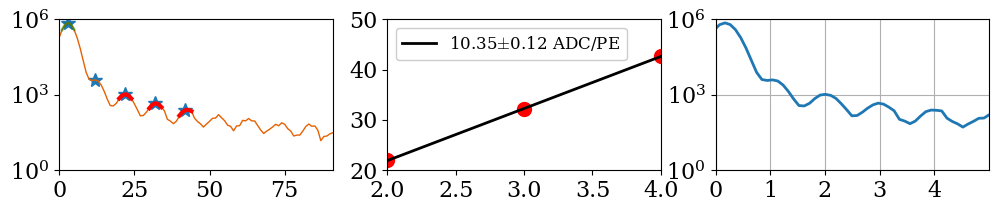

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_31.h5


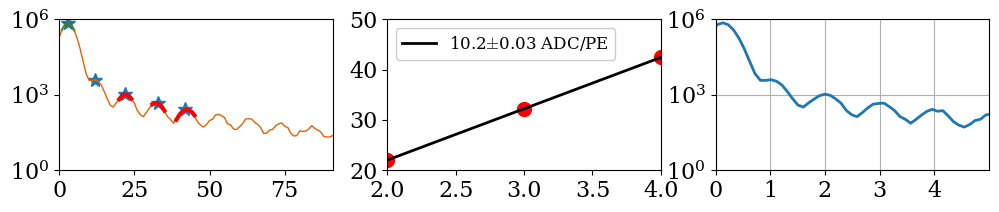

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_32.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


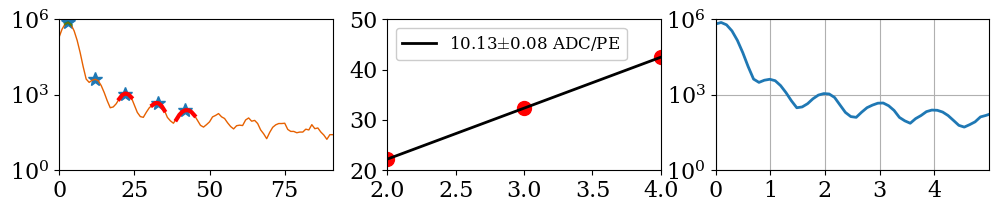

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_33.h5


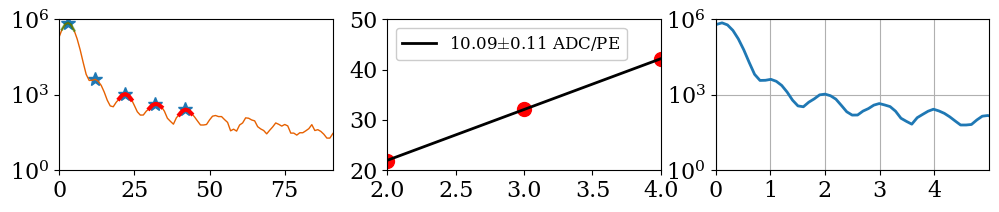

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_34.h5


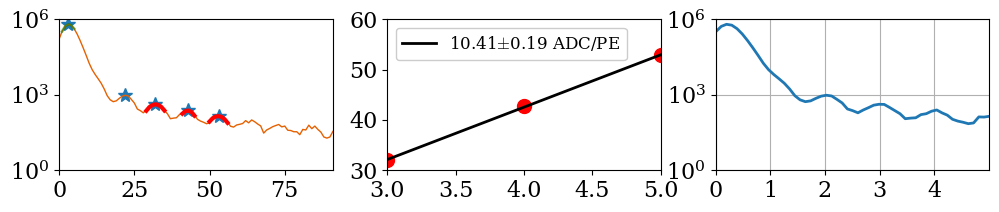

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_35.h5


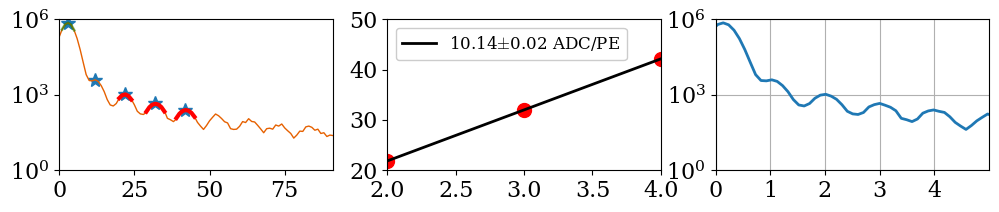

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_36.h5


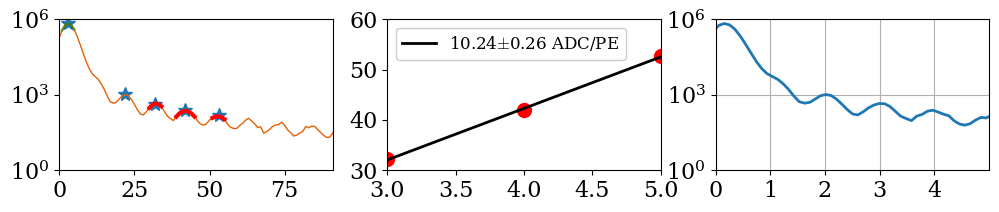

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_37.h5


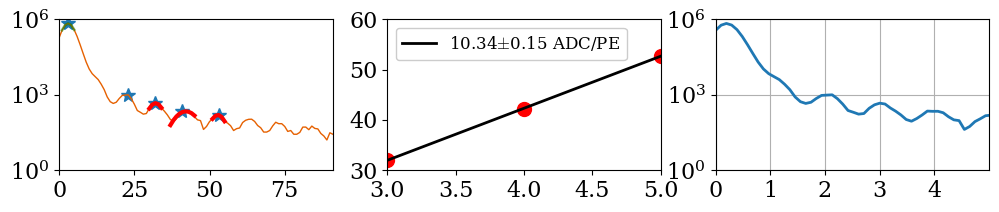

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_38.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


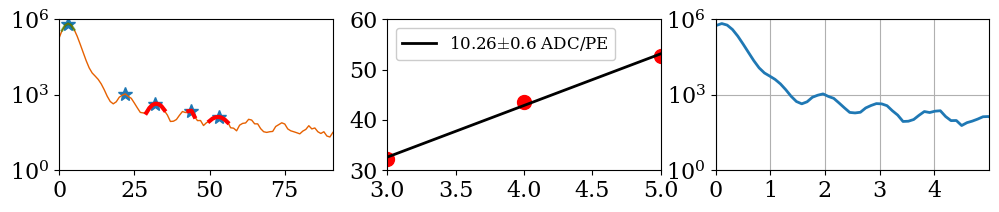

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_39.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


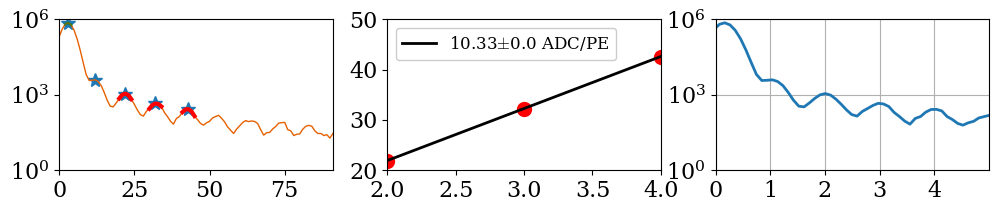

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_40.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


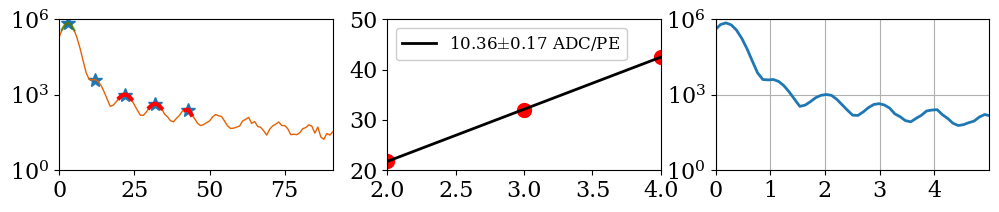

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_41.h5


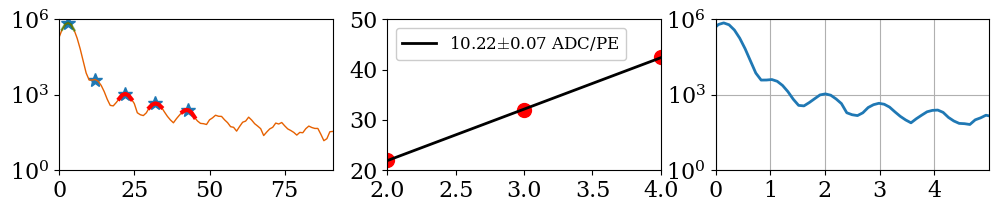

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_42.h5


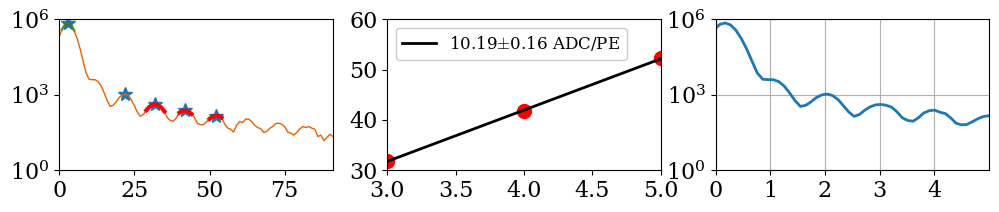

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_43.h5


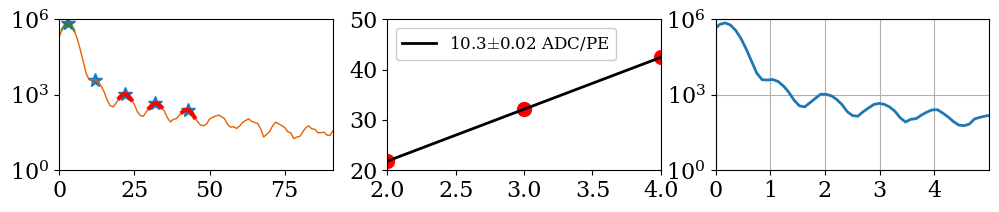

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_44.h5


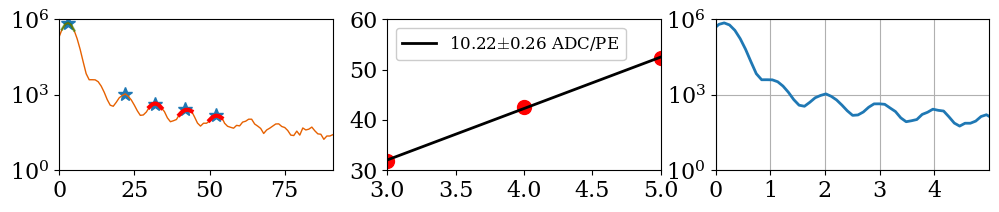

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_45.h5


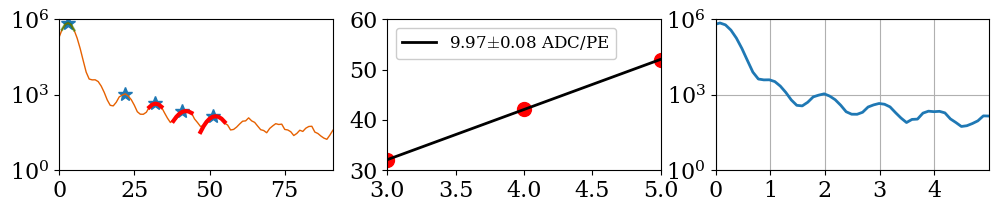

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_46.h5


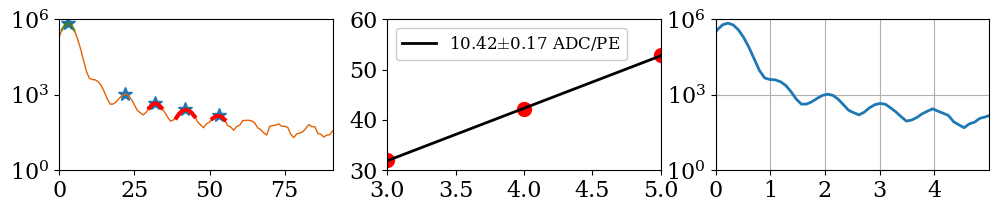

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_47.h5


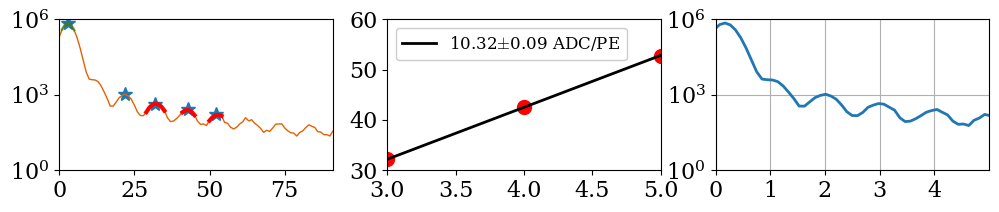

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_48.h5


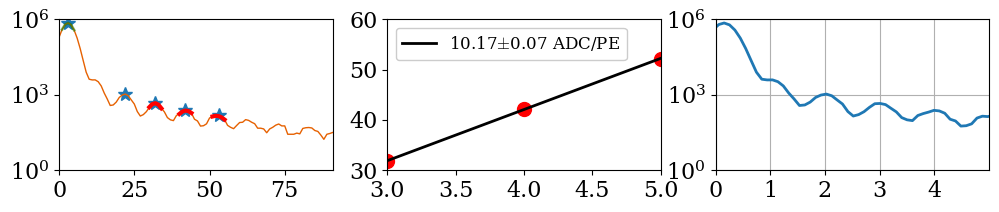

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_49.h5


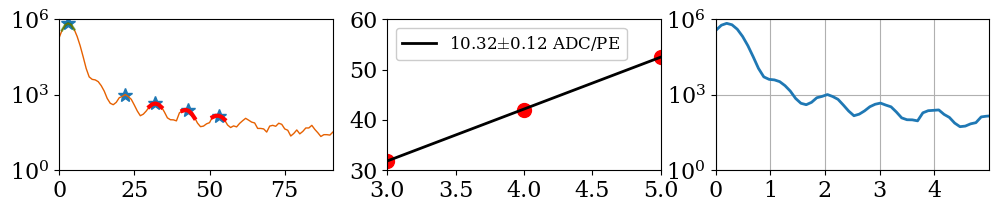

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_50.h5


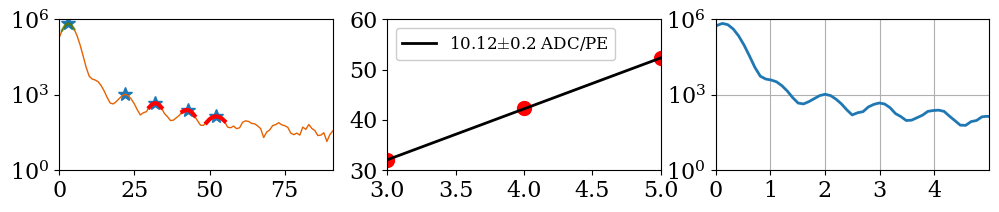

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_51.h5


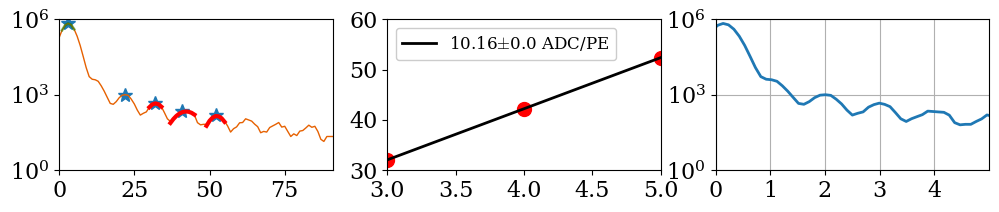

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_52.h5


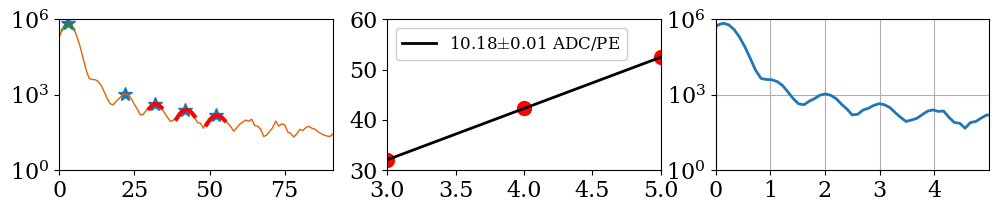

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_53.h5


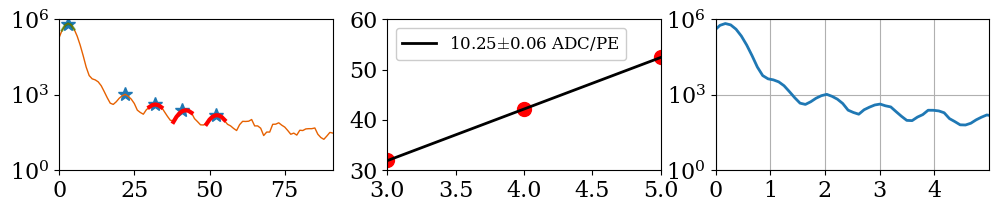

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_54.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


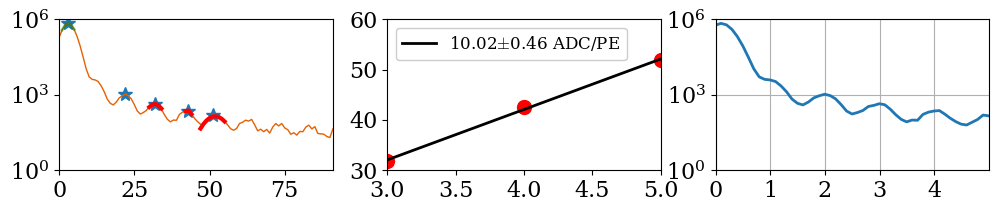

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_55.h5


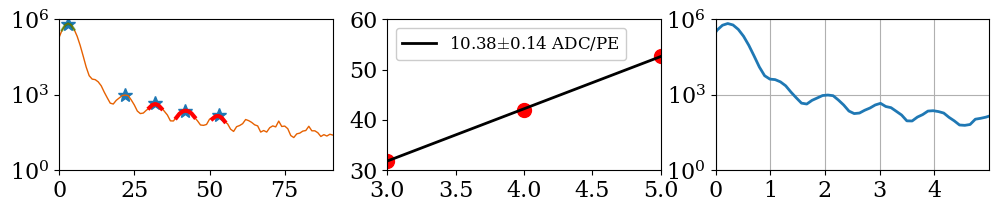

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_56.h5


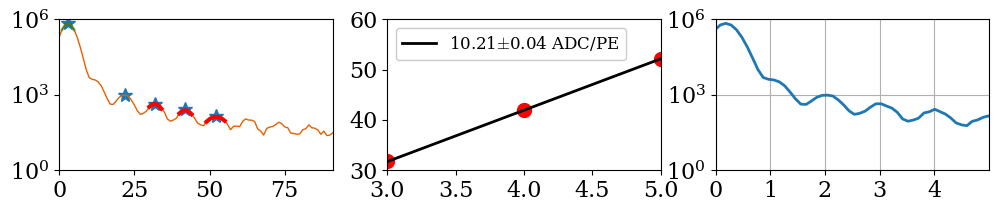

C:\Data\20220630\LXe_Full_E_field_-2kV_source_reposition_PDE\mca_keith_31.00OV_57.h5


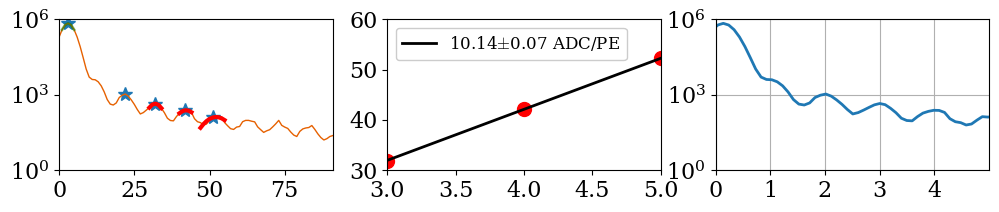

In [16]:
NEG_FIELD_calib_pe,NEG_FIELD_calib_count,NEG_FIELD_gain_list,NEG_FIELD_gain_err=gain_calculator(NEG_FIELD,11,4)

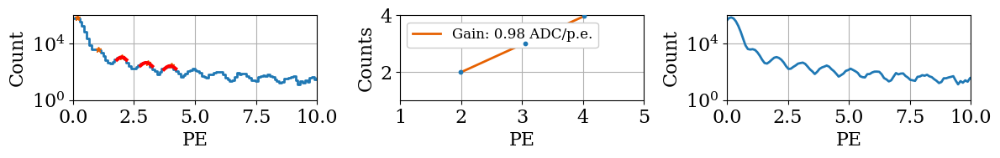

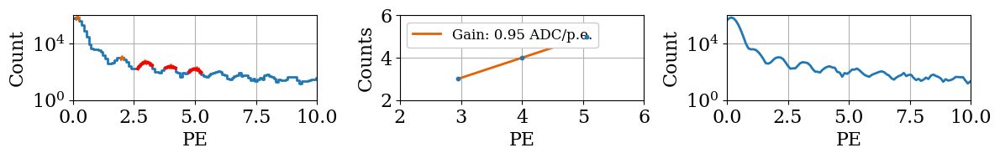

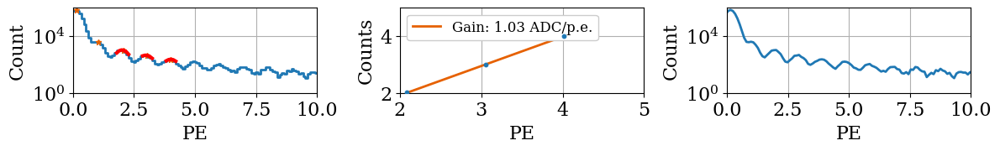

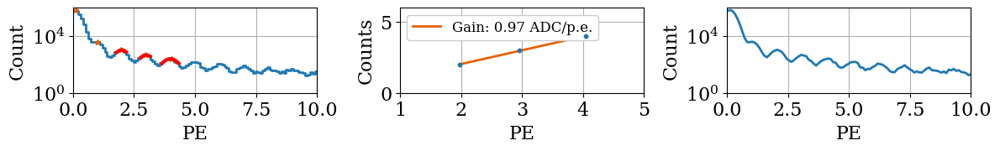

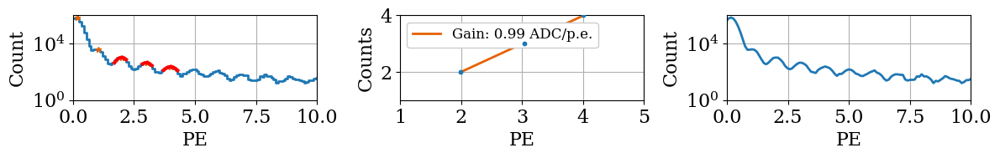

...

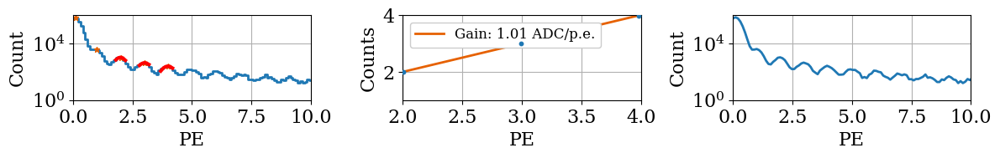

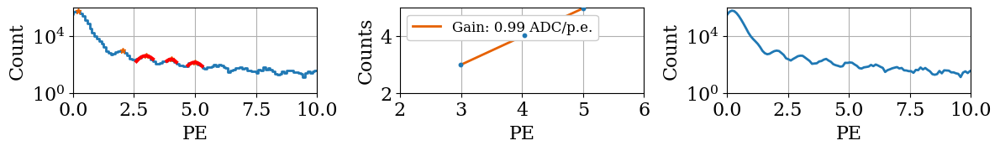

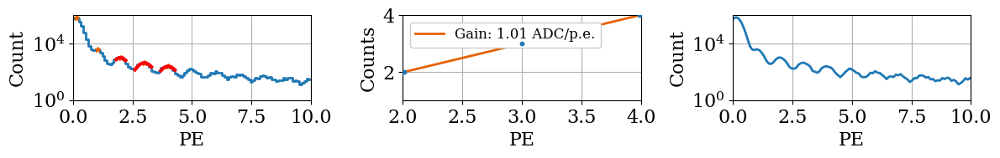

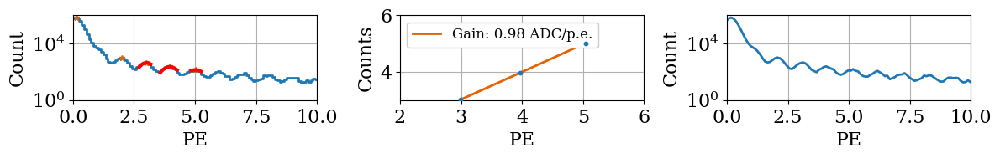

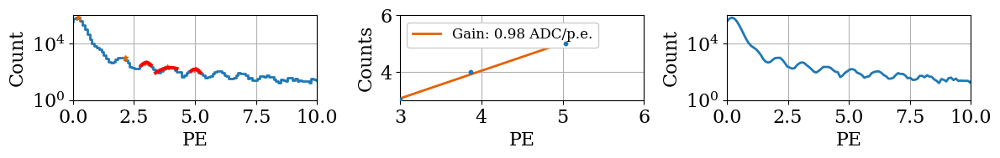

c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


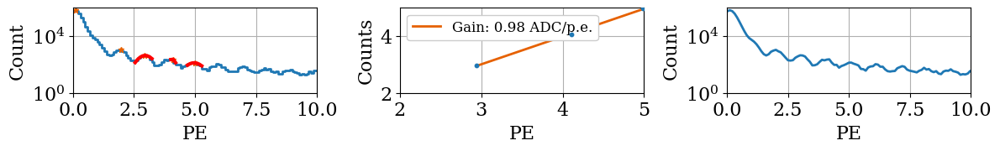

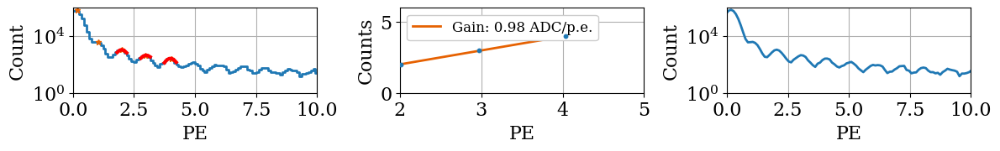

c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


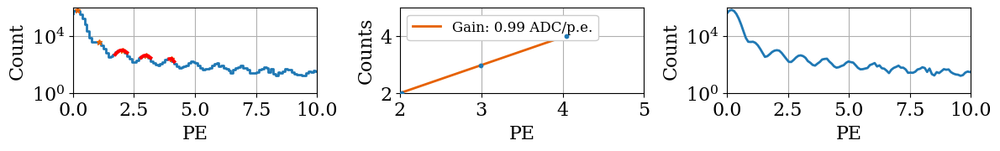

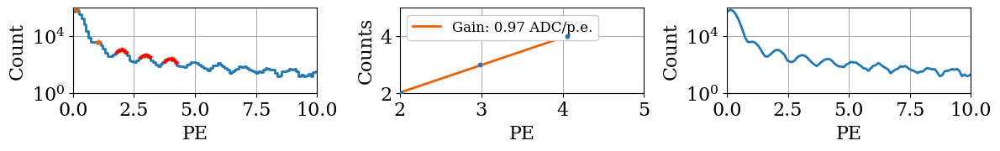

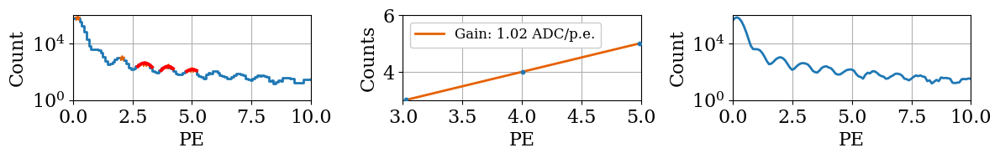

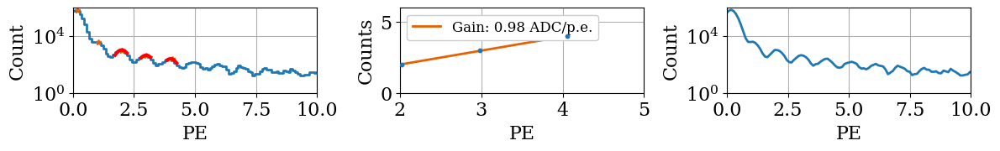

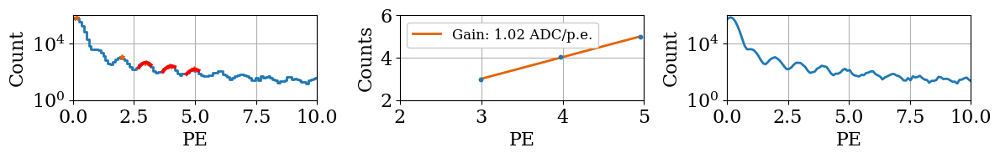

...

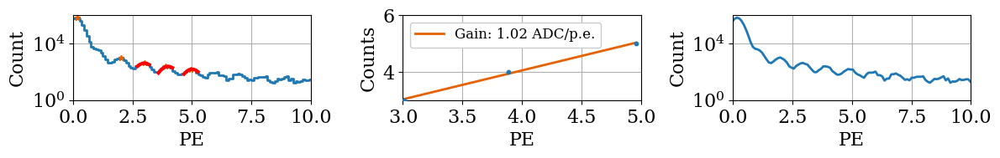

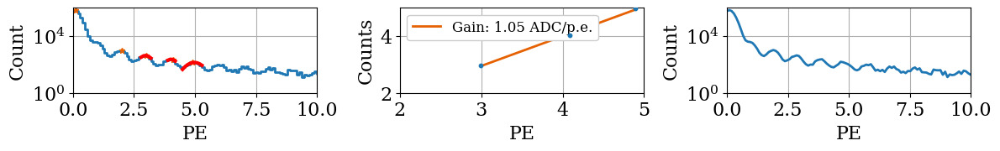

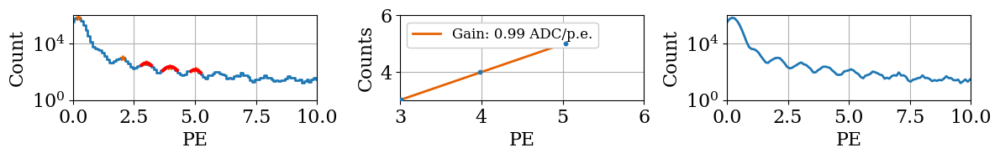

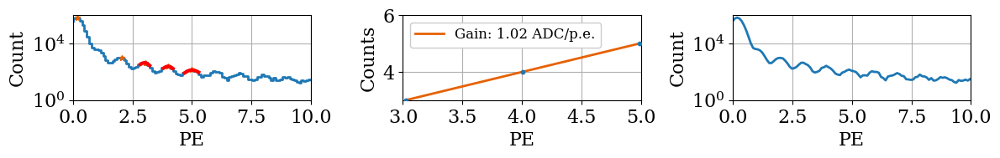

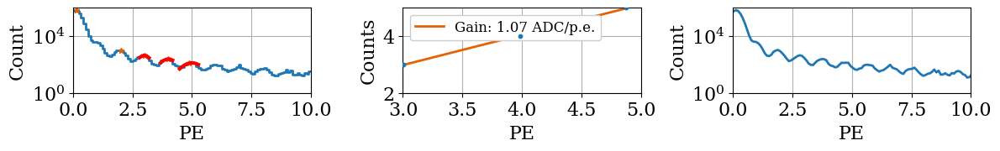

In [17]:
NEG_FIELD_pe_corrected_gain=[]
NEG_FIELD_pe_corrected_gain_err=[]
NEG_FIELD_calib_pe_updated=[]

for x,y in zip(NEG_FIELD_calib_pe,NEG_FIELD_calib_count):
    plt.figure(figsize=(12,2))
    plt.subplot(1,3,1)
    plt.step(x,y)
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')
    
    
    N_peaks=4
    PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
    peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
    peak_length=len(peaks)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
    while (peak_length<N_peaks+1):
        PROMINENCE=PROMINENCE-1
            
        peaks,pdict=find_peaks(y,prominence=PROMINENCE,distance=5)
        peak_length=len(peaks)


        
    plt.plot(x[peaks],y[peaks],'*',ms=5) # plot the peak markers
    first_pe_max=x[peaks[2]] # The x-value of the 3rd peak.Index=1 means the second peak will be used for getting fit parameters
    max_value=y[peaks[2]] # The height of the 3rd peak
    x_idx_array=(y<0.5*max_value) & (x>first_pe_max)# returns a boolean array where both conditions are true
    right_side_x= x[np.where(x_idx_array)[0][0]] #finding the first time where x_idx_array is True
    sigma_guess=np.abs(first_pe_max-right_side_x) #We need this to fit the width of the Gaussian peaks
    cut= (x < first_pe_max+sigma_guess) & (x > first_pe_max-sigma_guess) # This cut helps to fix the width of the peak-fit
    popt,pcov=curve_fit(gauss,x[cut],y[cut],p0=[max_value,first_pe_max,sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
    plt.plot(x[cut],gauss(x[cut],*popt),color='r',label='Fit',lw=2) # Here we plot the fit on the 2nd peak to see if everything looks ok.
    
    params_pe = []
    params_pe_count=[]
    for i,peak in enumerate(peaks[2:]): #here we ignore the first peak because it could be the pedestal
        new_first_pe_max=x[peak] #x-value of the peak
        new_max_value=y[peak] #height of the peak
        new_x_idx_array=(y<0.5*new_max_value) & (x>new_first_pe_max) # returns a boolean array where both conditions are true
        new_right_side_x= x[np.where(new_x_idx_array)[0][0]] #finding the first time where x_idx_array is True
        new_sigma_guess=np.abs(new_first_pe_max-new_right_side_x) #We need this to fit the width of the Gaussian peaks


        new_cut= (x < new_first_pe_max+new_sigma_guess) & (x > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
        popt_new,pcov_new=curve_fit(gauss,x[new_cut],y[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
        plt.plot(x[new_cut],gauss(x[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
        params_pe.append(popt_new[1]) #Here we append the value of the peak fit mean 
        params_pe_count.append((x[peak]))

    plt.subplot(1,3,2) 
    
    plt.scatter(params_pe_count, np.array(params_pe), s=10, zorder=10)
    popt_line,pcov_line = curve_fit(line, params_pe_count, np.array(params_pe), p0=[10,0])
    plt.plot(params_pe_count, line(params_pe_count, *popt_line), color=colors[1], label='Gain: {:.2f} ADC/p.e.'.format(popt_line[0]))
    NEG_FIELD_pe_corrected_gain.append(popt_line[0])
    NEG_FIELD_pe_corrected_gain_err.append(np.sqrt(np.diag(pcov_line)[0]))
    plt.legend(loc=2)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Counts')


    plt.subplot(1,3,3)
    plt.plot(x/popt_line[0],y)
    NEG_FIELD_calib_pe_updated.append(x/popt_line[0])
    plt.yscale('log')
    plt.xlim(0,10)
    plt.grid()
    plt.xlabel('PE')
    plt.ylabel('Count')


    plt.tight_layout()
    plt.show()

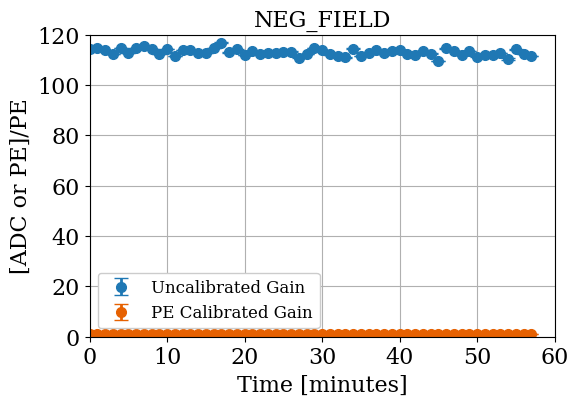

In [18]:
plt.figure(figsize=(6,4))
time_NEG_FIELD=np.arange(0,len(NEG_FIELD_gain_list))

plt.errorbar(time_NEG_FIELD,NEG_FIELD_gain_list*11,yerr=NEG_FIELD_gain_err,fmt='o',ms=7,label='Uncalibrated Gain')
plt.errorbar(time_NEG_FIELD,NEG_FIELD_pe_corrected_gain,yerr=NEG_FIELD_pe_corrected_gain_err,fmt='o',ms=7,label='PE Calibrated Gain')

plt.ylabel('[ADC or PE]/PE')
plt.xlabel('Time [minutes]')
plt.title('NEG_FIELD')
plt.grid()
plt.legend(loc='best')
plt.savefig('NEG_FIELD_gain_comparison.pdf')
plt.show()

### Plotting the mean gain for each E field

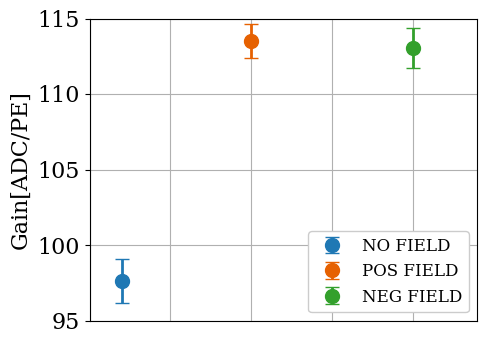

16.262338169118056 %
15.796706490142526 %


In [19]:
plt.figure(figsize=(5,4))
####### Not sure why the lists are being multiplied by 9, 10, 11 here
plt.errorbar(1,np.mean(NO_FIELD_gain_list*9),yerr=np.std(NO_FIELD_gain_list*9),label='NO FIELD',fmt='o')
plt.errorbar(5,np.mean(POS_FIELD_gain_list*10),yerr=np.std(POS_FIELD_gain_list*10),label='POS FIELD',fmt='o')
plt.errorbar(10,np.mean(NEG_FIELD_gain_list*11),yerr=np.std(NEG_FIELD_gain_list*11),label='NEG FIELD',fmt='o')
plt.legend(loc='best')
plt.xlim(0,12)
plt.xlabel('')
plt.ylabel('Gain[ADC/PE]')
plt.grid()
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off
plt.savefig('gain_comparison.pdf')
plt.show()

# printing the fractional change in gain
print((np.mean(POS_FIELD_gain_list*10)-np.mean(NO_FIELD_gain_list*9))/(np.mean(NO_FIELD_gain_list*9))*100,'%')
print((np.mean(NEG_FIELD_gain_list*11)-np.mean(NO_FIELD_gain_list*9))/(np.mean(NO_FIELD_gain_list*9))*100,'%')

In [20]:
frac_POS=(np.mean(POS_FIELD_gain_list*10)/np.mean(NO_FIELD_gain_list*9)) # the ratio of positive field gain to no field gain
frac_NEG=(np.mean(NEG_FIELD_gain_list*11)/np.mean(NO_FIELD_gain_list*9)) # the ratio of negitive field gain to no field gain

### Where we finally get to the PDE analysis

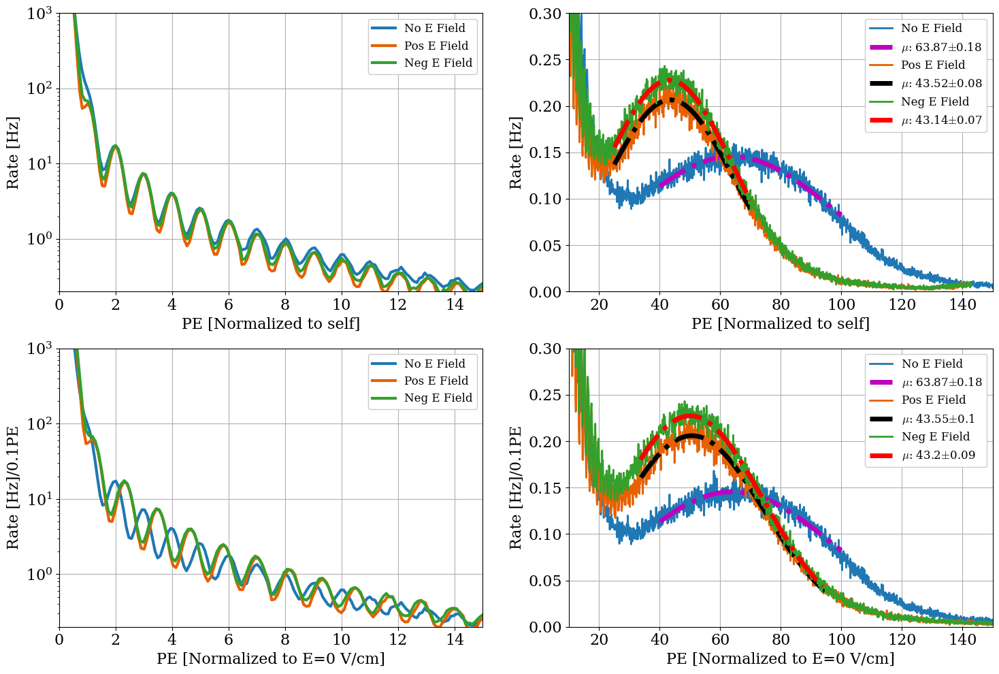

0.09266246537793786 0.08828224375539913 0.09765366644994719


In [21]:
correction_factor=0.99 ######?

avg_NO_FIELD=0
avg_POS_FIELD=0
avg_NEG_FIELD=0
plt.figure(figsize=(15,10))
n_bins=1


#--------- NO_FIELD  ------------
# iterating over calibrated data at each OV (I think)
for i in range(len(NO_FIELD_calib_pe)):
    # rebinning the calibrated data again (maybe to get rid of the single PE peaks and just see the hump from the source?)
    x_NO_FIELD,y_NO_FIELD=rebin_center(NO_FIELD_calib_pe[i]*correction_factor,NO_FIELD_calib_count[i],n_bins)
    avg_NO_FIELD+=y_NO_FIELD # summing the rebinned data
    
rate_NO_FIELD=avg_NO_FIELD/(60*len(time_NO_FIELD)) # average number of counts per second?
cut_NO_FIELD=np.where((x_NO_FIELD>40) & (x_NO_FIELD<100)) # selecting datapoints with PEs between 40 and 100
                                                          # I assume this is getting the only data that is in the source peak
# fitting the source peak
popt_NO_FIELD,pcov_NO_FIELD=curve_fit(gauss,x_NO_FIELD[cut_NO_FIELD],rate_NO_FIELD[cut_NO_FIELD],p0=[np.max(rate_NO_FIELD[cut_NO_FIELD]),65,80],maxfev=100000)

#--------- POS_FIELD  ------------
# iterating over calibrated data at each OV (I think)
for i in range(len(POS_FIELD_calib_pe_updated)):
    x_POS_FIELD,y_POS_FIELD=rebin_center(POS_FIELD_calib_pe[i]*correction_factor,POS_FIELD_calib_count[i],n_bins)
    avg_POS_FIELD+=y_POS_FIELD
    
rate_POS_FIELD=avg_POS_FIELD/(60*len(time_POS_FIELD))
cut_POS_FIELD=np.where((x_POS_FIELD>25) & (x_POS_FIELD<70)) # selecting datapoints with PEs between 25 and 70
cut_POS_FIELD_frac=np.where((x_POS_FIELD>25*frac_POS) & (x_POS_FIELD<70*frac_POS)) # doing the same but with the pos/zero data
# fitting the source peak for pos data and pos/zero data
popt_POS_FIELD,pcov_POS_FIELD=curve_fit(gauss,x_POS_FIELD[cut_POS_FIELD],rate_POS_FIELD[cut_POS_FIELD],p0=[np.max(rate_POS_FIELD[cut_POS_FIELD]),65,80],maxfev=100000)
popt_POS_FIELD_frac,pcov_POS_FIELD_frac=curve_fit(gauss,x_POS_FIELD[cut_POS_FIELD_frac],rate_POS_FIELD[cut_POS_FIELD_frac],p0=[np.max(rate_POS_FIELD[cut_POS_FIELD_frac]),65**frac_POS,80],maxfev=100000)


#--------- NEG_FIELD  ------------
# iterating over calibrated data at each OV (I think)
for i in range(len(NEG_FIELD_calib_pe)):
    x_NEG_FIELD,y_NEG_FIELD=rebin_center(NEG_FIELD_calib_pe[i]*correction_factor,NEG_FIELD_calib_count[i],n_bins)
    avg_NEG_FIELD+=y_NEG_FIELD
    
rate_NEG_FIELD=avg_NEG_FIELD/(60*len(time_NEG_FIELD))
cut_NEG_FIELD=np.where((x_NEG_FIELD>25) & (x_NEG_FIELD<70)) # selecting datapoints with PEs between 25 and 70
# fitting the source peak for neg data and neg/zero data
popt_NEG_FIELD,pcov_NEG_FIELD=curve_fit(gauss,x_NEG_FIELD[cut_NEG_FIELD],rate_NEG_FIELD[cut_NEG_FIELD],p0=[np.max(rate_NEG_FIELD[cut_NEG_FIELD]),65,80],maxfev=100000)
cut_NEG_FIELD_frac=np.where((x_NEG_FIELD>25*frac_NEG) & (x_NEG_FIELD<70*frac_NEG))
popt_NEG_FIELD_frac,pcov_NEG_FIELD_frac=curve_fit(gauss,x_NEG_FIELD[cut_NEG_FIELD_frac],
                                                  rate_NEG_FIELD[cut_NEG_FIELD_frac],
                                                  p0=[np.max(rate_NEG_FIELD[cut_NEG_FIELD_frac]),65**frac_NEG,80]
                                                  ,maxfev=100000)




# plotting the calibrated PEs on top of each other
plt.subplot(2,2,1)
plt.plot(x_NO_FIELD,rate_NO_FIELD,lw=3,label='No E Field')
plt.plot(x_POS_FIELD,rate_POS_FIELD,lw=3,label='Pos E Field')
plt.plot(x_NEG_FIELD,rate_NEG_FIELD,lw=3,label='Neg E Field')
plt.xlabel('PE [Normalized to self]')
plt.ylabel('Rate [Hz]')




###### Fitting peaks again??? I don't think that there are any plots of these fits either

N_peaks=10


#--------- NO_FIELD  ------------

PROMINENCE_NO_FIELD=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
peaks_NO_FIELD,pdict_NO_FIELD=find_peaks(rate_NO_FIELD,prominence=PROMINENCE_NO_FIELD)
peak_length_NO_FIELD=len(peaks_NO_FIELD)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
while (peak_length_NO_FIELD<N_peaks+1):
    PROMINENCE_NO_FIELD=PROMINENCE_NO_FIELD-1
            
    peaks_NO_FIELD,pdict_NO_FIELD=find_peaks(rate_NO_FIELD,prominence=PROMINENCE_NO_FIELD)
    peak_length_NO_FIELD=len(peaks_NO_FIELD)
# plt.plot(x_NO_FIELD[peaks_NO_FIELD],rate_NO_FIELD[peaks_NO_FIELD],'*',ms=7) # plot the peak markers



#--------- POS_FIELD  ------------

PROMINENCE_POS_FIELD=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
peaks_POS_FIELD,pdict_POS_FIELD=find_peaks(rate_POS_FIELD,prominence=PROMINENCE_POS_FIELD)
peak_length_POS_FIELD=len(peaks_POS_FIELD)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
while (peak_length_POS_FIELD<N_peaks+1):
    PROMINENCE_POS_FIELD=PROMINENCE_POS_FIELD-1
            
    peaks_POS_FIELD,pdict_POS_FIELD=find_peaks(rate_POS_FIELD,prominence=PROMINENCE_POS_FIELD)
    peak_length_POS_FIELD=len(peaks_POS_FIELD)
# plt.plot(x_POS_FIELD[peaks_POS_FIELD],rate_POS_FIELD[peaks_POS_FIELD],'*',ms=7) # plot the peak markers


#--------- NEG_FIELD  ------------


PROMINENCE_NEG_FIELD=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
peaks_NEG_FIELD,pdict_NEG_FIELD=find_peaks(rate_NEG_FIELD,prominence=PROMINENCE_NEG_FIELD)
peak_length_NEG_FIELD=len(peaks_NEG_FIELD)
    
#     We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
while (peak_length_NEG_FIELD<N_peaks+1):
    PROMINENCE_NEG_FIELD=PROMINENCE_NEG_FIELD-1
            
    peaks_NEG_FIELD,pdict_NEG_FIELD=find_peaks(rate_NEG_FIELD,prominence=PROMINENCE_NEG_FIELD)
    peak_length_NEG_FIELD=len(peaks_NEG_FIELD)
# plt.plot(x_NEG_FIELD[peaks_NEG_FIELD],rate_NEG_FIELD[peaks_NEG_FIELD],'*',ms=7) # plot the peak markers




plt.grid()
plt.xlim(0,15)
plt.ylim(0.2,1E3)
plt.yscale('log')
plt.legend(loc='best')

# plotting the zoomed out versions with the fits of the source peak
plt.subplot(2,2,2)
plt.plot(x_NO_FIELD,rate_NO_FIELD,color=colors[0],label='No E Field')
plt.plot(x_NO_FIELD[cut_NO_FIELD],gauss(x_NO_FIELD[cut_NO_FIELD],*popt_NO_FIELD),'m-.',lw=5,label="$\mu$: "+str(np.round(popt_NO_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NO_FIELD)[1]),2)))


plt.plot(x_POS_FIELD,rate_POS_FIELD,color=colors[1],label='Pos E Field')
plt.plot(x_POS_FIELD[cut_POS_FIELD],gauss(x_POS_FIELD[cut_POS_FIELD],*popt_POS_FIELD),'k-.',lw=5,label="$\mu$: "+str(np.round(popt_POS_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_POS_FIELD)[1]),2)))


plt.plot(x_NEG_FIELD,rate_NEG_FIELD,color=colors[2],label='Neg E Field')
plt.plot(x_NEG_FIELD[cut_NEG_FIELD],gauss(x_NEG_FIELD[cut_NEG_FIELD],*popt_NEG_FIELD),'r-.',lw=5,label="$\mu$: "+str(np.round(popt_NEG_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NEG_FIELD)[1]),2)))

plt.xlim(10,150)
plt.ylim(0,0.3)
plt.legend(loc='best')
plt.grid()
plt.xlabel('PE [Normalized to self]')
plt.ylabel('Rate [Hz]')

# plotting the pos/zero and neg/zero data   ###### still not sure what this is for
plt.subplot(2,2,3)
plt.plot(x_NO_FIELD,rate_NO_FIELD,lw=3,label='No E Field')
plt.plot(x_POS_FIELD*frac_POS,rate_POS_FIELD,lw=3,label='Pos E Field')
plt.plot(x_NEG_FIELD*frac_NEG,rate_NEG_FIELD,lw=3,label='Neg E Field')
plt.grid()
plt.xlim(0,15)
plt.ylim(0.2,1E3)
plt.yscale('log')
plt.legend(loc='best')
plt.xlabel('PE [Normalized to E=0 V/cm]')
plt.ylabel('Rate [Hz]/'+str(np.round(x_NO_FIELD[1]-x_NO_FIELD[0],1))+'PE')

# plotting the zoomed out pos/zero and neg/zero data with the source peak fits
plt.subplot(2,2,4)
plt.plot(x_NO_FIELD,rate_NO_FIELD,color=colors[0],label='No E Field')
plt.plot(x_NO_FIELD[cut_NO_FIELD],gauss(x_NO_FIELD[cut_NO_FIELD],*popt_NO_FIELD),'m-.',lw=5,label="$\mu$: "+str(np.round(popt_NO_FIELD[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NO_FIELD)[1]),2)))


plt.plot(x_POS_FIELD*frac_POS,rate_POS_FIELD,color=colors[1],label='Pos E Field')
plt.plot(x_POS_FIELD[cut_POS_FIELD_frac]*frac_POS,gauss(x_POS_FIELD[cut_POS_FIELD_frac],*popt_POS_FIELD_frac),'k-.',lw=5,label="$\mu$: "+str(np.round(popt_POS_FIELD_frac[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_POS_FIELD_frac)[1]),2)))


plt.plot(x_NEG_FIELD*frac_NEG,rate_NEG_FIELD,color=colors[2],label='Neg E Field')
plt.plot(x_NEG_FIELD[cut_NEG_FIELD_frac]*frac_NEG,gauss(x_NEG_FIELD[cut_NEG_FIELD_frac],*popt_NEG_FIELD_frac),'r-.',lw=5,label="$\mu$: "+str(np.round(popt_NEG_FIELD_frac[1],2))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_NEG_FIELD_frac)[1]),2)))




plt.xlim(10,150)
plt.ylim(0,0.3)
# plt.yscale('log')
plt.legend(loc='best')
plt.grid()
plt.xlabel('PE [Normalized to E=0 V/cm]')
plt.ylabel('Rate [Hz]/'+str(np.round(x_NO_FIELD[1]-x_NO_FIELD[0],1))+'PE')
plt.tight_layout()

plt.savefig('Source_PDE.pdf')
plt.show()

print(x_NO_FIELD[1]-x_NO_FIELD[0],x_POS_FIELD[1]-x_POS_FIELD[0],x_NEG_FIELD[1]-x_NEG_FIELD[0])
